<a href="https://colab.research.google.com/github/gapatronh/thesis/blob/main/experiments_wgangp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import numpy as np
np.set_printoptions(precision = 3)
import matplotlib.pyplot as plt
import sklearn.datasets
import time

In [ ]:
def quad_data(n=10000, scale=1):
    x = scale*(np.random.random_sample((n,))-0.5)
    y = x**2
    return np.array([x,y]).T

def circle_data(n=10000, radius = 1):
    data = []
    x = (np.random.random_sample((n,)))
    return radius*np.array([np.cos(2*np.pi*x),np.sin(2*np.pi*x)]).T

np.random.seed(0)
def mixture_gaussians(n=10000):
  gauss_1 = np.random.multivariate_normal((5,5),cov =[[1,0],[0,1]], size = n//4)
  gauss_2 = np.random.multivariate_normal((5,-5),cov =[[1,0],[0,1]], size = n//4)
  gauss_3 = np.random.multivariate_normal((-5,-5),cov =[[1,0],[0,1]], size = n//4)
  gauss_4 = np.random.multivariate_normal((-5,5),cov =[[1,0],[0,1]], size = n//4)
  mix = np.vstack((gauss_1, gauss_2, gauss_3, gauss_4))
  np.random.shuffle(mix)
  return (mix)

In [ ]:
#Parabola
quadratic = quad_data().astype("float32")

#Circle
circle = circle_data().astype("float32")

#Gaussian mixture
mixture = mixture_gaussians().astype("float32")

#Random Blobs
blobs = sklearn.datasets.make_blobs(n_samples=10000, centers=5, center_box=(-20,20))
X_blobs, Y_blobs = blobs
blobs = X_blobs.astype("float32")

#Circles
circles = sklearn.datasets.make_circles(n_samples=10000, factor=0.4)
X_circles, Y_circles = circles
circles = X_circles.astype("float32")


#Moons
moons = sklearn.datasets.make_moons(n_samples=10000)
X_moons, Y_moons = moons
moons = X_moons.astype("float32")


#Swiss Roll
swiss_roll = sklearn.datasets.make_swiss_roll(n_samples=10000)
X_swiss_roll, t = swiss_roll
swiss_roll = np.vstack([X_swiss_roll[:,0], X_swiss_roll[:,2]]).T.astype("float32")

#S Curve
s_curve = sklearn.datasets.make_s_curve(n_samples=10000)
X_s_curve, t = s_curve
s_curve = np.vstack([X_s_curve[:,0], X_s_curve[:,2]]).T.astype("float32")

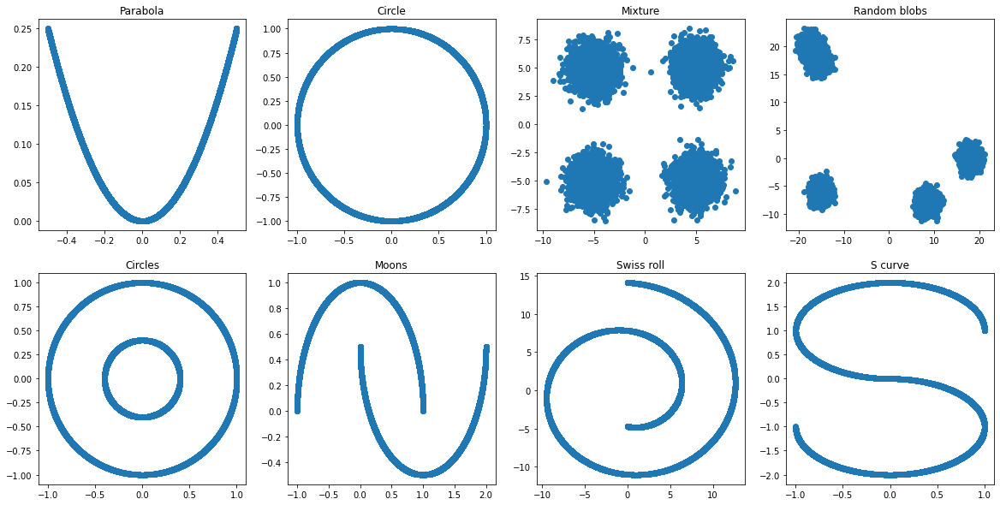

In [ ]:
fig, axs = plt.subplots(2,4, figsize=(20,10))
axs[0, 0].scatter(quadratic[:,0], quadratic[:,1])
axs[0, 0].set_title('Parabola')
axs[0, 1].scatter(circle[:,0], circle[:,1])
axs[0, 1].set_title('Circle')
axs[0,2].scatter(mixture[:,0], mixture[:,1])
axs[0,2].set_title("Mixture")
axs[0,3].scatter(blobs[:,0], blobs[:,1])
axs[0,3].set_title("Random blobs")

axs[1, 0].scatter(circles[:,0], circles[:,1])
axs[1, 0].set_title('Circles')
axs[1, 1].scatter(moons[:,0], moons[:,1])
axs[1, 1].set_title('Moons')
axs[1, 2].scatter(swiss_roll[:,0], swiss_roll[:,1])
axs[1, 2].set_title("Swiss roll")
axs[1, 3].scatter(s_curve[:,0], s_curve[:,1])
axs[1, 3].set_title("S curve")
plt.show()

In [ ]:
def make_generator_network(hsize=[64,64]):
  model = tf.keras.Sequential(name="Generator")
  model.add(tf.keras.layers.Dense(hsize[0],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(hsize[1],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(2, activation=None))
  return model

def make_discriminator_network(hsize=[64,64]):
  model = tf.keras.Sequential()
  model.add(tf.keras.layers.Dense(hsize[0],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(hsize[1],activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(1, activation=None))
  return model

In [ ]:
def make_generator_network(hsize=[16,64]):
  model = tf.keras.Sequential(name="Generator")
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu, input_shape=(2,)))
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(2, activation=None))
  return model

def make_discriminator_network(hsize=[16,64]):
  model = tf.keras.Sequential(name="Discriminator")
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu,input_shape=(2,)))
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(1, activation=None))
  return model

In [ ]:
z_size = 2
num_epochs = 20000
batch_size = 256
lambda_gp = .10
device_name = tf.test.gpu_device_name()

In [ ]:
gen_model = make_generator_network()
#gen_model.build(input_shape=(None,z_size))
gen_model.summary()

disc_model = make_discriminator_network()
#disc_model.build(input_shape=(None, 2))
disc_model.summary()

Model: "Generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 512)               1536      
_________________________________________________________________
dense_4 (Dense)              (None, 512)               262656    
_________________________________________________________________
dense_5 (Dense)              (None, 512)               262656    
_________________________________________________________________
dense_6 (Dense)              (None, 2)                 1026      
Total params: 527,874
Trainable params: 527,874
Non-trainable params: 0
_________________________________________________________________
Model: "Discriminator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 512)               1536      
____________________________

# WGAN

# Gradient Penalty

In [ ]:
# Optimizer for both the networks
# learning_rate=0.0002, beta_1=0.5 are recommened
generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0002, beta_1=0.5, beta_2=0.9
)
discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0002, beta_1=0.5, beta_2=0.9
)

# Define the loss functions to be used for discrimiator
# This should be (fake_loss - real_loss)
# We will add the gradient penalty later to this loss function
def discriminator_loss(real_img, fake_img):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    return fake_loss - real_loss


# Define the loss functions to be used for generator
def generator_loss(fake_img):
    return -tf.reduce_mean(fake_img)

def gradient_penalty(batch_size, real_images, fake_images, discriminator):
      """ Calculates the gradient penalty.

      This loss is calculated on an interpolated image
      and added to the discriminator loss.
      """
      # get the interplated image
      alpha = tf.random.normal([batch_size, 1], 0.0, 1.0)
      diff = fake_images - real_images
      interpolated = real_images + alpha * diff
      with tf.GradientTape() as gp_tape:
          gp_tape.watch(interpolated)
            # 1. Get the discriminator output for this interpolated image.
          pred = discriminator(interpolated, training=True)

        # 2. Calculate the gradients w.r.t to this interpolated image.
      grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Calcuate the norm of the gradients
      norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1]))
      gp = tf.reduce_mean((norm - 1.0) ** 2)
      return gp  


# Epochs to train
z_size = 2
num_epochs = 100
batch_size = 512
gp_weight = .10
device_name = tf.test.gpu_device_name()
numpy_data = blobs
data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size, drop_remainder=True)
fixed_z = tf.random.normal(shape=[500, z_size])

0


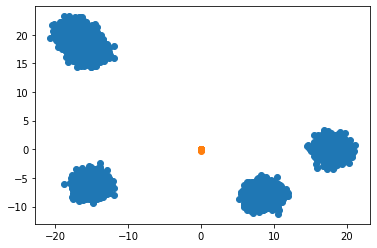

1


Exception ignored in: <function IteratorResourceDeleter.__del__ at 0x7f2a4bf9c830>
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/iterator_ops.py", line 546, in __del__
    handle=self._handle, deleter=self._deleter)
  File "/usr/local/lib/python3.7/dist-packages/tensorflow/python/ops/gen_dataset_ops.py", line 1264, in delete_iterator
    _ctx, "DeleteIterator", name, handle, deleter)
KeyboardInterrupt: 


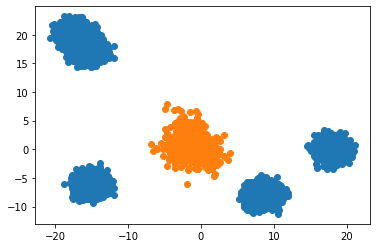

2


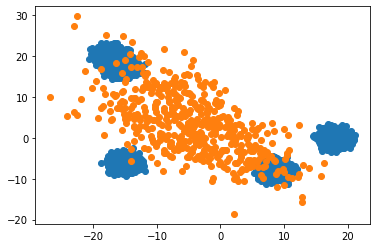

3


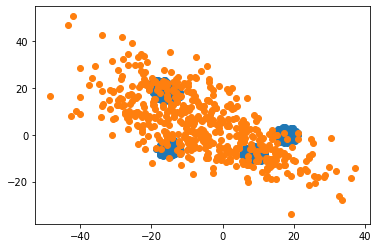

4


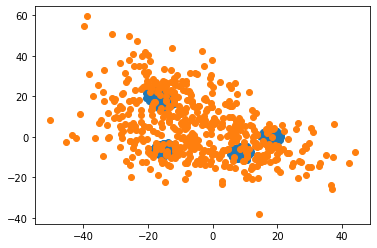

5


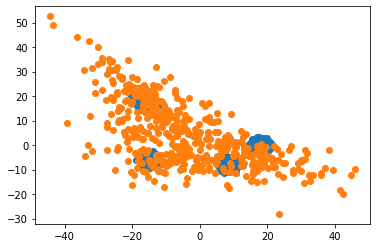

6


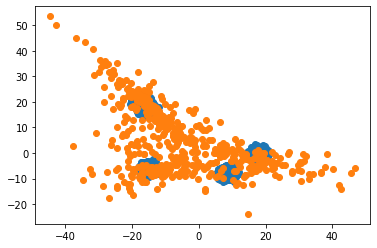

7


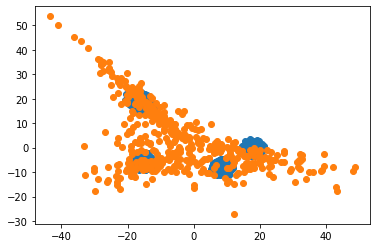

8


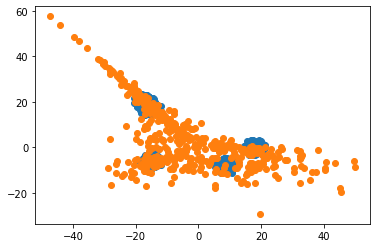

9


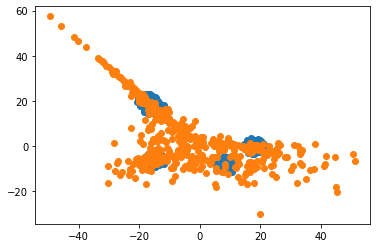

10


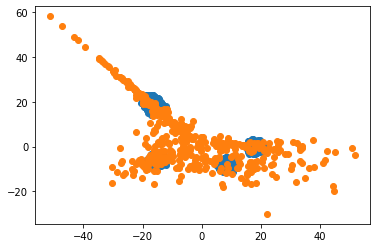

11


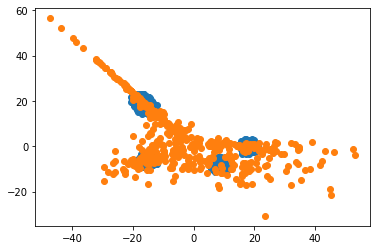

12


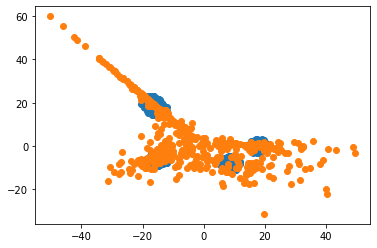

KeyboardInterrupt: ignored

In [ ]:
with tf.device(device_name):
  gen_model = make_generator_network()
  gen_model.build(input_shape=(None,z_size))
  disc_model = make_discriminator_network()
  disc_model.build(input_shape=(None,2))

for epoch in range(0, num_epochs+1):
  print(epoch)
  samples = gen_model(fixed_z)
  plt.scatter(numpy_data[:,0],numpy_data[:,1])
  plt.scatter(samples[:,0],samples[:,1])
  plt.show()
  for batch in data:
    for i in range(5):
      random_latent_vectors = tf.random.normal(shape=[batch_size,z_size])
      with tf.GradientTape() as tape:
        fake_data = gen_model(random_latent_vectors, training=True)
        fake_logits = disc_model(fake_data, training=True)
        real_logits = disc_model(batch, training=True)
        d_cost = discriminator_loss(real_logits,fake_logits)
        gp = gradient_penalty(batch_size, batch, fake_data, disc_model)
        d_loss = d_cost + gp* gp_weight
      d_gradient = tape.gradient(d_loss, disc_model.trainable_variables)
      discriminator_optimizer.apply_gradients(zip(d_gradient,disc_model.trainable_variables))
    random_latent_vectors = tf.random.normal(shape=(batch_size, z_size))
    with tf.GradientTape() as tape:
      fake_data = gen_model(random_latent_vectors, training=True)
      fake_logits = disc_model(fake_data, training=True)
      g_loss = generator_loss(fake_logits)
    gen_gradient = tape.gradient(g_loss, gen_model.trainable_variables)
    generator_optimizer.apply_gradients(zip(gen_gradient,gen_model.trainable_variables))


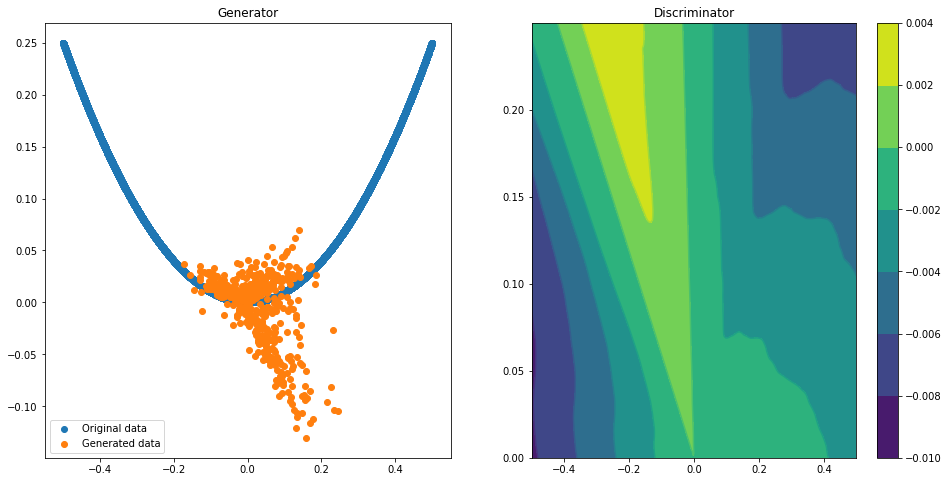

Epoch 000 | ET 1.29 min | Avg Losses >> G/D 0.0667/-0.0626
Epoch 005 | ET 2.75 min | Avg Losses >> G/D 0.0461/-0.0279
Epoch 010 | ET 4.22 min | Avg Losses >> G/D -0.0673/-0.0137
Epoch 015 | ET 5.68 min | Avg Losses >> G/D -0.0775/-0.0116


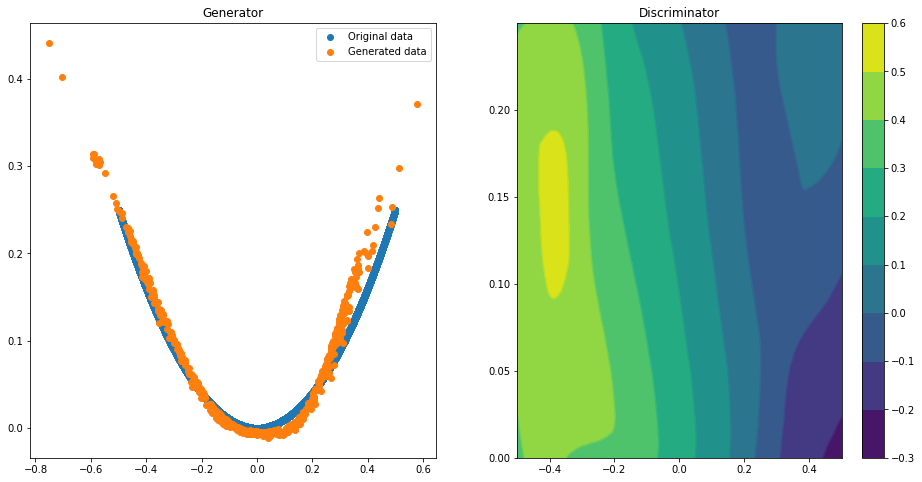

Epoch 020 | ET 8.13 min | Avg Losses >> G/D -0.1919/-0.0152


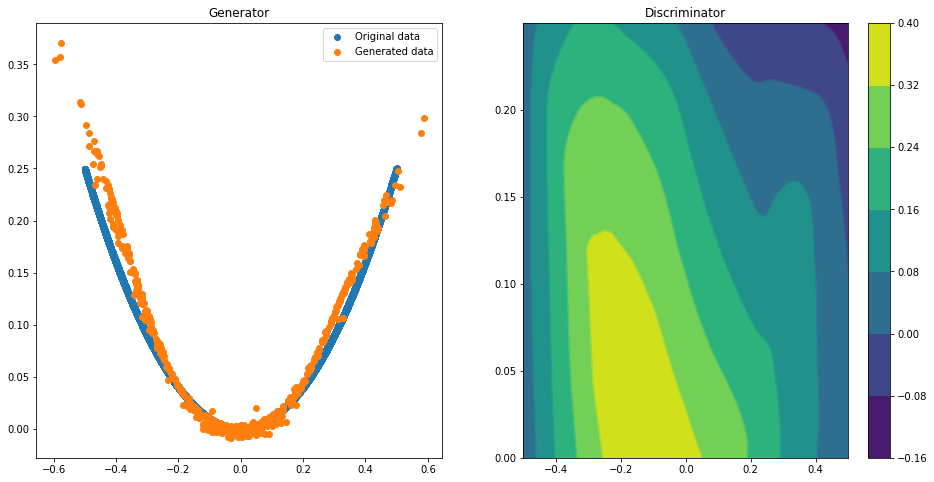

Epoch 025 | ET 10.60 min | Avg Losses >> G/D -0.1774/-0.0196
Epoch 030 | ET 12.05 min | Avg Losses >> G/D 0.0268/-0.0154
Epoch 035 | ET 13.50 min | Avg Losses >> G/D 0.1216/-0.0180


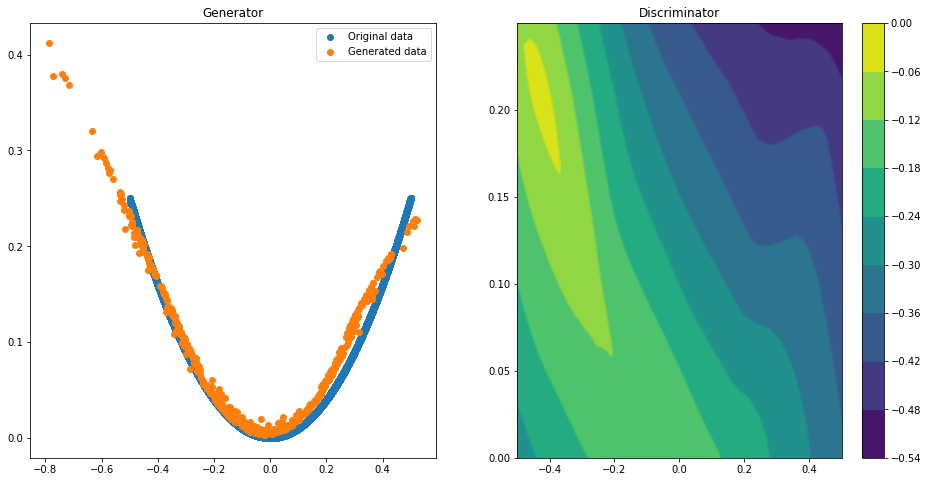

Epoch 040 | ET 15.98 min | Avg Losses >> G/D 0.2256/-0.0202
Epoch 045 | ET 17.47 min | Avg Losses >> G/D 0.3298/-0.0201


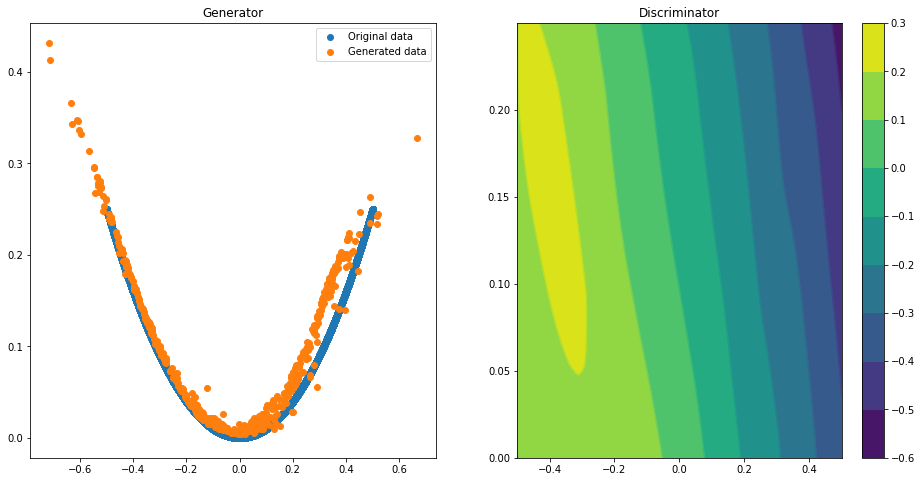

Epoch 050 | ET 20.03 min | Avg Losses >> G/D 0.3318/-0.0256
Epoch 055 | ET 21.50 min | Avg Losses >> G/D 0.4798/-0.0111


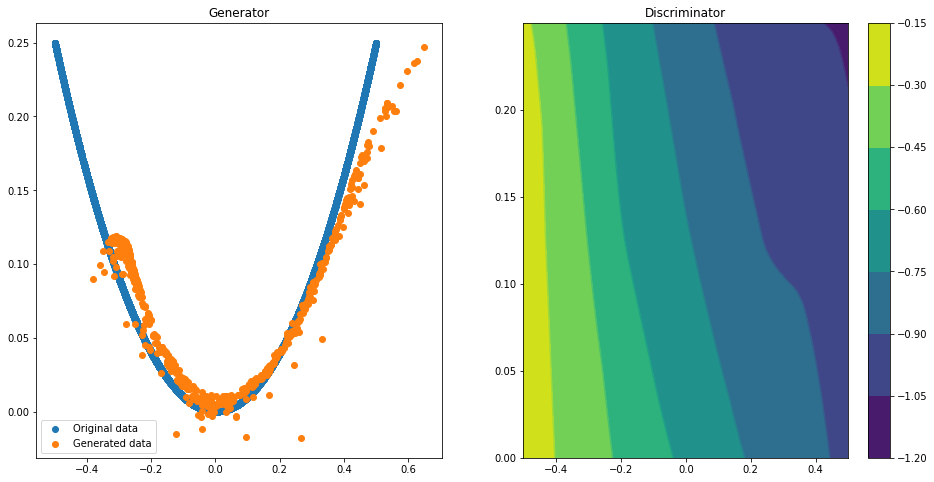

Epoch 060 | ET 23.97 min | Avg Losses >> G/D 0.6787/-0.0189
Epoch 065 | ET 25.46 min | Avg Losses >> G/D 0.7918/-0.0176
Epoch 070 | ET 26.94 min | Avg Losses >> G/D 0.9407/-0.0151


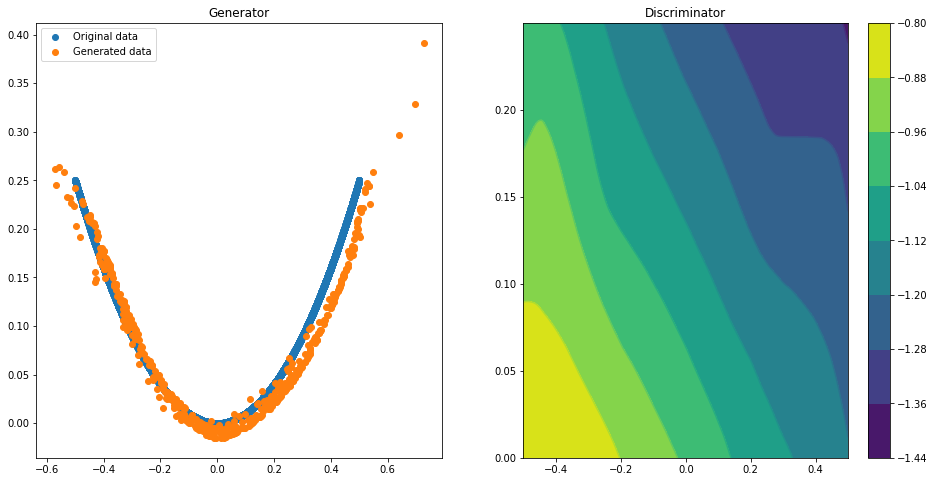

Epoch 075 | ET 29.51 min | Avg Losses >> G/D 1.0108/-0.0151


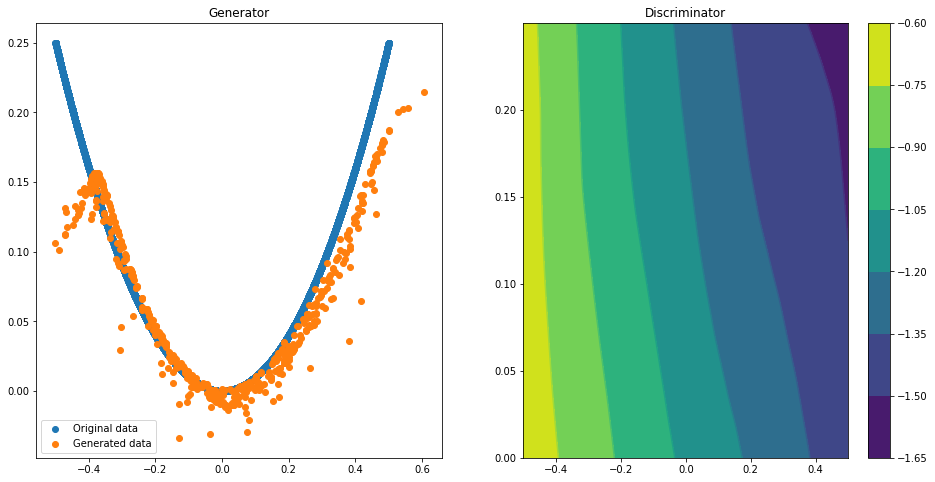

Epoch 080 | ET 31.98 min | Avg Losses >> G/D 1.1059/-0.0156
Epoch 085 | ET 33.46 min | Avg Losses >> G/D 0.9565/-0.0159
Epoch 090 | ET 34.96 min | Avg Losses >> G/D 1.2078/-0.0193
Epoch 095 | ET 36.45 min | Avg Losses >> G/D 1.1407/-0.0184


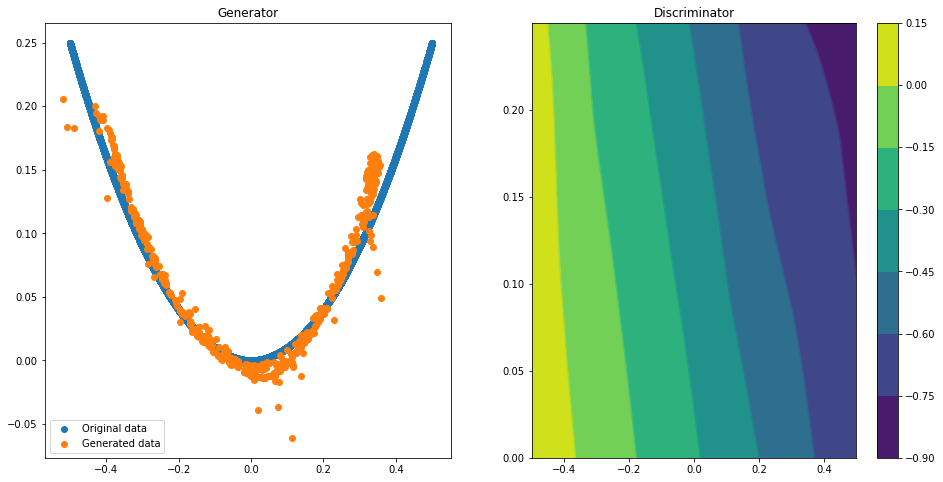

Epoch 100 | ET 38.99 min | Avg Losses >> G/D 0.7994/-0.0129


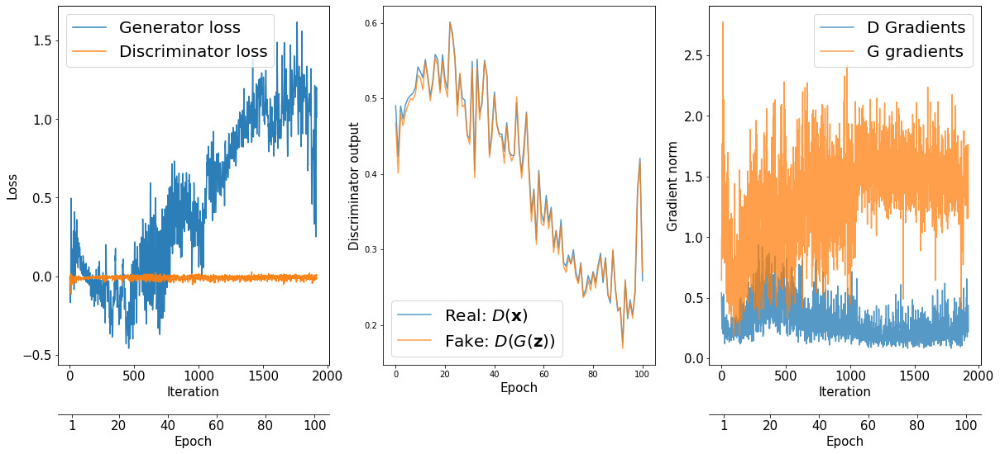

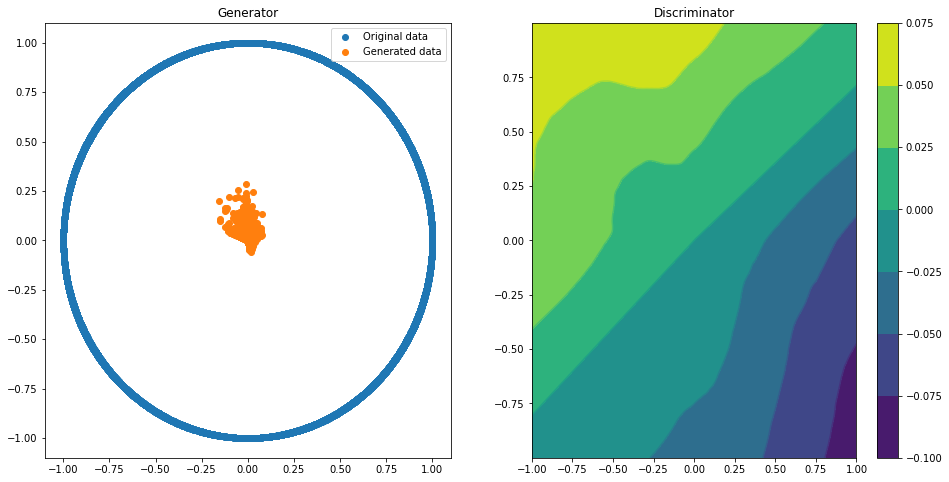

Epoch 000 | ET 1.30 min | Avg Losses >> G/D -0.2233/-0.4206
Epoch 005 | ET 2.78 min | Avg Losses >> G/D -2.4295/-0.3816
Epoch 010 | ET 4.26 min | Avg Losses >> G/D -1.2215/-0.0887
Epoch 015 | ET 5.74 min | Avg Losses >> G/D -0.3840/-0.0667


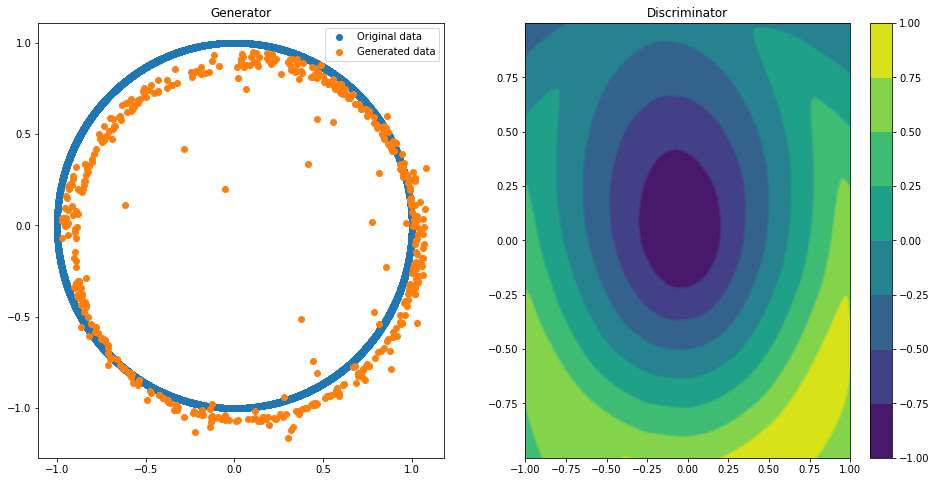

Epoch 020 | ET 8.24 min | Avg Losses >> G/D -0.1119/-0.0837


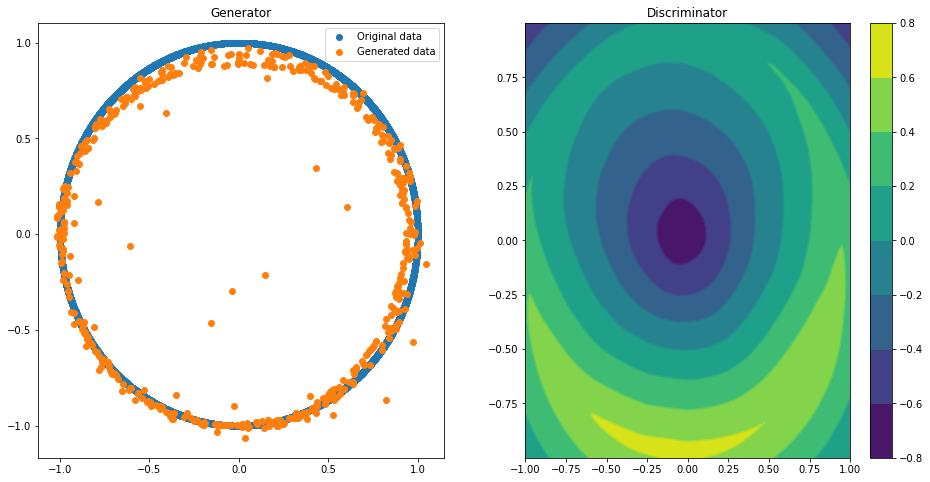

Epoch 025 | ET 10.78 min | Avg Losses >> G/D -0.2301/-0.0596
Epoch 030 | ET 12.28 min | Avg Losses >> G/D -0.2149/-0.0625
Epoch 035 | ET 13.77 min | Avg Losses >> G/D -0.1868/-0.0694


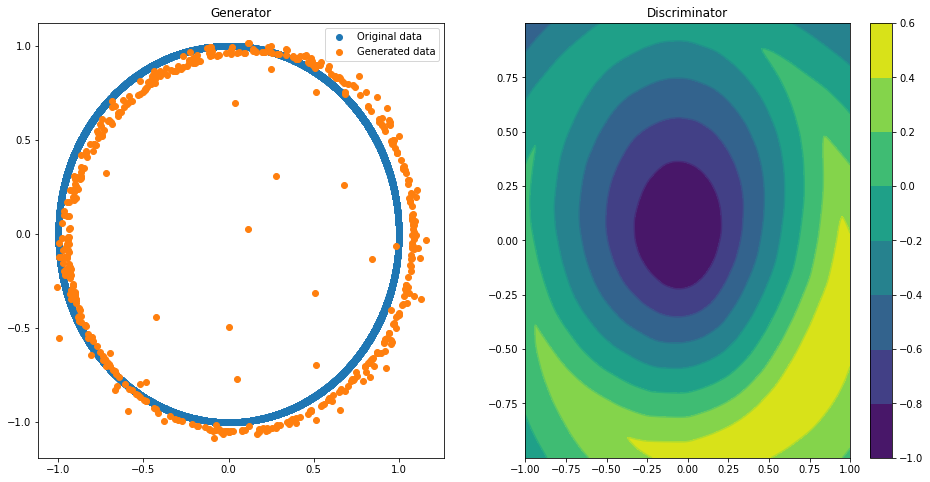

Epoch 040 | ET 16.25 min | Avg Losses >> G/D -0.1160/-0.0656
Epoch 045 | ET 17.76 min | Avg Losses >> G/D -0.0411/-0.0504


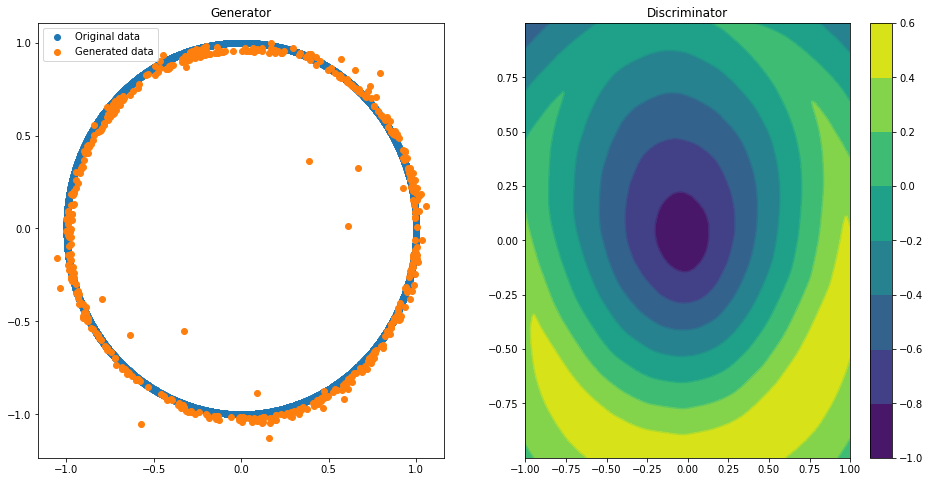

Epoch 050 | ET 20.31 min | Avg Losses >> G/D -0.1051/-0.0545
Epoch 055 | ET 21.80 min | Avg Losses >> G/D 0.0312/-0.0510


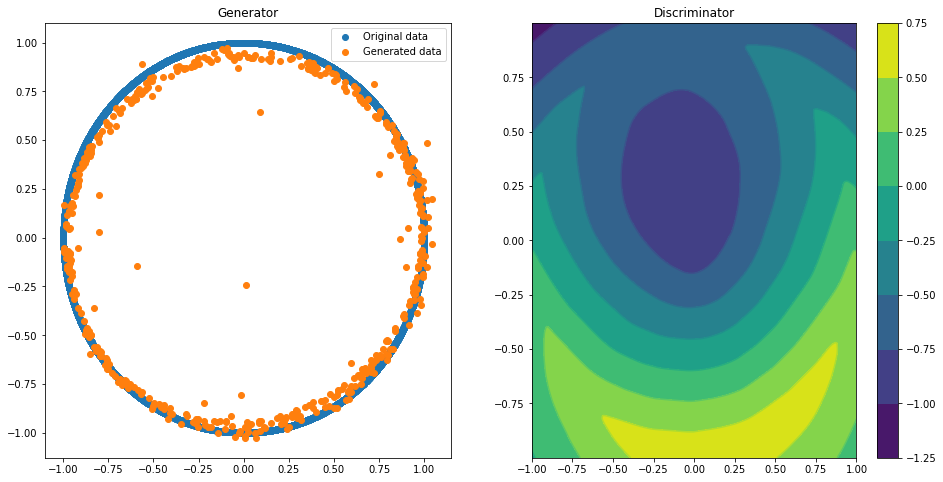

Epoch 060 | ET 24.27 min | Avg Losses >> G/D 0.0738/-0.0527
Epoch 065 | ET 25.75 min | Avg Losses >> G/D 0.1984/-0.0579
Epoch 070 | ET 27.25 min | Avg Losses >> G/D 0.1323/-0.0407


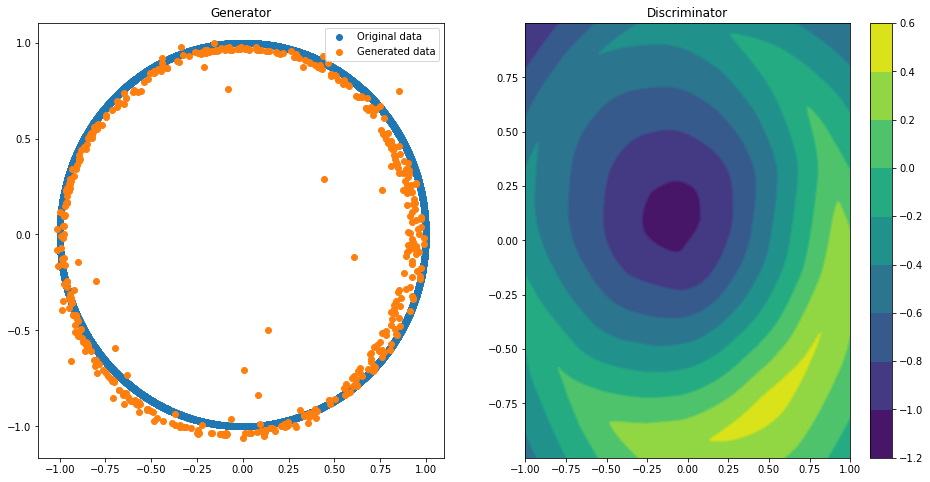

Epoch 075 | ET 29.74 min | Avg Losses >> G/D 0.1919/-0.0509


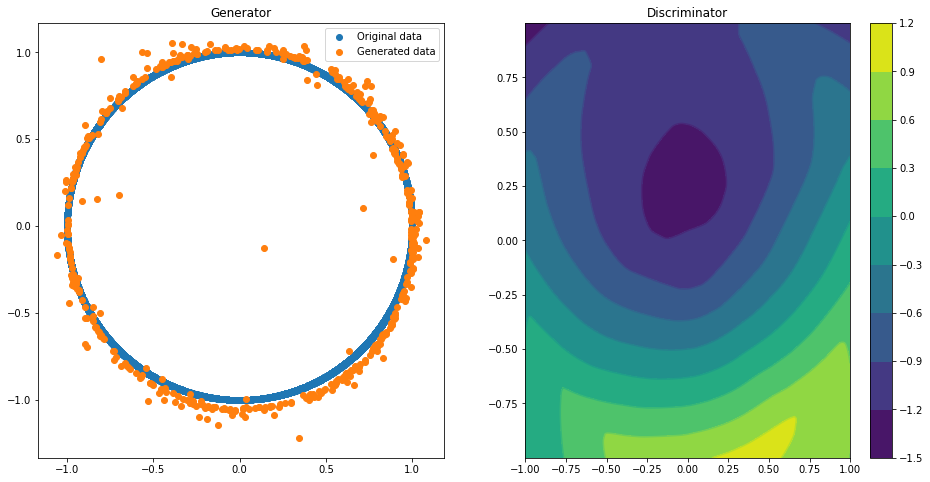

Epoch 080 | ET 32.32 min | Avg Losses >> G/D 0.2450/-0.0538
Epoch 085 | ET 33.82 min | Avg Losses >> G/D 0.2200/-0.0555
Epoch 090 | ET 35.33 min | Avg Losses >> G/D 0.2634/-0.0510
Epoch 095 | ET 36.82 min | Avg Losses >> G/D 0.3530/-0.0573


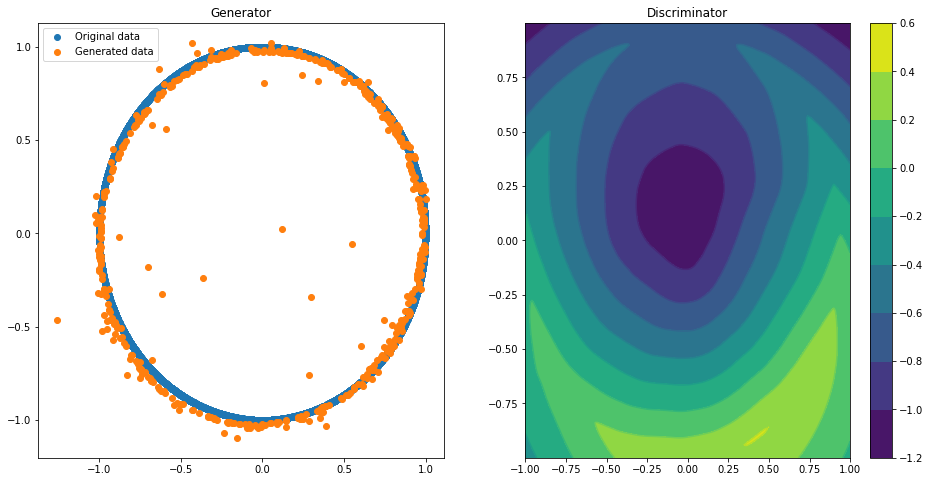

Epoch 100 | ET 39.32 min | Avg Losses >> G/D 0.3195/-0.0521


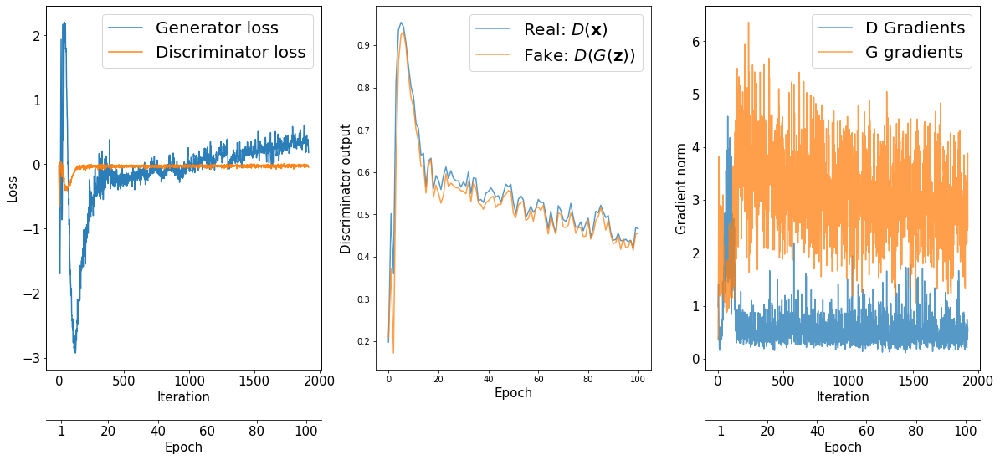

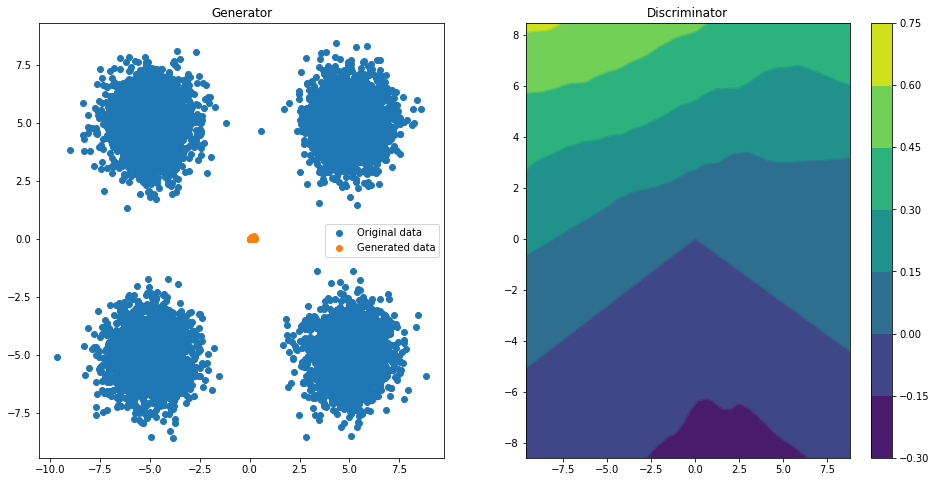

Epoch 000 | ET 1.36 min | Avg Losses >> G/D -17.0621/-52.9425
Epoch 005 | ET 2.86 min | Avg Losses >> G/D 0.7969/-4.0741
Epoch 010 | ET 4.37 min | Avg Losses >> G/D 3.5076/-1.8344
Epoch 015 | ET 5.86 min | Avg Losses >> G/D 34.1138/-11.7297


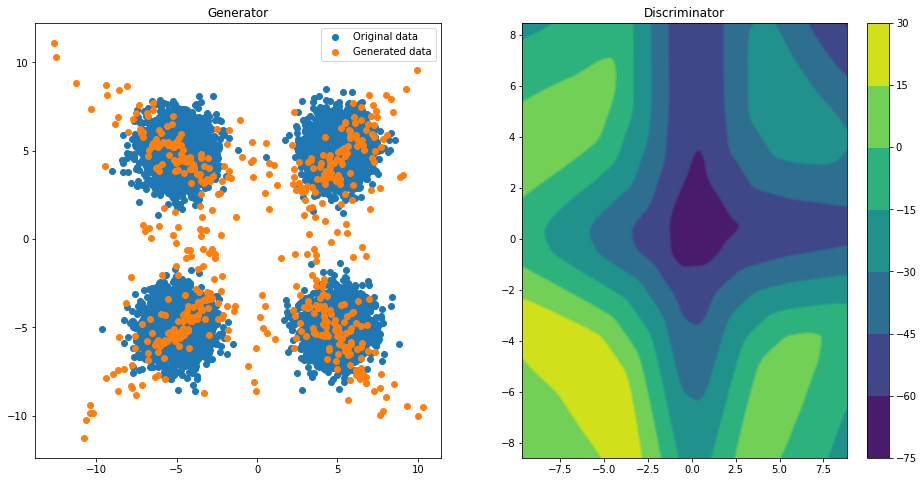

Epoch 020 | ET 8.37 min | Avg Losses >> G/D 16.6229/-7.0973


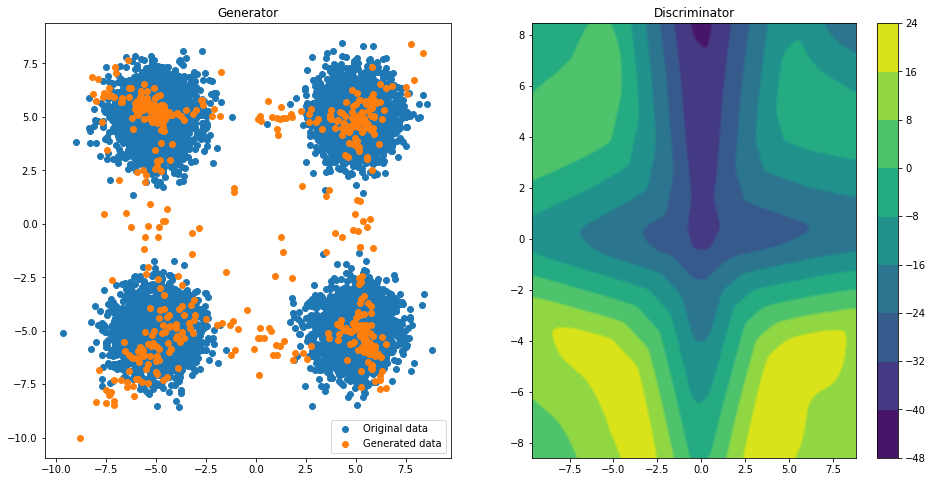

Epoch 025 | ET 10.89 min | Avg Losses >> G/D -0.6301/-2.9378
Epoch 030 | ET 12.48 min | Avg Losses >> G/D -9.0467/-2.0382
Epoch 035 | ET 14.00 min | Avg Losses >> G/D -10.2161/-1.9878


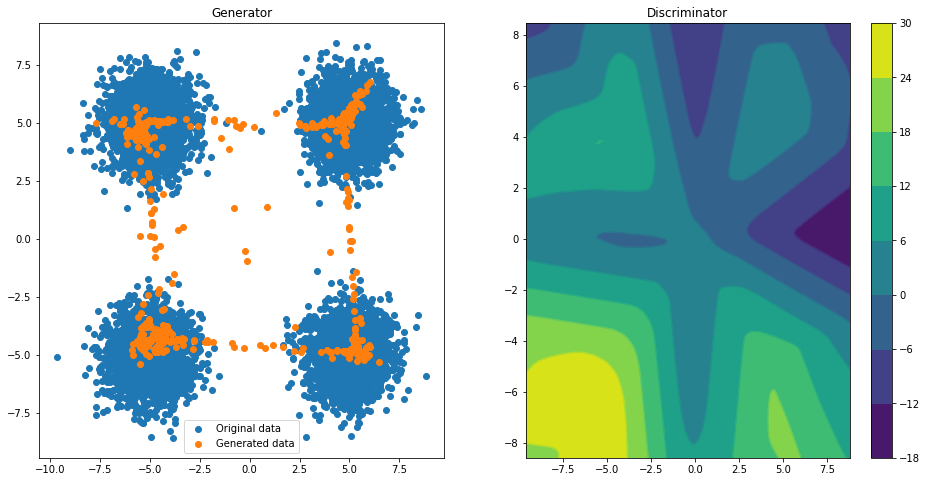

Epoch 040 | ET 16.50 min | Avg Losses >> G/D -13.6331/-2.2345
Epoch 045 | ET 18.00 min | Avg Losses >> G/D -8.6761/-1.7261


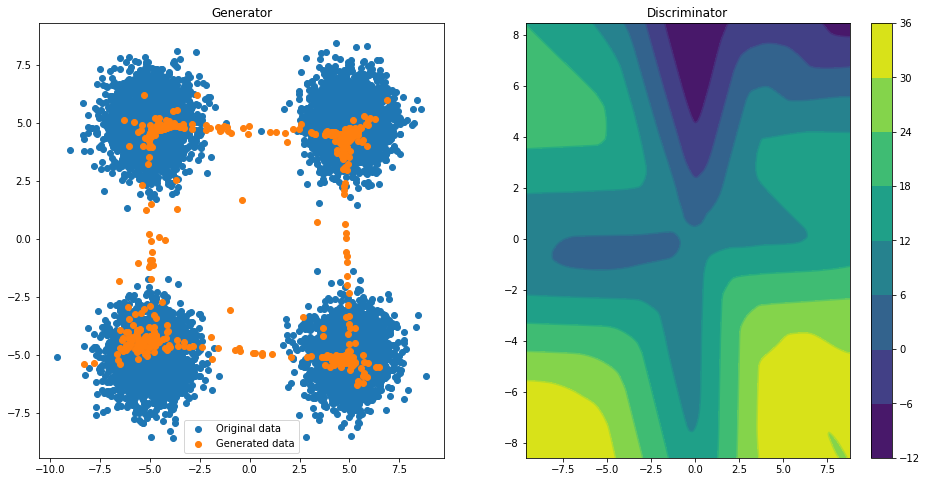

Epoch 050 | ET 20.53 min | Avg Losses >> G/D -17.0738/-1.5433
Epoch 055 | ET 22.02 min | Avg Losses >> G/D -12.9681/-1.5430


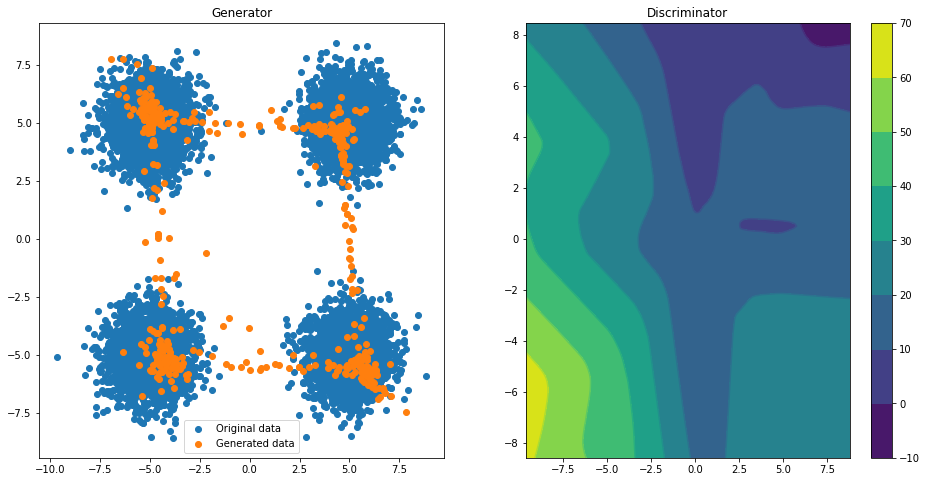

Epoch 060 | ET 24.52 min | Avg Losses >> G/D -17.1207/-1.4206
Epoch 065 | ET 26.01 min | Avg Losses >> G/D -13.1135/-1.4066
Epoch 070 | ET 27.50 min | Avg Losses >> G/D -16.1959/-1.4600


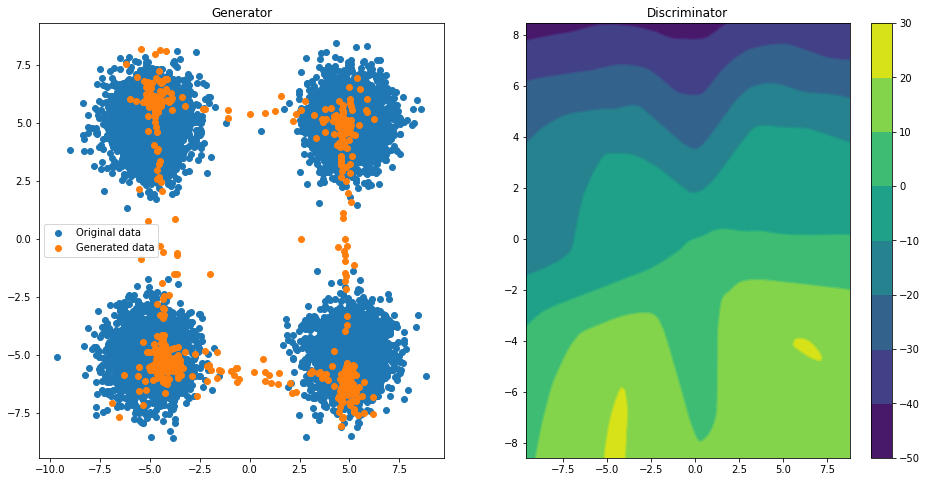

Epoch 075 | ET 30.00 min | Avg Losses >> G/D -16.0348/-1.4356


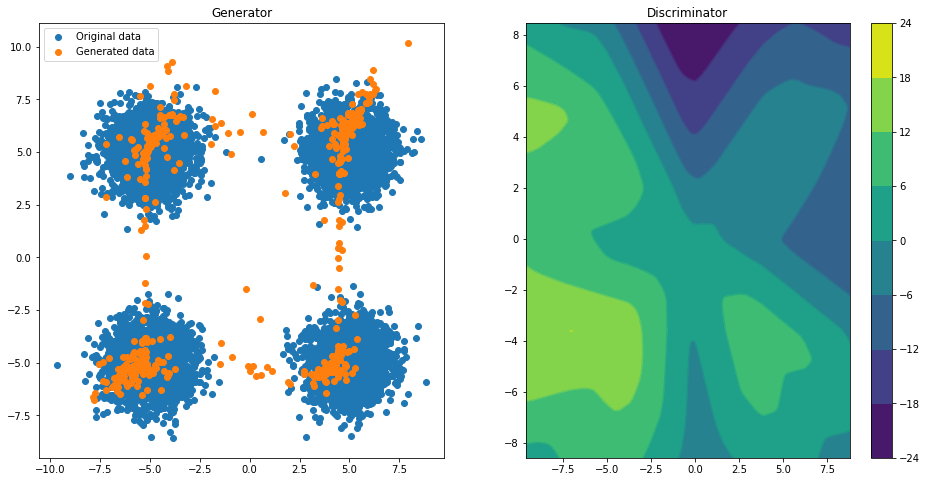

Epoch 080 | ET 32.51 min | Avg Losses >> G/D -13.7320/-1.5507
Epoch 085 | ET 33.99 min | Avg Losses >> G/D -6.7059/-1.1825
Epoch 090 | ET 35.49 min | Avg Losses >> G/D -9.8362/-1.4016
Epoch 095 | ET 36.97 min | Avg Losses >> G/D -3.3619/-1.3687


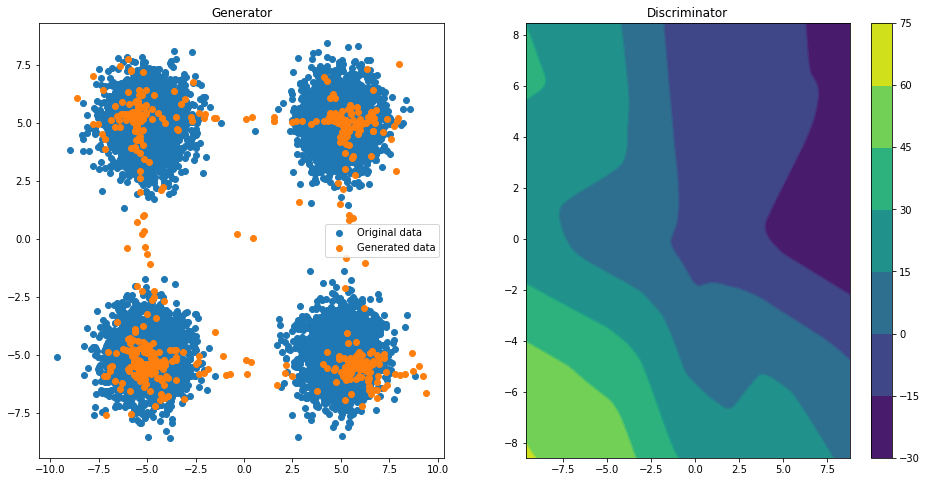

Epoch 100 | ET 39.46 min | Avg Losses >> G/D -3.5859/-1.1035


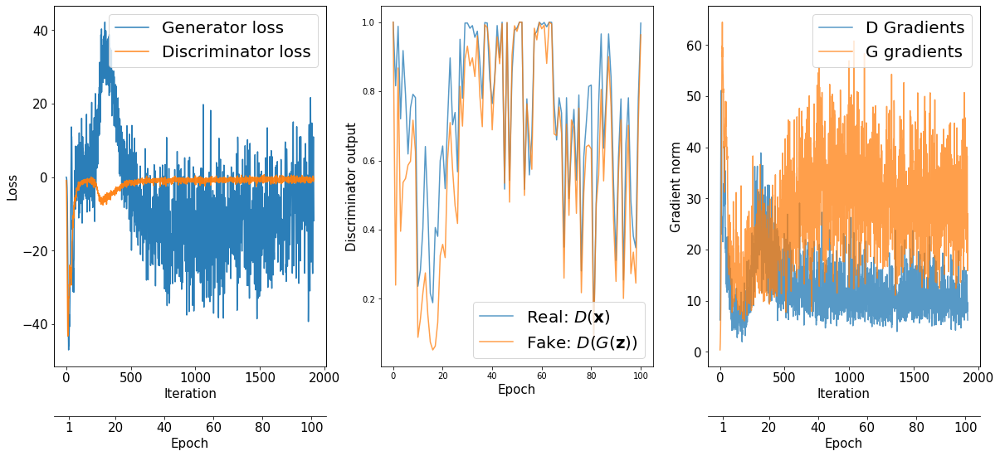

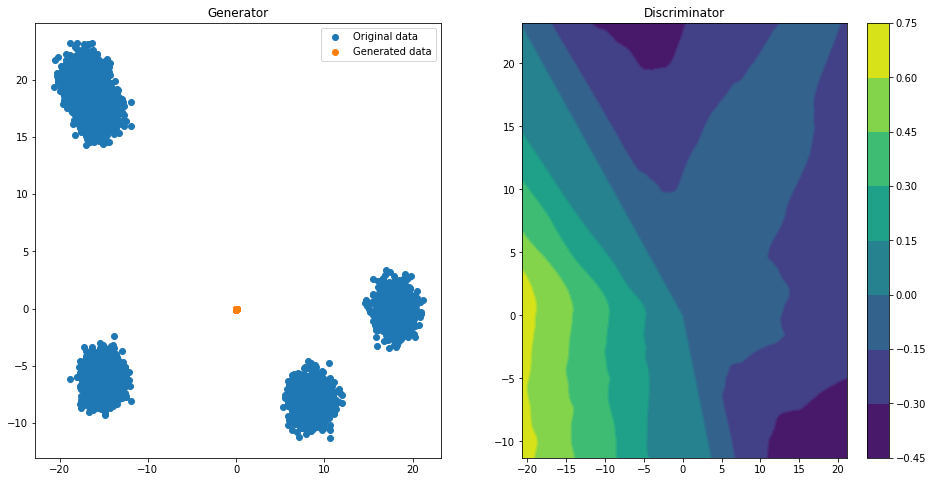

Epoch 000 | ET 1.30 min | Avg Losses >> G/D -20.9132/-300.8681
Epoch 005 | ET 2.77 min | Avg Losses >> G/D -13.6826/-154.3828
Epoch 010 | ET 4.24 min | Avg Losses >> G/D -49.5623/-45.6095
Epoch 015 | ET 5.74 min | Avg Losses >> G/D 140.7223/-43.2468


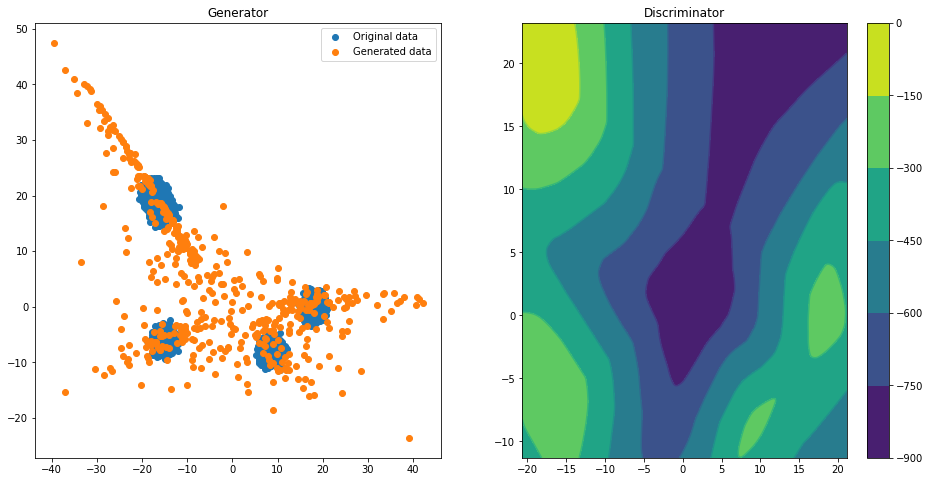

Epoch 020 | ET 8.22 min | Avg Losses >> G/D 367.6205/-118.1382


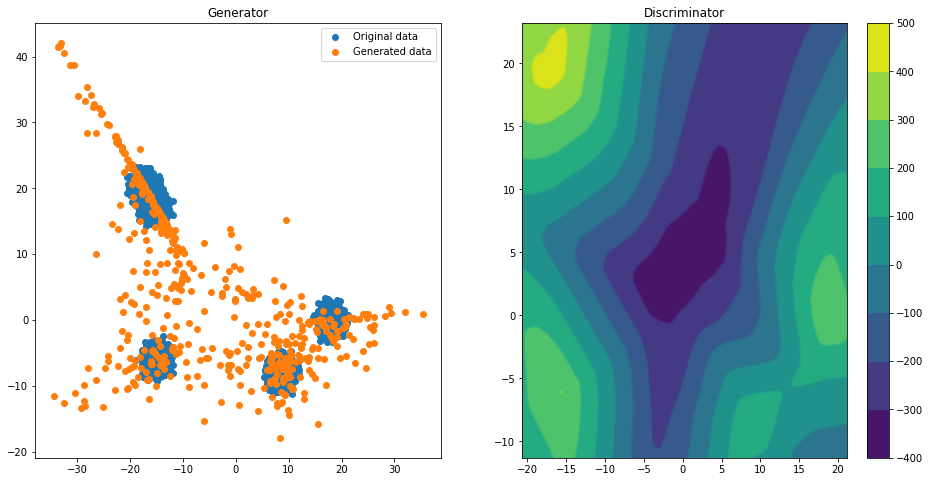

Epoch 025 | ET 10.70 min | Avg Losses >> G/D -95.2234/-92.5793
Epoch 030 | ET 12.16 min | Avg Losses >> G/D -255.5090/-65.0679
Epoch 035 | ET 13.63 min | Avg Losses >> G/D -257.9352/-46.1357


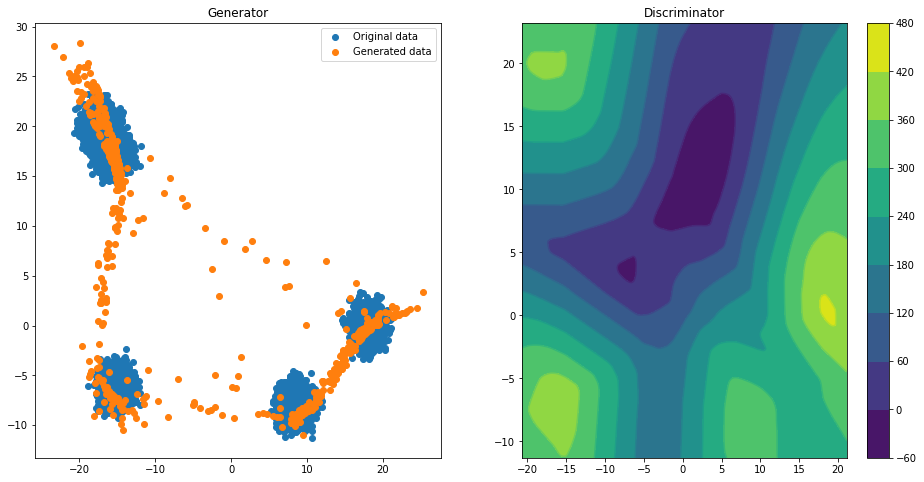

Epoch 040 | ET 16.12 min | Avg Losses >> G/D -265.4431/-33.8359
Epoch 045 | ET 17.59 min | Avg Losses >> G/D -250.3614/-21.9843


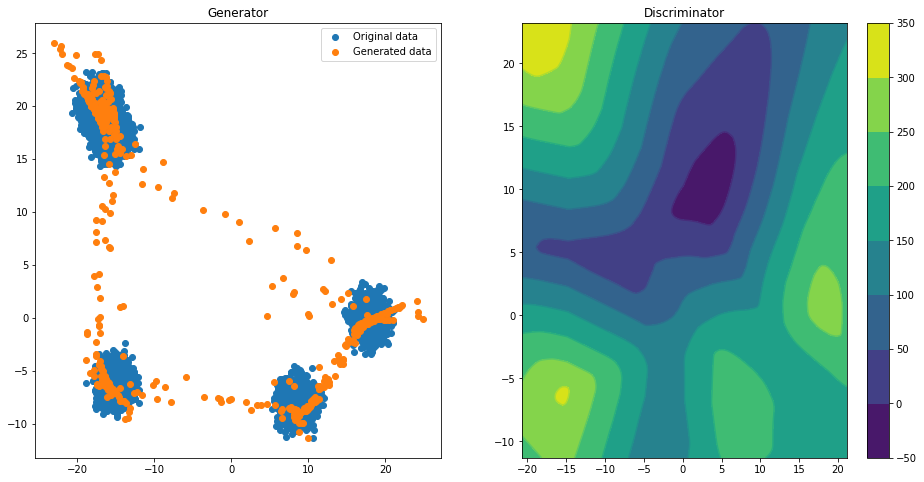

Epoch 050 | ET 20.08 min | Avg Losses >> G/D -251.1091/-18.8650
Epoch 055 | ET 21.68 min | Avg Losses >> G/D -235.0456/-15.2283


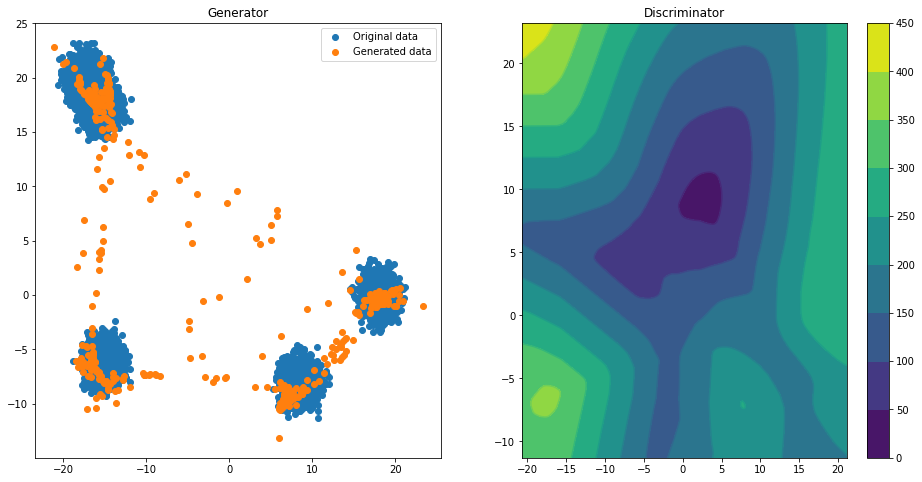

Epoch 060 | ET 24.18 min | Avg Losses >> G/D -228.9796/-13.4031
Epoch 065 | ET 25.69 min | Avg Losses >> G/D -220.8401/-11.9087
Epoch 070 | ET 27.20 min | Avg Losses >> G/D -193.5589/-9.4561


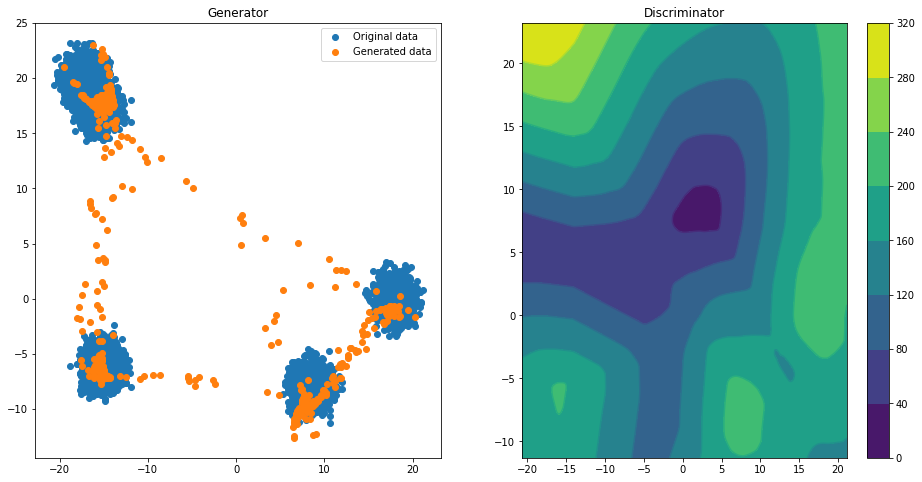

Epoch 075 | ET 29.71 min | Avg Losses >> G/D -185.2686/-9.9520


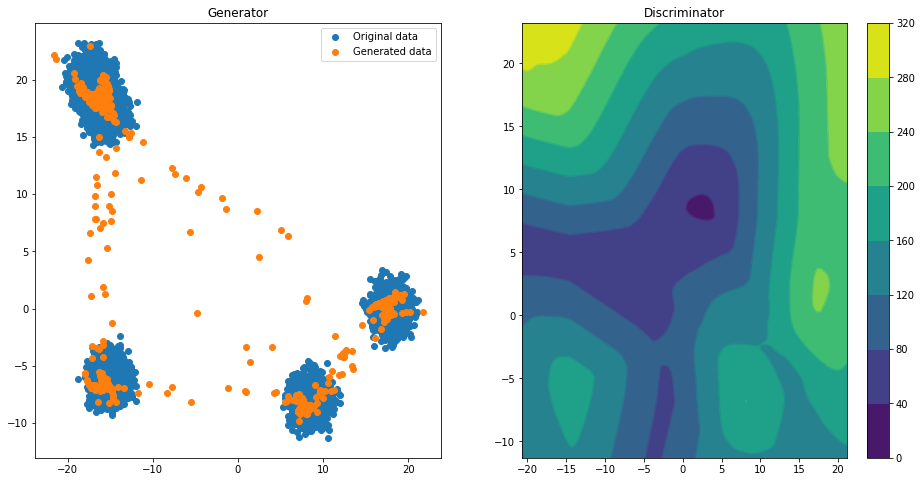

Epoch 080 | ET 32.30 min | Avg Losses >> G/D -148.6852/-10.8149
Epoch 085 | ET 33.83 min | Avg Losses >> G/D -177.9725/-11.4283
Epoch 090 | ET 35.36 min | Avg Losses >> G/D -192.1598/-7.0494
Epoch 095 | ET 36.89 min | Avg Losses >> G/D -185.3519/-8.5311


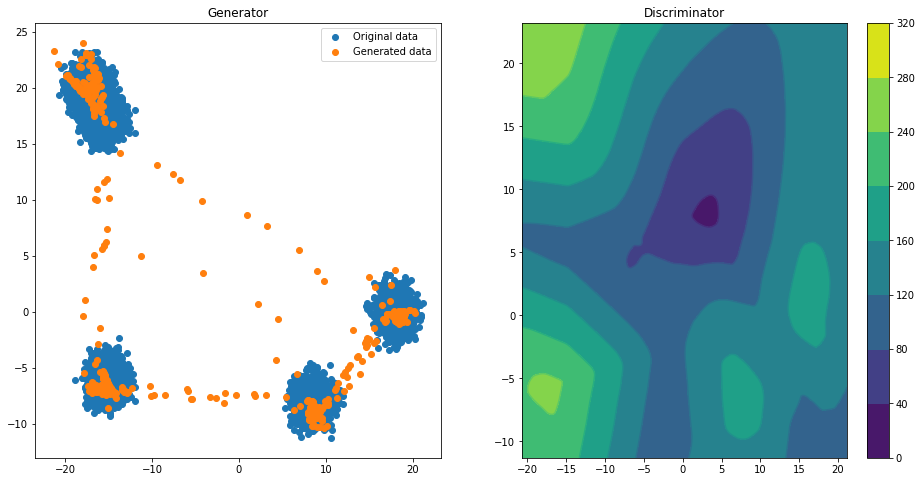

Epoch 100 | ET 39.40 min | Avg Losses >> G/D -177.6076/-10.9139


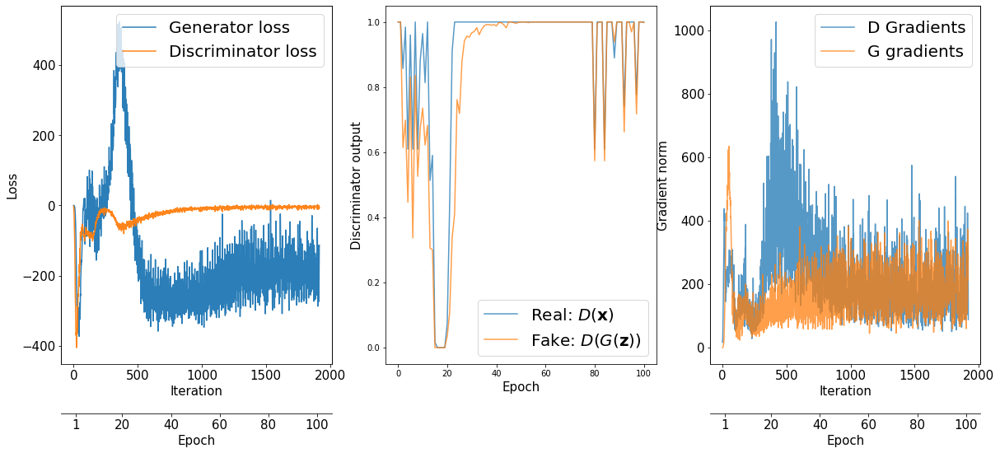

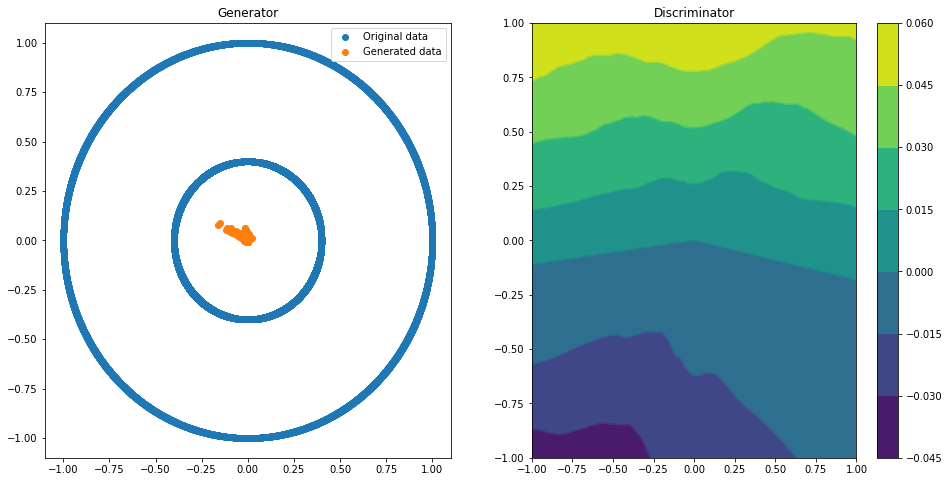

Epoch 000 | ET 1.31 min | Avg Losses >> G/D 0.1069/-0.2307
Epoch 005 | ET 2.91 min | Avg Losses >> G/D 0.8181/-0.0623
Epoch 010 | ET 4.42 min | Avg Losses >> G/D 0.0075/-0.0686
Epoch 015 | ET 5.93 min | Avg Losses >> G/D -4.4582/-0.1928


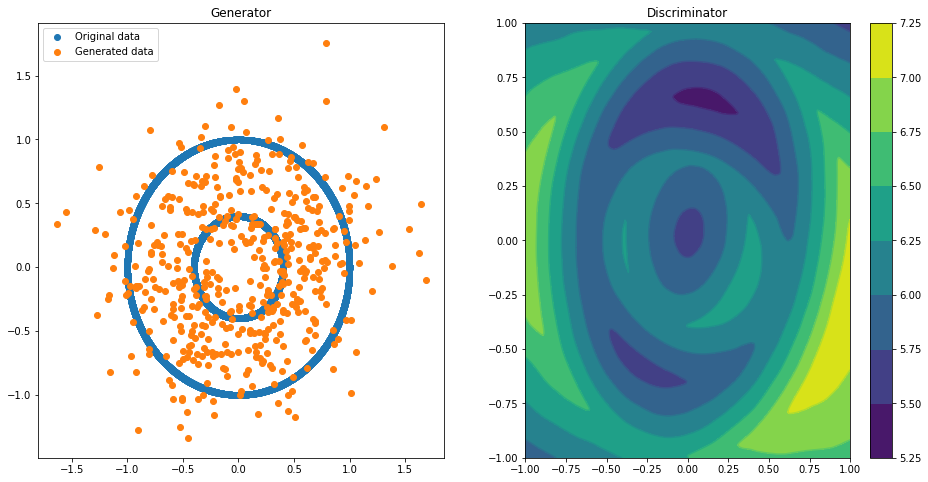

Epoch 020 | ET 8.46 min | Avg Losses >> G/D -5.9867/-0.2477


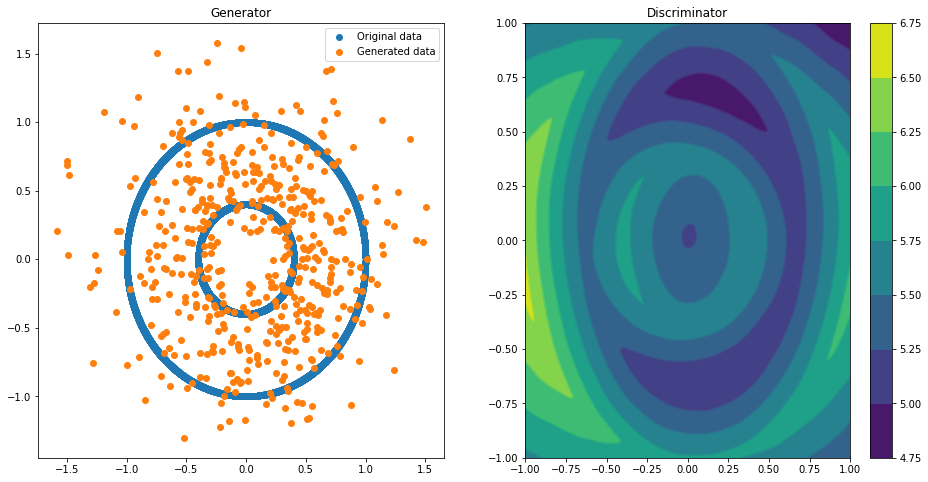

Epoch 025 | ET 10.98 min | Avg Losses >> G/D -5.4482/-0.2452
Epoch 030 | ET 12.60 min | Avg Losses >> G/D -5.1525/-0.2349
Epoch 035 | ET 14.10 min | Avg Losses >> G/D -5.0234/-0.1945


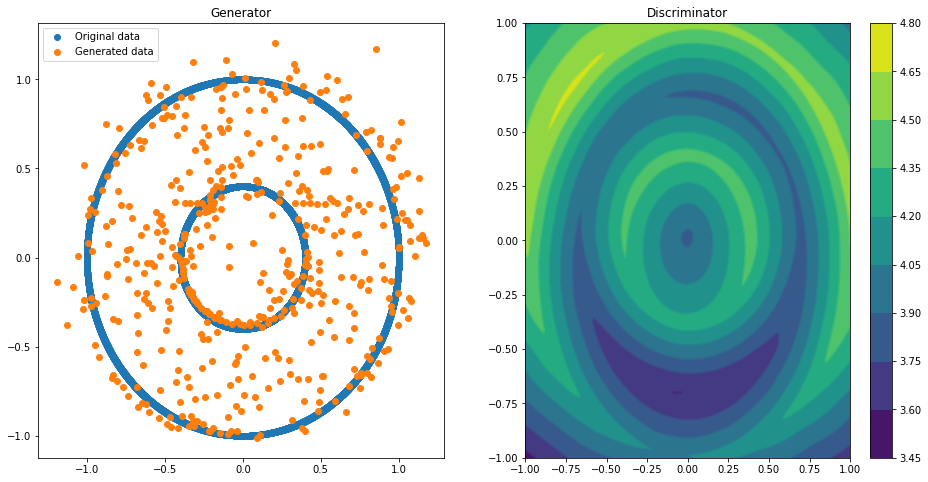

Epoch 040 | ET 16.60 min | Avg Losses >> G/D -4.2134/-0.1469
Epoch 045 | ET 18.10 min | Avg Losses >> G/D -3.4134/-0.1138


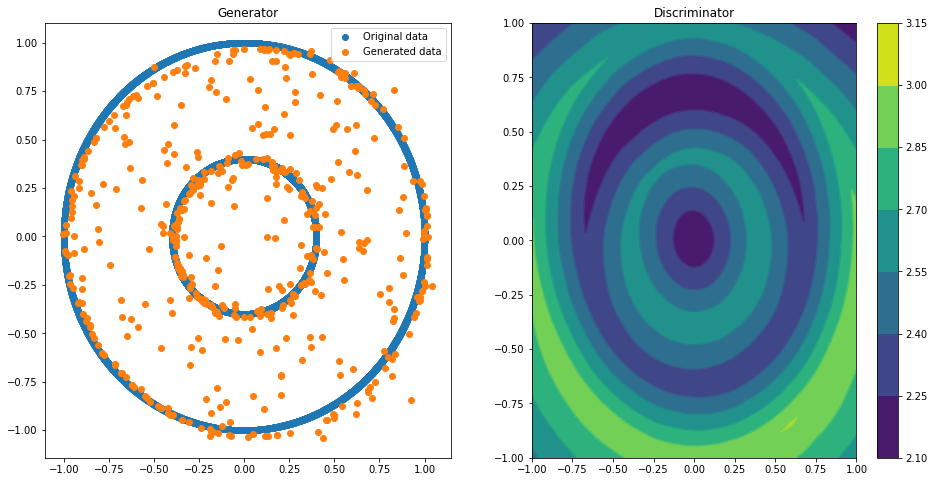

Epoch 050 | ET 20.60 min | Avg Losses >> G/D -2.6292/-0.1051
Epoch 055 | ET 22.11 min | Avg Losses >> G/D -2.2723/-0.0853


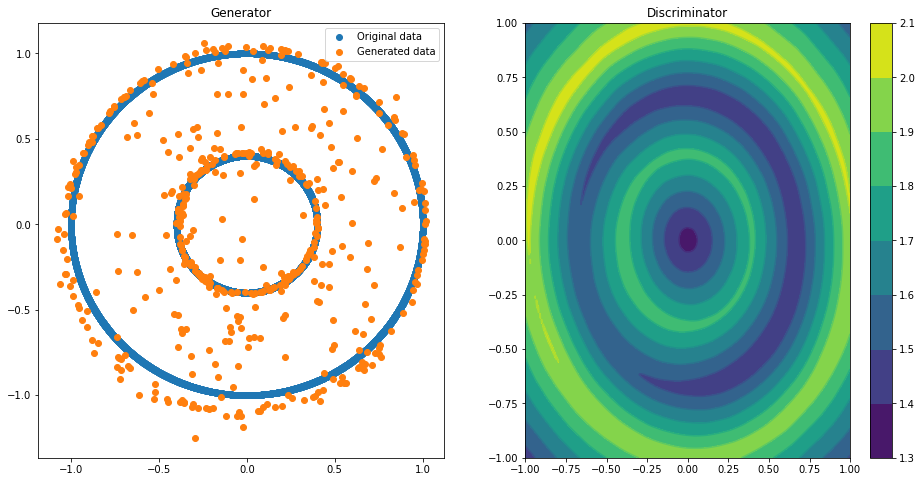

Epoch 060 | ET 24.71 min | Avg Losses >> G/D -1.8370/-0.0809
Epoch 065 | ET 26.21 min | Avg Losses >> G/D -1.5762/-0.0789
Epoch 070 | ET 27.71 min | Avg Losses >> G/D -1.4288/-0.0736


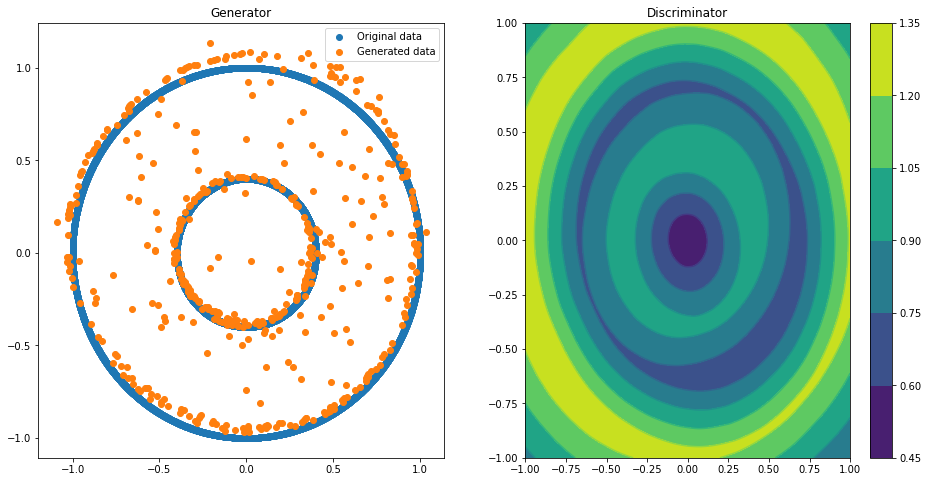

Epoch 075 | ET 30.23 min | Avg Losses >> G/D -1.1965/-0.0695


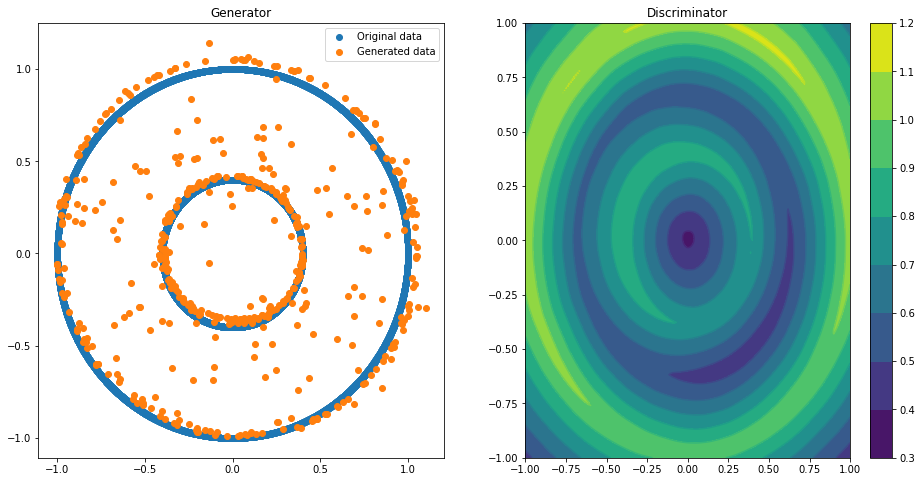

Epoch 080 | ET 32.85 min | Avg Losses >> G/D -1.0067/-0.0684
Epoch 085 | ET 34.38 min | Avg Losses >> G/D -0.7305/-0.0624
Epoch 090 | ET 35.91 min | Avg Losses >> G/D -0.6183/-0.0646
Epoch 095 | ET 37.44 min | Avg Losses >> G/D -0.6357/-0.0598


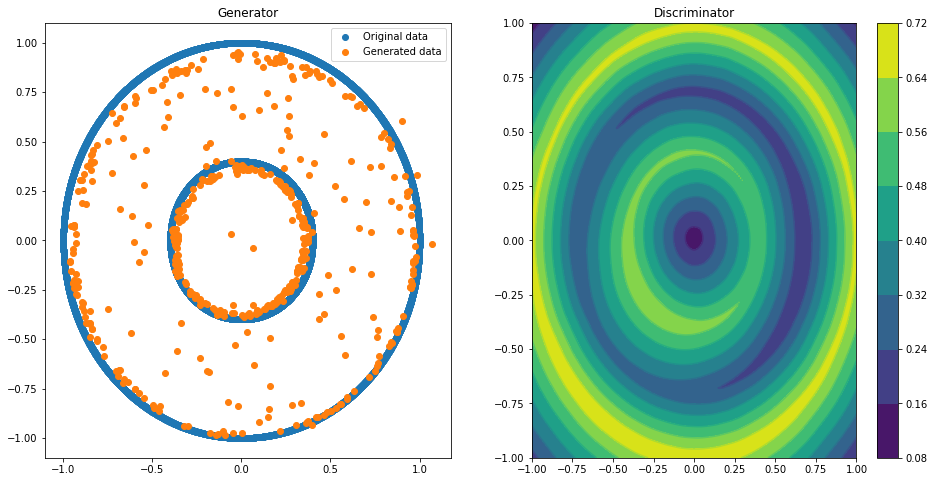

Epoch 100 | ET 39.99 min | Avg Losses >> G/D -0.5619/-0.0585


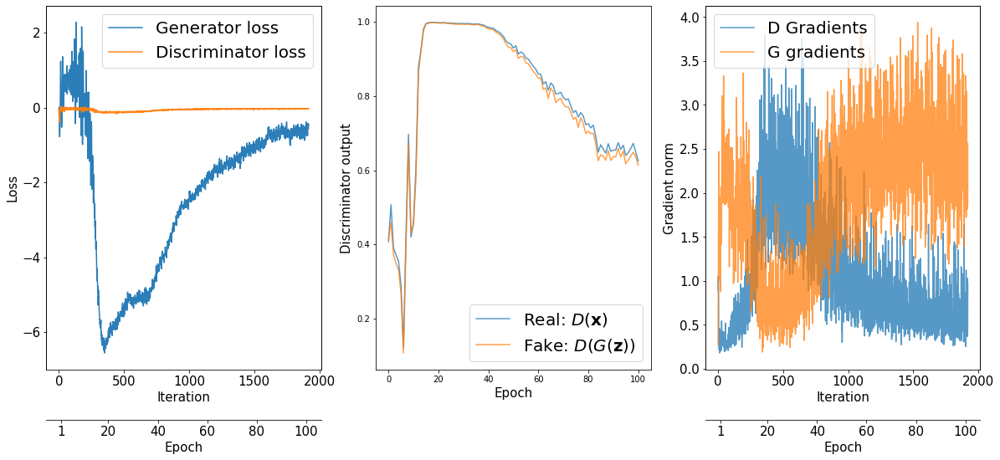

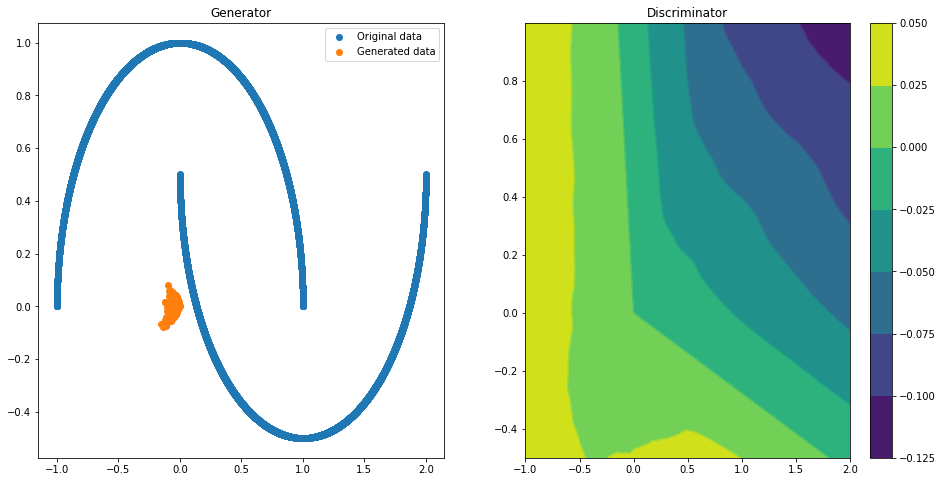

Epoch 000 | ET 1.31 min | Avg Losses >> G/D -0.5540/-0.8878
Epoch 005 | ET 2.91 min | Avg Losses >> G/D 4.0336/-0.3354
Epoch 010 | ET 4.42 min | Avg Losses >> G/D 1.0412/-0.2102
Epoch 015 | ET 5.92 min | Avg Losses >> G/D 0.1906/-0.1684


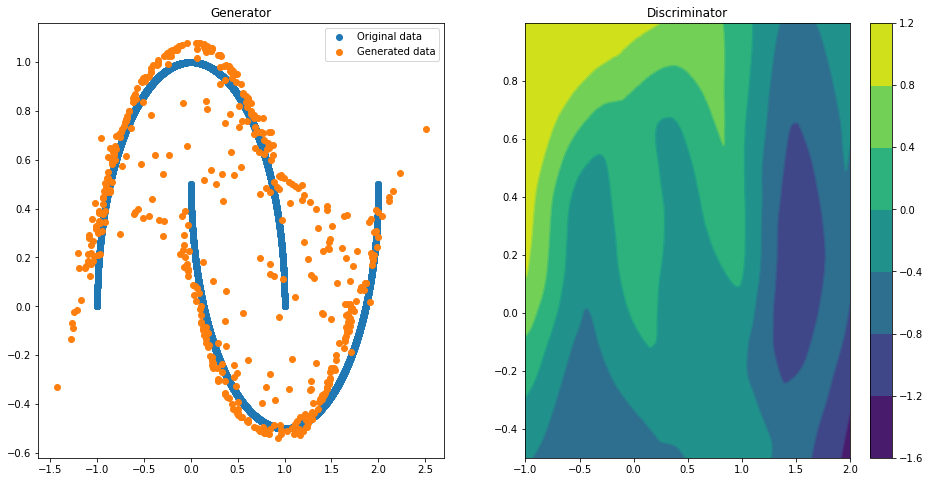

Epoch 020 | ET 8.44 min | Avg Losses >> G/D -0.1080/-0.1336


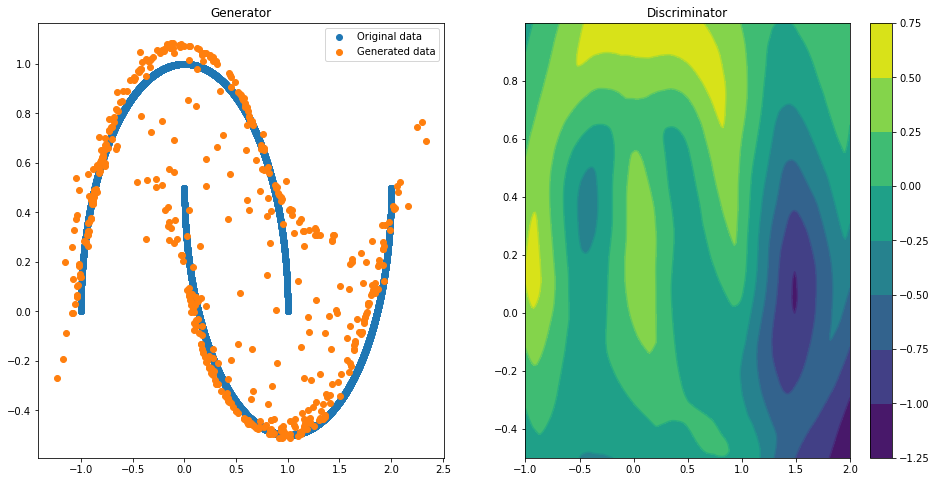

Epoch 025 | ET 10.94 min | Avg Losses >> G/D -0.0855/-0.1174
Epoch 030 | ET 12.46 min | Avg Losses >> G/D -0.1247/-0.1029
Epoch 035 | ET 14.06 min | Avg Losses >> G/D -0.0305/-0.0957


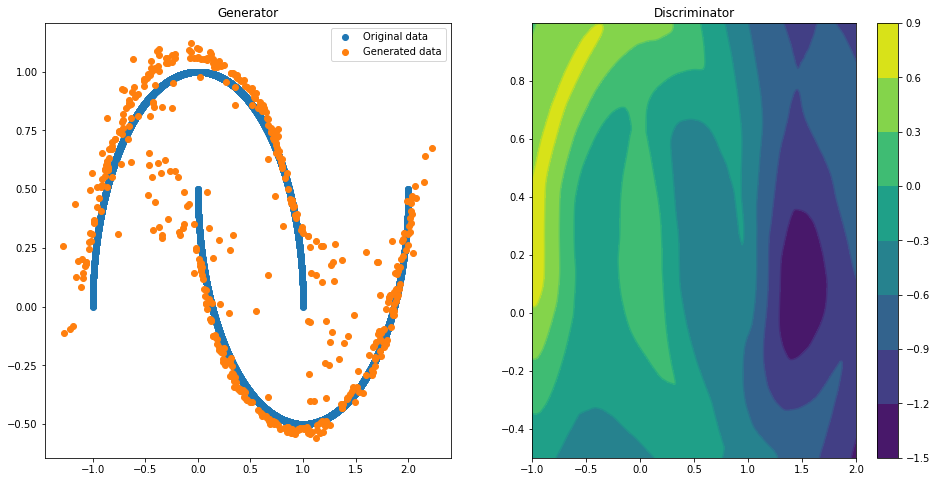

Epoch 040 | ET 16.56 min | Avg Losses >> G/D 0.0747/-0.1034
Epoch 045 | ET 18.05 min | Avg Losses >> G/D -0.0331/-0.0933


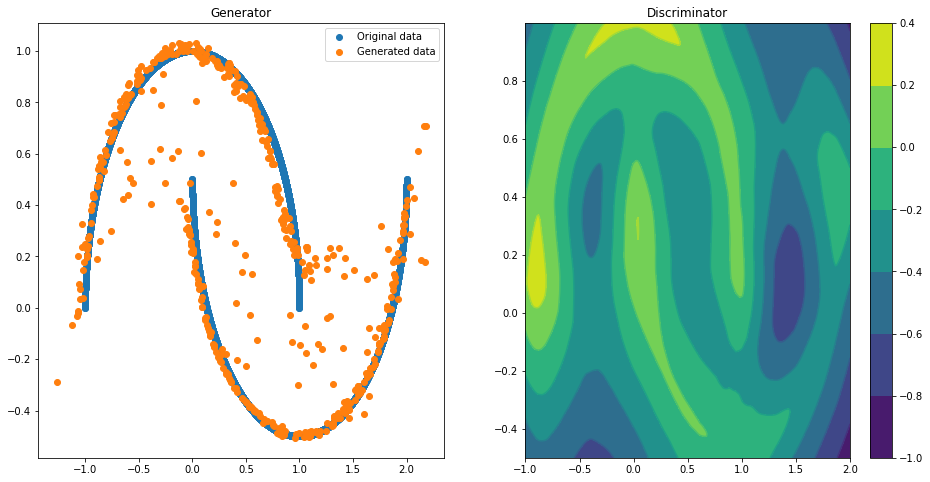

Epoch 050 | ET 20.55 min | Avg Losses >> G/D 0.0828/-0.0948
Epoch 055 | ET 22.04 min | Avg Losses >> G/D 0.0122/-0.0740


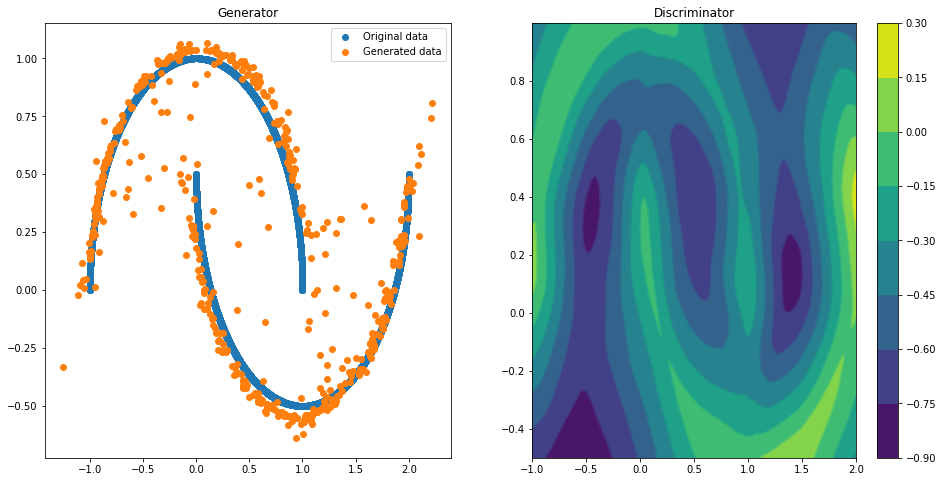

Epoch 060 | ET 24.54 min | Avg Losses >> G/D 0.0904/-0.0894
Epoch 065 | ET 26.06 min | Avg Losses >> G/D -0.0127/-0.0811
Epoch 070 | ET 27.57 min | Avg Losses >> G/D -0.0930/-0.0739


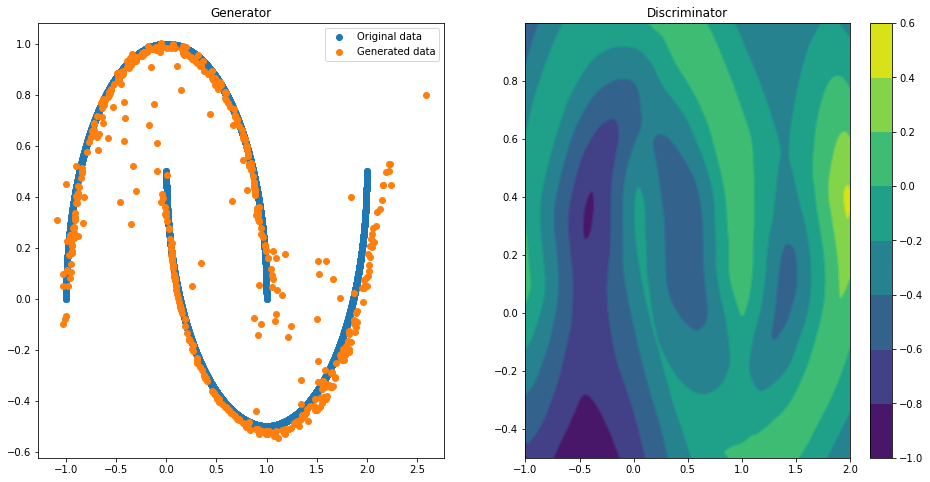

Epoch 075 | ET 30.08 min | Avg Losses >> G/D 0.0627/-0.0744


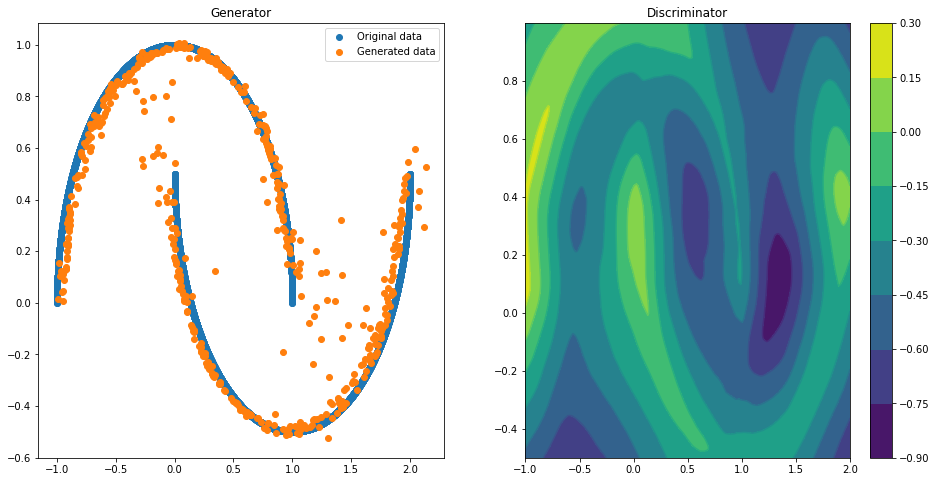

Epoch 080 | ET 32.59 min | Avg Losses >> G/D 0.1919/-0.0707
Epoch 085 | ET 34.20 min | Avg Losses >> G/D 0.2580/-0.0650
Epoch 090 | ET 35.73 min | Avg Losses >> G/D 0.1850/-0.0664
Epoch 095 | ET 37.25 min | Avg Losses >> G/D 0.2291/-0.0738


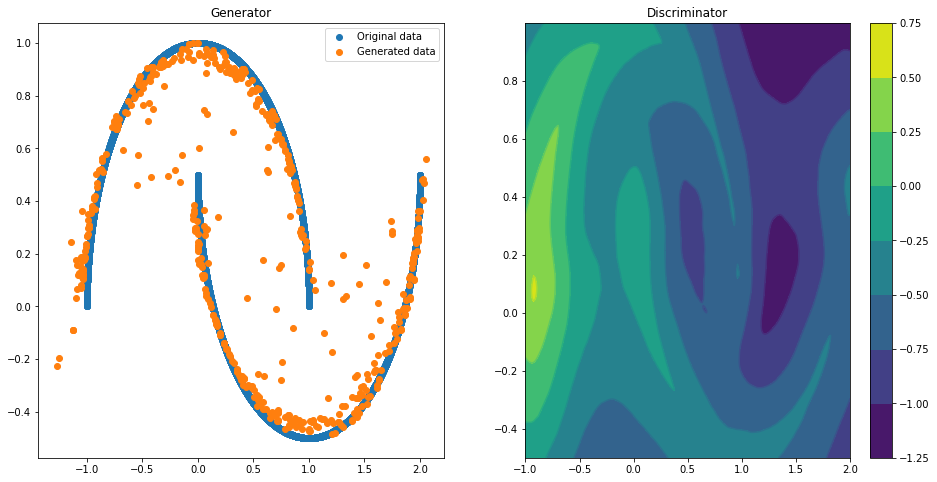

Epoch 100 | ET 39.79 min | Avg Losses >> G/D 0.2338/-0.0703


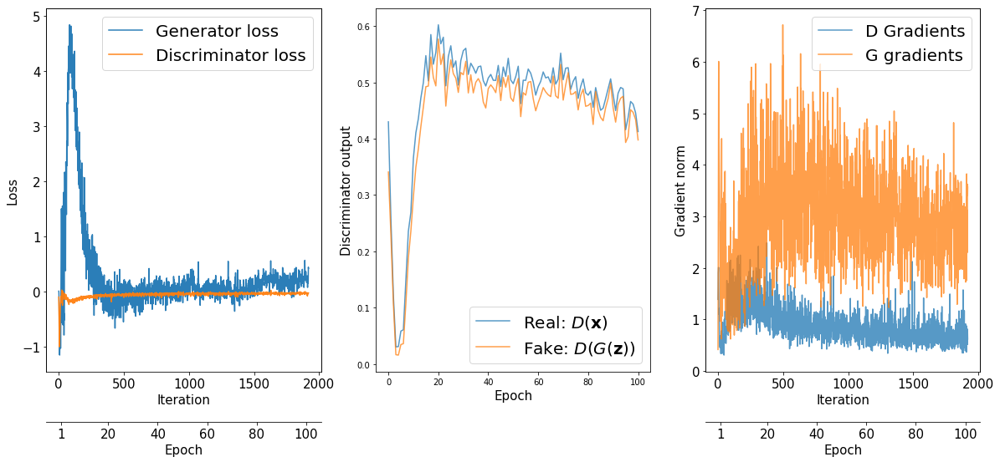

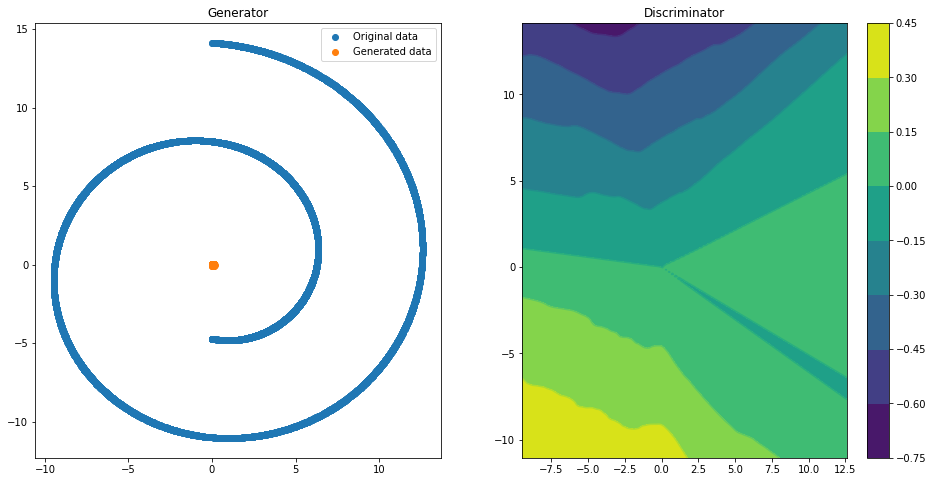

Epoch 000 | ET 1.31 min | Avg Losses >> G/D -22.7533/-84.8314
Epoch 005 | ET 2.82 min | Avg Losses >> G/D 3.1549/-0.7747
Epoch 010 | ET 4.41 min | Avg Losses >> G/D 27.6649/-1.1691
Epoch 015 | ET 5.93 min | Avg Losses >> G/D 89.4894/-9.7058


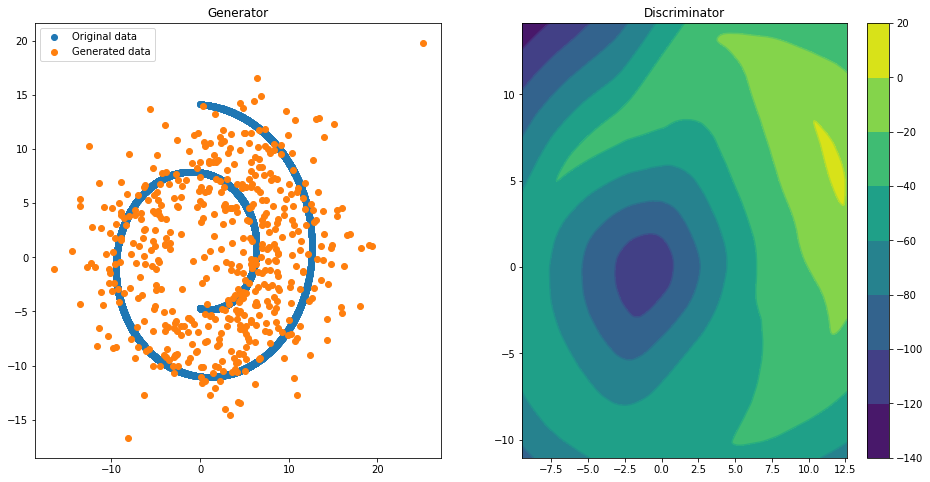

Epoch 020 | ET 8.45 min | Avg Losses >> G/D 40.2126/-6.4170


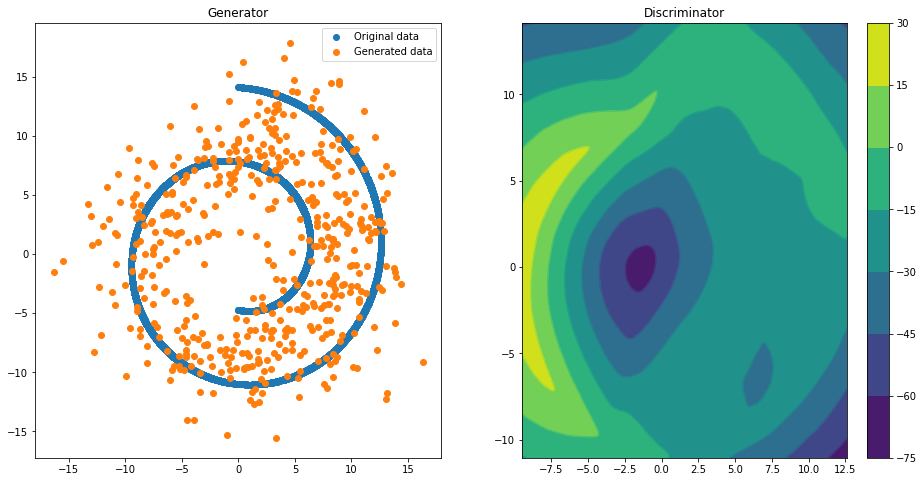

Epoch 025 | ET 10.98 min | Avg Losses >> G/D 6.9508/-6.1707
Epoch 030 | ET 12.48 min | Avg Losses >> G/D -85.9950/-8.7871
Epoch 035 | ET 14.11 min | Avg Losses >> G/D -140.4272/-8.5913


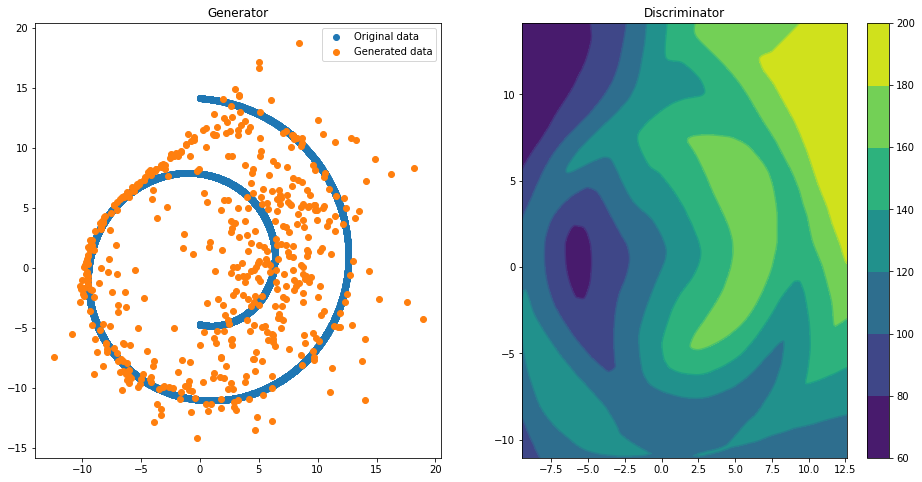

Epoch 040 | ET 16.62 min | Avg Losses >> G/D -150.9303/-8.3110
Epoch 045 | ET 18.13 min | Avg Losses >> G/D -148.5643/-7.8884


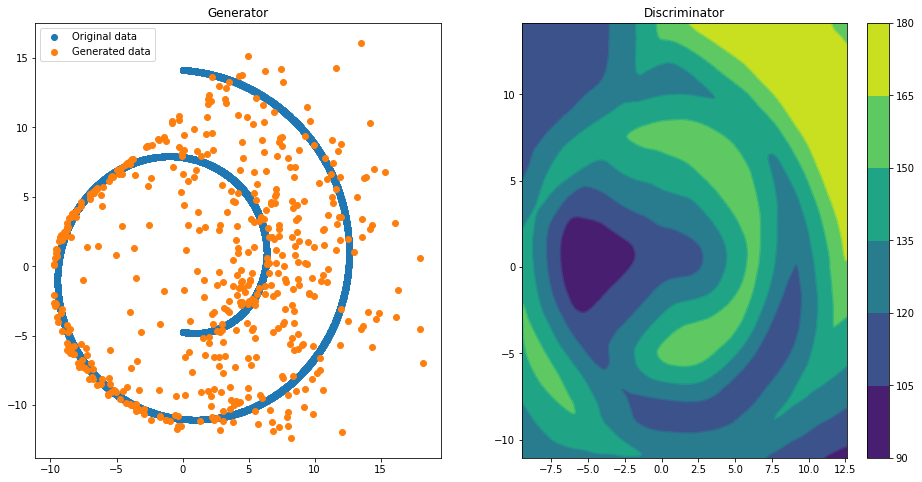

Epoch 050 | ET 20.65 min | Avg Losses >> G/D -141.5429/-7.8844
Epoch 055 | ET 22.16 min | Avg Losses >> G/D -140.2943/-8.0144


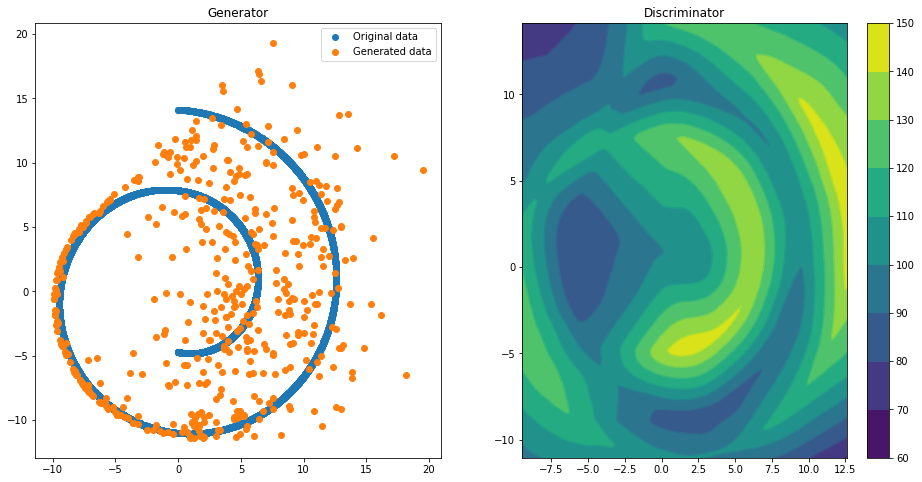

Epoch 060 | ET 24.75 min | Avg Losses >> G/D -131.3349/-8.1119
Epoch 065 | ET 26.27 min | Avg Losses >> G/D -123.5755/-8.2046
Epoch 070 | ET 27.77 min | Avg Losses >> G/D -123.8585/-7.6246


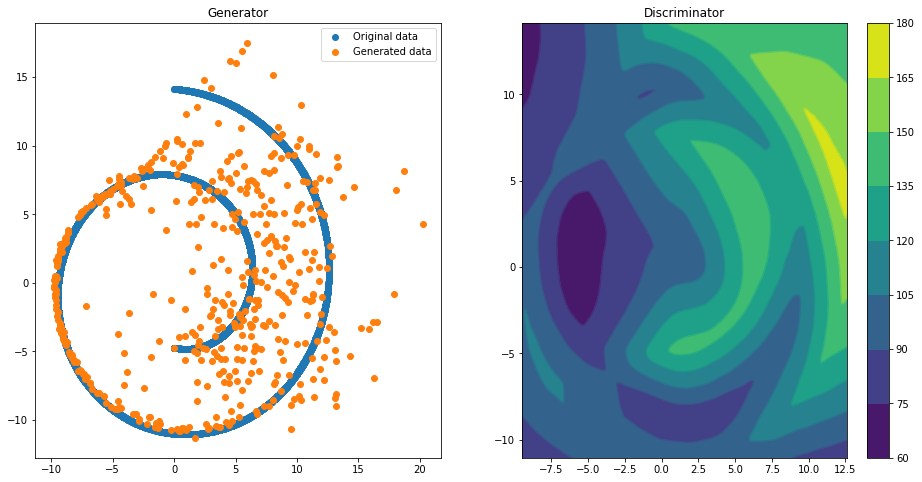

Epoch 075 | ET 30.30 min | Avg Losses >> G/D -123.2228/-7.6122


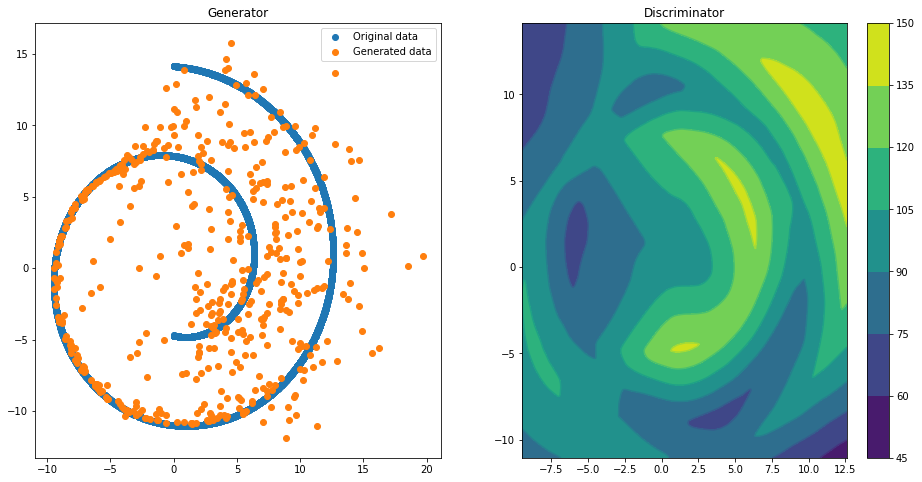

Epoch 080 | ET 32.81 min | Avg Losses >> G/D -119.0844/-7.0170
Epoch 085 | ET 34.43 min | Avg Losses >> G/D -121.2360/-7.2955
Epoch 090 | ET 35.93 min | Avg Losses >> G/D -123.8865/-6.7012
Epoch 095 | ET 37.45 min | Avg Losses >> G/D -126.9156/-6.9997


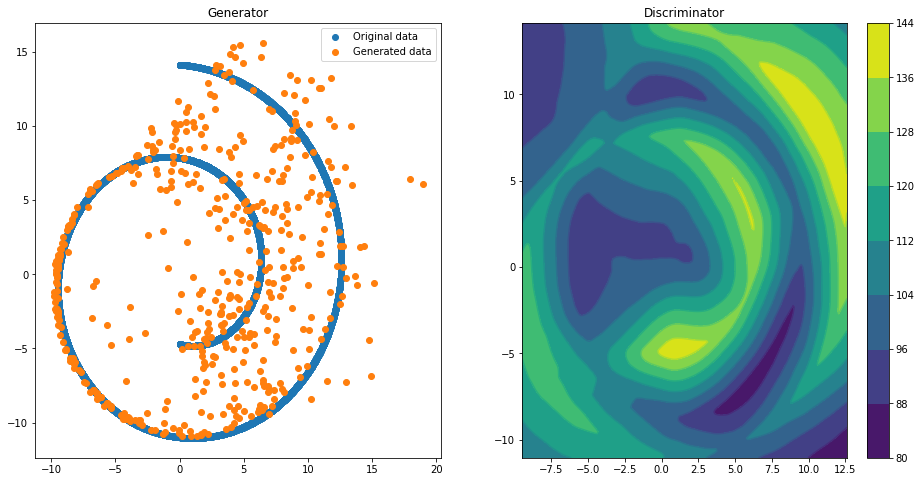

Epoch 100 | ET 39.98 min | Avg Losses >> G/D -118.6413/-6.8758


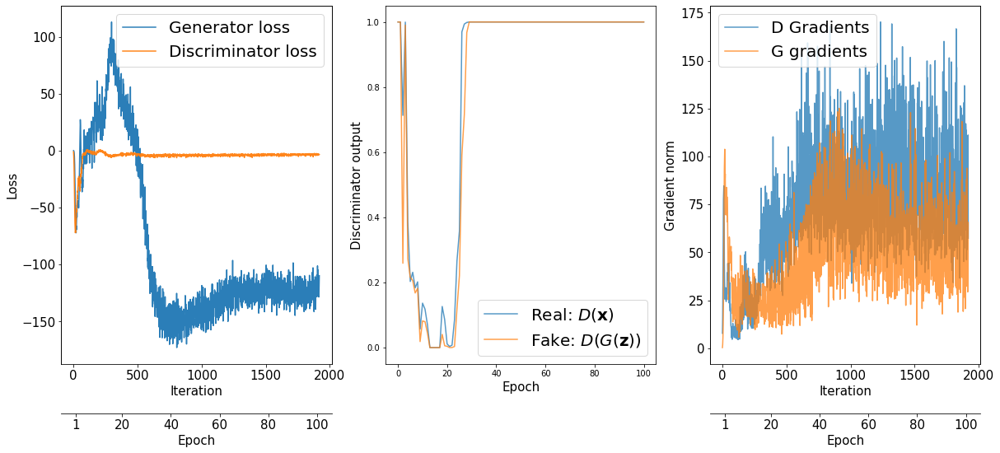

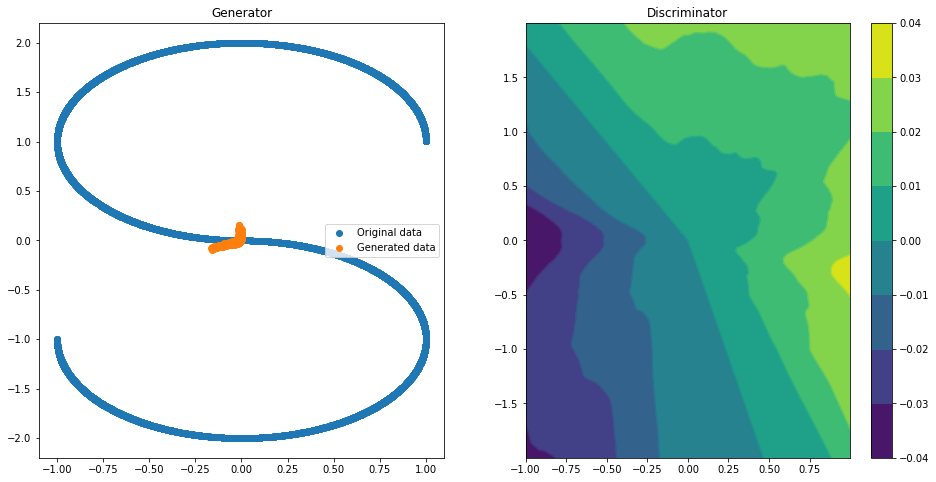

Epoch 000 | ET 1.32 min | Avg Losses >> G/D -1.3837/-1.1700
Epoch 005 | ET 2.87 min | Avg Losses >> G/D 0.3206/-0.8472
Epoch 010 | ET 4.54 min | Avg Losses >> G/D -3.5348/-0.7985
Epoch 015 | ET 6.10 min | Avg Losses >> G/D -2.7809/-0.4106


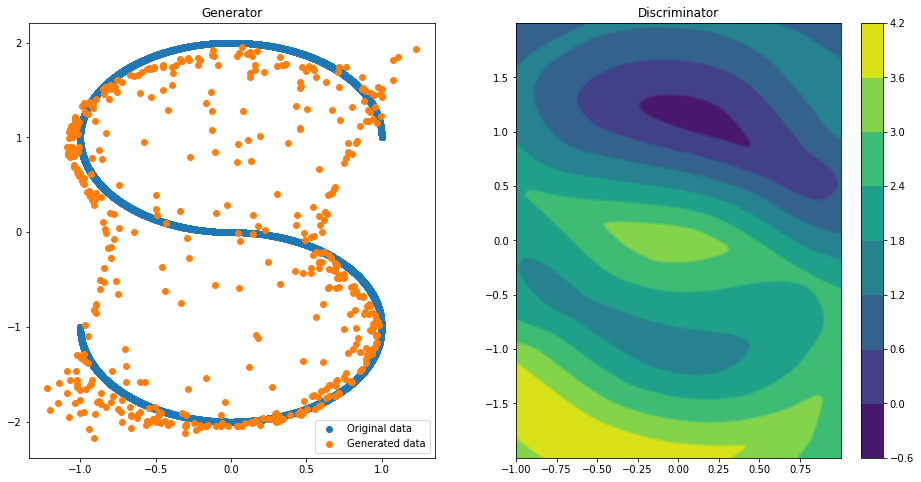

Epoch 020 | ET 8.68 min | Avg Losses >> G/D -2.0407/-0.3013


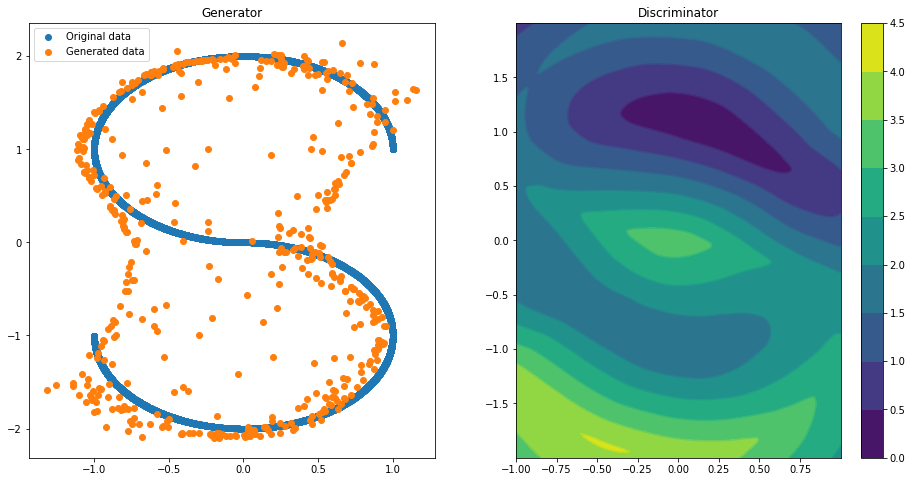

Epoch 025 | ET 11.26 min | Avg Losses >> G/D -1.7798/-0.2444
Epoch 030 | ET 12.83 min | Avg Losses >> G/D -1.8164/-0.2123
Epoch 035 | ET 14.40 min | Avg Losses >> G/D -1.8184/-0.1949


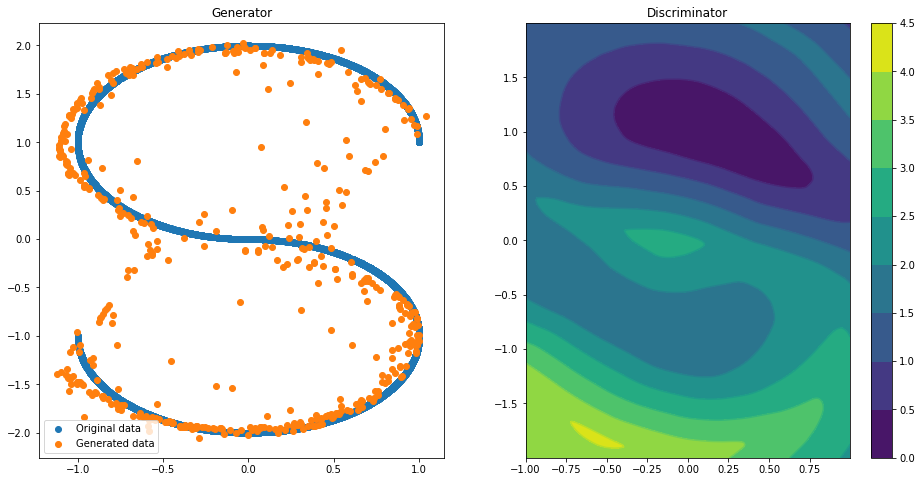

Epoch 040 | ET 17.10 min | Avg Losses >> G/D -1.7643/-0.1944
Epoch 045 | ET 18.66 min | Avg Losses >> G/D -1.5555/-0.1675


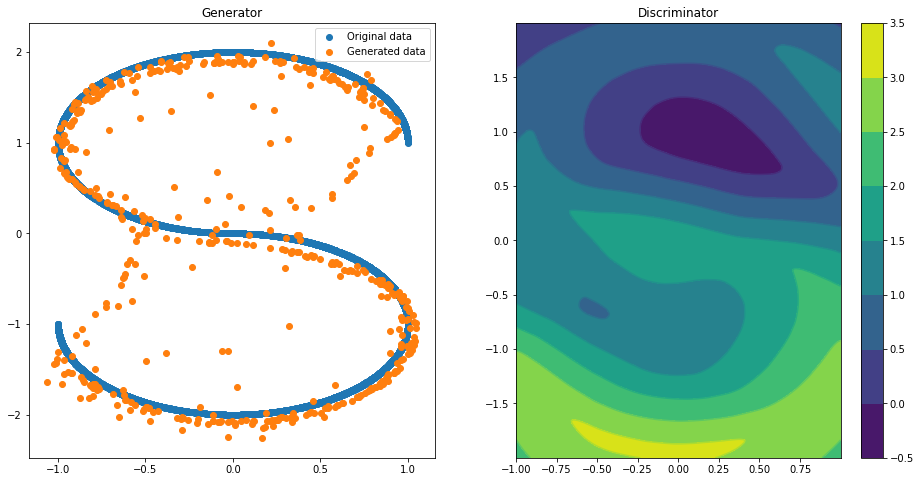

Epoch 050 | ET 21.24 min | Avg Losses >> G/D -1.5836/-0.1384
Epoch 055 | ET 22.80 min | Avg Losses >> G/D -1.3989/-0.1523


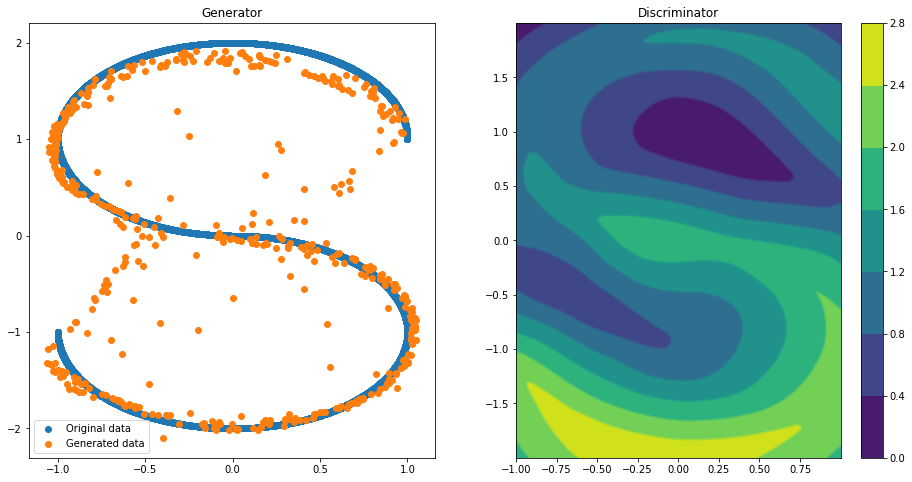

Epoch 060 | ET 25.41 min | Avg Losses >> G/D -1.5189/-0.1247
Epoch 065 | ET 26.97 min | Avg Losses >> G/D -1.5504/-0.1237
Epoch 070 | ET 28.53 min | Avg Losses >> G/D -1.4899/-0.1254


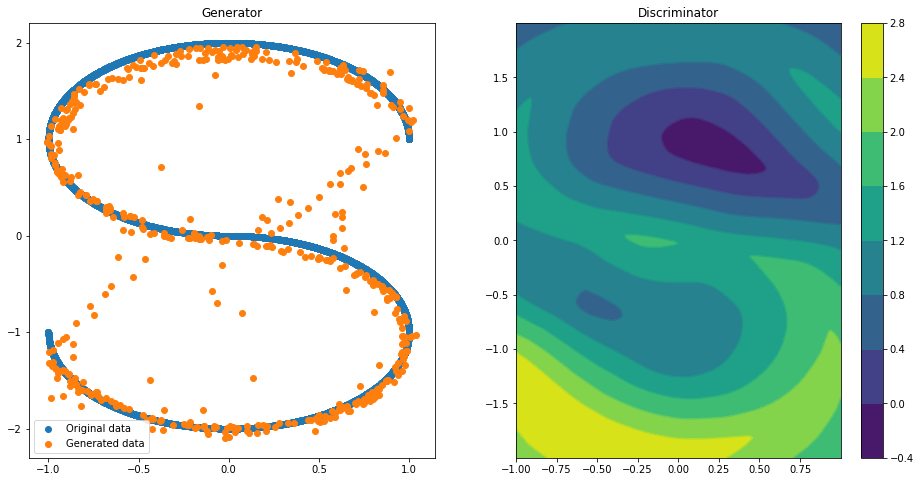

Epoch 075 | ET 31.10 min | Avg Losses >> G/D -1.4511/-0.1296


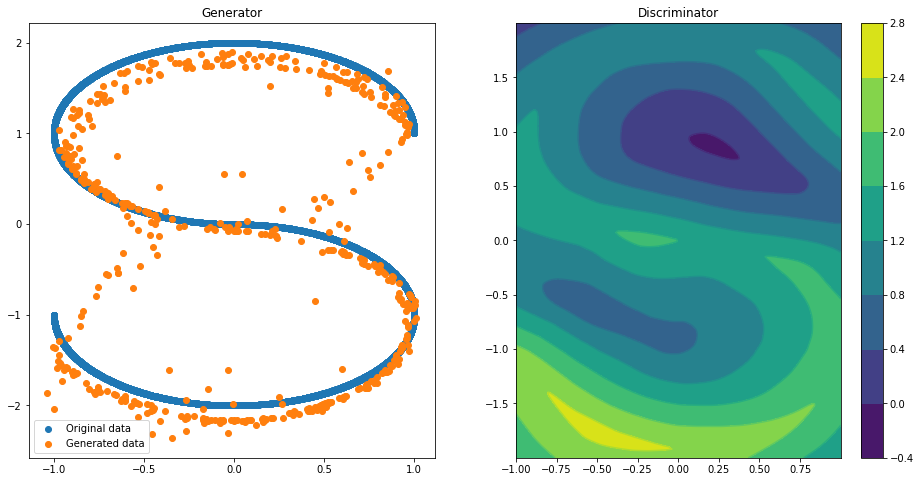

Epoch 080 | ET 33.67 min | Avg Losses >> G/D -1.4409/-0.1285
Epoch 085 | ET 35.25 min | Avg Losses >> G/D -1.3829/-0.1590
Epoch 090 | ET 36.82 min | Avg Losses >> G/D -1.4618/-0.1172
Epoch 095 | ET 38.40 min | Avg Losses >> G/D -1.4697/-0.1092


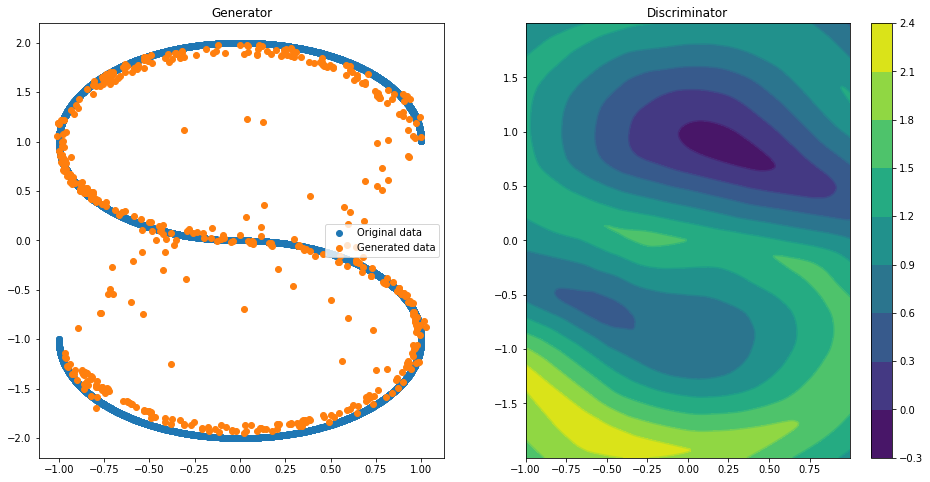

Epoch 100 | ET 41.13 min | Avg Losses >> G/D -1.3363/-0.1047


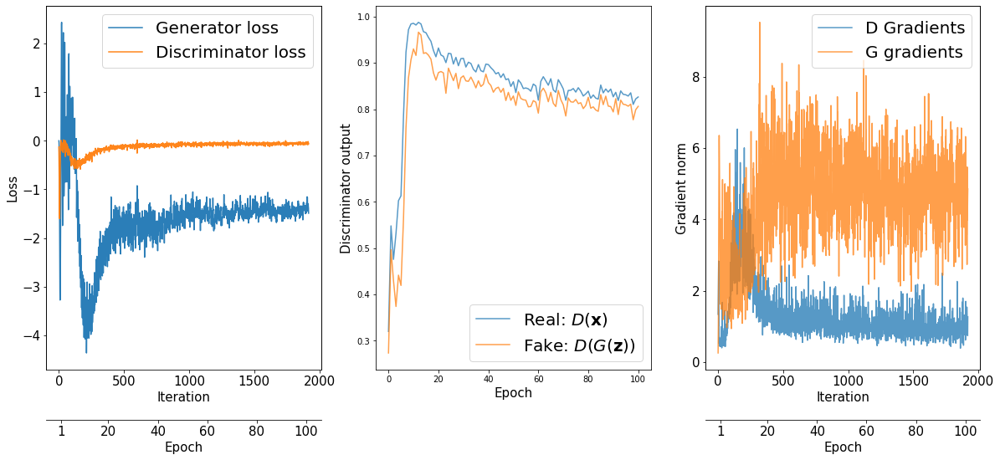

In [ ]:
z_size = 2
num_epochs = 100
batch_size = 512
gp_weight = .10
device_name = tf.test.gpu_device_name()
for current_data in [quadratic, circle, mixture, blobs, circles, moons, swiss_roll, s_curve]:
  numpy_data = current_data
  data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size, drop_remainder=True)
  fixed_z = tf.random.normal(shape=[500, z_size])

  generator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  discriminator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  with tf.device(device_name):
    gen_model = make_generator_network()
    gen_model.build(input_shape=(None,z_size))
    disc_model = make_discriminator_network()
    disc_model.build(input_shape=(None,2))
    
  all_losses = []
  all_d_vals = []
  d_gradients = []
  g_gradients = []
  epoch_samples = []
  start_time = time.time()
  for epoch in range(0, num_epochs+1):
    epoch_losses, epoch_d_vals = [], []
    #Plotting every 50
    if (epoch%20 == 0) or (epoch%25==0):
        input_z = tf.random.normal(shape = (500,z_size))
        epoch_samples.append(gen_model(input_z, training=False).numpy())
        X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
        x = np.linspace(np.min(X_data), np.max(X_data), 200)
        y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
        X, Y = np.meshgrid(x, y)
        Z = np.zeros((len(x), len(y)))
        for i in range(len(x)):
          for j in range(len(y)):
            q = tf.convert_to_tensor(np.array([[x[j],y[i]]]).astype("float32"))
            Z[i][j] = disc_model(q).numpy()[0][0]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
        ax1.scatter(X_data,Y_data, label = "Original data")
        ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
        ax1.set_title("Generator")
        ax1.legend()
        ax2.contour(X,Y,Z)
        ax2.set_title("Discriminator")
        cp = ax2.contourf(X , Y , Z)
        plt.colorbar(cp, ax=ax2)
        plt.show()
    for batch in data:
      for i in range(5):
        random_latent_vectors = tf.random.normal(shape=[batch_size,z_size])
        with tf.GradientTape() as tape:
          fake_data = gen_model(random_latent_vectors, training=True)
          fake_logits = disc_model(fake_data, training=True)
          real_logits = disc_model(batch, training=True)
          d_cost = discriminator_loss(real_logits,fake_logits)
          gp = gradient_penalty(batch_size, batch, fake_data, disc_model)
          d_loss = d_cost + gp* gp_weight
        d_gradient = tape.gradient(d_loss, disc_model.trainable_variables)
        discriminator_optimizer.apply_gradients(zip(d_gradient,disc_model.trainable_variables))
      random_latent_vectors = tf.random.normal(shape=(batch_size, z_size))
      with tf.GradientTape() as tape:
        fake_data = gen_model(random_latent_vectors, training=True)
        fake_logits = disc_model(fake_data, training=True)
        g_loss = generator_loss(fake_logits)
      gen_gradient = tape.gradient(g_loss, gen_model.trainable_variables)
      generator_optimizer.apply_gradients(zip(gen_gradient,gen_model.trainable_variables))

      epoch_losses.append(
                            (g_loss.numpy(), d_loss.numpy())
                            )
      d_probs_real = tf.reduce_mean(
                            tf.sigmoid(real_logits))
      d_probs_fake = tf.reduce_mean(
                            tf.sigmoid(fake_logits))
      g_gradients.append(tf.linalg.global_norm(gen_gradient).numpy())
      d_gradients.append(tf.linalg.global_norm(d_gradient).numpy())
    epoch_d_vals.append((d_probs_real.numpy(),
                            d_probs_fake.numpy()))
    
    all_losses.append(epoch_losses)
    all_d_vals.append(epoch_d_vals)
      
    if epoch%5 == 0:
        print(
              'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
              ' G/D {:.4f}/{:.4f}'
              .format(
              epoch, (time.time() - start_time)/60,
              *list(np.mean(all_losses[-1], axis=0))))
  fig = plt.figure(figsize=(20, 8))

  ## Plotting the losses
  ax = fig.add_subplot(1, 3, 1)
  g_losses = [item[0] for item in itertools.chain(*all_losses)]
  d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
  plt.plot(g_losses, label='Generator loss', alpha=0.95)
  plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Loss', size=15)

  epochs = np.arange(1, 101)
  epoch2iter = lambda e: e*len(all_losses[-1])
  epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
  newpos = [epoch2iter(e) for e in epoch_ticks]
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  ## Plotting the outputs of the discriminator
  ax = fig.add_subplot(1, 3, 2)
  d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
  d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
  plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
  plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
  plt.legend(fontsize=20)
  ax.set_xlabel('Epoch', size=15)
  ax.set_ylabel('Discriminator output', size=15)


  ax = fig.add_subplot(1, 3, 3)
  plt.plot(d_gradients, label = "D Gradients", alpha=.75)
  plt.plot(g_gradients, label = "G gradients", alpha = .75)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Gradient norm', size=15)
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  #plt.savefig('images/ch17-gan-learning-curve.pdf')
  plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:26: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


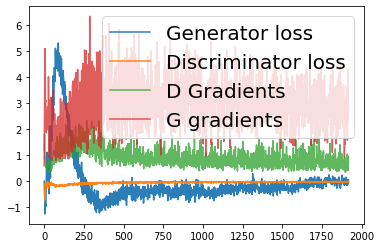

In [ ]:
import itertools
## Plotting the losses
ax = fig.add_subplot(1, 2, 1)
g_losses = [item[0] for item in itertools.chain(*all_losses)]
d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
plt.plot(g_losses, label='Generator loss', alpha=0.95)
plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
plt.legend(fontsize=20)
ax.set_xlabel('Iteration', size=15)
ax.set_ylabel('Loss', size=15)
epochs = np.arange(1, 101)
epoch2iter = lambda e: e*len(all_losses[-1])
epoch_ticks = [1, 20, 40, 60, 80, 100]
newpos = [epoch2iter(e) for e in epoch_ticks]
ax2 = ax.twiny()
ax2.set_xticks(newpos)
ax2.set_xticklabels(epoch_ticks)
ax2.xaxis.set_ticks_position('bottom')
ax2.xaxis.set_label_position('bottom')
ax2.spines['bottom'].set_position(('outward', 60))
ax2.set_xlabel('Epoch', size=15)
ax2.set_xlim(ax.get_xlim())
ax.tick_params(axis='both', which='major', labelsize=15)
ax2.tick_params(axis='both', which='major', labelsize=15)

ax2 = fig.add_subplot(1, 2, 2)
plt.plot(d_gradients, label = "D Gradients", alpha=.75)
plt.plot(g_gradients, label = "G gradients", alpha = .75)
plt.legend(fontsize=20)
ax.set_xlabel('Iteration', size=15)
ax.set_ylabel('Gradient norm', size=15)
ax2 = ax.twiny()
ax2.set_xticks(newpos)
ax2.set_xticklabels(epoch_ticks)
ax2.xaxis.set_ticks_position('bottom')
ax2.xaxis.set_label_position('bottom')
ax2.spines['bottom'].set_position(('outward', 60))
ax2.set_xlabel('Epoch', size=15)
ax2.set_xlim(ax.get_xlim())
ax.tick_params(axis='both', which='major', labelsize=15)
ax2.tick_params(axis='both', which='major', labelsize=15)

#plt.savefig('images/ch17-gan-learning-curve.pdf')
plt.show()

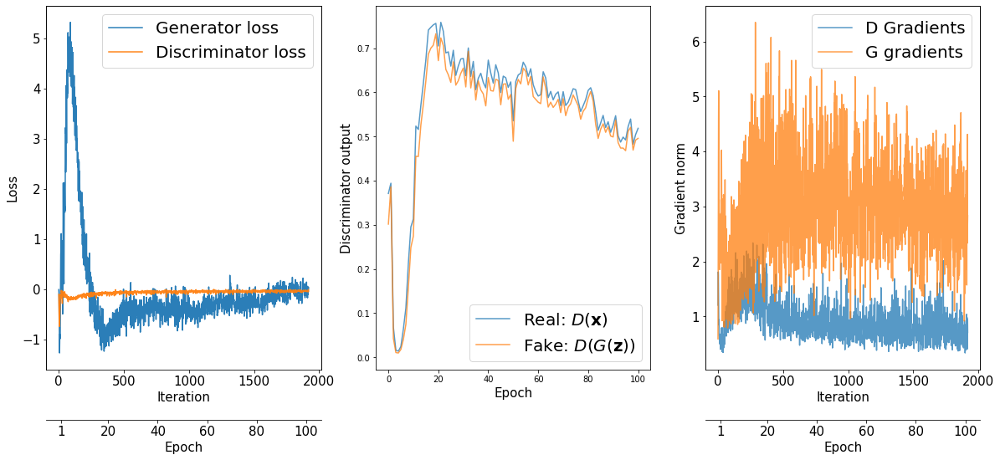

In [ ]:
fig = plt.figure(figsize=(20, 8))

## Plotting the losses
ax = fig.add_subplot(1, 3, 1)
g_losses = [item[0] for item in itertools.chain(*all_losses)]
d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
plt.plot(g_losses, label='Generator loss', alpha=0.95)
plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
plt.legend(fontsize=20)
ax.set_xlabel('Iteration', size=15)
ax.set_ylabel('Loss', size=15)

epochs = np.arange(1, 101)
epoch2iter = lambda e: e*len(all_losses[-1])
epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
newpos = [epoch2iter(e) for e in epoch_ticks]
ax2 = ax.twiny()
ax2.set_xticks(newpos)
ax2.set_xticklabels(epoch_ticks)
ax2.xaxis.set_ticks_position('bottom')
ax2.xaxis.set_label_position('bottom')
ax2.spines['bottom'].set_position(('outward', 60))
ax2.set_xlabel('Epoch', size=15)
ax2.set_xlim(ax.get_xlim())
ax.tick_params(axis='both', which='major', labelsize=15)
ax2.tick_params(axis='both', which='major', labelsize=15)

## Plotting the outputs of the discriminator
ax = fig.add_subplot(1, 3, 2)
d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
plt.legend(fontsize=20)
ax.set_xlabel('Epoch', size=15)
ax.set_ylabel('Discriminator output', size=15)


ax = fig.add_subplot(1, 3, 3)
plt.plot(d_gradients, label = "D Gradients", alpha=.75)
plt.plot(g_gradients, label = "G gradients", alpha = .75)
plt.legend(fontsize=20)
ax.set_xlabel('Iteration', size=15)
ax.set_ylabel('Gradient norm', size=15)
ax2 = ax.twiny()
ax2.set_xticks(newpos)
ax2.set_xticklabels(epoch_ticks)
ax2.xaxis.set_ticks_position('bottom')
ax2.xaxis.set_label_position('bottom')
ax2.spines['bottom'].set_position(('outward', 60))
ax2.set_xlabel('Epoch', size=15)
ax2.set_xlim(ax.get_xlim())
ax.tick_params(axis='both', which='major', labelsize=15)
ax2.tick_params(axis='both', which='major', labelsize=15)

#plt.savefig('images/ch17-gan-learning-curve.pdf')
plt.show()

In [ ]:
z_size = 2
num_epochs = 100
batch_size = 512
gp_weight = .10
device_name = tf.test.gpu_device_name()
for current_data in [quadratic, circle, mixture, blobs, circles, moons, swiss_roll, s_curve]:
  numpy_data = current_data
  data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size, drop_remainder=True)
  fixed_z = tf.random.normal(shape=[500, z_size])

  generator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  discriminator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  with tf.device(device_name):
    gen_model = make_generator_network()
    gen_model.build(input_shape=(None,z_size))
    disc_model = make_discriminator_network()
    disc_model.build(input_shape=(None,2))
    
  all_losses = []
  all_d_vals = []
  d_gradients = []
  g_gradients = []
  epoch_samples = []
  start_time = time.time()
  for epoch in range(0, num_epochs+1):
    epoch_losses, epoch_d_vals = [], []
    #Plotting every 50
    if (epoch%20 == 0) or (epoch%25==0):
        input_z = tf.random.normal(shape = (500,z_size))
        epoch_samples.append(gen_model(input_z, training=False).numpy())
        X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
        x = np.linspace(np.min(X_data), np.max(X_data), 200)
        y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
        X, Y = np.meshgrid(x, y)
        Z = np.zeros((len(x), len(y)))
        for i in range(len(x)):
          for j in range(len(y)):
            q = tf.convert_to_tensor(np.array([[x[j],y[i]]]).astype("float32"))
            Z[i][j] = disc_model(q).numpy()[0][0]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
        ax1.scatter(X_data,Y_data, label = "Original data")
        ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
        ax1.set_title("Generator")
        ax1.legend()
        ax2.contour(X,Y,Z)
        ax2.set_title("Discriminator")
        cp = ax2.contourf(X , Y , Z)
        plt.colorbar(cp, ax=ax2)
        plt.show()
    for batch in data:
      for i in range(3):
        random_latent_vectors = tf.random.normal(shape=[batch_size,z_size])
        with tf.GradientTape() as tape:
          fake_data = gen_model(random_latent_vectors, training=True)
          fake_logits = disc_model(fake_data, training=True)
          real_logits = disc_model(batch, training=True)
          d_cost = discriminator_loss(real_logits,fake_logits)
          gp = gradient_penalty(batch_size, batch, fake_data, disc_model)
          d_loss = d_cost + gp* gp_weight
        d_gradient = tape.gradient(d_loss, disc_model.trainable_variables)
        discriminator_optimizer.apply_gradients(zip(d_gradient,disc_model.trainable_variables))
      random_latent_vectors = tf.random.normal(shape=(batch_size, z_size))
      with tf.GradientTape() as tape:
        fake_data = gen_model(random_latent_vectors, training=True)
        fake_logits = disc_model(fake_data, training=True)
        g_loss = generator_loss(fake_logits)
      gen_gradient = tape.gradient(g_loss, gen_model.trainable_variables)
      generator_optimizer.apply_gradients(zip(gen_gradient,gen_model.trainable_variables))

      epoch_losses.append(
                            (g_loss.numpy(), d_loss.numpy())
                            )
      d_probs_real = tf.reduce_mean(
                            tf.sigmoid(real_logits))
      d_probs_fake = tf.reduce_mean(
                            tf.sigmoid(fake_logits))
      g_gradients.append(tf.linalg.global_norm(gen_gradient).numpy())
      d_gradients.append(tf.linalg.global_norm(d_gradient).numpy())
    epoch_d_vals.append((d_probs_real.numpy(),
                            d_probs_fake.numpy()))
    
    all_losses.append(epoch_losses)
    all_d_vals.append(epoch_d_vals)
      
    if epoch%5 == 0:
        print(
              'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
              ' G/D {:.4f}/{:.4f}'
              .format(
              epoch, (time.time() - start_time)/60,
              *list(np.mean(all_losses[-1], axis=0))))
  fig = plt.figure(figsize=(20, 8))

  ## Plotting the losses
  import itertools
  ax = fig.add_subplot(1, 3, 1)
  g_losses = [item[0] for item in itertools.chain(*all_losses)]
  d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
  plt.plot(g_losses, label='Generator loss', alpha=0.95)
  plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Loss', size=15)

  epochs = np.arange(1, 101)
  epoch2iter = lambda e: e*len(all_losses[-1])
  epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
  newpos = [epoch2iter(e) for e in epoch_ticks]
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  ## Plotting the outputs of the discriminator
  ax = fig.add_subplot(1, 3, 2)
  d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
  d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
  plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
  plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
  plt.legend(fontsize=20)
  ax.set_xlabel('Epoch', size=15)
  ax.set_ylabel('Discriminator output', size=15)


  ax = fig.add_subplot(1, 3, 3)
  plt.plot(d_gradients, label = "D Gradients", alpha=.75)
  plt.plot(g_gradients, label = "G gradients", alpha = .75)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Gradient norm', size=15)
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  #plt.savefig('images/ch17-gan-learning-curve.pdf')
  plt.show()

KeyboardInterrupt: ignored

In [ ]:
!pip install tensorflow_addons

     |████████████████████████████████| 686kB 5.1MB/s 


In [ ]:
import tensorflow_addons as tfa

In [ ]:
def make_generator_network(hsize=[16,64]):
  model = tf.keras.Sequential(name="Generator")
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu, input_shape=(2,)))
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu))
  model.add(tf.keras.layers.Dense(2, activation=None))
  return model

def make_discriminator_network(hsize=[16,64]):
  model = tf.keras.Sequential(name="Discriminator")
  model.add(tf.keras.layers.InputLayer(input_shape=(2,)))
  model.add(tfa.layers.SpectralNormalization(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu)))
  model.add(tfa.layers.SpectralNormalization(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu)))
  model.add(tfa.layers.SpectralNormalization(tf.keras.layers.Dense(512,activation=tf.nn.leaky_relu)))
  model.add(tfa.layers.SpectralNormalization(tf.keras.layers.Dense(1, activation=None)))
  return model

In [ ]:
gen_model = make_generator_network()
#gen_model.build(input_shape=(None,z_size))
gen_model.summary()

disc_model = make_discriminator_network()
#disc_model.build(input_shape=(None, 2))
disc_model.summary()

Model: "Generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_47 (Dense)             (None, 512)               1536      
_________________________________________________________________
dense_48 (Dense)             (None, 512)               262656    
_________________________________________________________________
dense_49 (Dense)             (None, 512)               262656    
_________________________________________________________________
dense_50 (Dense)             (None, 2)                 1026      
Total params: 527,874
Trainable params: 527,874
Non-trainable params: 0
_________________________________________________________________
Model: "Discriminator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
spectral_normalization (Spec (None, 512)               2048      
____________________________

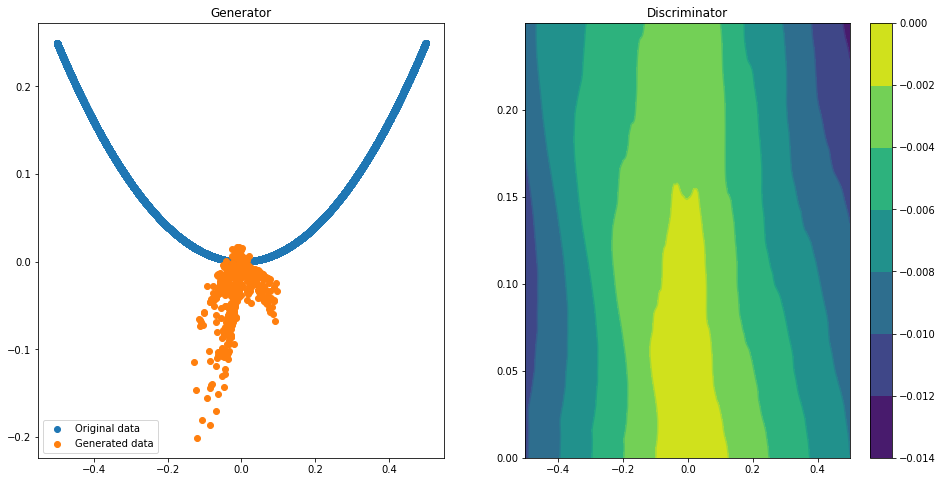

Epoch 000 | ET 1.45 min | Avg Losses >> G/D 0.6966/1.3812
Epoch 005 | ET 2.29 min | Avg Losses >> G/D 0.7008/1.3774
Epoch 010 | ET 3.13 min | Avg Losses >> G/D 0.7004/1.3818
Epoch 015 | ET 4.15 min | Avg Losses >> G/D 0.6973/1.3815


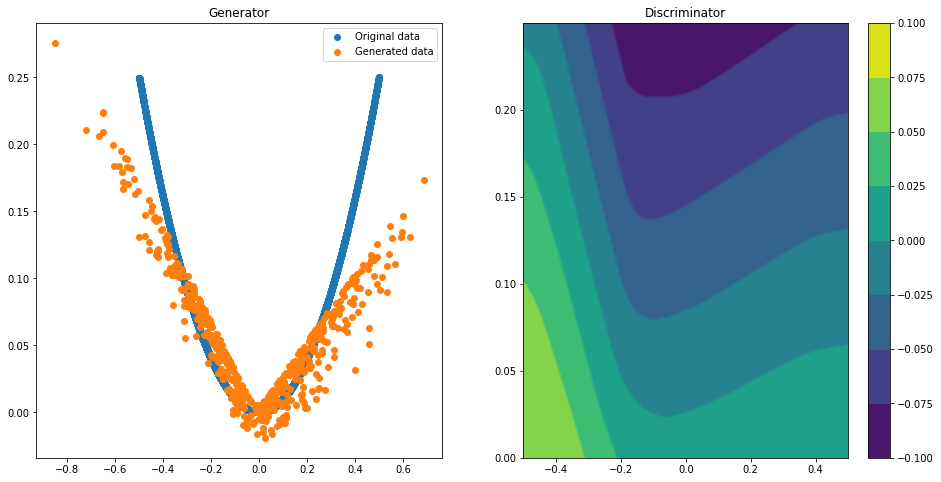

Epoch 020 | ET 6.34 min | Avg Losses >> G/D 0.6951/1.3839


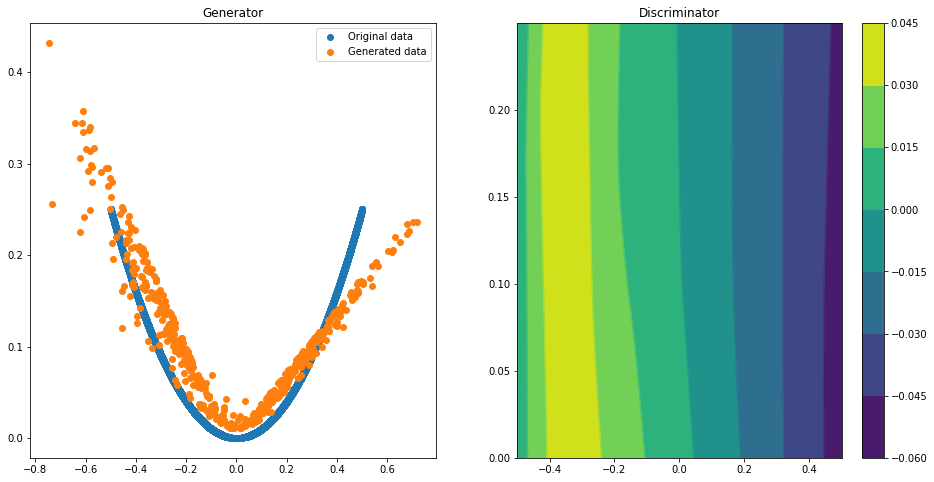

Epoch 025 | ET 8.51 min | Avg Losses >> G/D 0.6948/1.3845
Epoch 030 | ET 9.34 min | Avg Losses >> G/D 0.6952/1.3842
Epoch 035 | ET 10.18 min | Avg Losses >> G/D 0.6960/1.3832


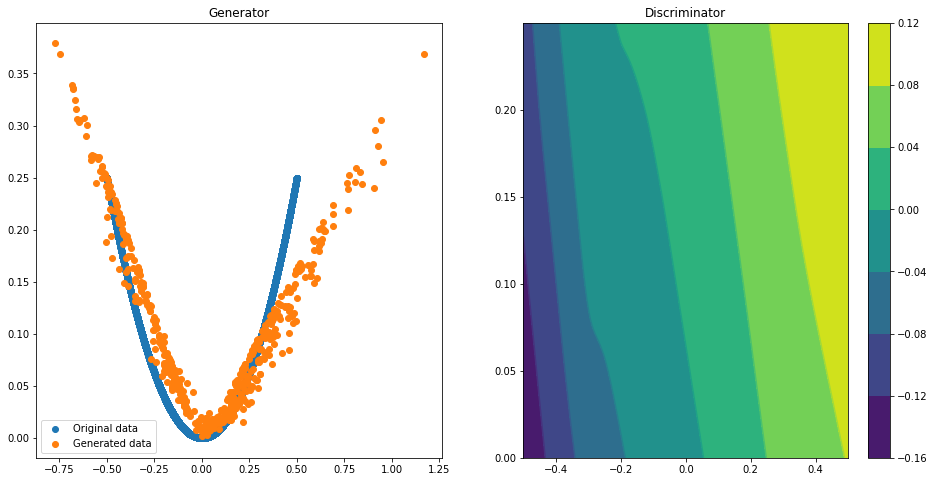

Epoch 040 | ET 12.30 min | Avg Losses >> G/D 0.6959/1.3841
Epoch 045 | ET 13.13 min | Avg Losses >> G/D 0.6955/1.3845


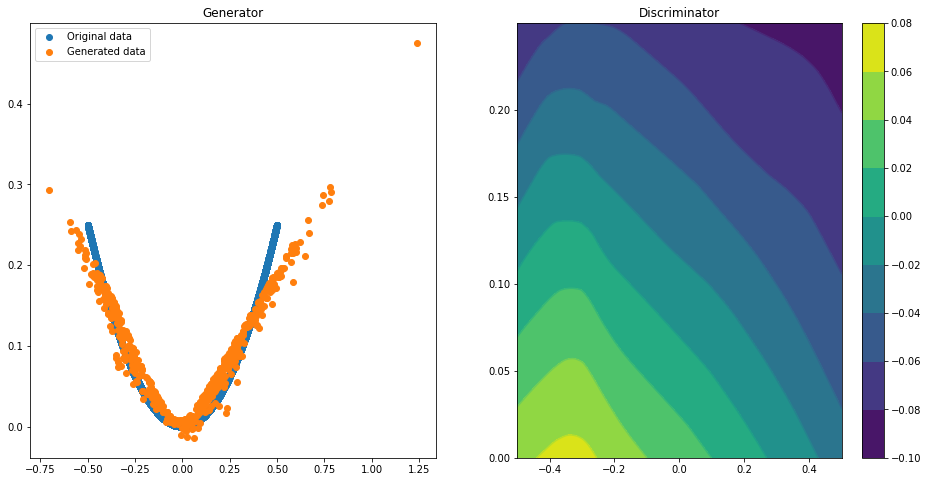

Epoch 050 | ET 15.27 min | Avg Losses >> G/D 0.6951/1.3852
Epoch 055 | ET 16.11 min | Avg Losses >> G/D 0.6979/1.3828


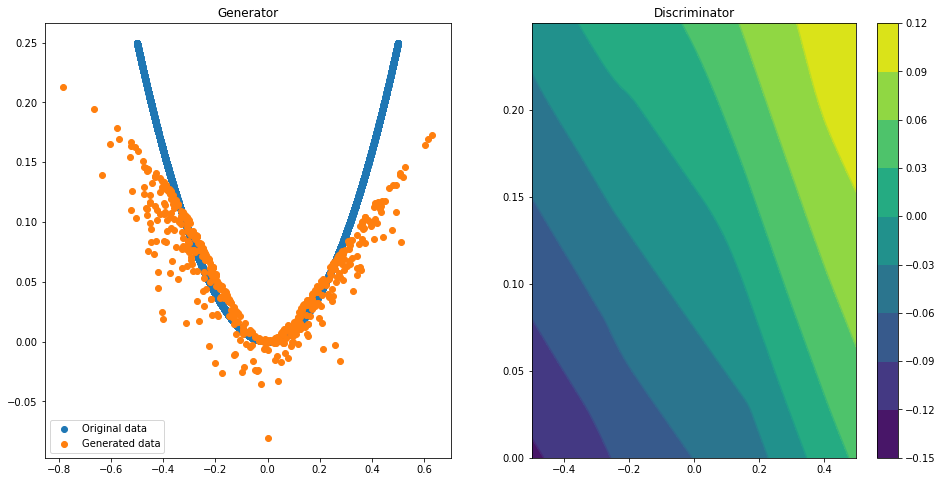

Epoch 060 | ET 18.25 min | Avg Losses >> G/D 0.6989/1.3825
Epoch 065 | ET 19.08 min | Avg Losses >> G/D 0.6969/1.3837
Epoch 070 | ET 19.93 min | Avg Losses >> G/D 0.6973/1.3834


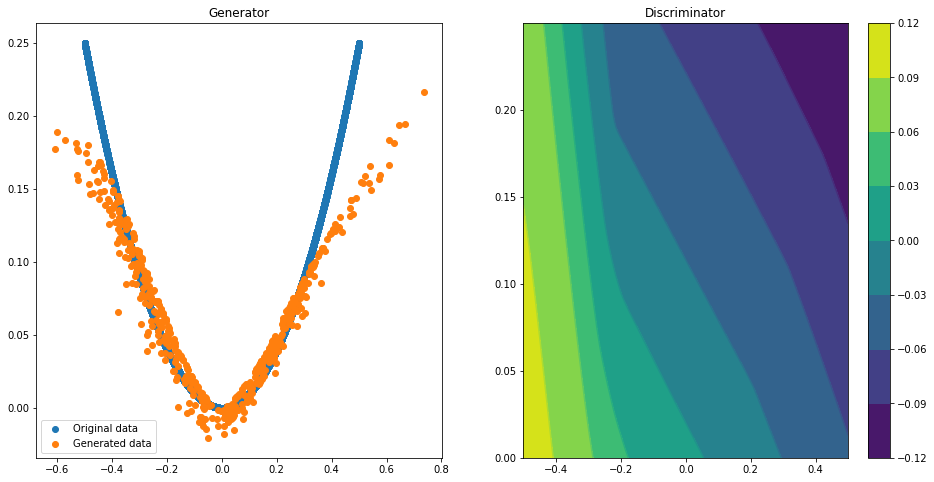

Epoch 075 | ET 22.07 min | Avg Losses >> G/D 0.6963/1.3847


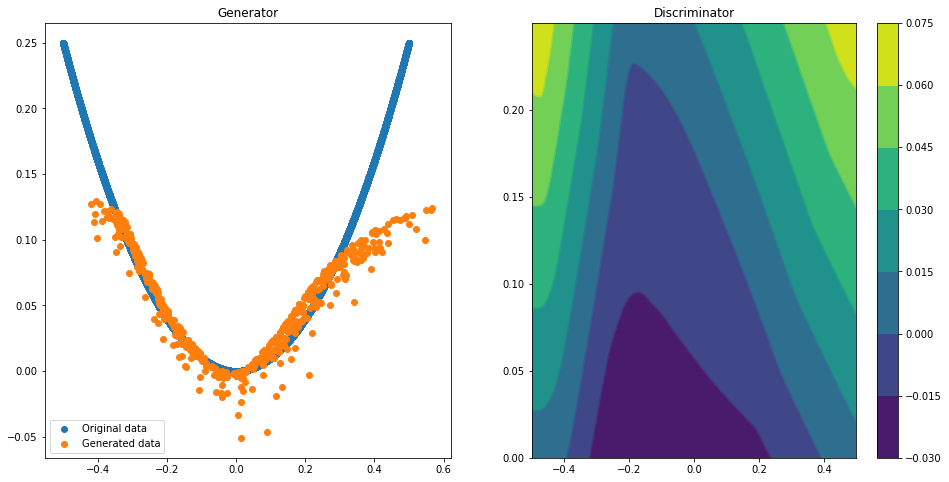

Epoch 080 | ET 24.21 min | Avg Losses >> G/D 0.6954/1.3845
Epoch 085 | ET 25.23 min | Avg Losses >> G/D 0.6949/1.3853
Epoch 090 | ET 26.08 min | Avg Losses >> G/D 0.6957/1.3840
Epoch 095 | ET 27.10 min | Avg Losses >> G/D 0.6953/1.3850


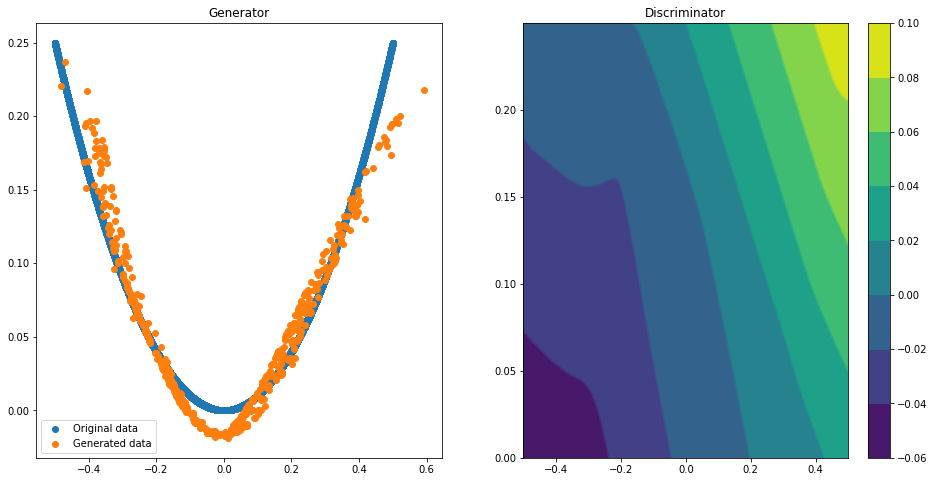

Epoch 100 | ET 29.24 min | Avg Losses >> G/D 0.6954/1.3848


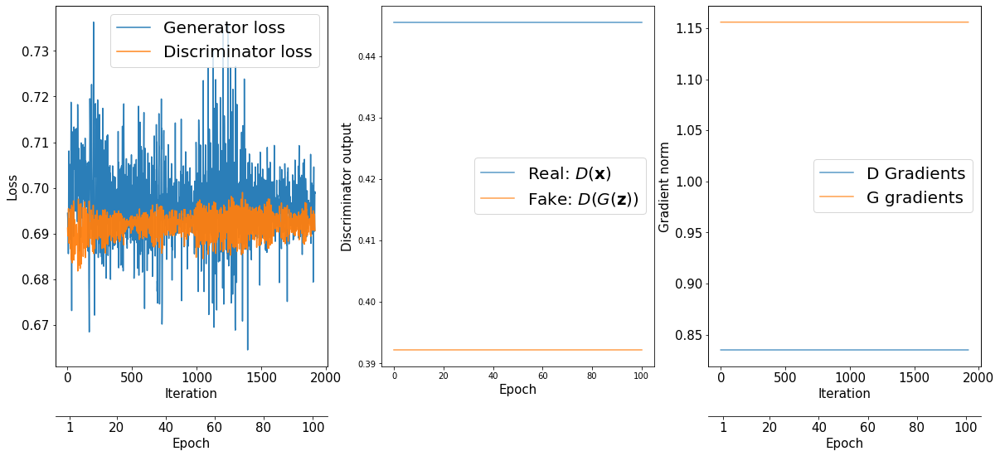

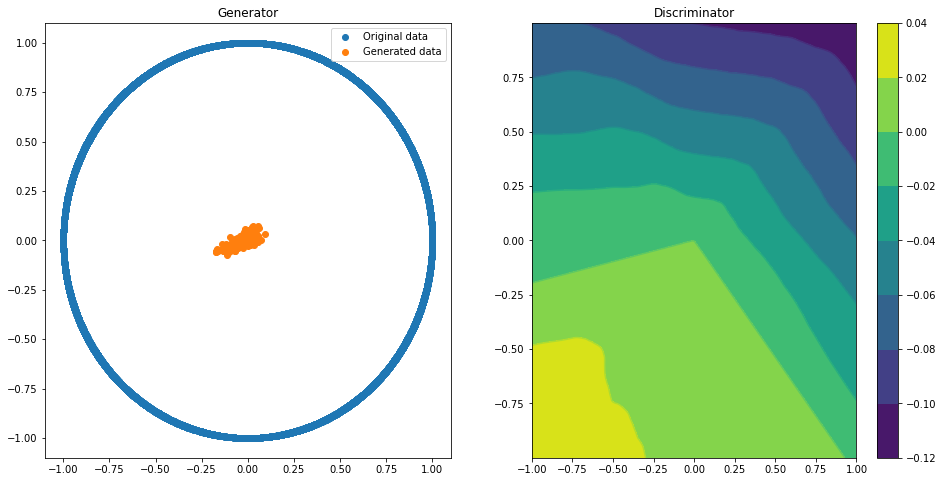

Epoch 000 | ET 1.46 min | Avg Losses >> G/D 0.6877/1.3633
Epoch 005 | ET 2.30 min | Avg Losses >> G/D 0.6957/1.3811
Epoch 010 | ET 3.14 min | Avg Losses >> G/D 0.7039/1.3826
Epoch 015 | ET 3.99 min | Avg Losses >> G/D 0.7010/1.3779


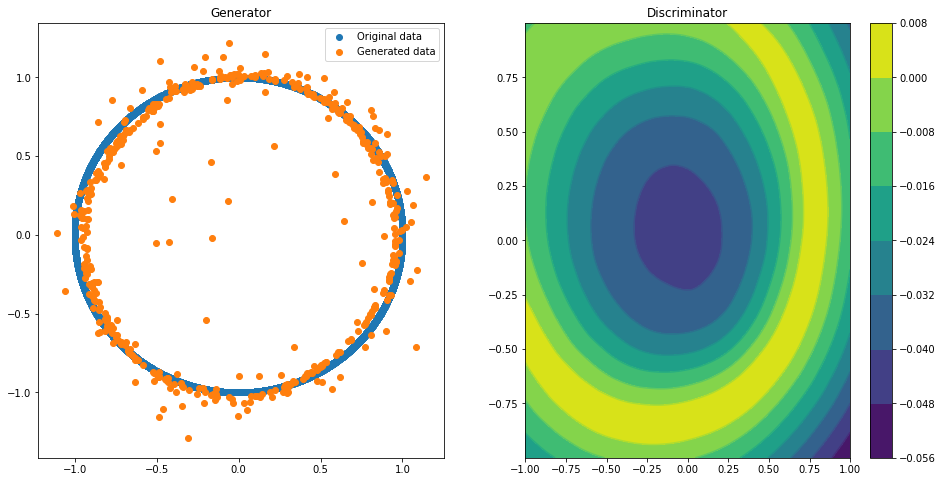

Epoch 020 | ET 6.11 min | Avg Losses >> G/D 0.6940/1.3840


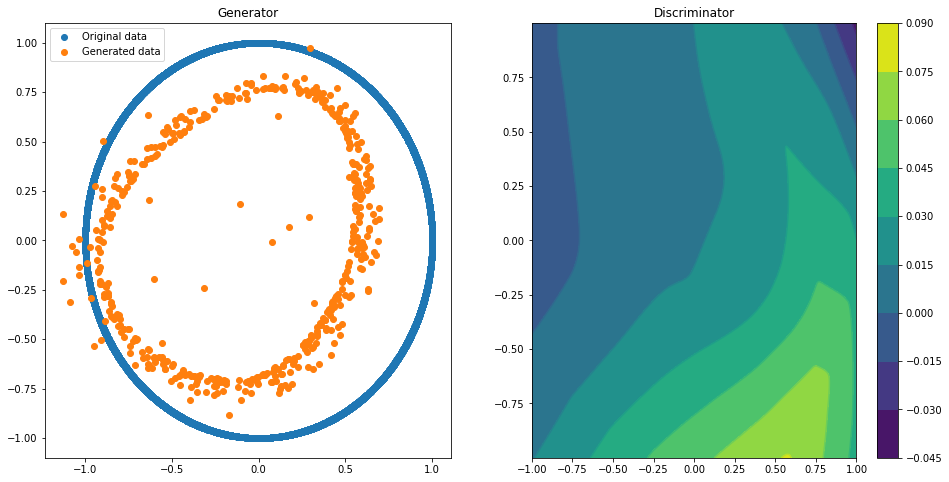

Epoch 025 | ET 8.23 min | Avg Losses >> G/D 0.6917/1.3806
Epoch 030 | ET 9.07 min | Avg Losses >> G/D 0.6943/1.3836
Epoch 035 | ET 9.92 min | Avg Losses >> G/D 0.6956/1.3824


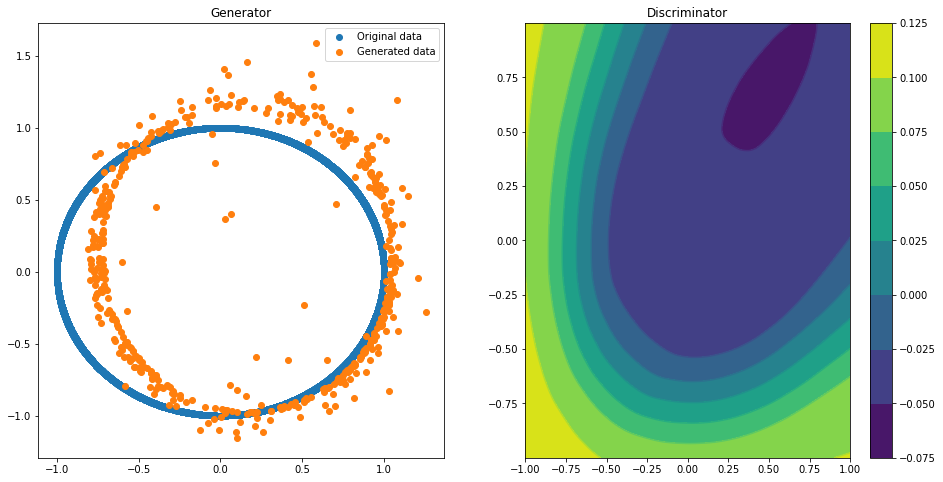

Epoch 040 | ET 12.04 min | Avg Losses >> G/D 0.7014/1.3810
Epoch 045 | ET 12.89 min | Avg Losses >> G/D 0.7067/1.3824


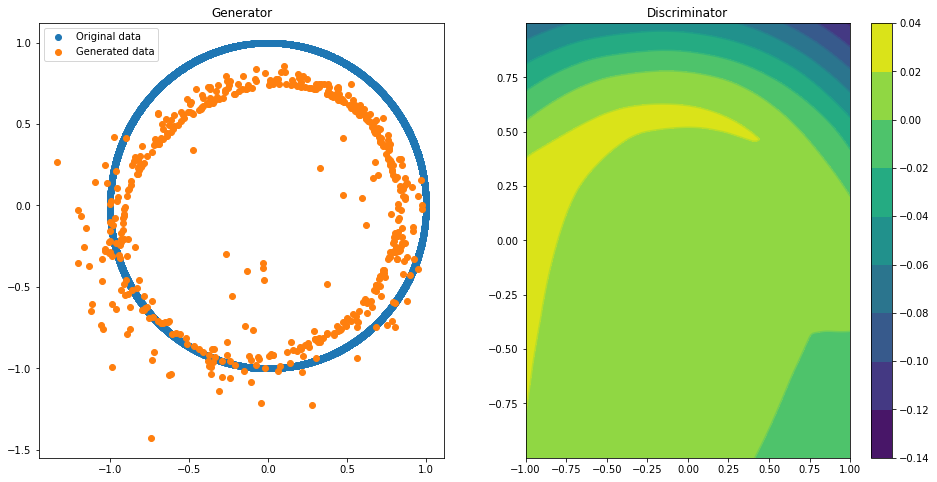

Epoch 050 | ET 15.03 min | Avg Losses >> G/D 0.6983/1.3834
Epoch 055 | ET 15.89 min | Avg Losses >> G/D 0.6929/1.3839


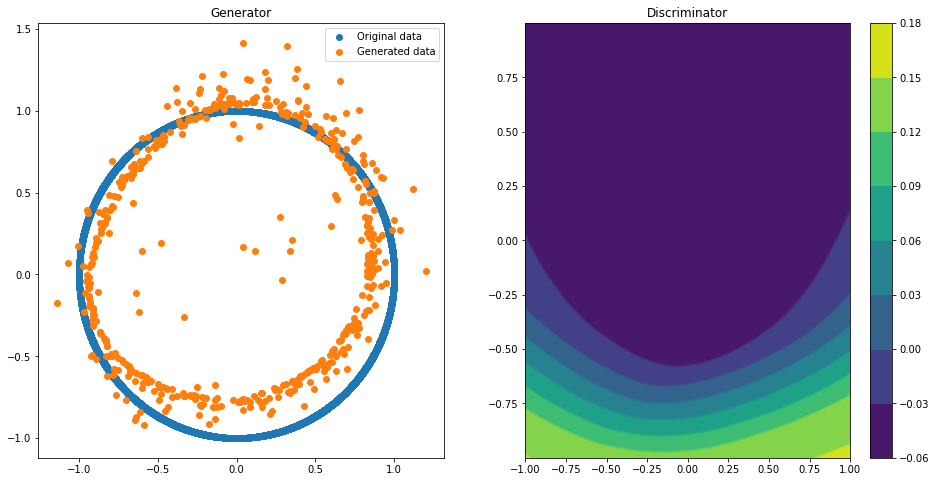

Epoch 060 | ET 18.02 min | Avg Losses >> G/D 0.7010/1.3818
Epoch 065 | ET 18.86 min | Avg Losses >> G/D 0.6974/1.3813
Epoch 070 | ET 19.72 min | Avg Losses >> G/D 0.6954/1.3836


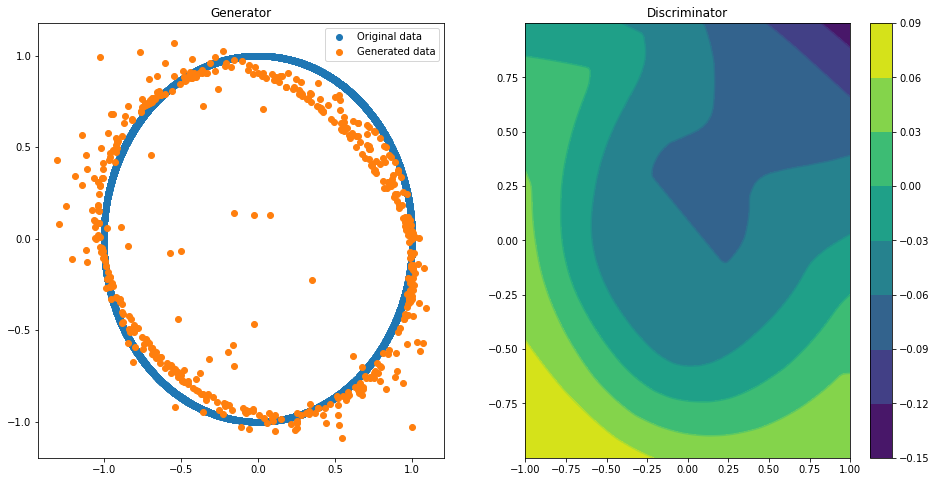

Epoch 075 | ET 21.84 min | Avg Losses >> G/D 0.6960/1.3828


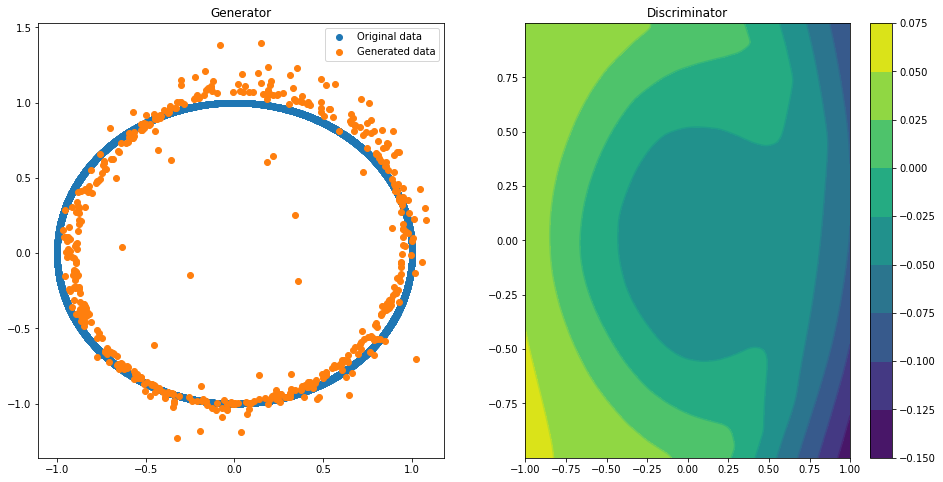

Epoch 080 | ET 23.97 min | Avg Losses >> G/D 0.6958/1.3838
Epoch 085 | ET 24.81 min | Avg Losses >> G/D 0.6964/1.3828
Epoch 090 | ET 25.66 min | Avg Losses >> G/D 0.6950/1.3840
Epoch 095 | ET 26.50 min | Avg Losses >> G/D 0.6967/1.3831


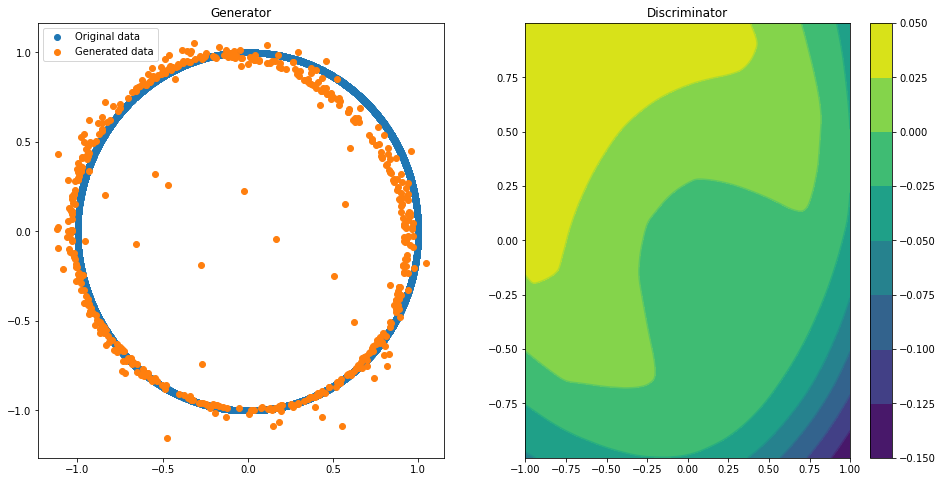

Epoch 100 | ET 28.63 min | Avg Losses >> G/D 0.6971/1.3824


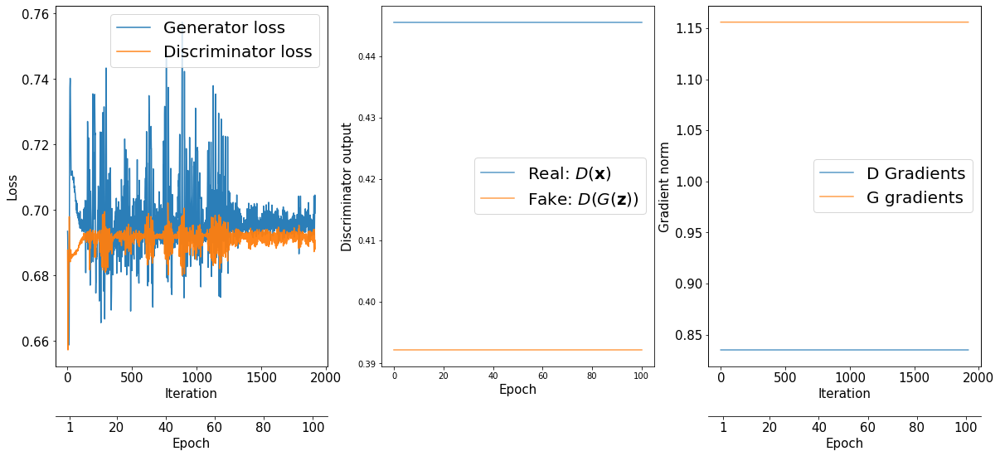

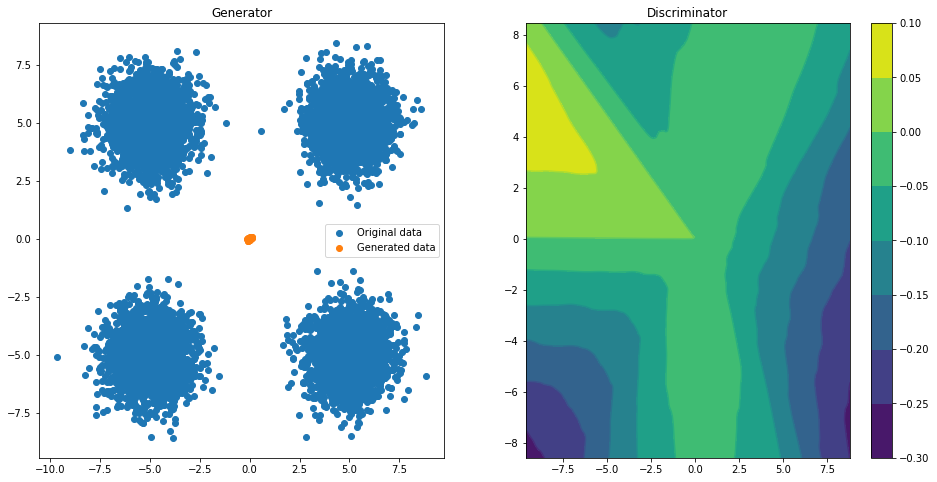

Epoch 000 | ET 1.47 min | Avg Losses >> G/D 0.6997/1.0586
Epoch 005 | ET 2.31 min | Avg Losses >> G/D 0.7085/1.3457
Epoch 010 | ET 3.15 min | Avg Losses >> G/D 0.6576/1.3336
Epoch 015 | ET 4.00 min | Avg Losses >> G/D 0.6701/1.3276


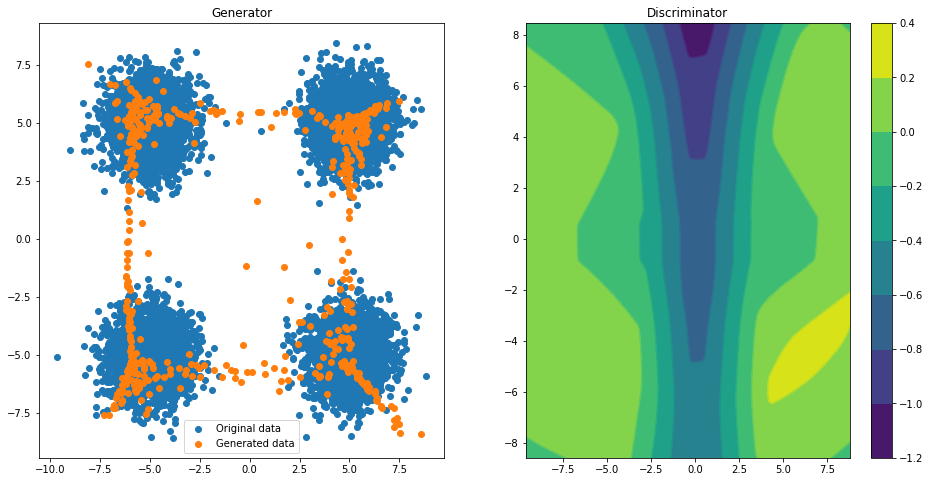

Epoch 020 | ET 6.14 min | Avg Losses >> G/D 0.7153/1.3492


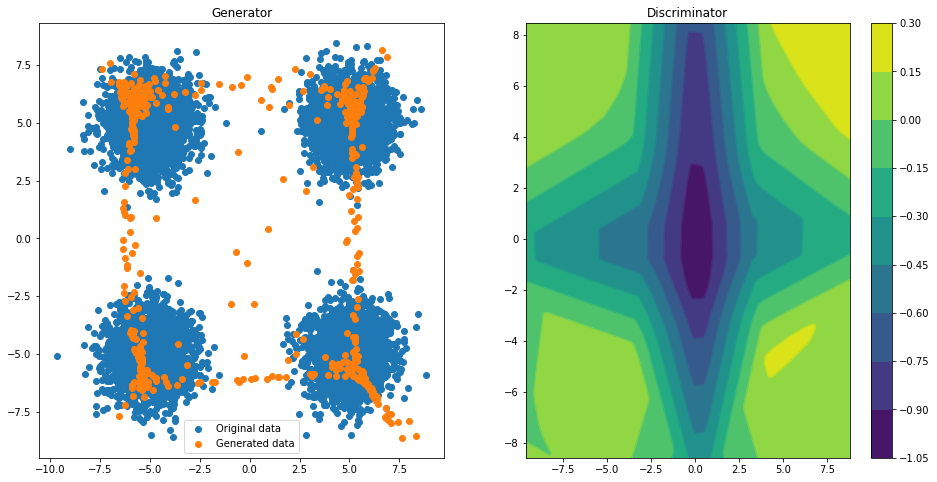

Epoch 025 | ET 8.25 min | Avg Losses >> G/D 0.7131/1.3578
Epoch 030 | ET 9.09 min | Avg Losses >> G/D 0.7240/1.3657
Epoch 035 | ET 9.93 min | Avg Losses >> G/D 0.7410/1.3547


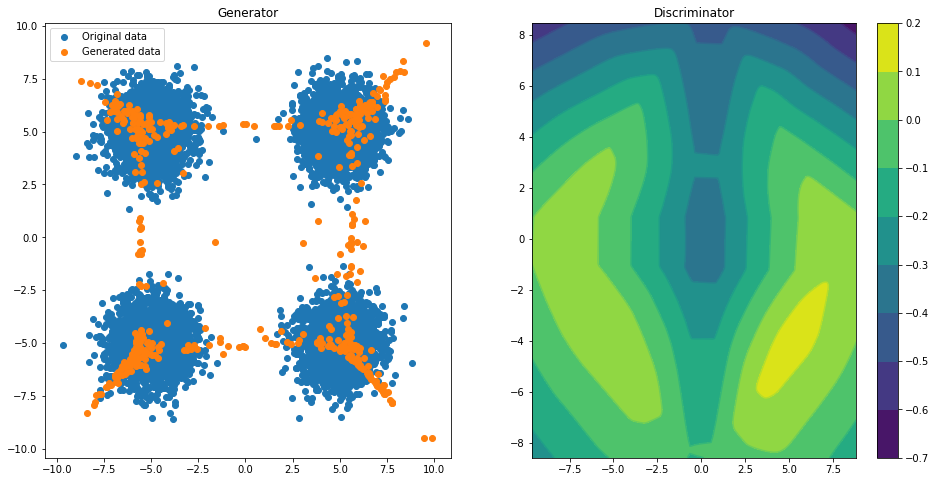

Epoch 040 | ET 12.05 min | Avg Losses >> G/D 0.7129/1.3656
Epoch 045 | ET 12.90 min | Avg Losses >> G/D 0.7140/1.3640


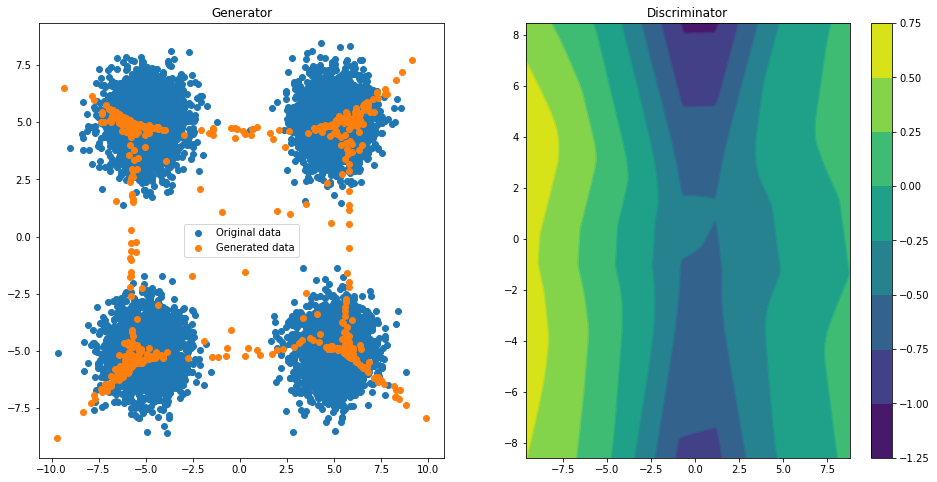

Epoch 050 | ET 15.02 min | Avg Losses >> G/D 0.7400/1.3639
Epoch 055 | ET 15.85 min | Avg Losses >> G/D 0.7169/1.3664


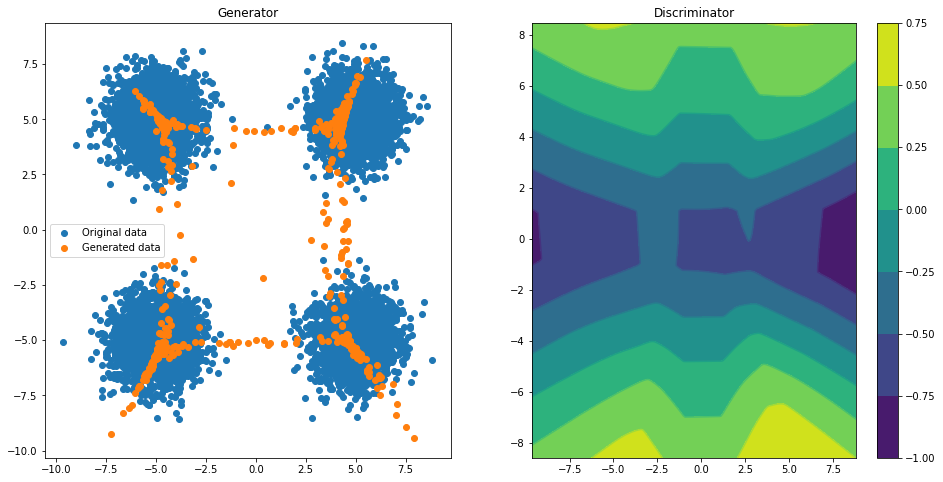

Epoch 060 | ET 17.96 min | Avg Losses >> G/D 0.7217/1.3659
Epoch 065 | ET 18.80 min | Avg Losses >> G/D 0.7351/1.3602
Epoch 070 | ET 19.65 min | Avg Losses >> G/D 0.7044/1.3674


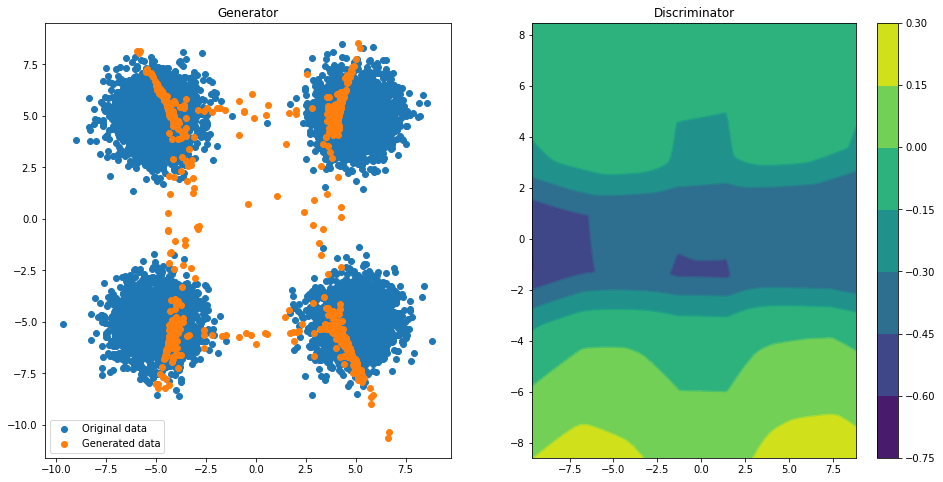

Epoch 075 | ET 21.75 min | Avg Losses >> G/D 0.7328/1.3555


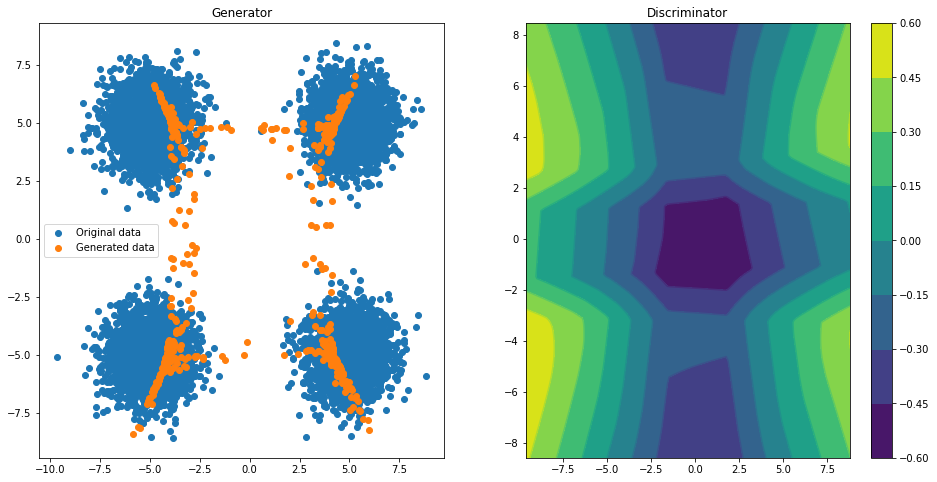

Epoch 080 | ET 23.88 min | Avg Losses >> G/D 0.7306/1.3544
Epoch 085 | ET 24.72 min | Avg Losses >> G/D 0.7355/1.3549
Epoch 090 | ET 25.55 min | Avg Losses >> G/D 0.7246/1.3617
Epoch 095 | ET 26.39 min | Avg Losses >> G/D 0.7254/1.3631


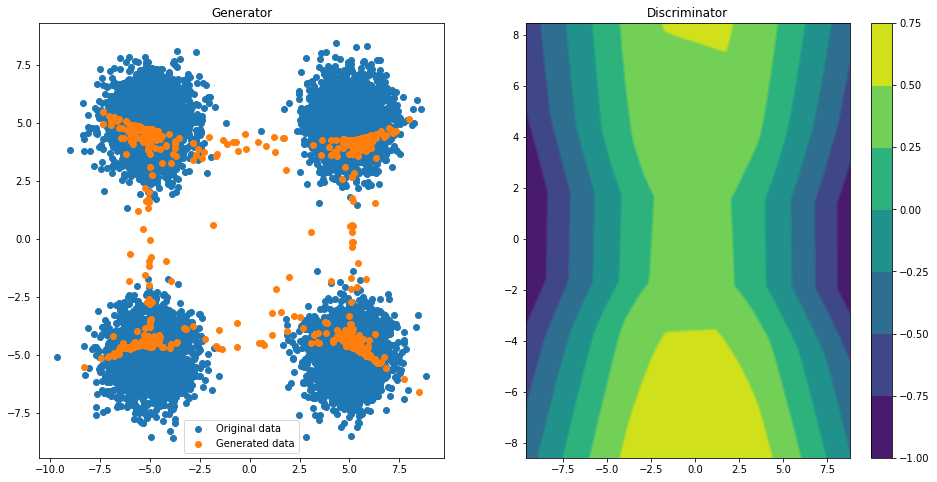

Epoch 100 | ET 28.49 min | Avg Losses >> G/D 0.7126/1.3703


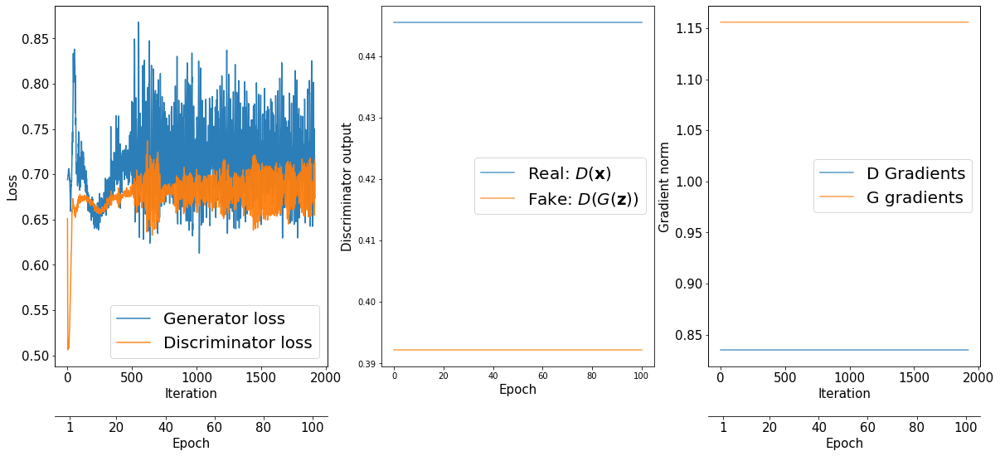

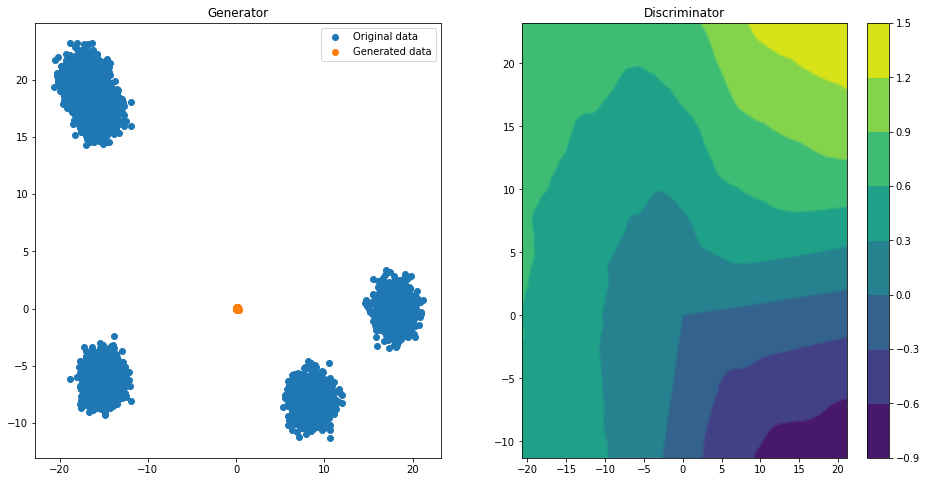

Epoch 000 | ET 1.44 min | Avg Losses >> G/D 0.7239/0.7759
Epoch 005 | ET 2.27 min | Avg Losses >> G/D 0.8617/1.3219
Epoch 010 | ET 3.11 min | Avg Losses >> G/D 0.7572/1.2930
Epoch 015 | ET 3.95 min | Avg Losses >> G/D 0.7915/1.2363


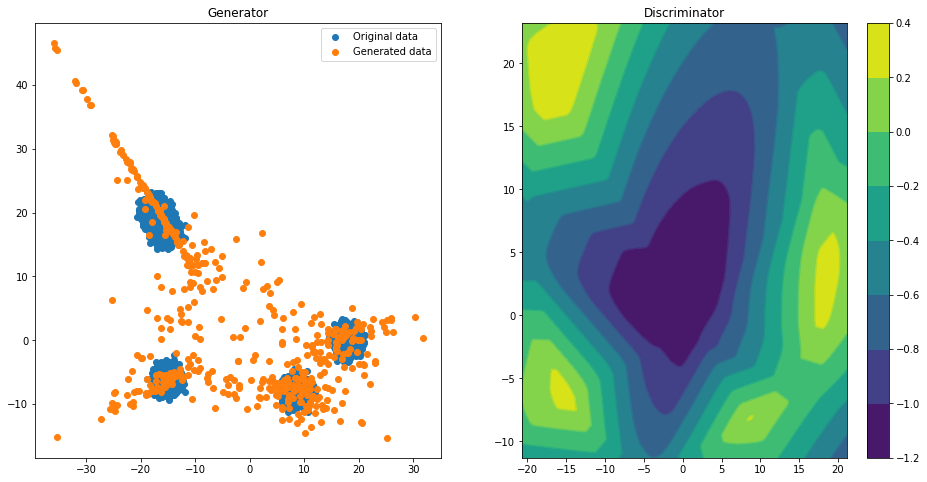

Epoch 020 | ET 6.05 min | Avg Losses >> G/D 0.8118/1.2130


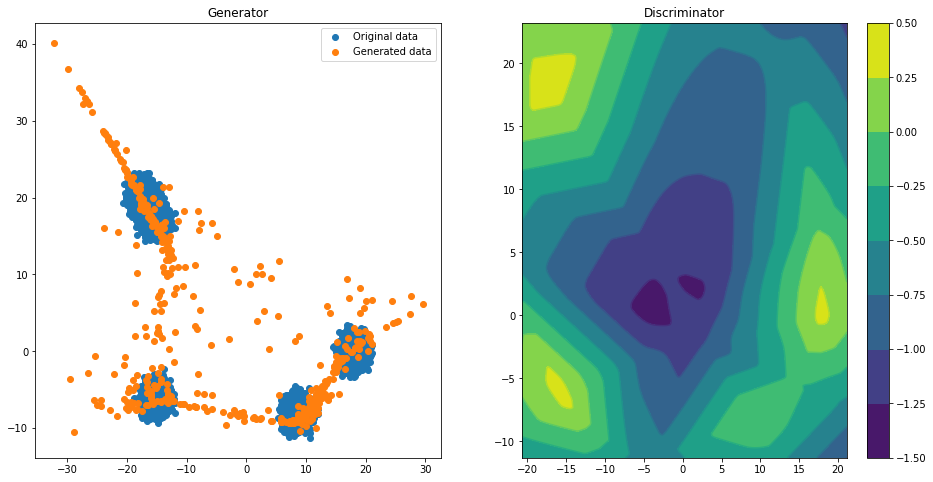

Epoch 025 | ET 8.17 min | Avg Losses >> G/D 0.8165/1.2427
Epoch 030 | ET 9.00 min | Avg Losses >> G/D 0.7837/1.2725
Epoch 035 | ET 9.85 min | Avg Losses >> G/D 0.7735/1.3086


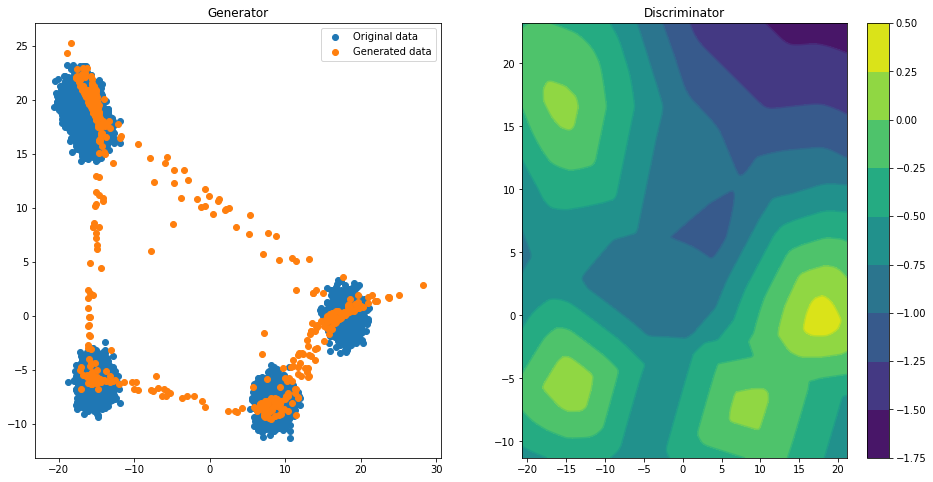

Epoch 040 | ET 11.95 min | Avg Losses >> G/D 0.7594/1.3215
Epoch 045 | ET 12.77 min | Avg Losses >> G/D 0.7571/1.3250


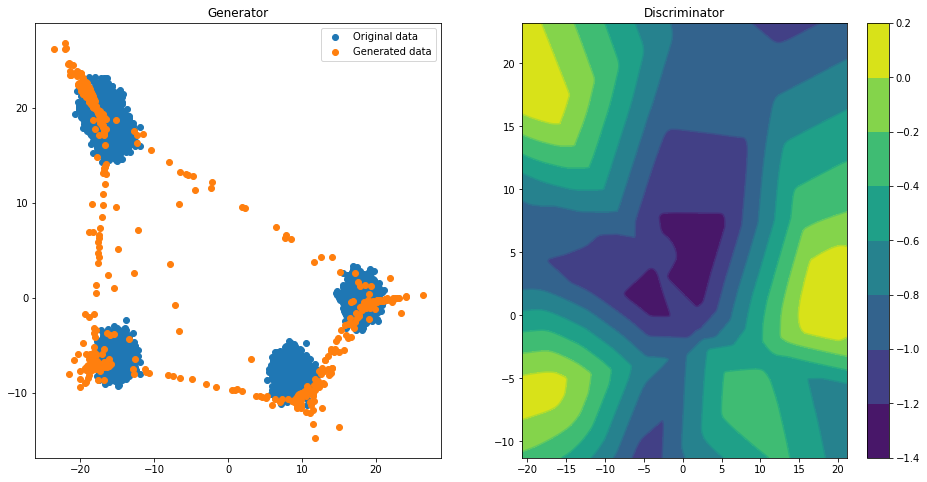

Epoch 050 | ET 14.87 min | Avg Losses >> G/D 0.7598/1.3272
Epoch 055 | ET 15.70 min | Avg Losses >> G/D 0.7515/1.3329


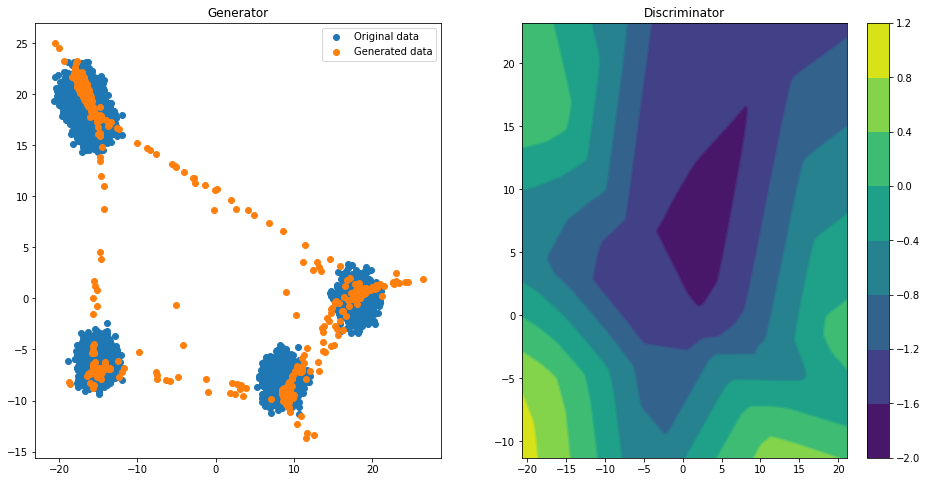

Epoch 060 | ET 17.80 min | Avg Losses >> G/D 0.7617/1.3312
Epoch 065 | ET 18.63 min | Avg Losses >> G/D 0.7474/1.3408
Epoch 070 | ET 19.48 min | Avg Losses >> G/D 0.7430/1.3389


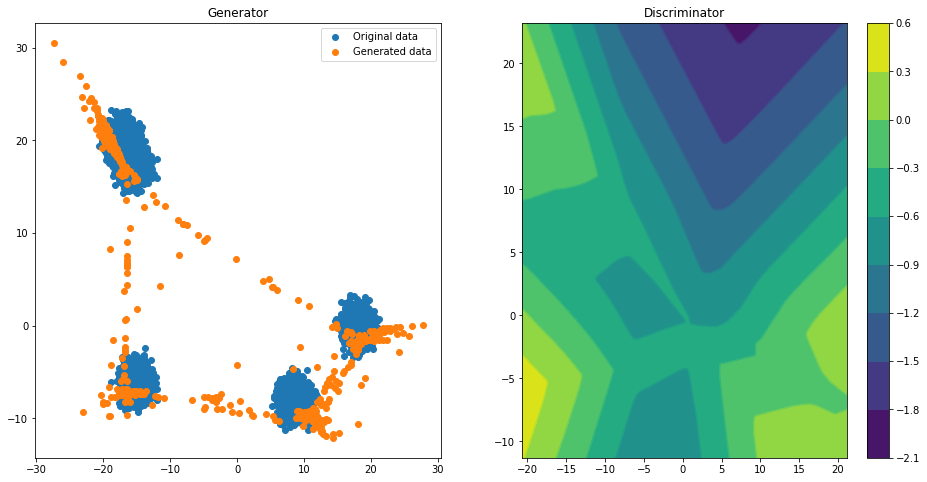

Epoch 075 | ET 21.59 min | Avg Losses >> G/D 0.7281/1.3523


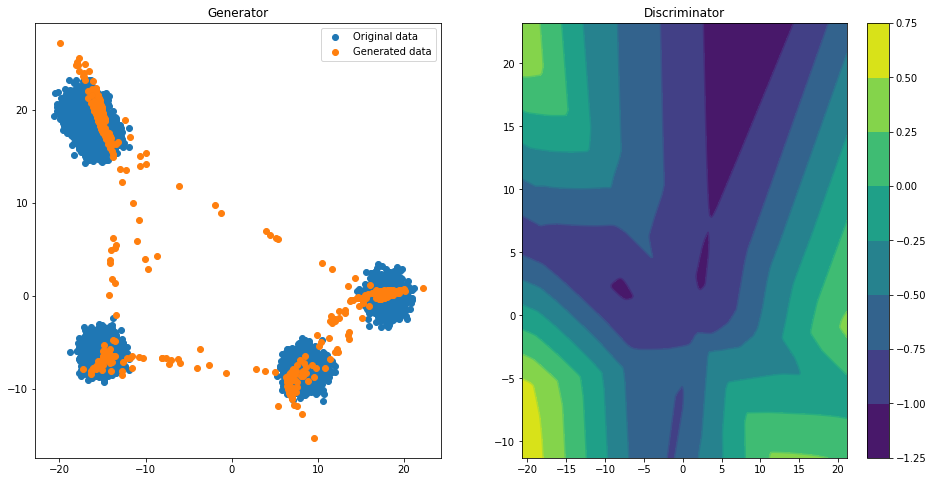

Epoch 080 | ET 23.68 min | Avg Losses >> G/D 0.7386/1.3502
Epoch 085 | ET 24.51 min | Avg Losses >> G/D 0.7336/1.3498
Epoch 090 | ET 25.36 min | Avg Losses >> G/D 0.7298/1.3500
Epoch 095 | ET 26.19 min | Avg Losses >> G/D 0.7274/1.3569


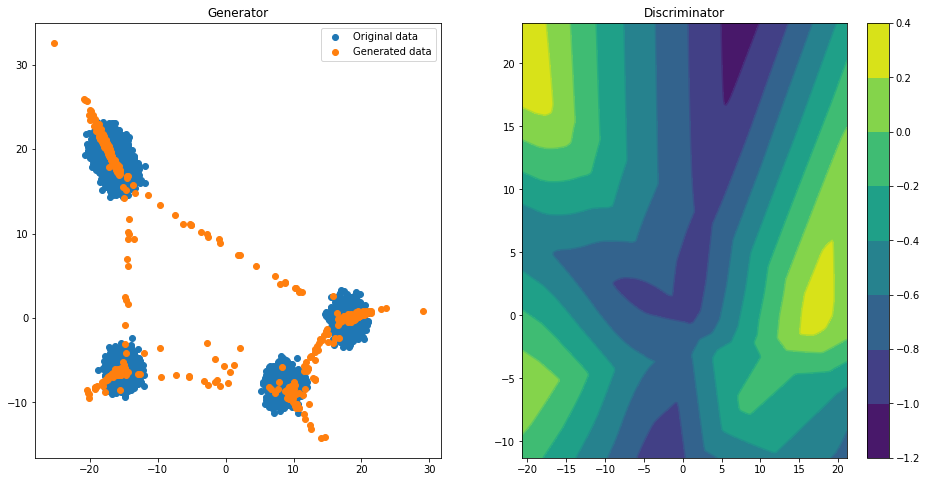

Epoch 100 | ET 28.32 min | Avg Losses >> G/D 0.7172/1.3587


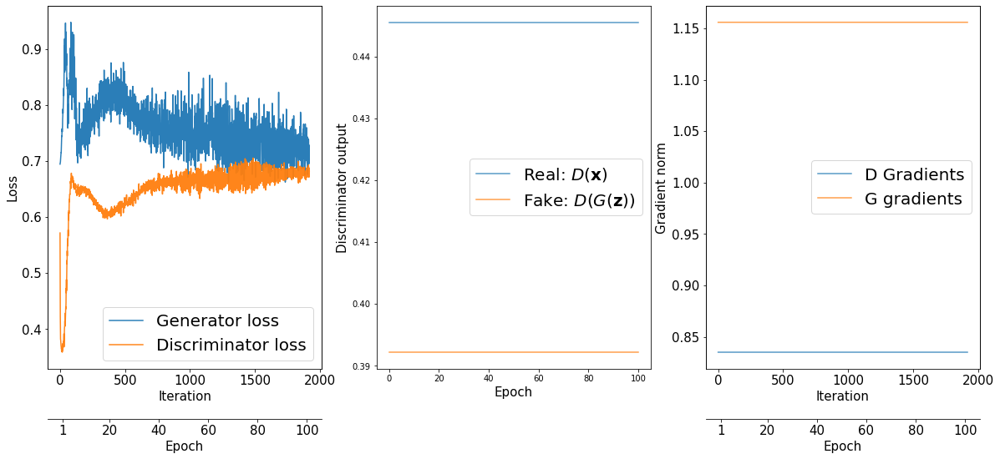

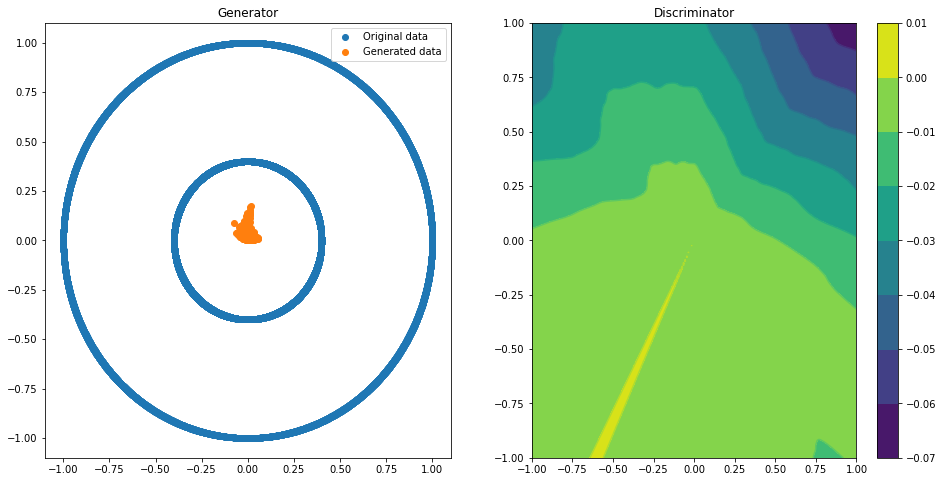

Epoch 000 | ET 1.48 min | Avg Losses >> G/D 0.7078/1.3738
Epoch 005 | ET 2.32 min | Avg Losses >> G/D 0.7036/1.3829
Epoch 010 | ET 3.16 min | Avg Losses >> G/D 0.6969/1.3818
Epoch 015 | ET 4.00 min | Avg Losses >> G/D 0.6961/1.3816


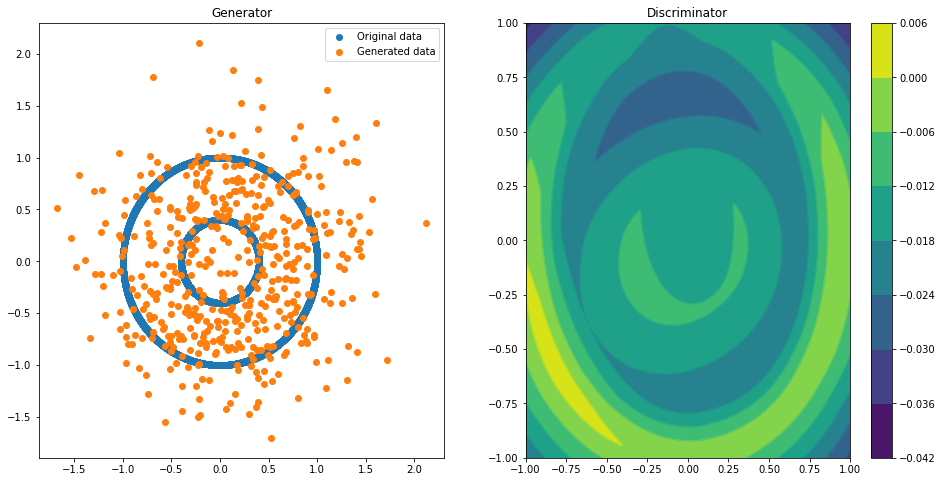

Epoch 020 | ET 6.09 min | Avg Losses >> G/D 0.6966/1.3809


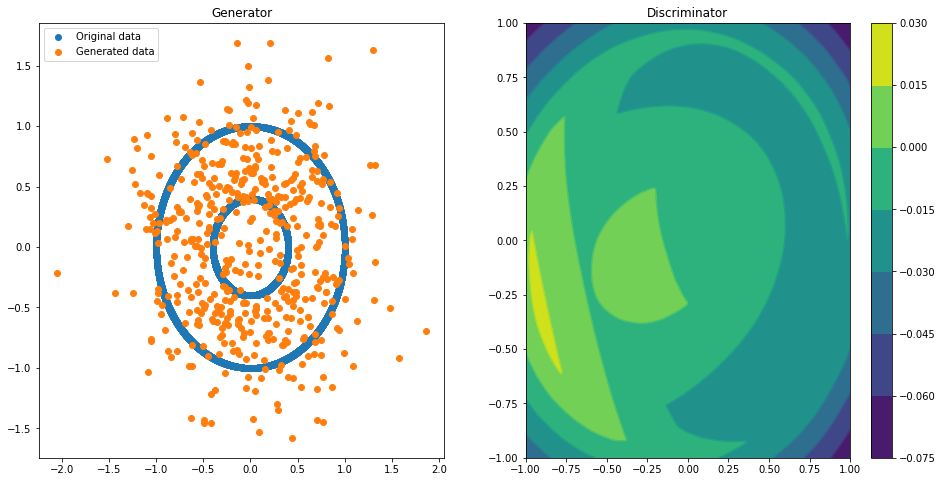

Epoch 025 | ET 8.17 min | Avg Losses >> G/D 0.6960/1.3819
Epoch 030 | ET 9.01 min | Avg Losses >> G/D 0.6955/1.3816
Epoch 035 | ET 9.85 min | Avg Losses >> G/D 0.7091/1.3832


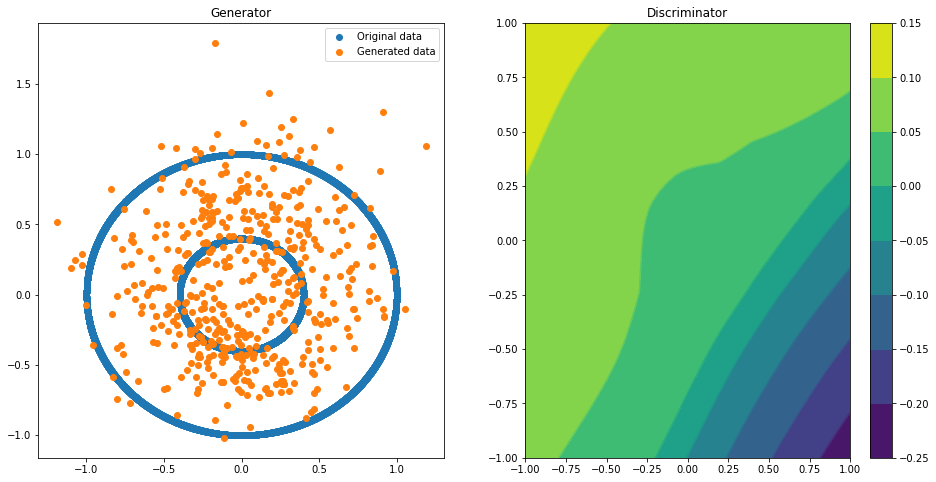

Epoch 040 | ET 11.98 min | Avg Losses >> G/D 0.6995/1.3832
Epoch 045 | ET 12.83 min | Avg Losses >> G/D 0.6951/1.3829


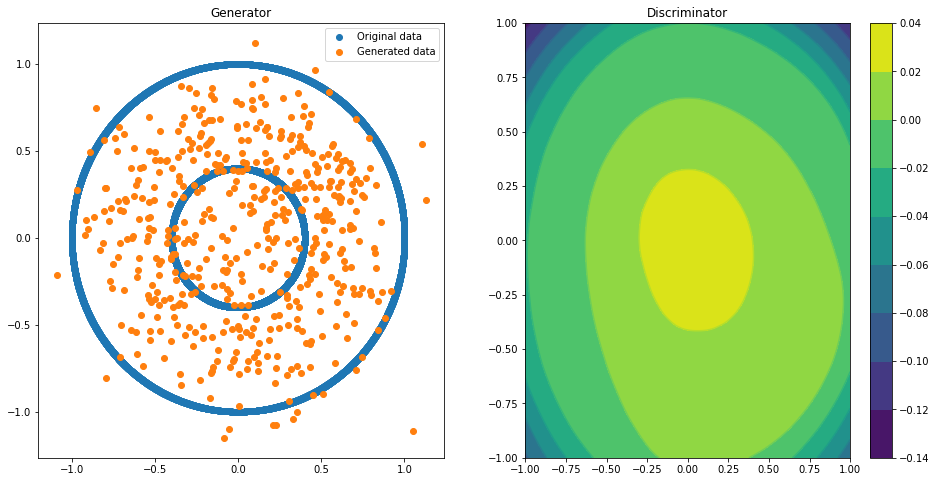

Epoch 050 | ET 14.92 min | Avg Losses >> G/D 0.6990/1.3827
Epoch 055 | ET 15.75 min | Avg Losses >> G/D 0.6943/1.3824


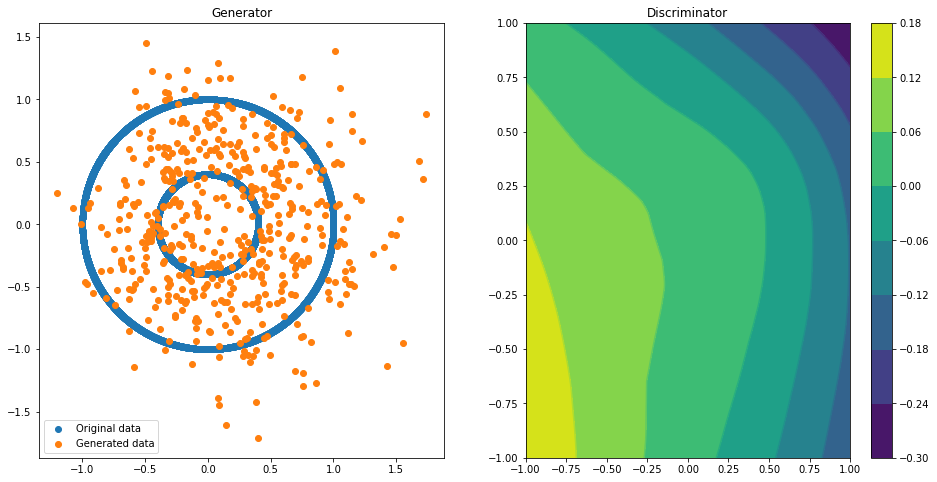

Epoch 060 | ET 17.85 min | Avg Losses >> G/D 0.6973/1.3831
Epoch 065 | ET 18.70 min | Avg Losses >> G/D 0.6971/1.3828
Epoch 070 | ET 19.55 min | Avg Losses >> G/D 0.6959/1.3819


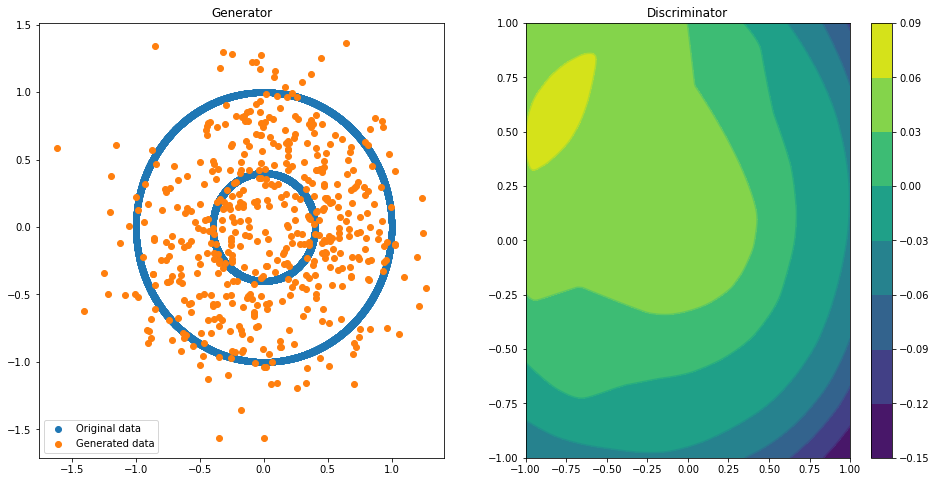

Epoch 075 | ET 21.64 min | Avg Losses >> G/D 0.6962/1.3831


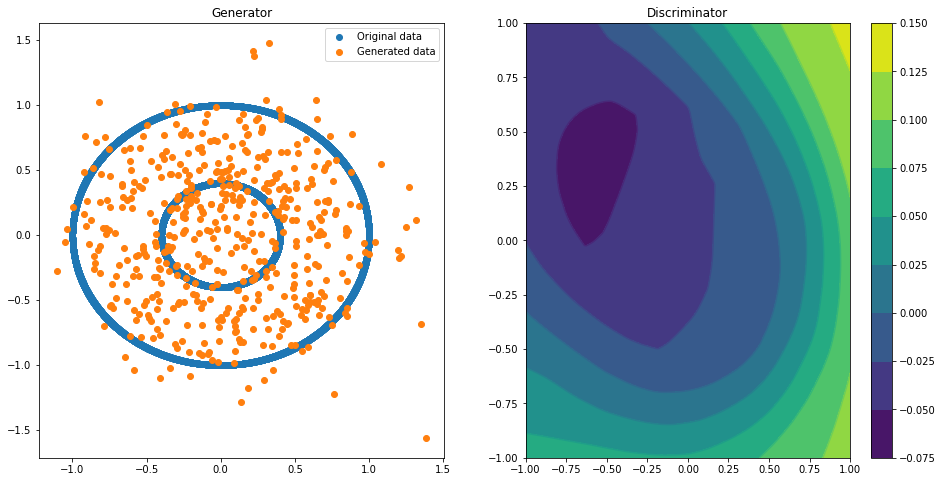

Epoch 080 | ET 23.75 min | Avg Losses >> G/D 0.6984/1.3827
Epoch 085 | ET 24.59 min | Avg Losses >> G/D 0.6962/1.3833
Epoch 090 | ET 25.41 min | Avg Losses >> G/D 0.6949/1.3832
Epoch 095 | ET 26.27 min | Avg Losses >> G/D 0.6939/1.3837


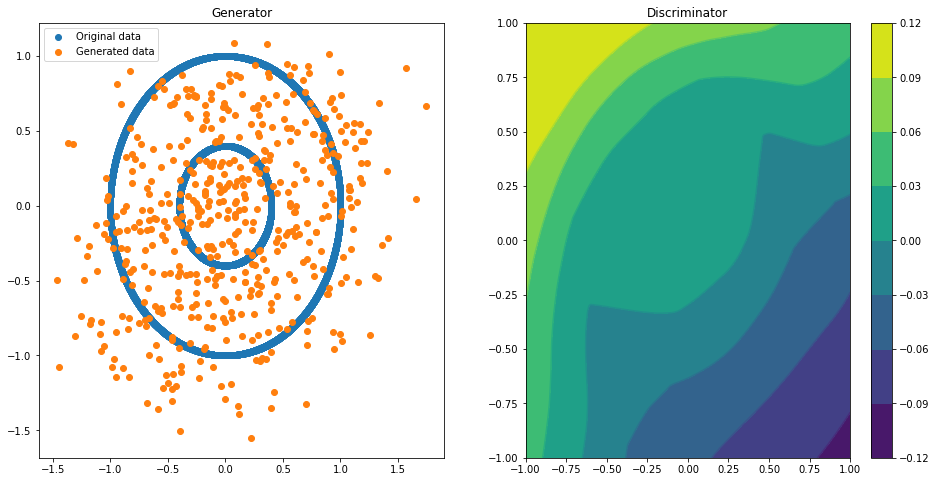

Epoch 100 | ET 28.35 min | Avg Losses >> G/D 0.6948/1.3829


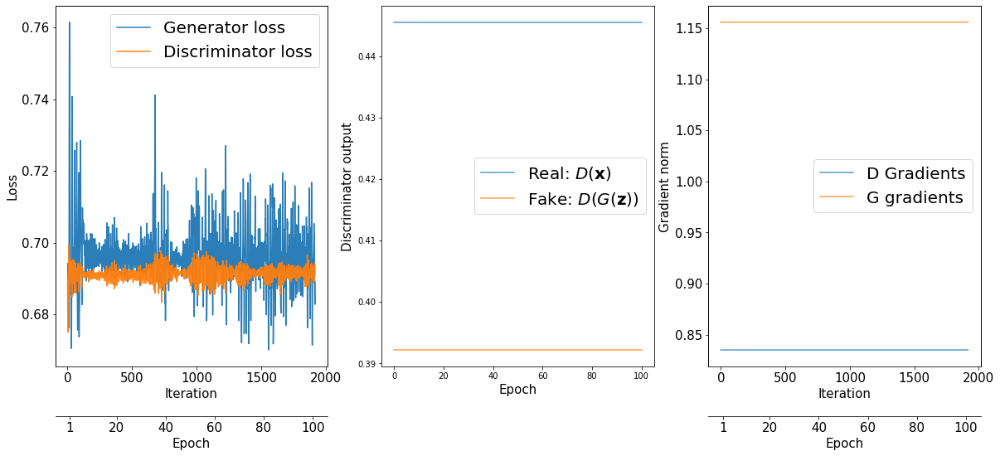

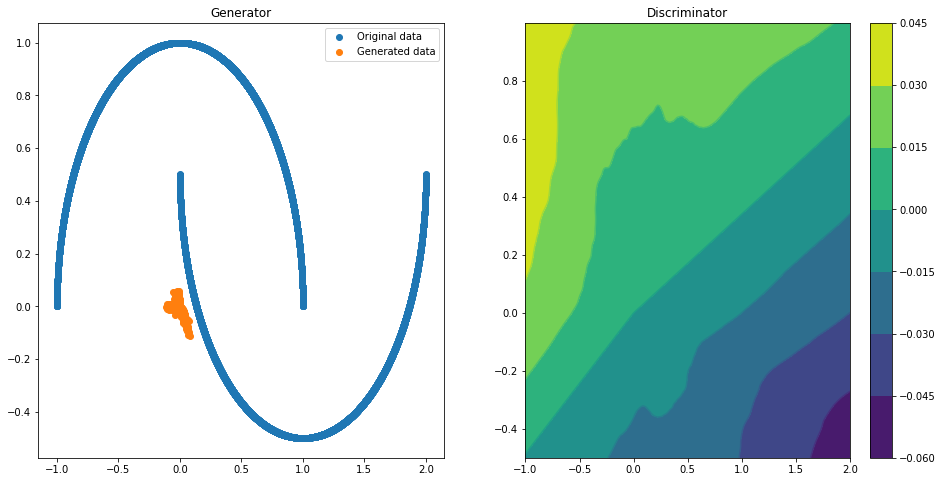

Epoch 000 | ET 1.46 min | Avg Losses >> G/D 0.7004/1.3561
Epoch 005 | ET 2.30 min | Avg Losses >> G/D 0.6993/1.3758
Epoch 010 | ET 3.13 min | Avg Losses >> G/D 0.6992/1.3769
Epoch 015 | ET 3.97 min | Avg Losses >> G/D 0.6996/1.3800


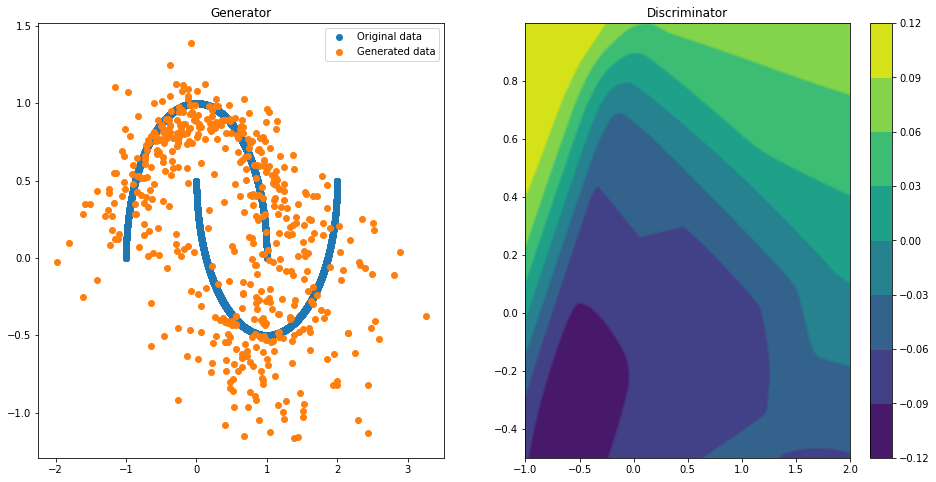

Epoch 020 | ET 6.09 min | Avg Losses >> G/D 0.7003/1.3788


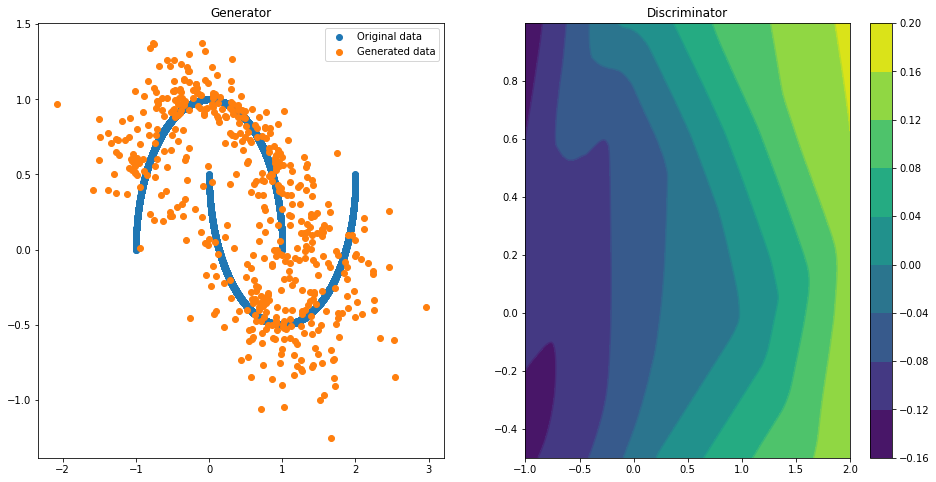

Epoch 025 | ET 8.17 min | Avg Losses >> G/D 0.7024/1.3814
Epoch 030 | ET 9.01 min | Avg Losses >> G/D 0.6962/1.3818
Epoch 035 | ET 9.83 min | Avg Losses >> G/D 0.6973/1.3811


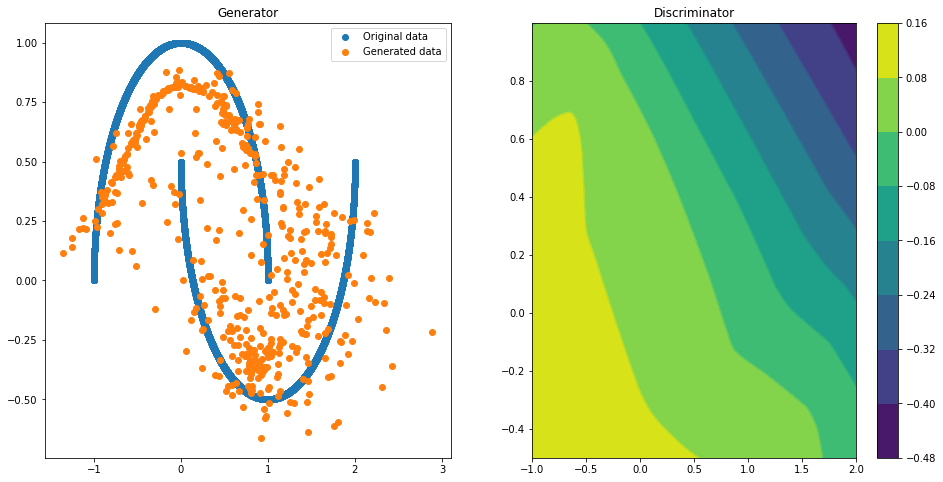

Epoch 040 | ET 11.93 min | Avg Losses >> G/D 0.6987/1.3806
Epoch 045 | ET 12.77 min | Avg Losses >> G/D 0.6999/1.3803


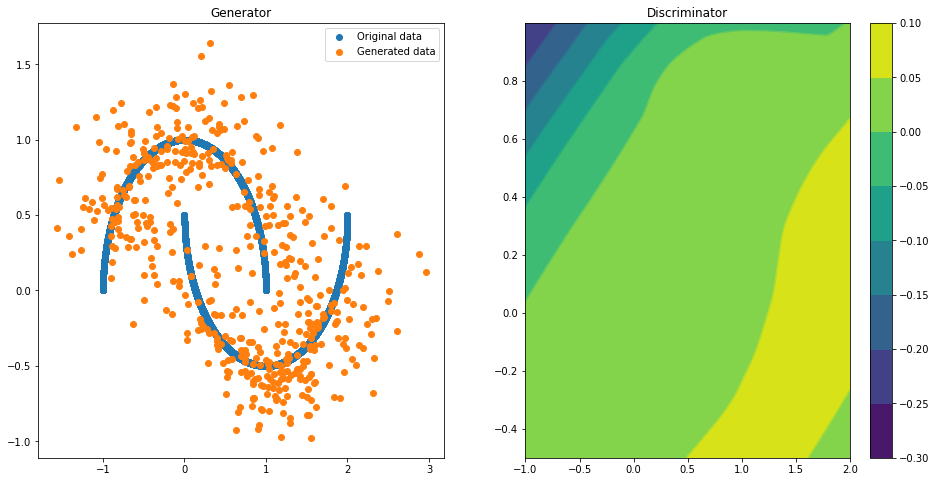

Epoch 050 | ET 14.88 min | Avg Losses >> G/D 0.6987/1.3806
Epoch 055 | ET 15.72 min | Avg Losses >> G/D 0.7026/1.3807


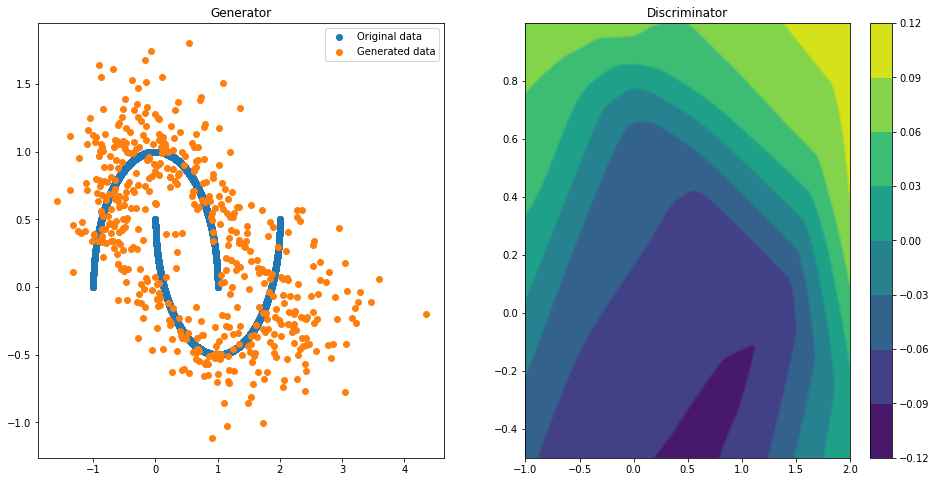

Epoch 060 | ET 17.82 min | Avg Losses >> G/D 0.6995/1.3801
Epoch 065 | ET 18.65 min | Avg Losses >> G/D 0.6980/1.3824
Epoch 070 | ET 19.49 min | Avg Losses >> G/D 0.6996/1.3798


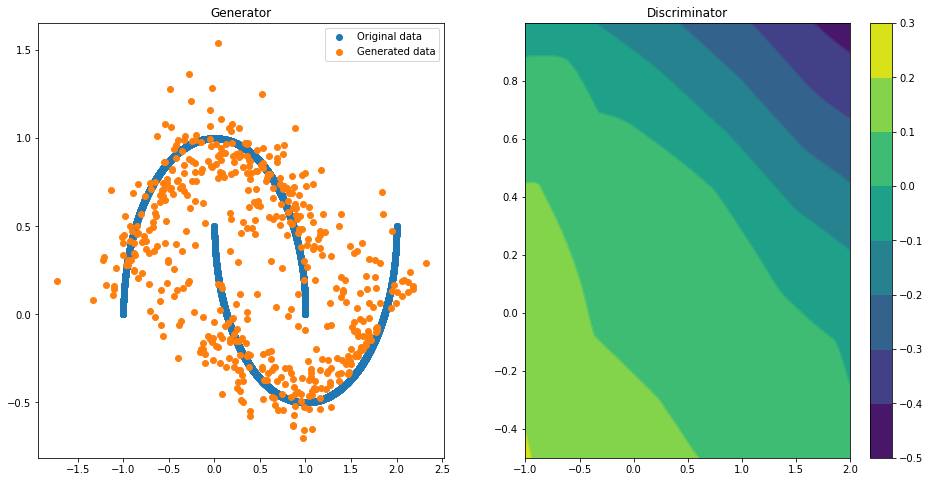

Epoch 075 | ET 21.58 min | Avg Losses >> G/D 0.6990/1.3830


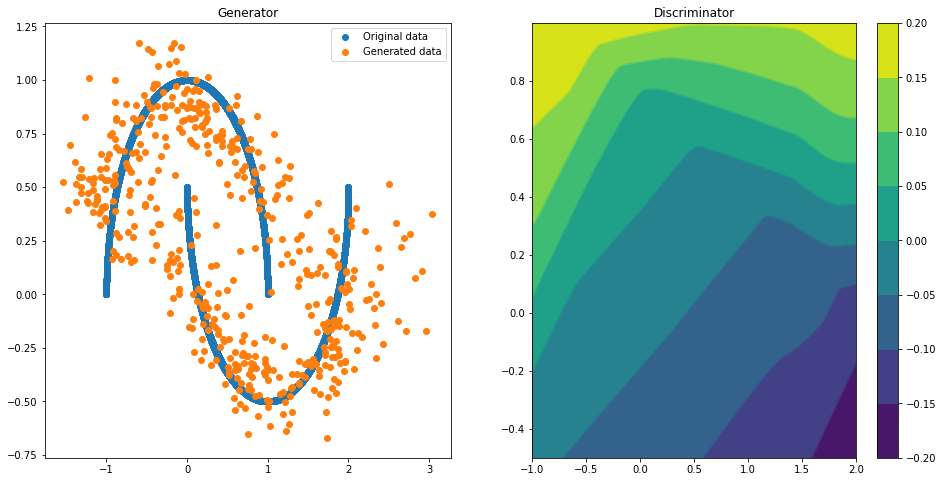

Epoch 080 | ET 23.69 min | Avg Losses >> G/D 0.6979/1.3811
Epoch 085 | ET 24.53 min | Avg Losses >> G/D 0.6993/1.3814
Epoch 090 | ET 25.37 min | Avg Losses >> G/D 0.6988/1.3810
Epoch 095 | ET 26.21 min | Avg Losses >> G/D 0.6993/1.3818


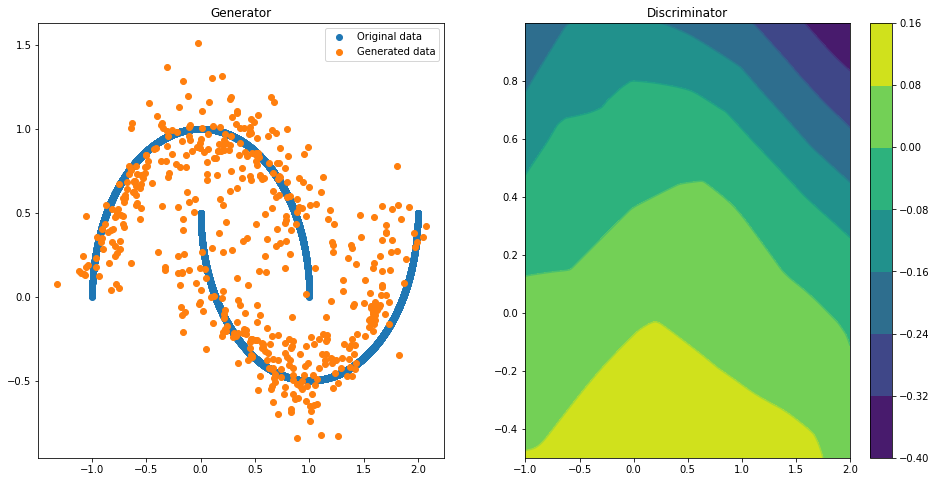

Epoch 100 | ET 28.29 min | Avg Losses >> G/D 0.6974/1.3821


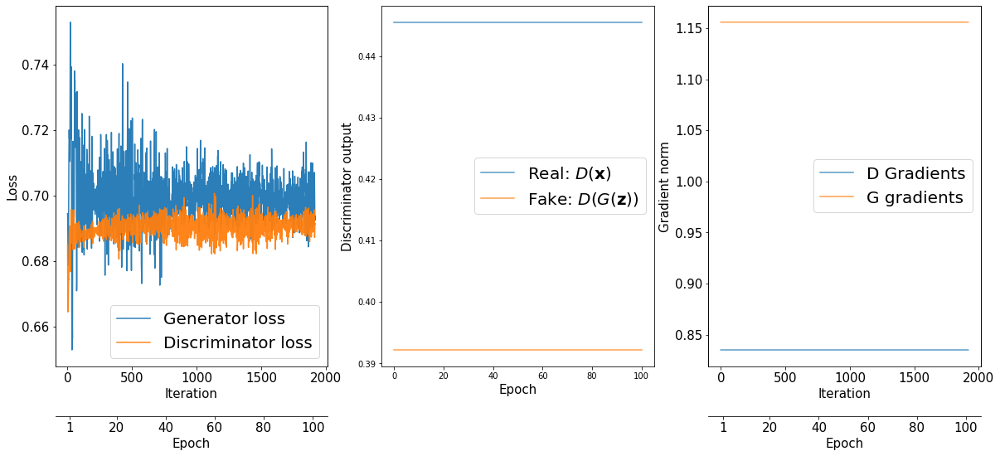

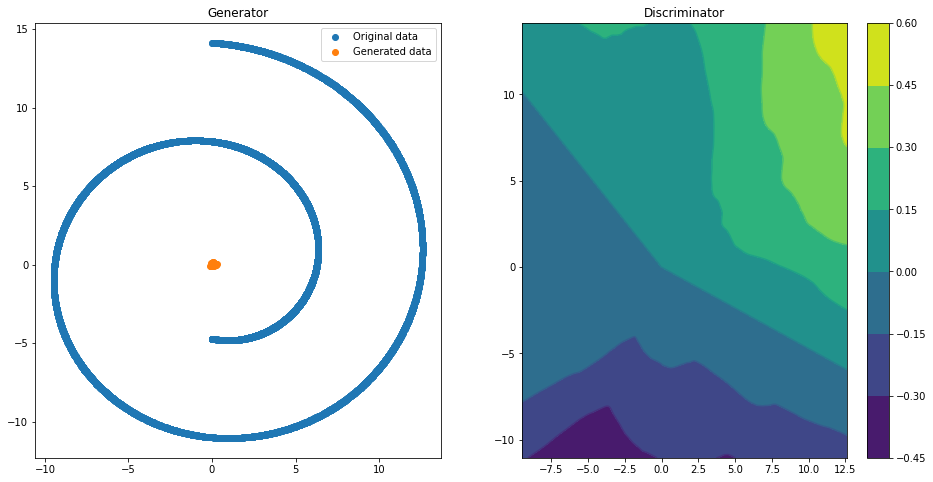

Epoch 000 | ET 1.44 min | Avg Losses >> G/D 0.6983/0.9798
Epoch 005 | ET 2.27 min | Avg Losses >> G/D 0.7611/1.3677
Epoch 010 | ET 3.12 min | Avg Losses >> G/D 0.7054/1.3764
Epoch 015 | ET 3.95 min | Avg Losses >> G/D 0.7080/1.3726


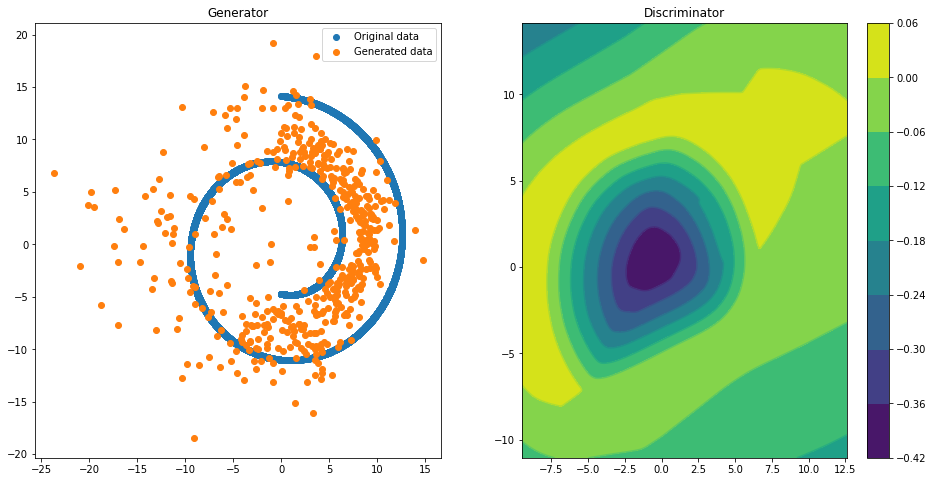

Epoch 020 | ET 6.08 min | Avg Losses >> G/D 0.7038/1.3737


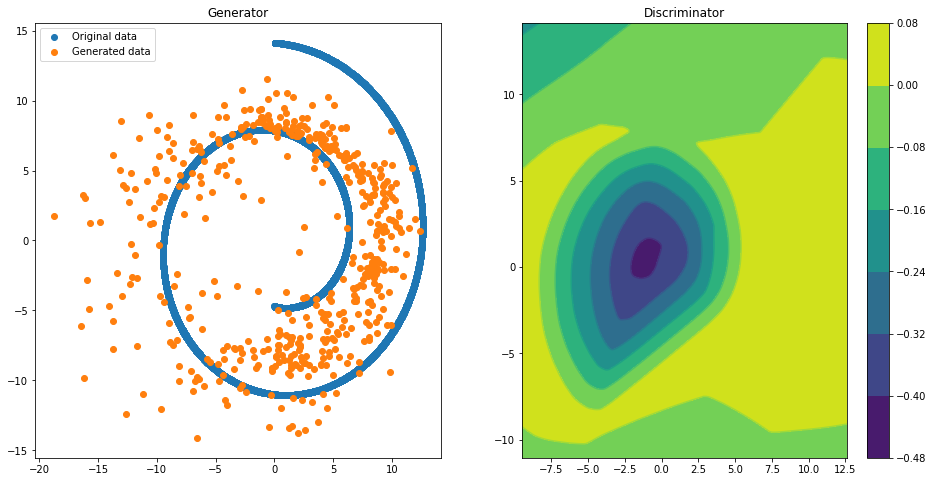

Epoch 025 | ET 8.17 min | Avg Losses >> G/D 0.6999/1.3761
Epoch 030 | ET 9.02 min | Avg Losses >> G/D 0.6999/1.3763
Epoch 035 | ET 9.86 min | Avg Losses >> G/D 0.6969/1.3767


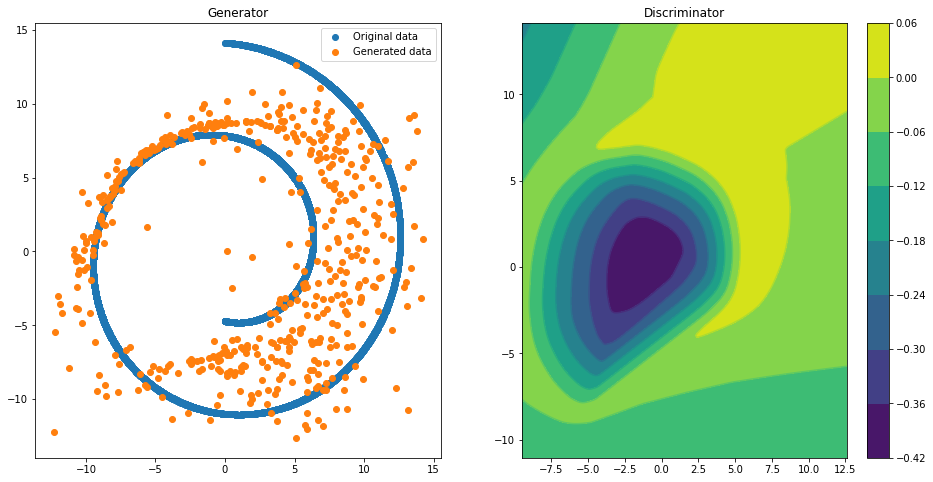

Epoch 040 | ET 11.96 min | Avg Losses >> G/D 0.6953/1.3785
Epoch 045 | ET 12.80 min | Avg Losses >> G/D 0.7005/1.3772


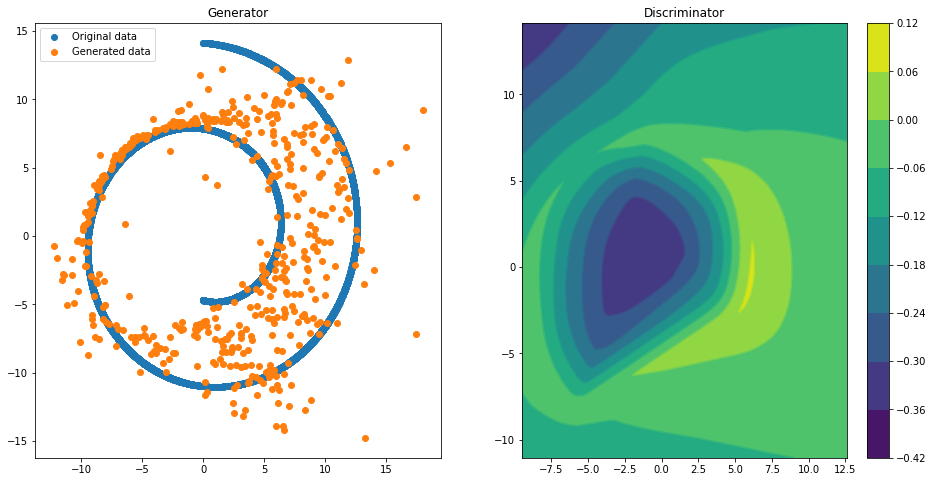

Epoch 050 | ET 14.91 min | Avg Losses >> G/D 0.6970/1.3786
Epoch 055 | ET 15.75 min | Avg Losses >> G/D 0.7020/1.3768


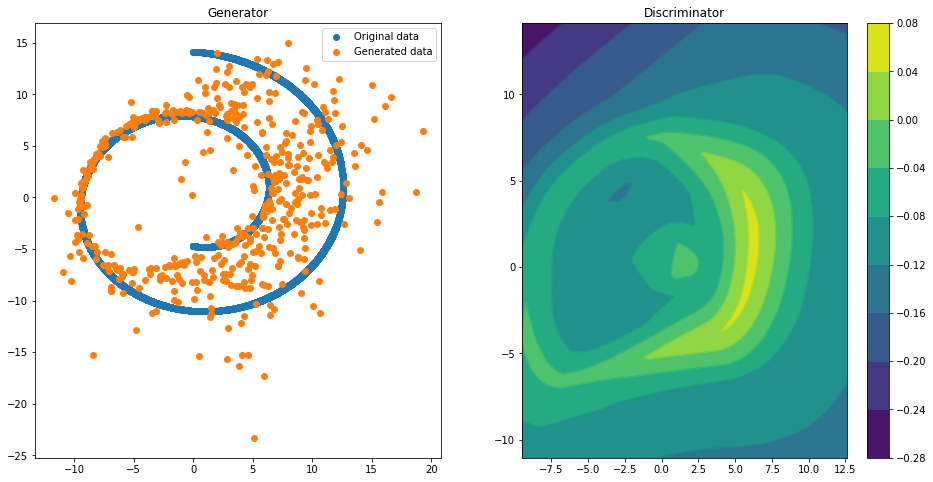

Epoch 060 | ET 17.87 min | Avg Losses >> G/D 0.6980/1.3773
Epoch 065 | ET 18.71 min | Avg Losses >> G/D 0.6985/1.3793
Epoch 070 | ET 19.54 min | Avg Losses >> G/D 0.6984/1.3789


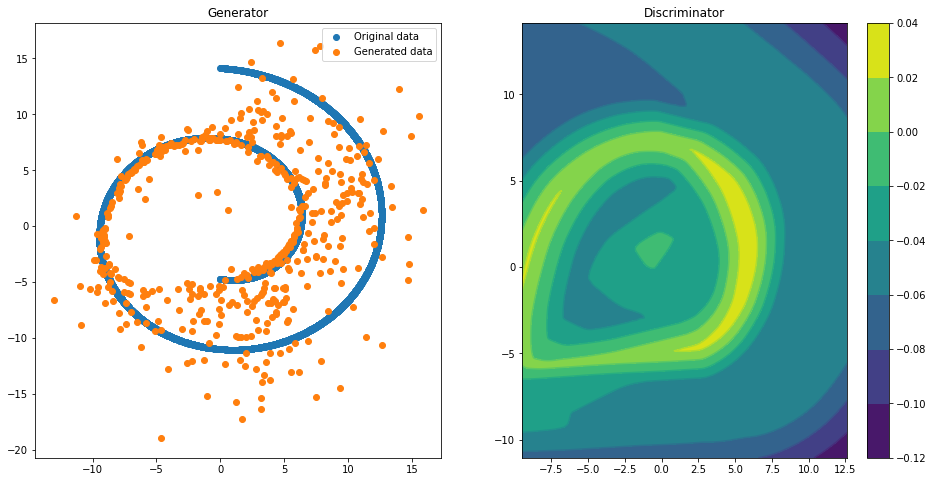

Epoch 075 | ET 21.67 min | Avg Losses >> G/D 0.6950/1.3791


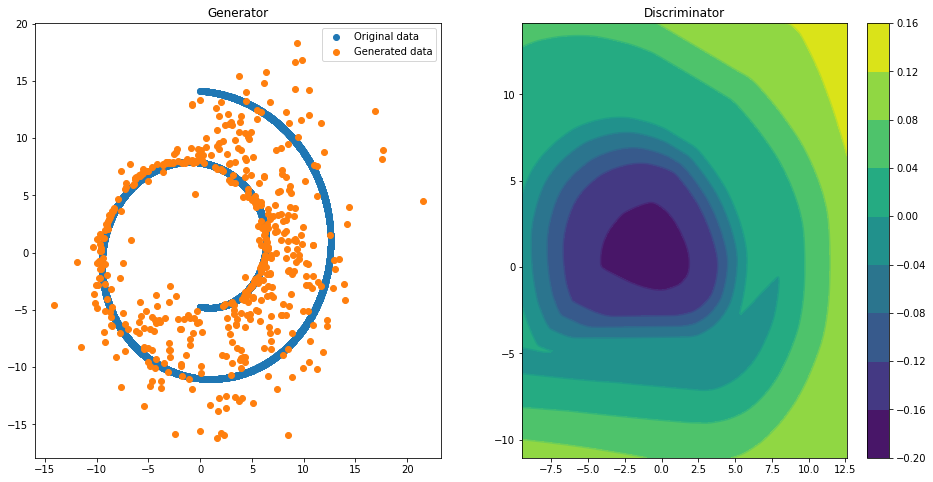

Epoch 080 | ET 23.79 min | Avg Losses >> G/D 0.6969/1.3791
Epoch 085 | ET 24.61 min | Avg Losses >> G/D 0.6913/1.3748
Epoch 090 | ET 25.46 min | Avg Losses >> G/D 0.7067/1.3599
Epoch 095 | ET 26.30 min | Avg Losses >> G/D 0.7028/1.3602


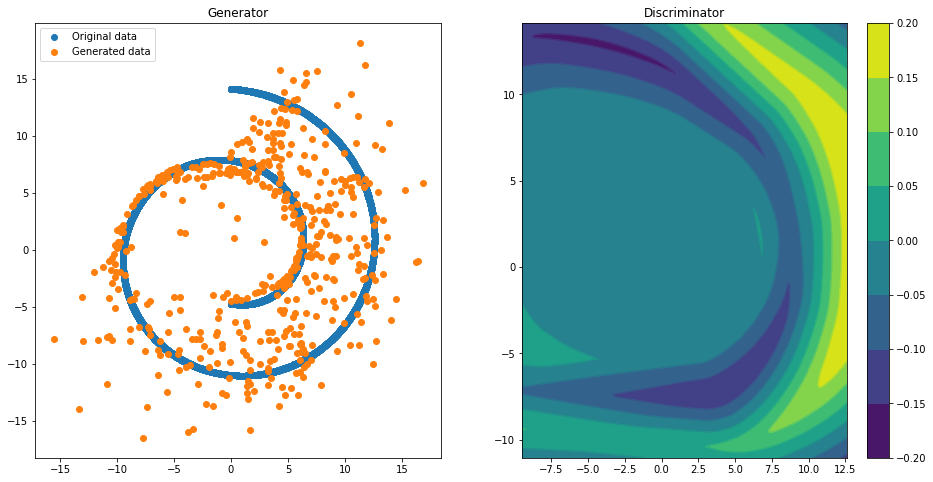

Epoch 100 | ET 28.40 min | Avg Losses >> G/D 0.7050/1.3607


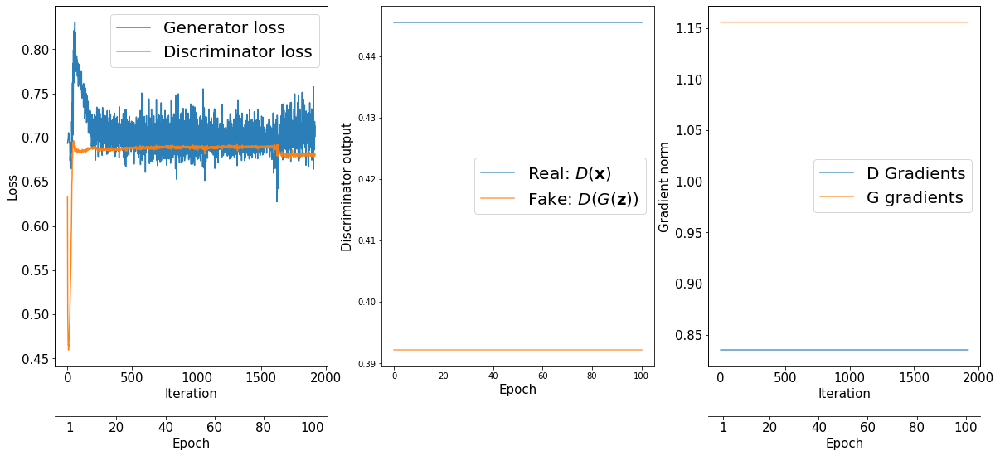

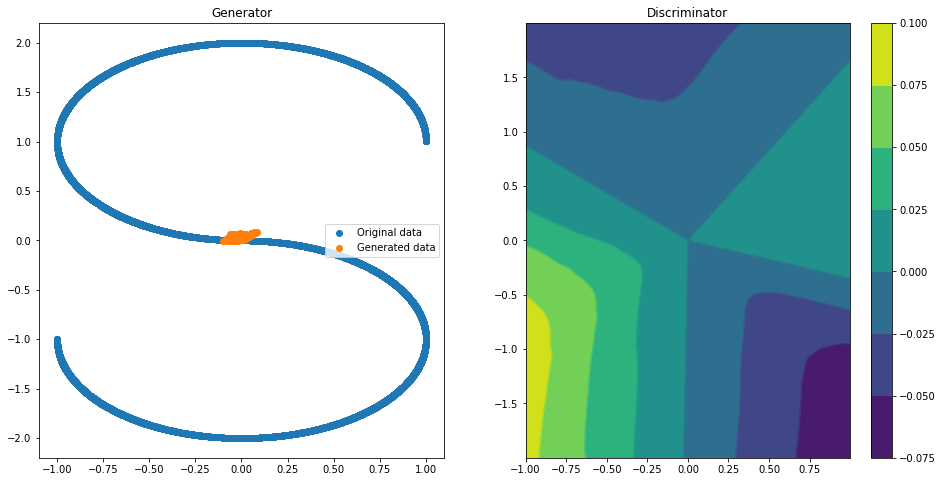

Epoch 000 | ET 1.43 min | Avg Losses >> G/D 0.7001/1.3078
Epoch 005 | ET 2.27 min | Avg Losses >> G/D 0.6975/1.3708
Epoch 010 | ET 3.10 min | Avg Losses >> G/D 0.7007/1.3773
Epoch 015 | ET 3.94 min | Avg Losses >> G/D 0.7063/1.3759


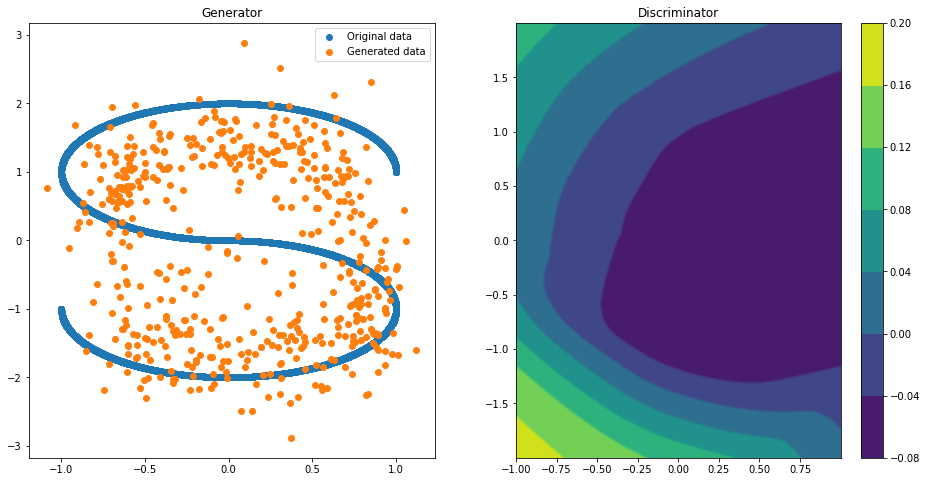

Epoch 020 | ET 6.04 min | Avg Losses >> G/D 0.7010/1.3783


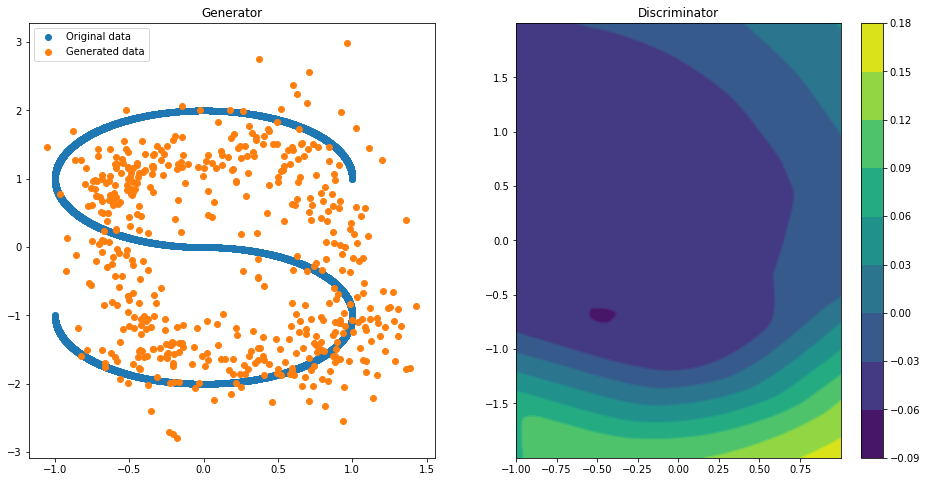

Epoch 025 | ET 8.17 min | Avg Losses >> G/D 0.7036/1.3776
Epoch 030 | ET 9.01 min | Avg Losses >> G/D 0.7031/1.3778
Epoch 035 | ET 9.85 min | Avg Losses >> G/D 0.6976/1.3808


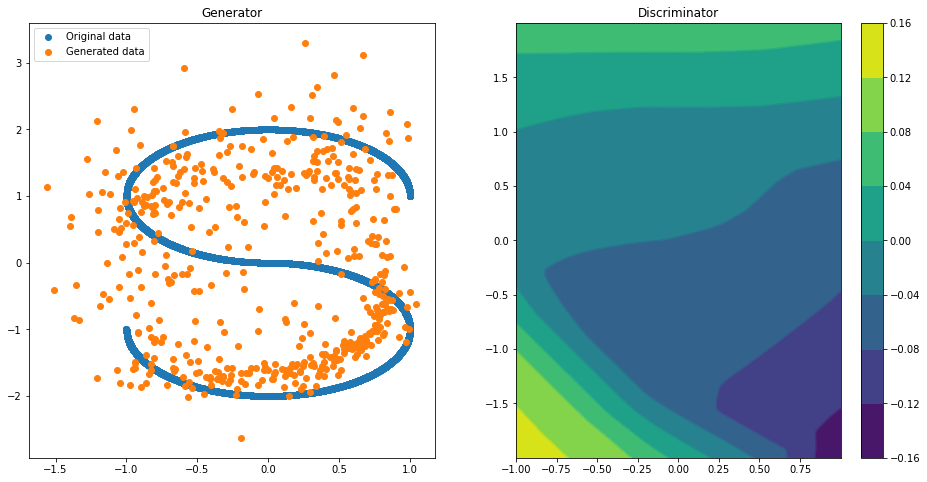

Epoch 040 | ET 11.98 min | Avg Losses >> G/D 0.6994/1.3794
Epoch 045 | ET 12.82 min | Avg Losses >> G/D 0.7014/1.3778


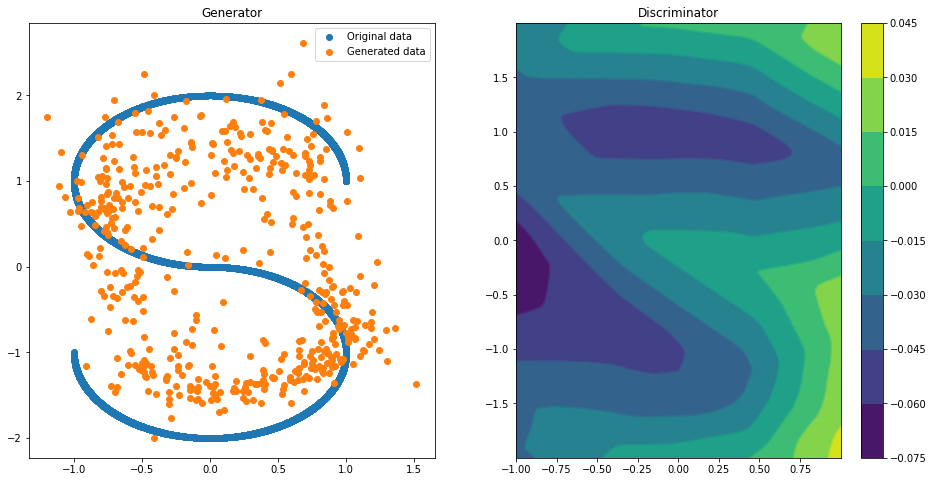

Epoch 050 | ET 14.93 min | Avg Losses >> G/D 0.6999/1.3768
Epoch 055 | ET 15.77 min | Avg Losses >> G/D 0.6987/1.3770


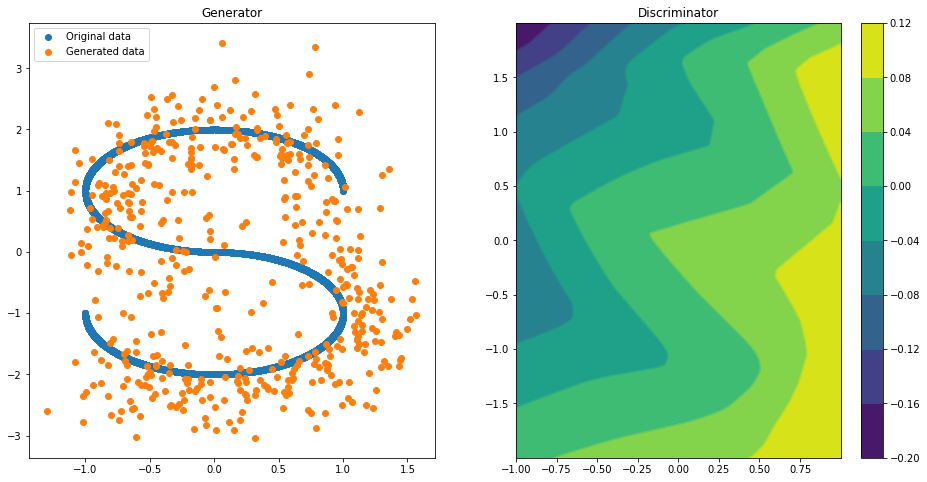

Epoch 060 | ET 17.88 min | Avg Losses >> G/D 0.7011/1.3766
Epoch 065 | ET 18.70 min | Avg Losses >> G/D 0.6996/1.3774
Epoch 070 | ET 19.55 min | Avg Losses >> G/D 0.7045/1.3768


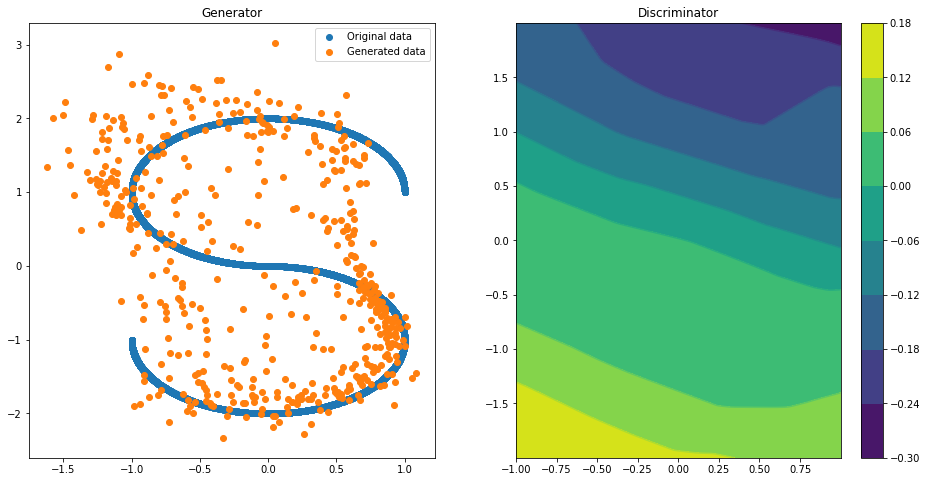

Epoch 075 | ET 21.66 min | Avg Losses >> G/D 0.7011/1.3780


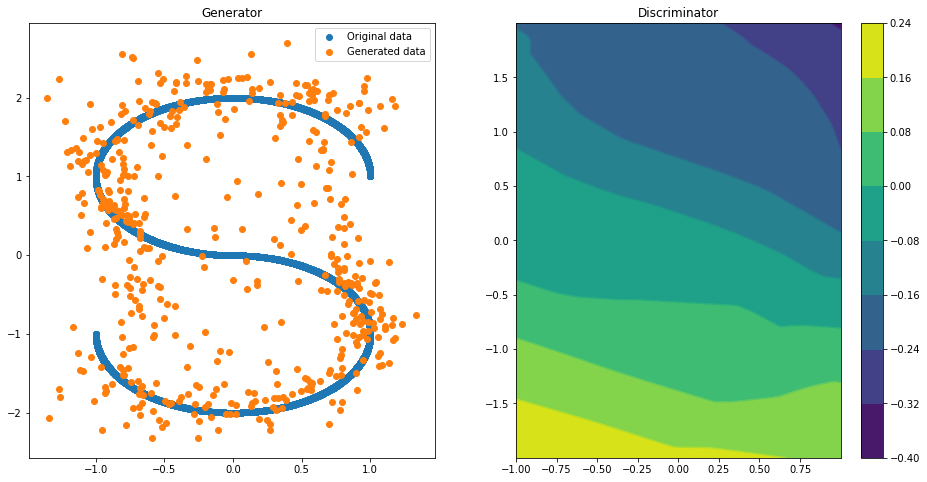

Epoch 080 | ET 23.76 min | Avg Losses >> G/D 0.6950/1.3801
Epoch 085 | ET 24.60 min | Avg Losses >> G/D 0.7021/1.3777
Epoch 090 | ET 25.44 min | Avg Losses >> G/D 0.7001/1.3776
Epoch 095 | ET 26.29 min | Avg Losses >> G/D 0.7008/1.3785


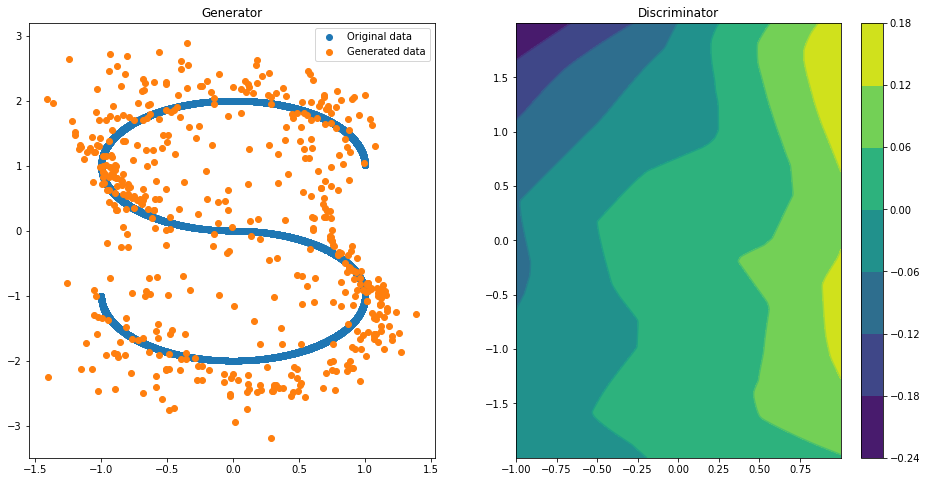

Epoch 100 | ET 28.39 min | Avg Losses >> G/D 0.6990/1.3791


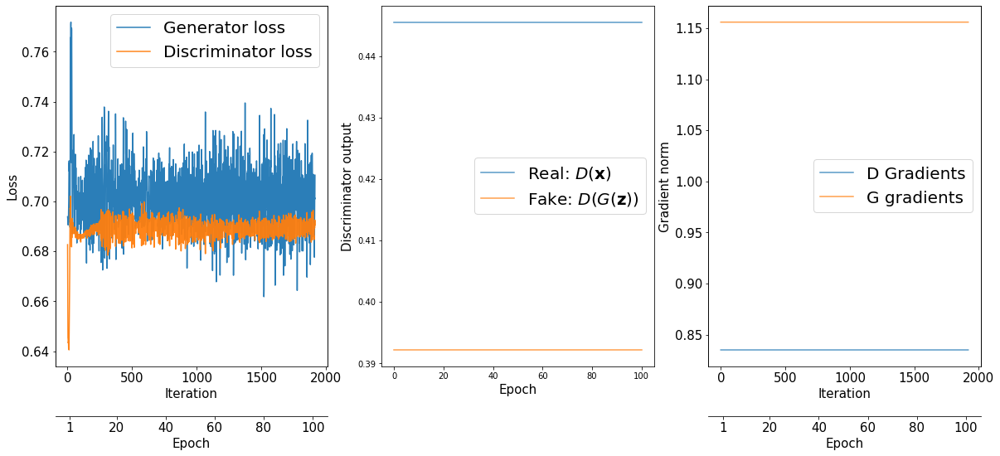

In [ ]:
z_size = 2
num_epochs = 100
batch_size = 512
gp_weight = .10
device_name = tf.test.gpu_device_name()
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
for current_data in [quadratic, circle, mixture, blobs, circles, moons, swiss_roll, s_curve]:
  numpy_data = current_data
  data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size, drop_remainder=True)
  fixed_z = tf.random.normal(shape=[500, z_size])

  generator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  discriminator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  with tf.device(device_name):
    gen_model = make_generator_network()
    gen_model.build(input_shape=(None,z_size))
    disc_model = make_discriminator_network()
    disc_model.build(input_shape=(None,2))
    
  all_losses = []
  all_d_vals = []
  d_gradients = []
  g_gradients = []
  epoch_samples = []
  start_time = time.time()
  for epoch in range(0, num_epochs+1):
    epoch_losses, epoch_d_vals = [], []
    #Plotting every 50
    if (epoch%20 == 0) or (epoch%25==0):
        input_z = tf.random.normal(shape = (500,z_size))
        epoch_samples.append(gen_model(input_z, training=False).numpy())
        X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
        x = np.linspace(np.min(X_data), np.max(X_data), 200)
        y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
        X, Y = np.meshgrid(x, y)
        Z = np.zeros((len(x), len(y)))
        for i in range(len(x)):
          for j in range(len(y)):
            q = tf.convert_to_tensor(np.array([[x[j],y[i]]]).astype("float32"))
            Z[i][j] = disc_model(q).numpy()[0][0]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
        ax1.scatter(X_data,Y_data, label = "Original data")
        ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
        ax1.set_title("Generator")
        ax1.legend()
        ax2.contour(X,Y,Z)
        ax2.set_title("Discriminator")
        cp = ax2.contourf(X , Y , Z)
        plt.colorbar(cp, ax=ax2)
        plt.show()
    for batch in data:
      for i in range(3):
        random_latent_vectors = tf.random.normal(shape=[batch_size,z_size])
        with tf.GradientTape() as tape:
          g_output = gen_model(random_latent_vectors)
          d_logits_real = disc_model(batch,
                                 training=True)
          d_labels_real = tf.ones_like(d_logits_real)
          d_loss_real = loss_fn(y_true=d_labels_real,
                            y_pred=d_logits_real)
          d_logits_fake = disc_model(g_output,
                                training=True)
          d_labels_fake = tf.zeros_like(d_logits_fake)
          d_loss_fake = loss_fn(y_true=d_labels_fake,
                            y_pred=d_logits_fake)
          d_loss = d_loss_real + d_loss_fake
        
        d_grads = tape.gradient(d_loss,
                              disc_model.trainable_variables)
        discriminator_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                  disc_model.trainable_variables))

      random_latent_vectors = tf.random.normal(shape=(batch_size, z_size))
      
      with tf.GradientTape() as tape:
        g_output = gen_model(random_latent_vectors)
        d_logits_fake = disc_model(g_output,
                                 training=True)
        labels_real = tf.ones_like(d_logits_fake)
        g_loss = loss_fn(y_true=labels_real,
                       y_pred=d_logits_fake)
        #Compute the gradients of g_loss
      g_grads = tape.gradient(g_loss,
                              gen_model.trainable_variables)
      #Apply the gradients
      generator_optimizer.apply_gradients(
          grads_and_vars=zip(g_grads,
                             gen_model.trainable_variables)
      )

      epoch_losses.append(
                            (g_loss.numpy(), d_loss.numpy())
                            )
      d_probs_real = tf.reduce_mean(
                            tf.sigmoid(real_logits))
      d_probs_fake = tf.reduce_mean(
                            tf.sigmoid(fake_logits))
      g_gradients.append(tf.linalg.global_norm(gen_gradient).numpy())
      d_gradients.append(tf.linalg.global_norm(d_gradient).numpy())
    epoch_d_vals.append((d_probs_real.numpy(),
                            d_probs_fake.numpy()))
    
    all_losses.append(epoch_losses)
    all_d_vals.append(epoch_d_vals)
      
    if epoch%5 == 0:
        print(
              'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
              ' G/D {:.4f}/{:.4f}'
              .format(
              epoch, (time.time() - start_time)/60,
              *list(np.mean(all_losses[-1], axis=0))))
  fig = plt.figure(figsize=(20, 8))

  ## Plotting the losses
  import itertools
  ax = fig.add_subplot(1, 3, 1)
  g_losses = [item[0] for item in itertools.chain(*all_losses)]
  d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
  plt.plot(g_losses, label='Generator loss', alpha=0.95)
  plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Loss', size=15)

  epochs = np.arange(1, 101)
  epoch2iter = lambda e: e*len(all_losses[-1])
  epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
  newpos = [epoch2iter(e) for e in epoch_ticks]
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  ## Plotting the outputs of the discriminator
  ax = fig.add_subplot(1, 3, 2)
  d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
  d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
  plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
  plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
  plt.legend(fontsize=20)
  ax.set_xlabel('Epoch', size=15)
  ax.set_ylabel('Discriminator output', size=15)


  ax = fig.add_subplot(1, 3, 3)
  plt.plot(d_gradients, label = "D Gradients", alpha=.75)
  plt.plot(g_gradients, label = "G gradients", alpha = .75)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Gradient norm', size=15)
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  #plt.savefig('images/ch17-gan-learning-curve.pdf')
  plt.show()

In [ ]:
def gradient_penalty(batch_size, real_images, fake_images, discriminator):
      """ Calculates the gradient penalty.

      This loss is calculated on an interpolated image
      and added to the discriminator loss.
      """
      # get the interplated image
      alpha = tf.random.normal([batch_size, 1], 0.0, 1.0)
      diff = fake_images - real_images
      interpolated = real_images + alpha * diff
      with tf.GradientTape() as gp_tape:
          gp_tape.watch(interpolated)
            # 1. Get the discriminator output for this interpolated image.
          pred = discriminator(interpolated, training=True)

        # 2. Calculate the gradients w.r.t to this interpolated image.
      grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Calcuate the norm of the gradients
      norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1]))
      gp = tf.reduce_mean((norm - 0.0) ** 2)
      return gp  

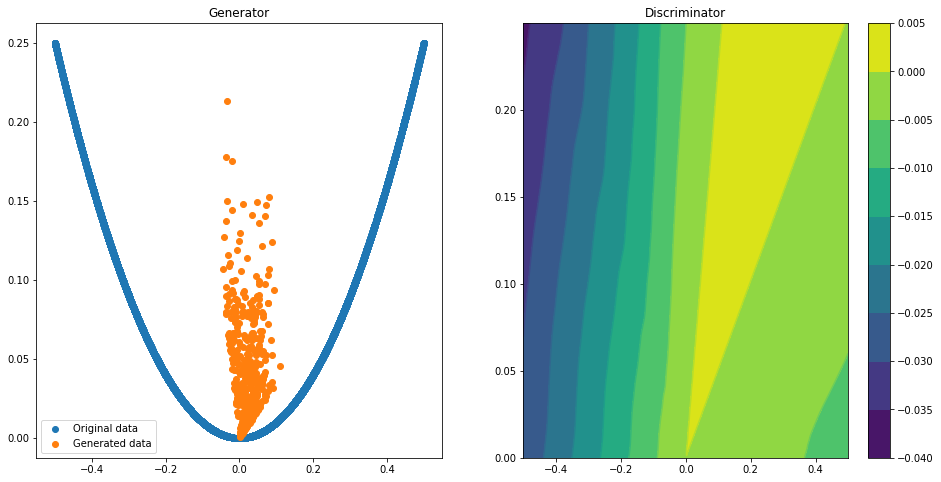

Epoch 000 | ET 0.98 min | Avg Losses >> G/D 0.6976/1.3829
Epoch 005 | ET 1.83 min | Avg Losses >> G/D 0.6946/1.3855
Epoch 010 | ET 2.68 min | Avg Losses >> G/D 0.6943/1.3855
Epoch 015 | ET 3.53 min | Avg Losses >> G/D 0.6939/1.3858


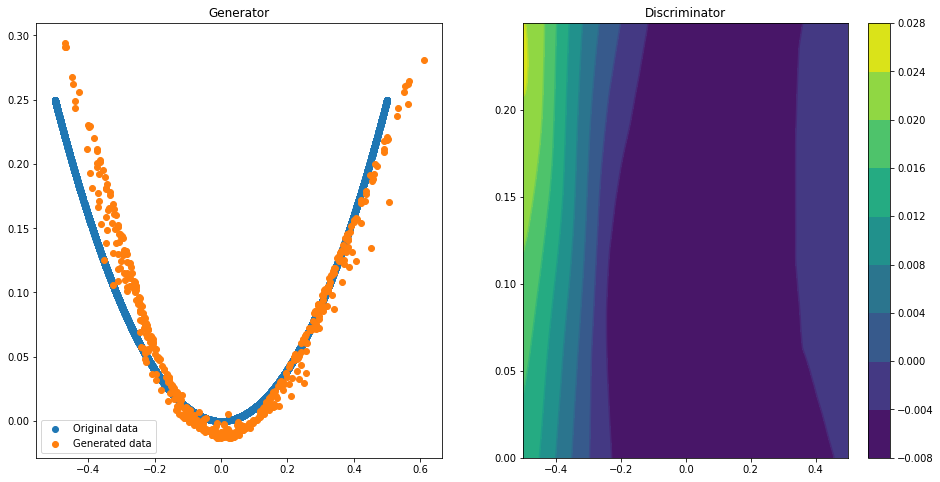

Epoch 020 | ET 5.19 min | Avg Losses >> G/D 0.6938/1.3859


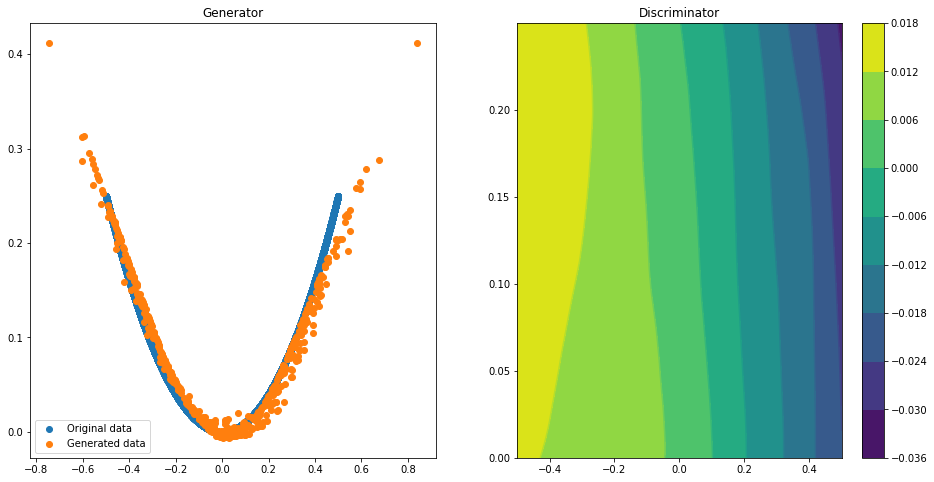

Epoch 025 | ET 6.85 min | Avg Losses >> G/D 0.6939/1.3858
Epoch 030 | ET 7.70 min | Avg Losses >> G/D 0.6938/1.3860
Epoch 035 | ET 8.55 min | Avg Losses >> G/D 0.6936/1.3861


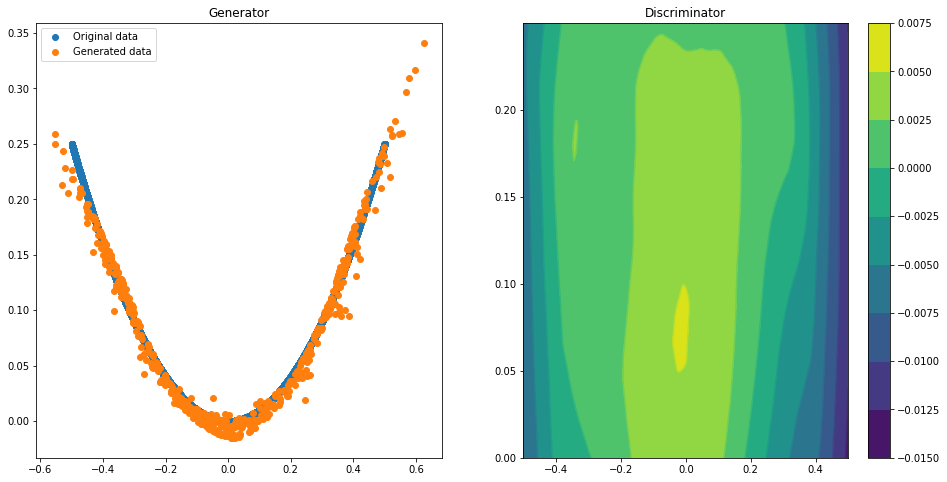

Epoch 040 | ET 10.38 min | Avg Losses >> G/D 0.6937/1.3861
Epoch 045 | ET 11.22 min | Avg Losses >> G/D 0.6935/1.3860


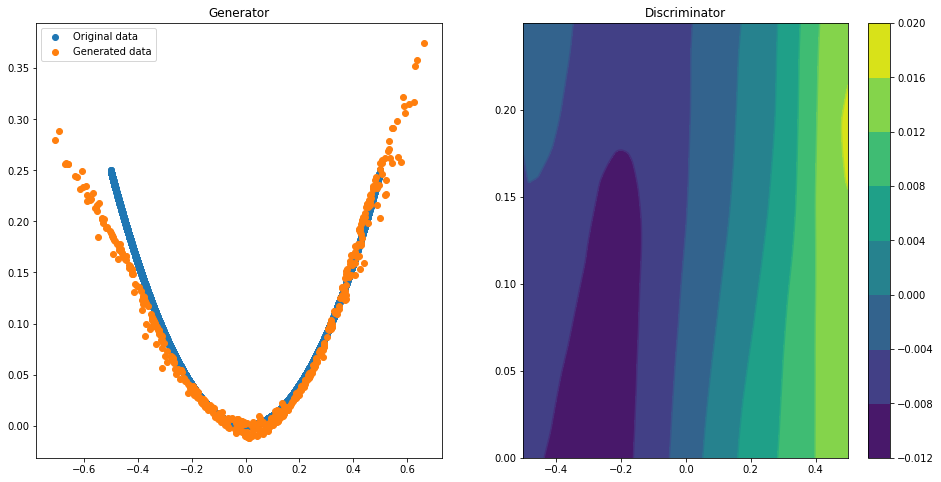

Epoch 050 | ET 12.88 min | Avg Losses >> G/D 0.6935/1.3861
Epoch 055 | ET 13.90 min | Avg Losses >> G/D 0.6936/1.3862


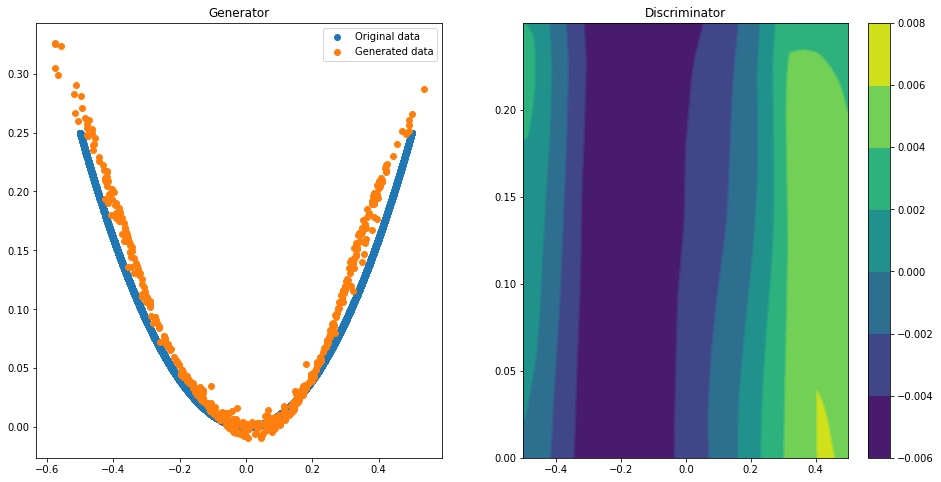

Epoch 060 | ET 15.59 min | Avg Losses >> G/D 0.6935/1.3861
Epoch 065 | ET 16.63 min | Avg Losses >> G/D 0.6936/1.3861
Epoch 070 | ET 17.47 min | Avg Losses >> G/D 0.6939/1.3860


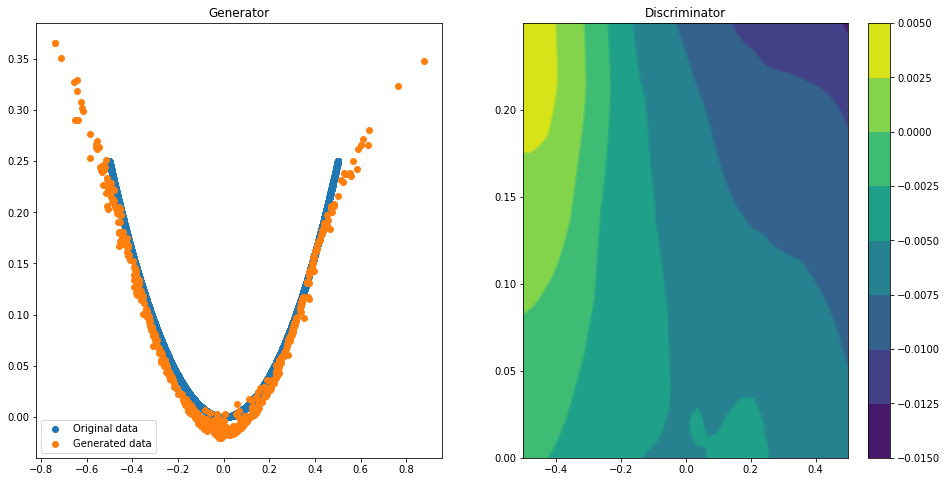

Epoch 075 | ET 19.13 min | Avg Losses >> G/D 0.6938/1.3860


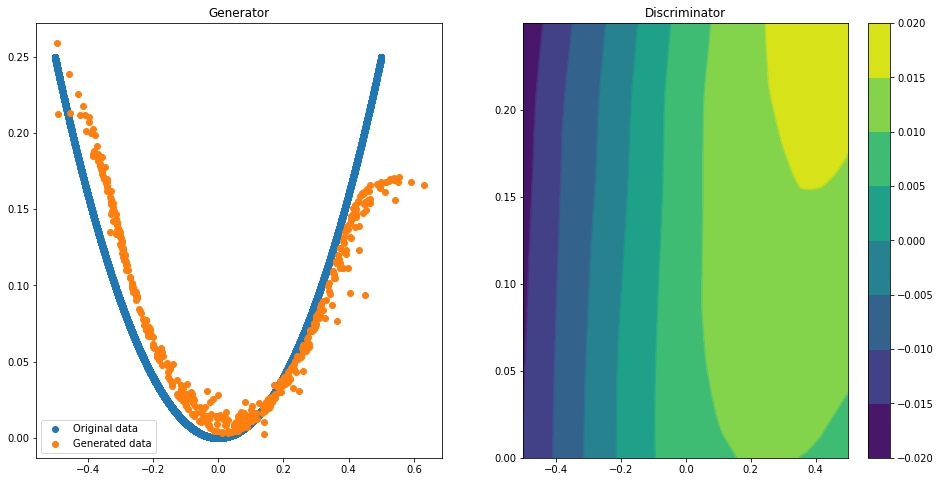

Epoch 080 | ET 20.79 min | Avg Losses >> G/D 0.6932/1.3862
Epoch 085 | ET 21.64 min | Avg Losses >> G/D 0.6937/1.3862
Epoch 090 | ET 22.49 min | Avg Losses >> G/D 0.6934/1.3862
Epoch 095 | ET 23.34 min | Avg Losses >> G/D 0.6938/1.3860


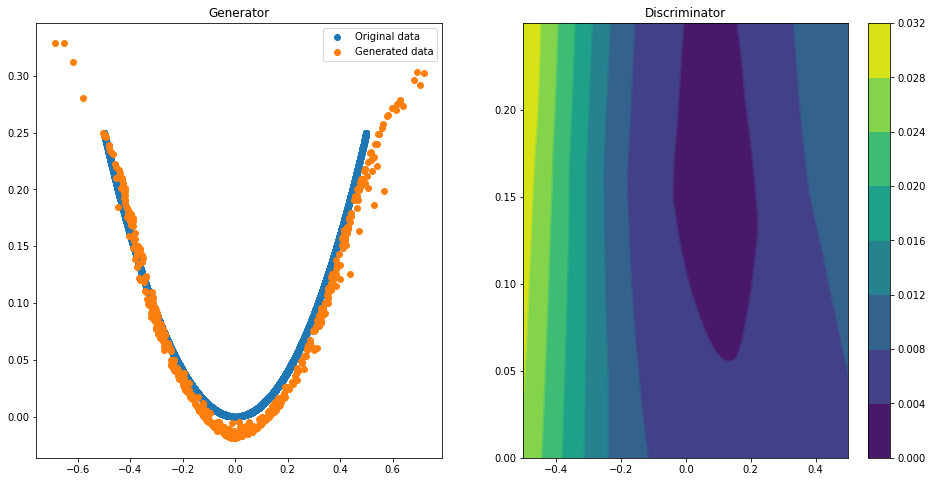

Epoch 100 | ET 25.00 min | Avg Losses >> G/D 0.6932/1.3862


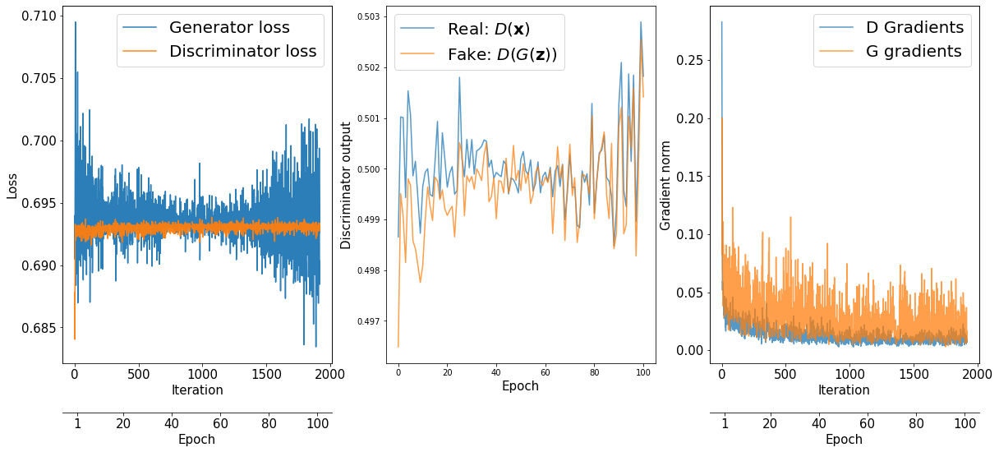

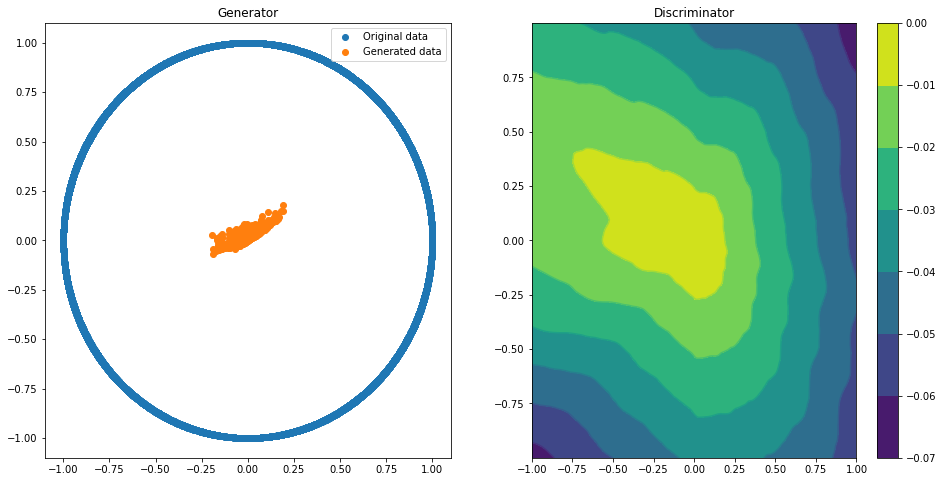

Epoch 000 | ET 0.98 min | Avg Losses >> G/D 0.7067/1.3432
Epoch 005 | ET 2.00 min | Avg Losses >> G/D 0.7062/1.3775
Epoch 010 | ET 2.85 min | Avg Losses >> G/D 0.6984/1.3832
Epoch 015 | ET 3.87 min | Avg Losses >> G/D 0.6995/1.3827


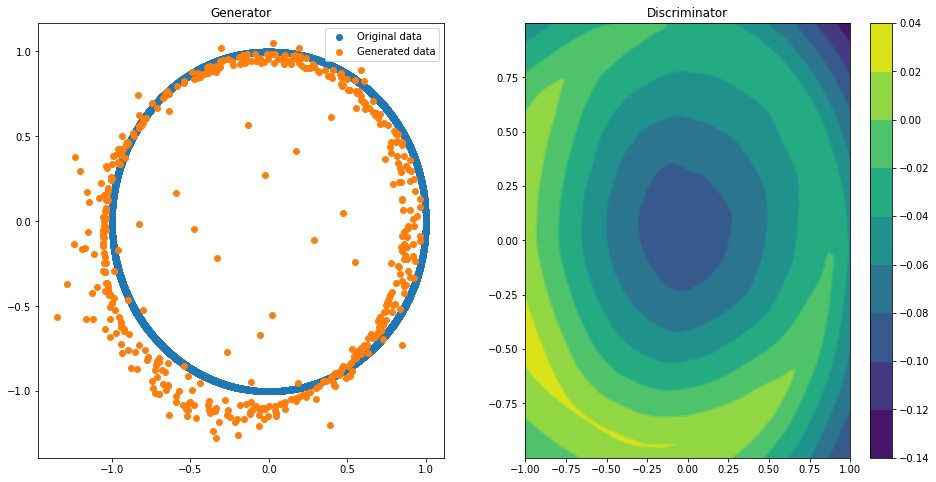

Epoch 020 | ET 5.53 min | Avg Losses >> G/D 0.6968/1.3834


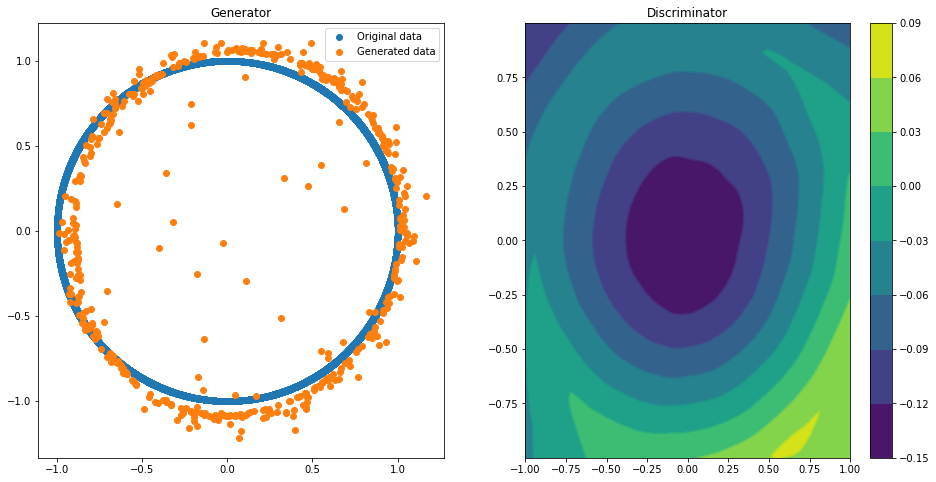

Epoch 025 | ET 7.19 min | Avg Losses >> G/D 0.6973/1.3830
Epoch 030 | ET 8.22 min | Avg Losses >> G/D 0.6967/1.3834
Epoch 035 | ET 9.06 min | Avg Losses >> G/D 0.6969/1.3841


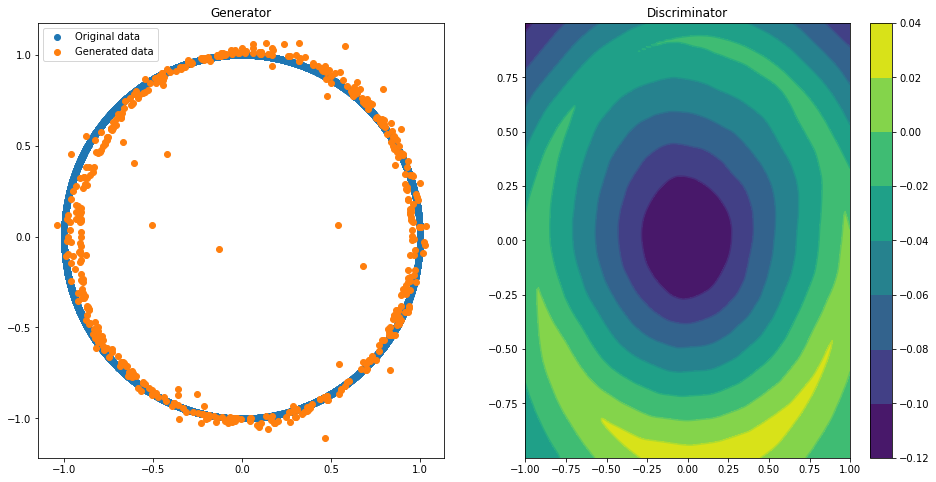

Epoch 040 | ET 10.73 min | Avg Losses >> G/D 0.6969/1.3842
Epoch 045 | ET 11.75 min | Avg Losses >> G/D 0.6971/1.3840


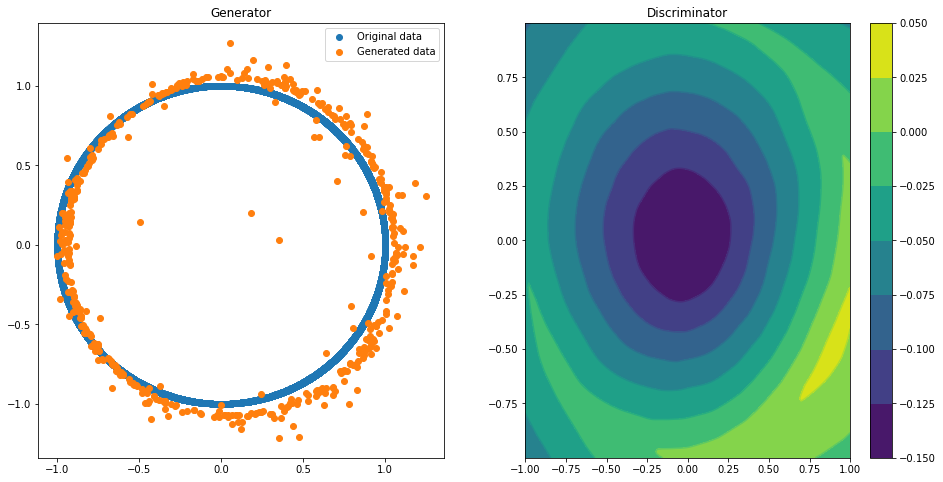

Epoch 050 | ET 13.41 min | Avg Losses >> G/D 0.6959/1.3846
Epoch 055 | ET 14.26 min | Avg Losses >> G/D 0.6964/1.3839


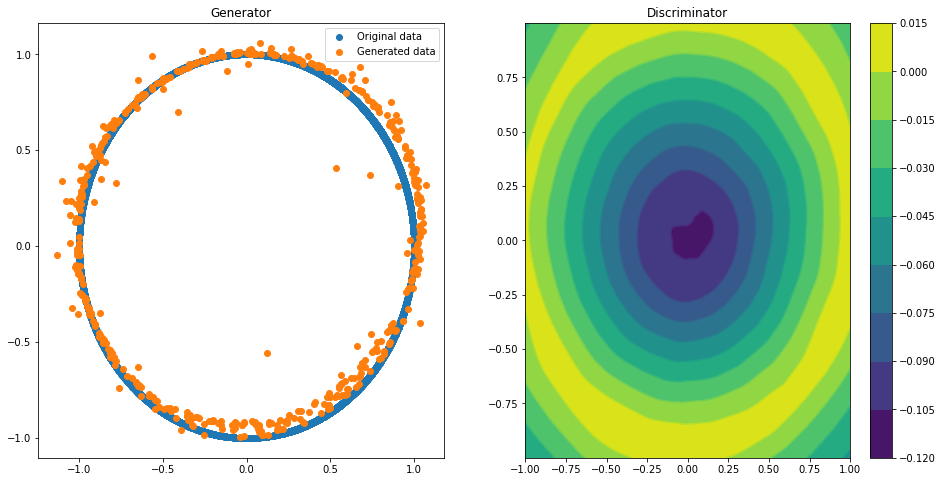

Epoch 060 | ET 16.09 min | Avg Losses >> G/D 0.6959/1.3844
Epoch 065 | ET 16.94 min | Avg Losses >> G/D 0.6957/1.3847
Epoch 070 | ET 17.96 min | Avg Losses >> G/D 0.6949/1.3849


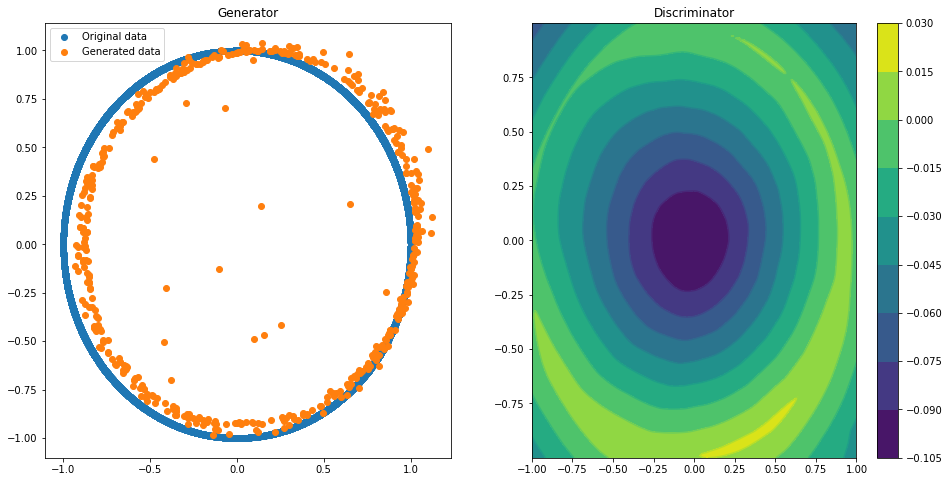

Epoch 075 | ET 19.80 min | Avg Losses >> G/D 0.6951/1.3847


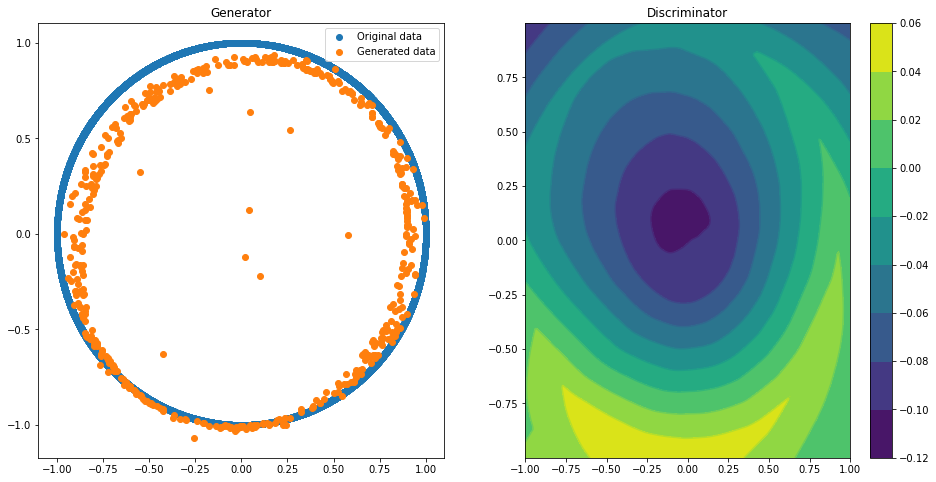

Epoch 080 | ET 21.47 min | Avg Losses >> G/D 0.6949/1.3847
Epoch 085 | ET 22.32 min | Avg Losses >> G/D 0.6953/1.3847
Epoch 090 | ET 23.17 min | Avg Losses >> G/D 0.6951/1.3846
Epoch 095 | ET 24.36 min | Avg Losses >> G/D 0.6947/1.3852


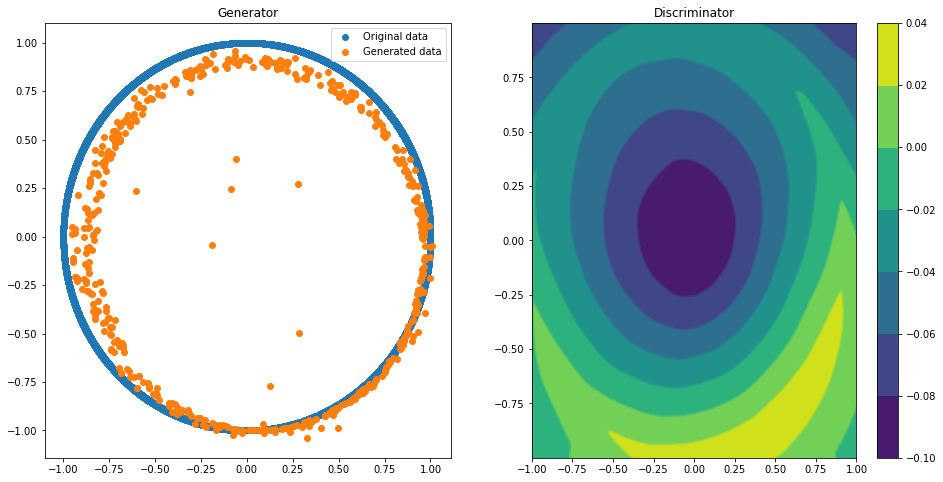

Epoch 100 | ET 26.02 min | Avg Losses >> G/D 0.6950/1.3848


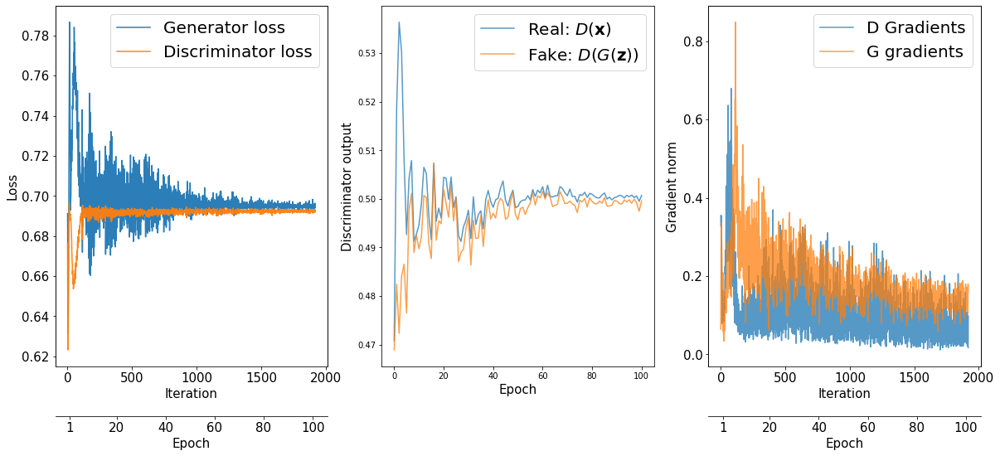

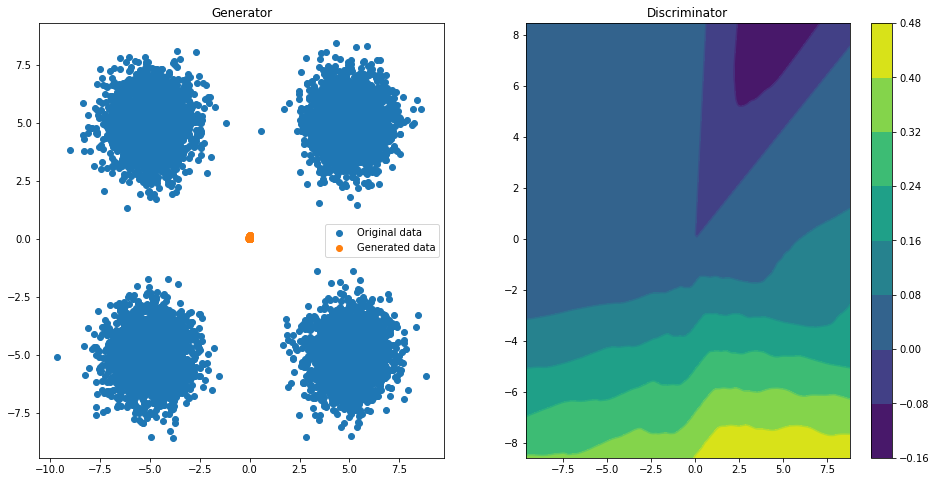

Epoch 000 | ET 1.16 min | Avg Losses >> G/D 0.9109/0.6715
Epoch 005 | ET 2.01 min | Avg Losses >> G/D 1.0566/1.1217
Epoch 010 | ET 2.86 min | Avg Losses >> G/D 0.9270/1.1980
Epoch 015 | ET 3.88 min | Avg Losses >> G/D 1.2170/1.1489


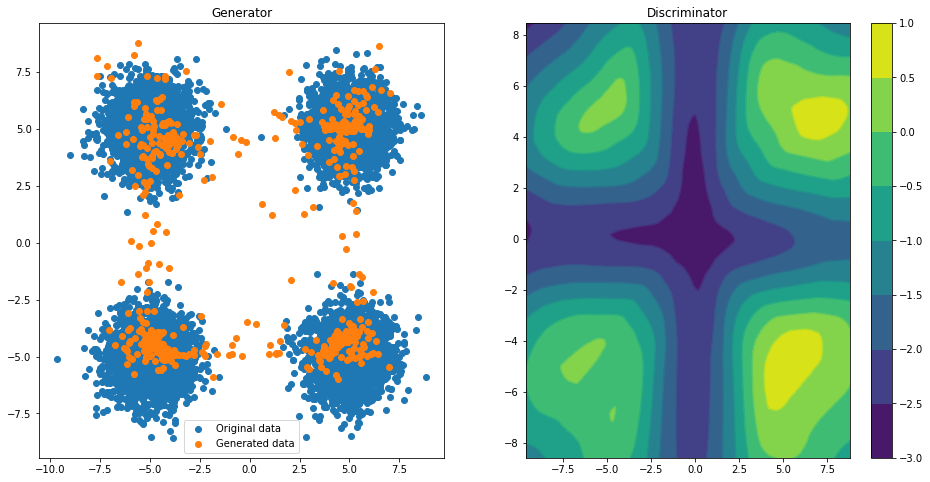

Epoch 020 | ET 5.54 min | Avg Losses >> G/D 0.8567/1.3184


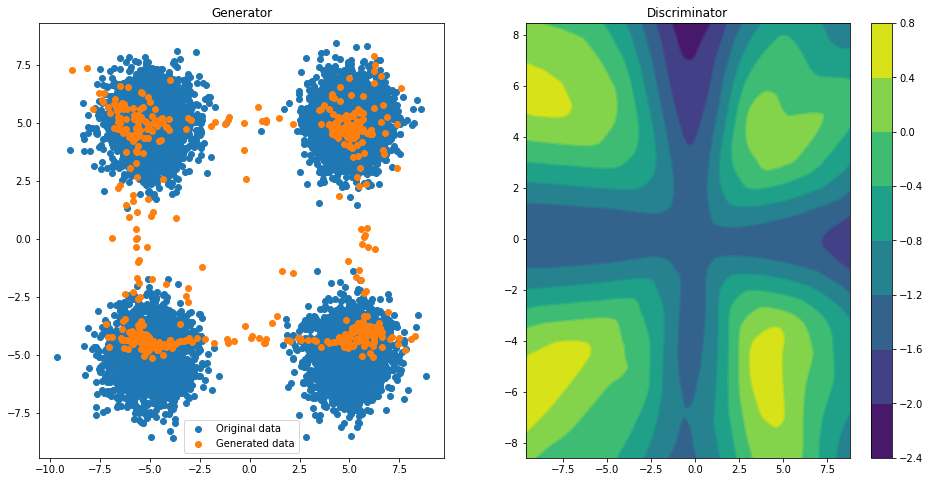

Epoch 025 | ET 7.21 min | Avg Losses >> G/D 0.7884/1.3381
Epoch 030 | ET 8.41 min | Avg Losses >> G/D 0.7667/1.3490
Epoch 035 | ET 9.77 min | Avg Losses >> G/D 0.7711/1.3403


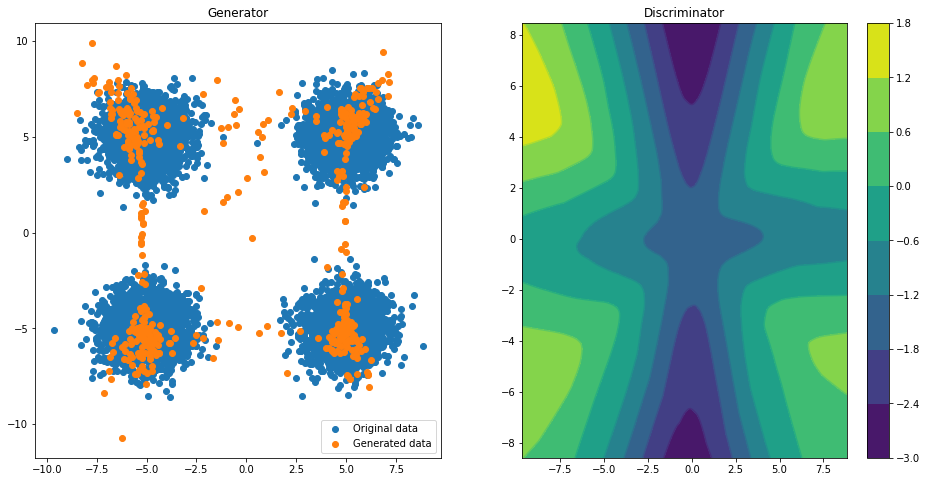

Epoch 040 | ET 11.80 min | Avg Losses >> G/D 0.7565/1.3502
Epoch 045 | ET 13.16 min | Avg Losses >> G/D 0.7592/1.3365


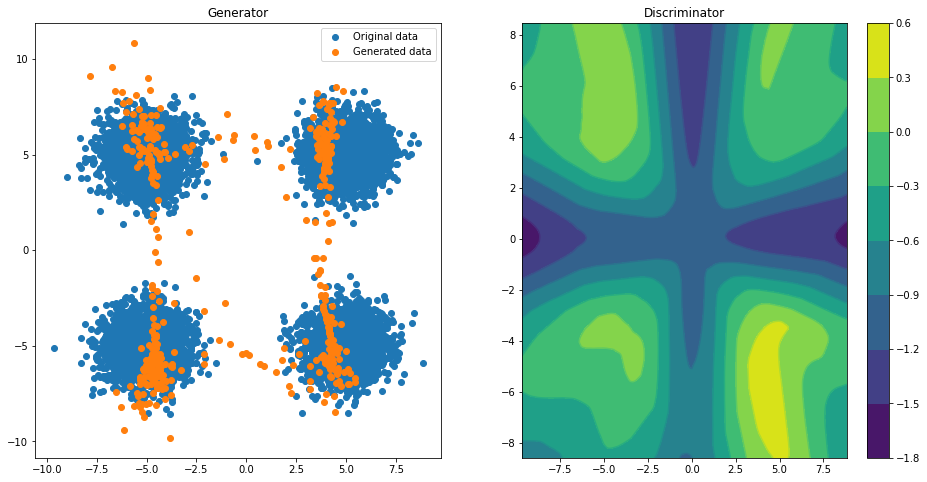

Epoch 050 | ET 15.18 min | Avg Losses >> G/D 0.7590/1.3468
Epoch 055 | ET 16.21 min | Avg Losses >> G/D 0.7392/1.3337


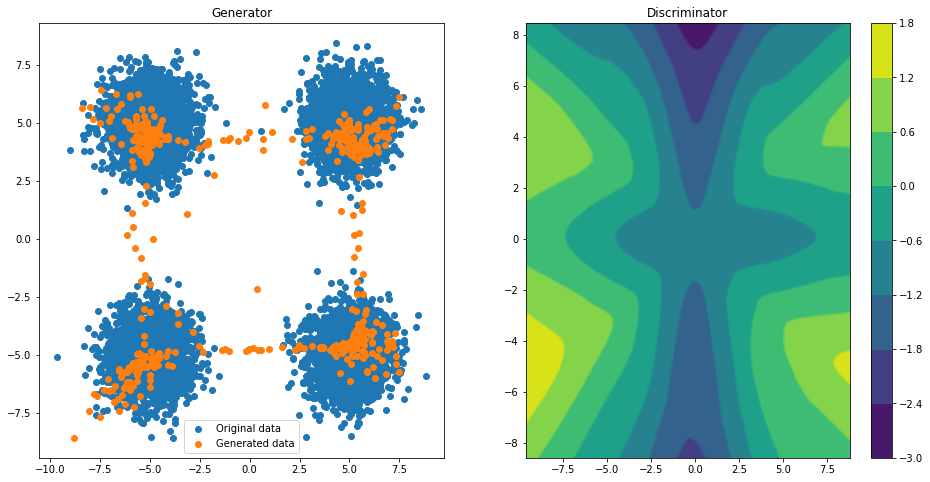

Epoch 060 | ET 18.06 min | Avg Losses >> G/D 0.7618/1.3484
Epoch 065 | ET 19.08 min | Avg Losses >> G/D 0.7513/1.3446
Epoch 070 | ET 19.93 min | Avg Losses >> G/D 0.7573/1.3423


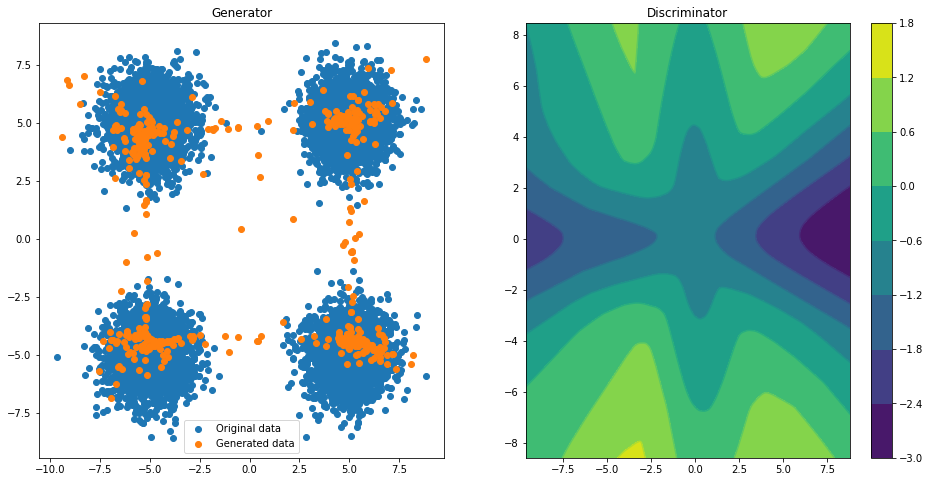

Epoch 075 | ET 21.95 min | Avg Losses >> G/D 0.7544/1.3492


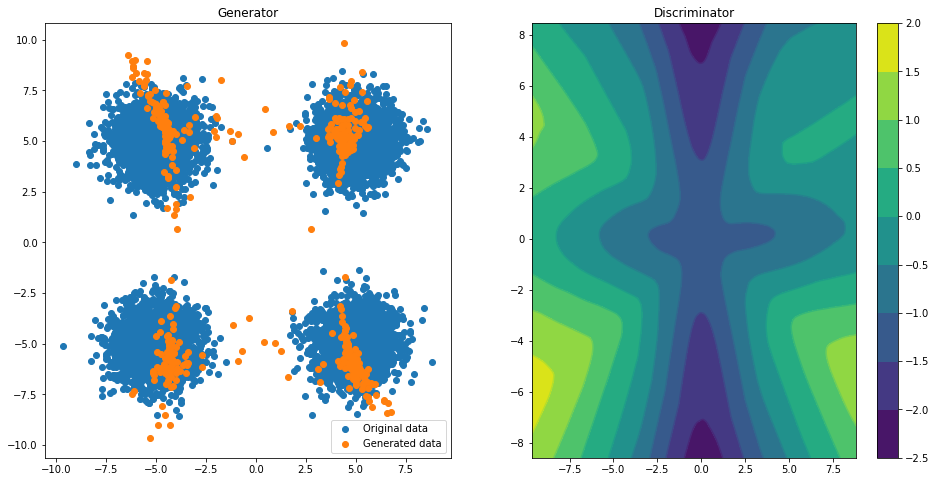

Epoch 080 | ET 24.14 min | Avg Losses >> G/D 0.7572/1.3476
Epoch 085 | ET 25.33 min | Avg Losses >> G/D 0.7387/1.3537
Epoch 090 | ET 26.18 min | Avg Losses >> G/D 0.7327/1.3518
Epoch 095 | ET 27.20 min | Avg Losses >> G/D 0.7368/1.3590


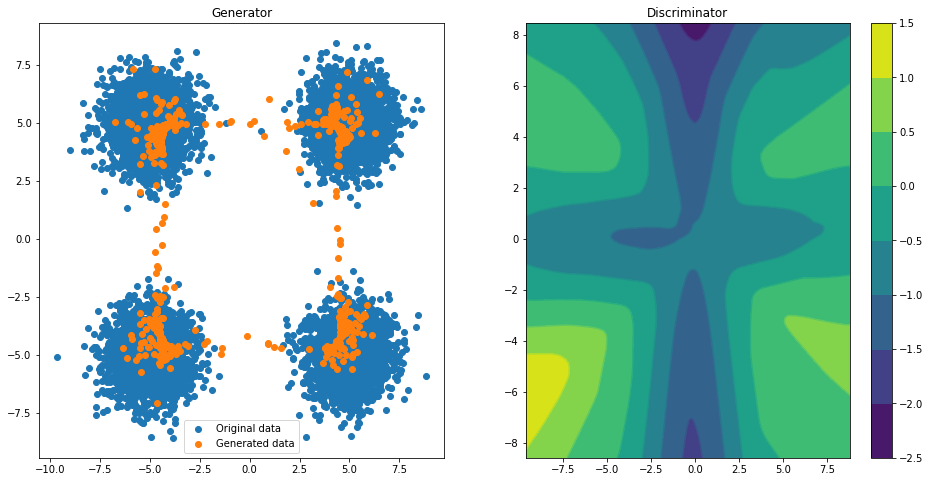

Epoch 100 | ET 29.04 min | Avg Losses >> G/D 0.7319/1.3579


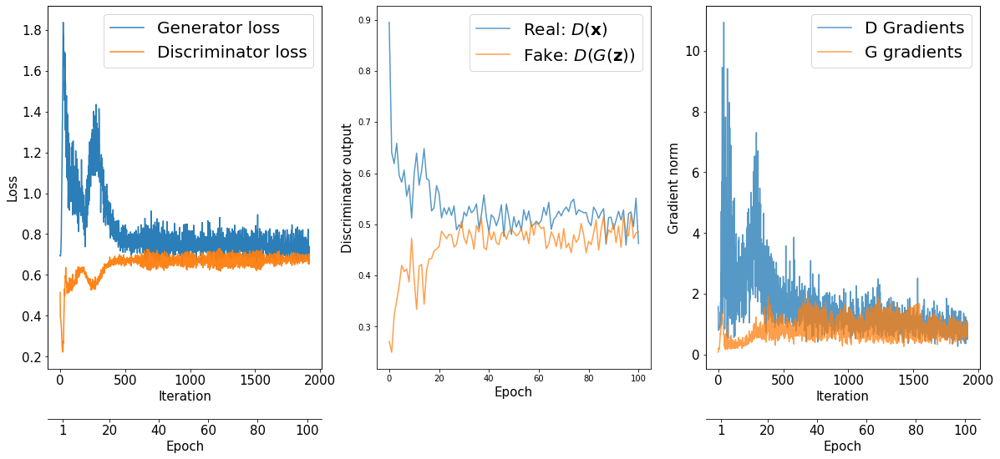

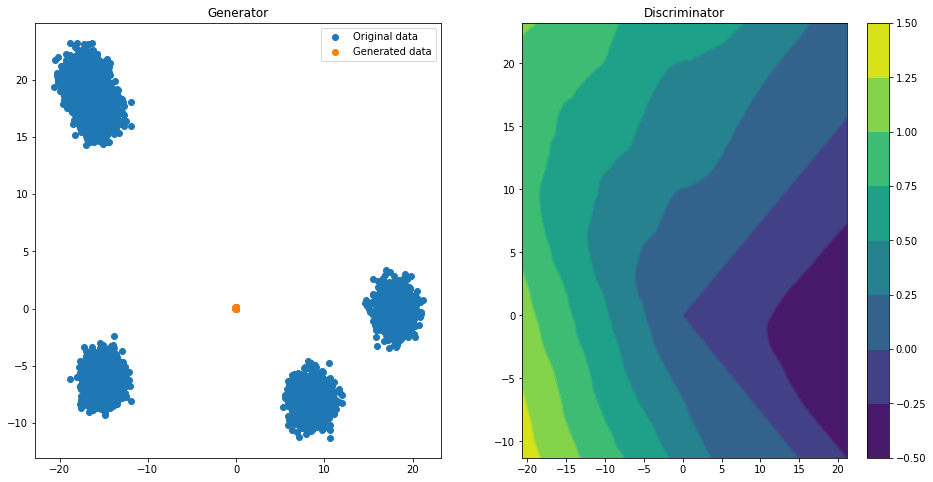

Epoch 000 | ET 0.99 min | Avg Losses >> G/D 0.9362/0.5803
Epoch 005 | ET 1.83 min | Avg Losses >> G/D 1.1459/1.0485
Epoch 010 | ET 2.68 min | Avg Losses >> G/D 1.1308/1.0601
Epoch 015 | ET 3.52 min | Avg Losses >> G/D 1.1909/0.9258


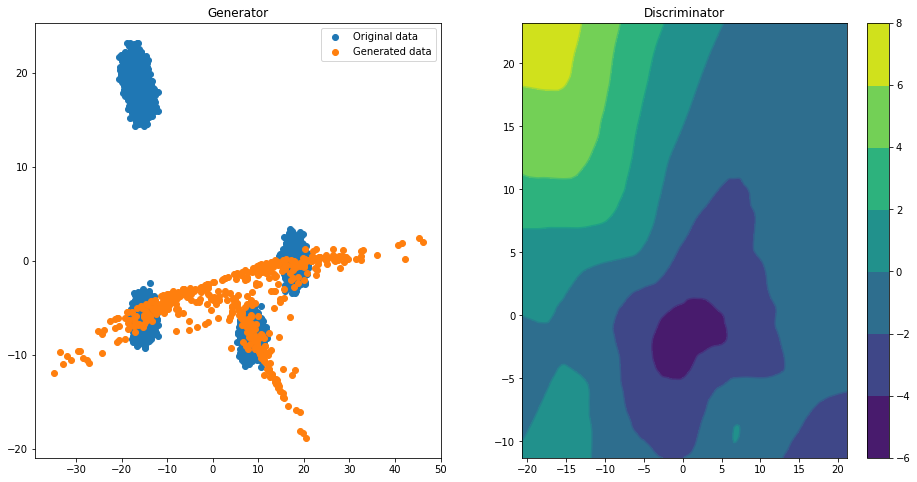

Epoch 020 | ET 5.19 min | Avg Losses >> G/D 1.8683/0.7442


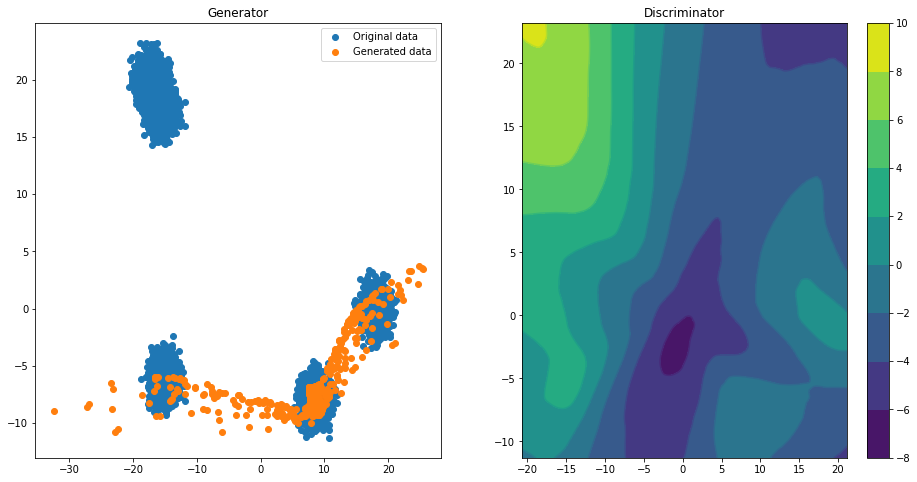

Epoch 025 | ET 7.20 min | Avg Losses >> G/D 1.7582/0.7851
Epoch 030 | ET 8.57 min | Avg Losses >> G/D 1.7205/0.7575
Epoch 035 | ET 9.76 min | Avg Losses >> G/D 1.5843/0.7507


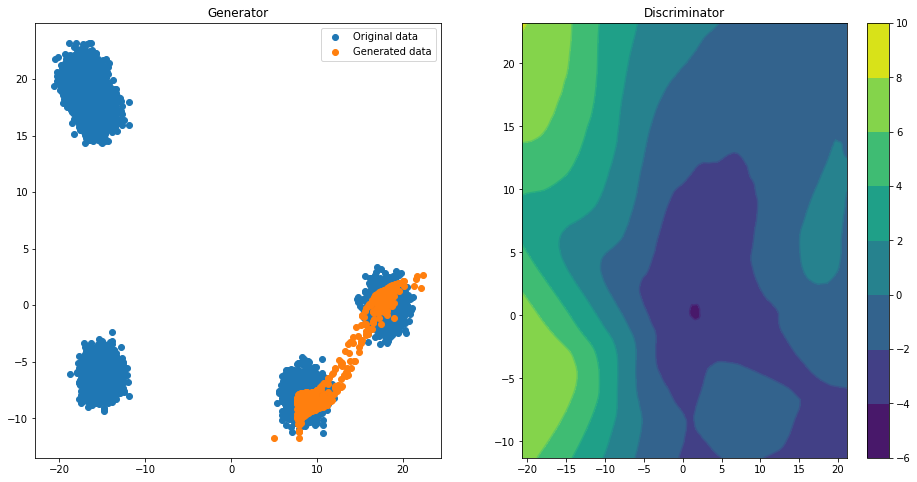

Epoch 040 | ET 11.77 min | Avg Losses >> G/D 1.3896/0.7999
Epoch 045 | ET 12.62 min | Avg Losses >> G/D 1.3217/0.8217


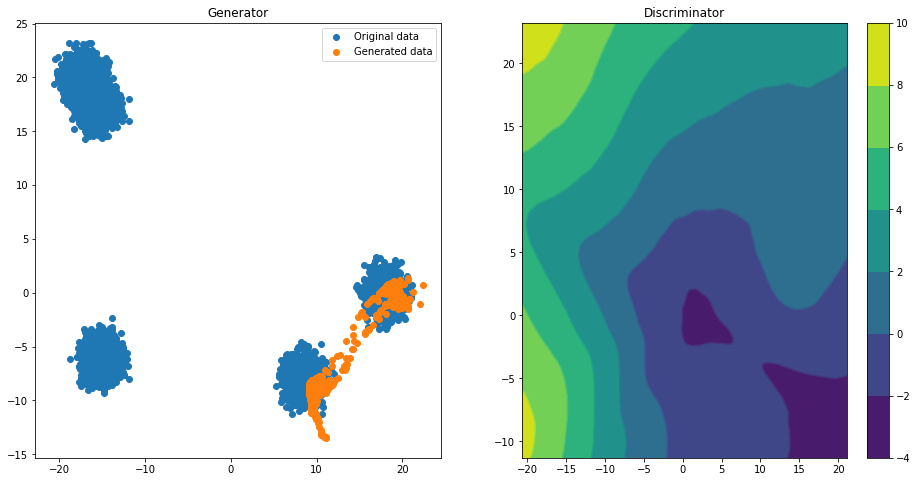

Epoch 050 | ET 14.29 min | Avg Losses >> G/D 1.3947/0.8140
Epoch 055 | ET 15.32 min | Avg Losses >> G/D 1.3383/0.8177


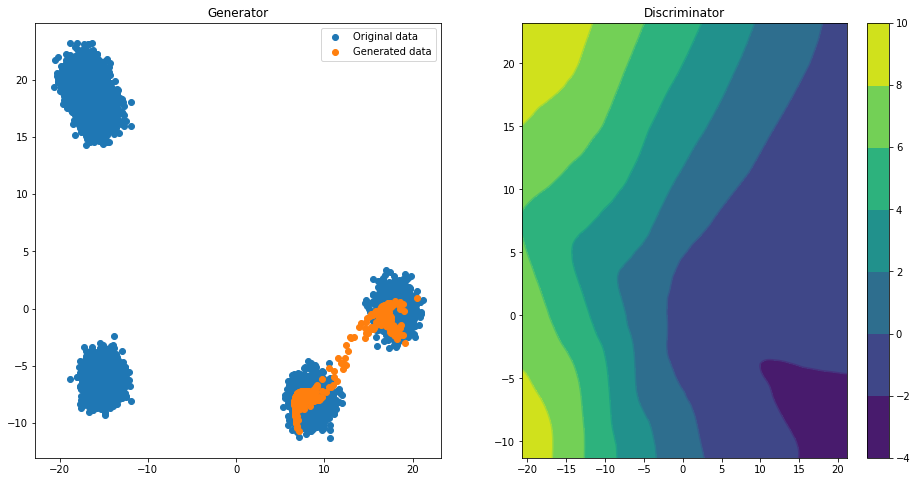

Epoch 060 | ET 16.99 min | Avg Losses >> G/D 1.3072/0.8184
Epoch 065 | ET 17.84 min | Avg Losses >> G/D 1.2674/0.8084
Epoch 070 | ET 18.69 min | Avg Losses >> G/D 1.3579/0.8168


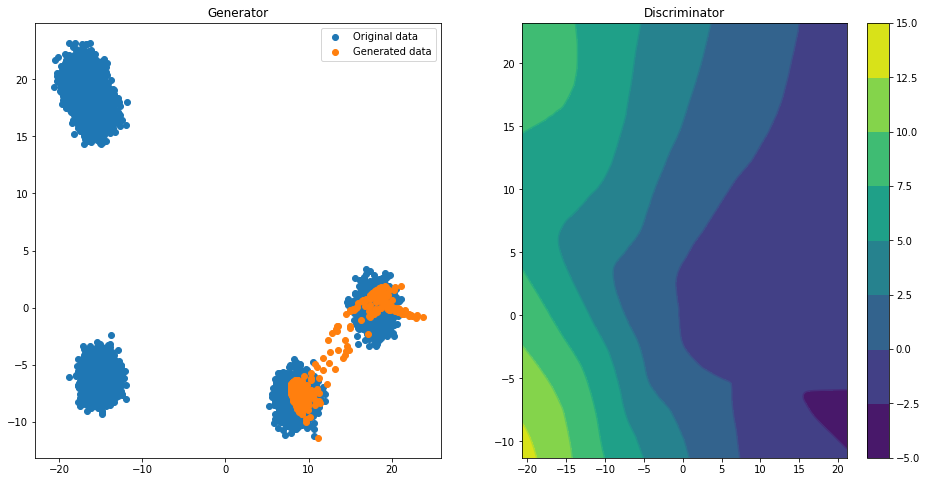

Epoch 075 | ET 20.35 min | Avg Losses >> G/D 1.3329/0.8215


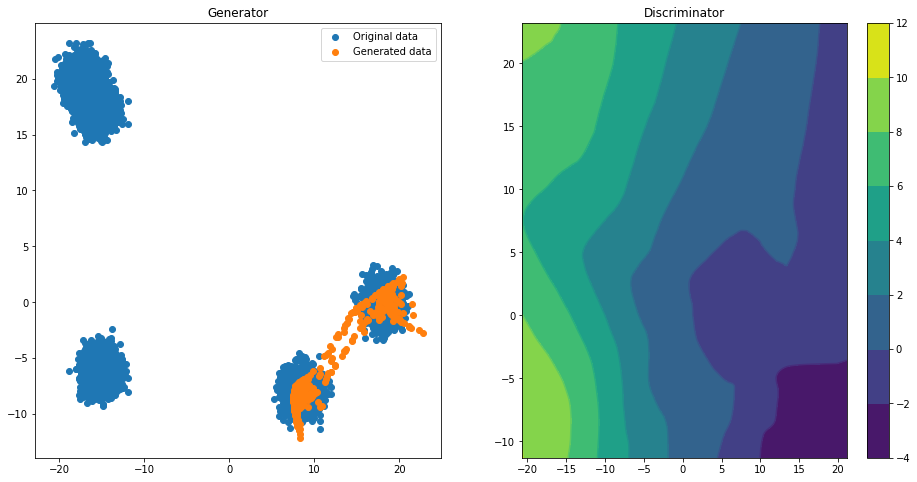

Epoch 080 | ET 22.36 min | Avg Losses >> G/D 1.2573/0.8254
Epoch 085 | ET 23.21 min | Avg Losses >> G/D 1.3541/0.8205
Epoch 090 | ET 24.06 min | Avg Losses >> G/D 1.3292/0.8136
Epoch 095 | ET 24.90 min | Avg Losses >> G/D 1.2873/0.8293


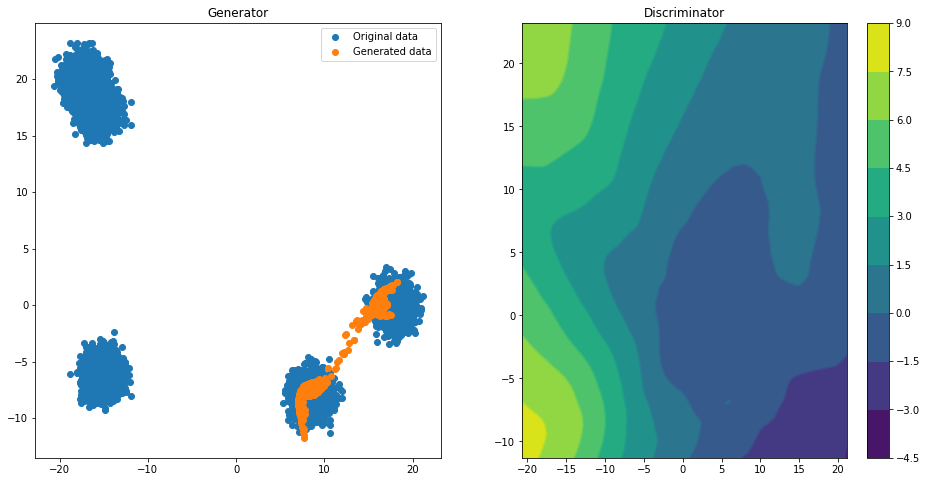

Epoch 100 | ET 26.57 min | Avg Losses >> G/D 1.3175/0.8311


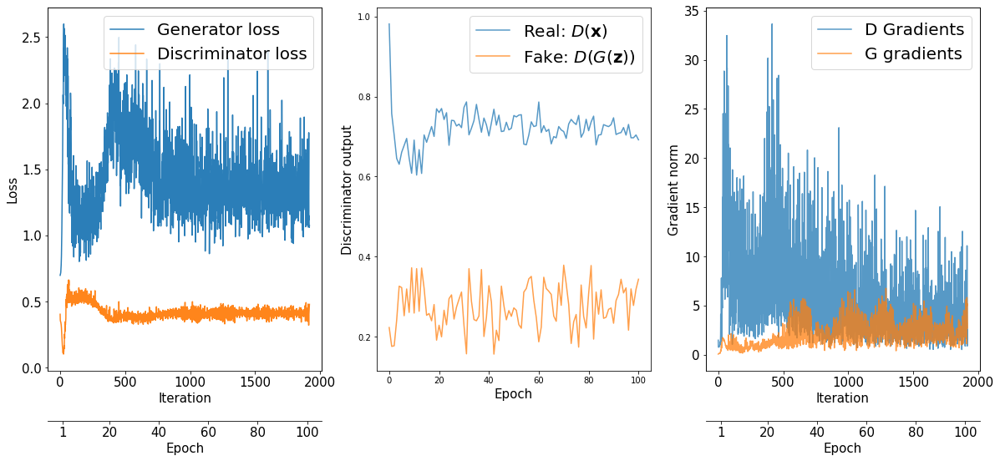

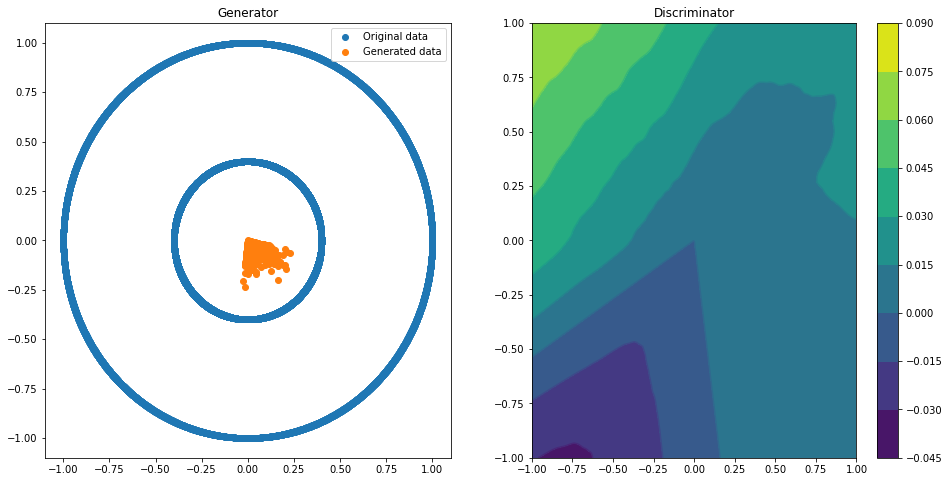

Epoch 000 | ET 0.99 min | Avg Losses >> G/D 0.7142/1.3511
Epoch 005 | ET 1.84 min | Avg Losses >> G/D 0.6974/1.3799
Epoch 010 | ET 2.68 min | Avg Losses >> G/D 0.7128/1.3660
Epoch 015 | ET 3.53 min | Avg Losses >> G/D 0.7144/1.3664


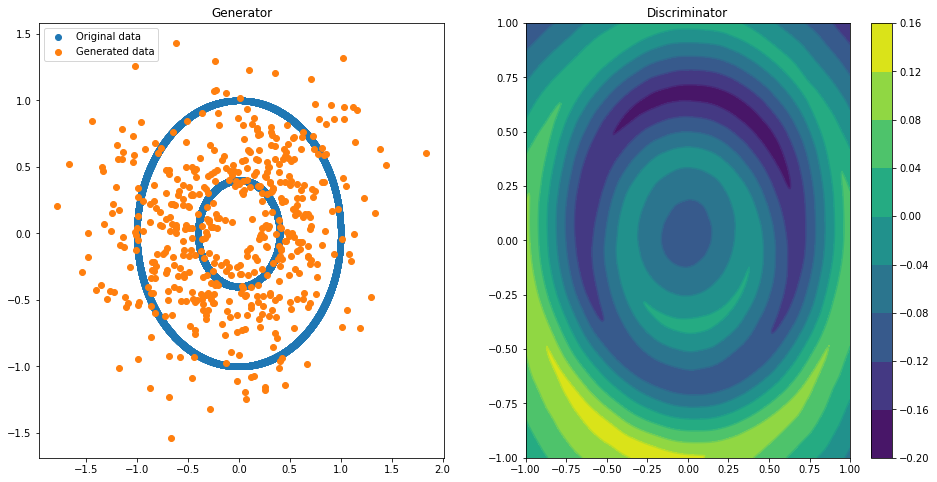

Epoch 020 | ET 5.20 min | Avg Losses >> G/D 0.7140/1.3665


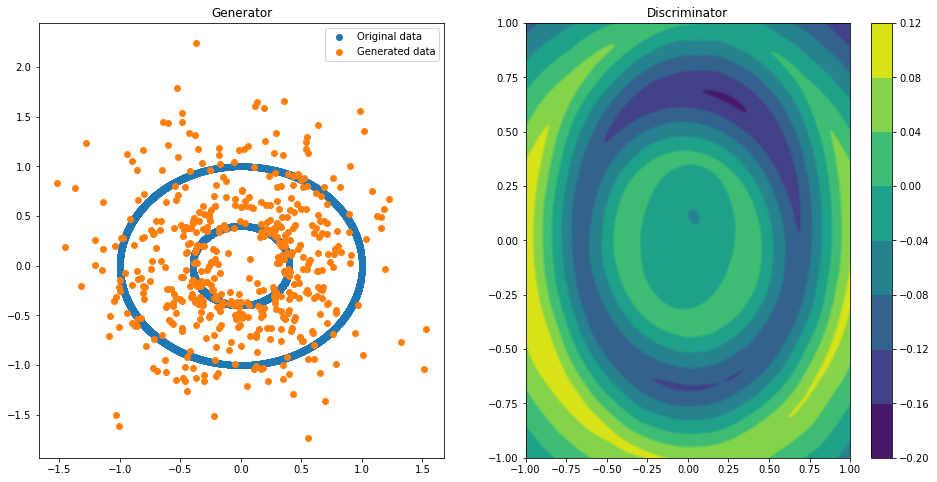

Epoch 025 | ET 7.05 min | Avg Losses >> G/D 0.7134/1.3668
Epoch 030 | ET 7.90 min | Avg Losses >> G/D 0.7126/1.3687
Epoch 035 | ET 8.75 min | Avg Losses >> G/D 0.7088/1.3713


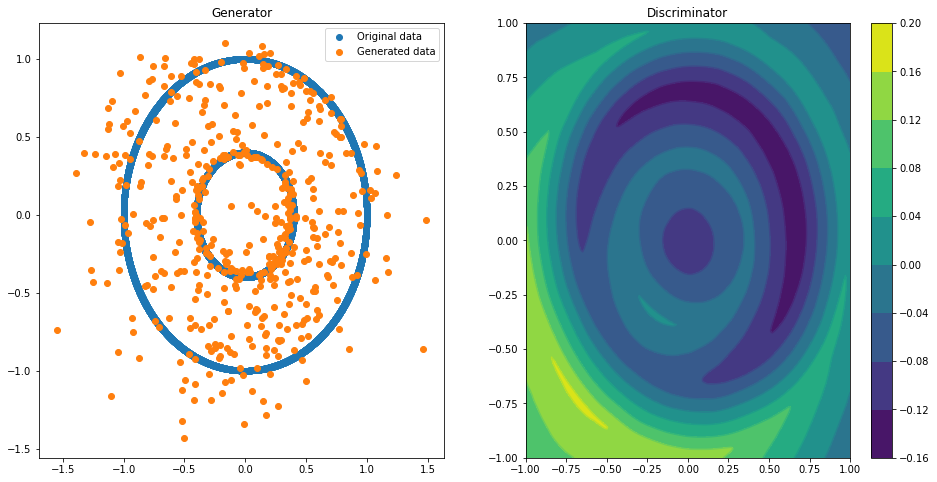

Epoch 040 | ET 10.77 min | Avg Losses >> G/D 0.7060/1.3758
Epoch 045 | ET 11.97 min | Avg Losses >> G/D 0.7019/1.3780


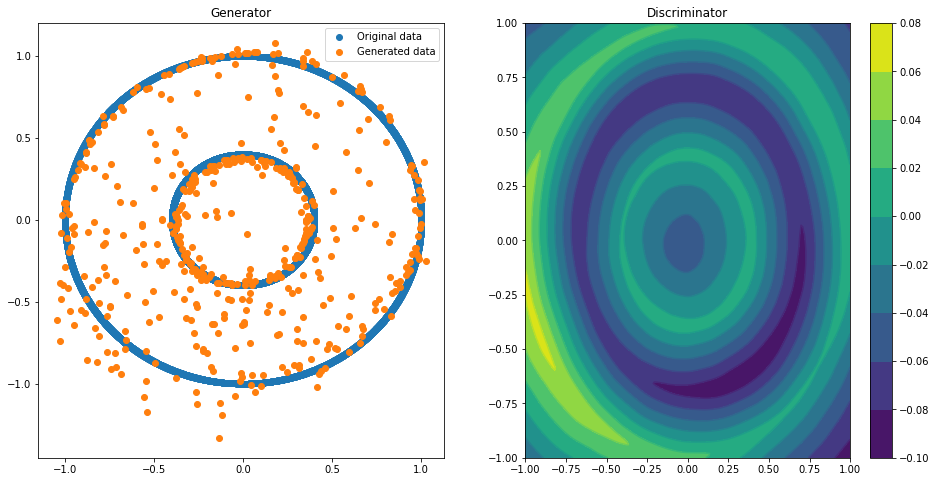

Epoch 050 | ET 13.82 min | Avg Losses >> G/D 0.6991/1.3808
Epoch 055 | ET 14.67 min | Avg Losses >> G/D 0.6995/1.3812


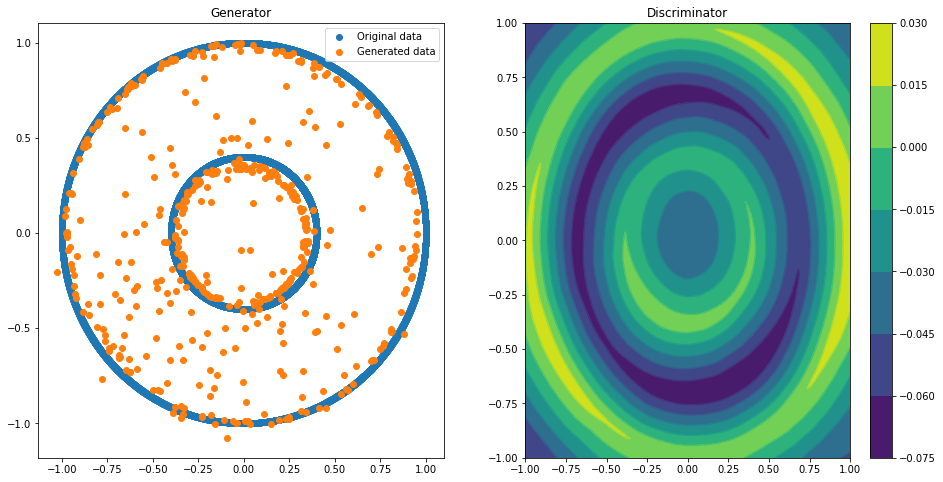

Epoch 060 | ET 16.34 min | Avg Losses >> G/D 0.6986/1.3817
Epoch 065 | ET 17.36 min | Avg Losses >> G/D 0.6973/1.3828
Epoch 070 | ET 18.56 min | Avg Losses >> G/D 0.6975/1.3826


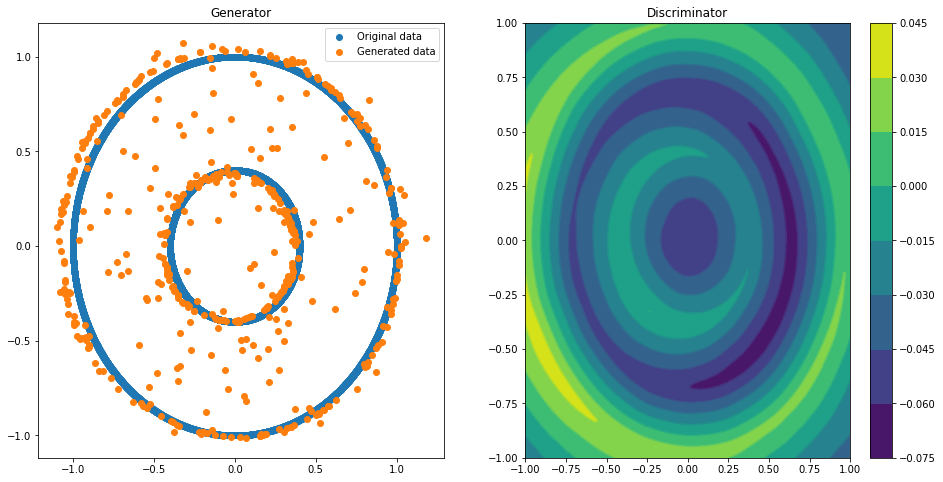

Epoch 075 | ET 20.58 min | Avg Losses >> G/D 0.6970/1.3833


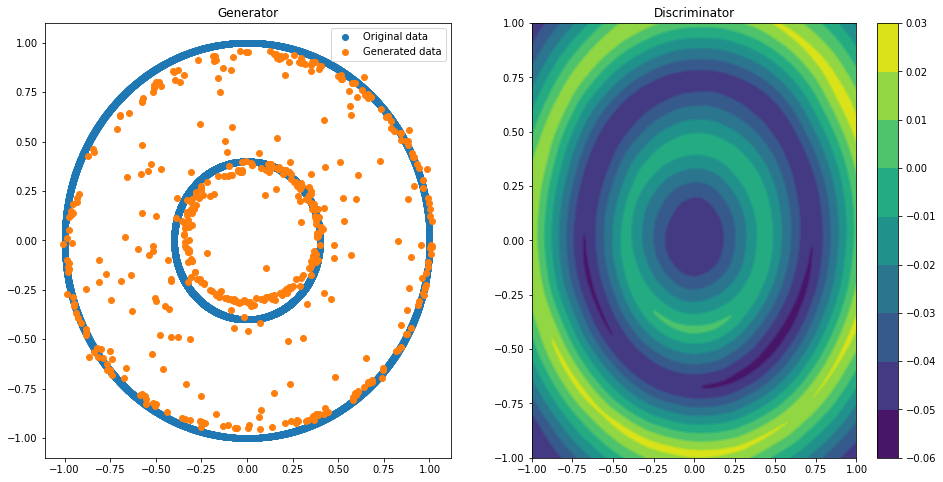

Epoch 080 | ET 22.26 min | Avg Losses >> G/D 0.6964/1.3834
Epoch 085 | ET 23.11 min | Avg Losses >> G/D 0.6966/1.3835
Epoch 090 | ET 24.48 min | Avg Losses >> G/D 0.6968/1.3836
Epoch 095 | ET 25.50 min | Avg Losses >> G/D 0.6962/1.3836


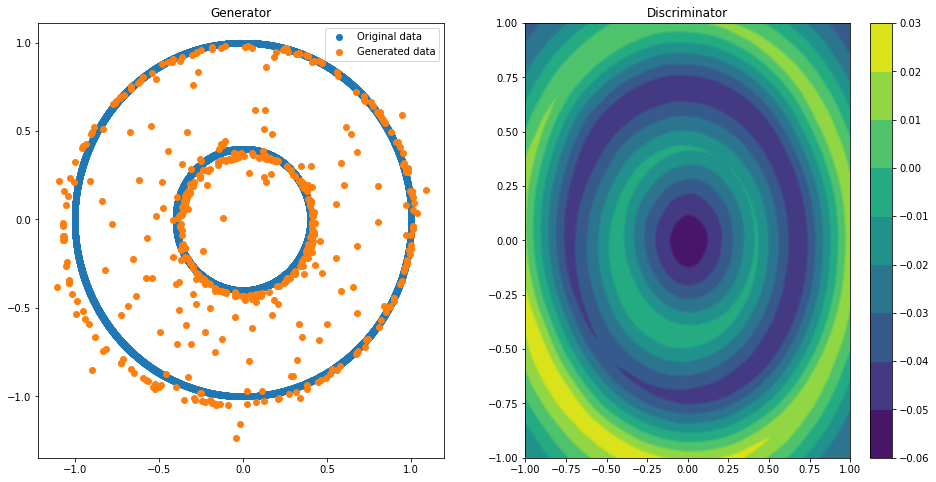

Epoch 100 | ET 27.34 min | Avg Losses >> G/D 0.6959/1.3842


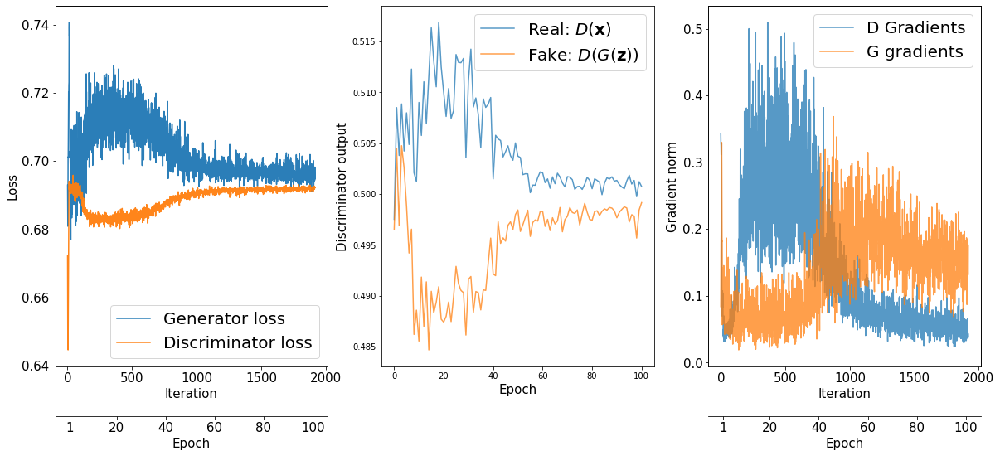

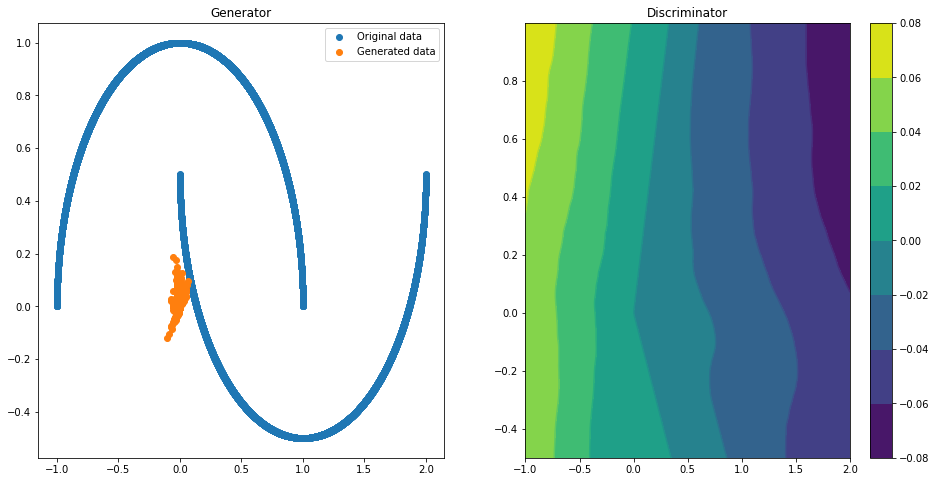

Epoch 000 | ET 1.17 min | Avg Losses >> G/D 0.7158/1.2984
Epoch 005 | ET 2.37 min | Avg Losses >> G/D 0.7217/1.3589
Epoch 010 | ET 3.39 min | Avg Losses >> G/D 0.7036/1.3761
Epoch 015 | ET 4.24 min | Avg Losses >> G/D 0.7039/1.3778


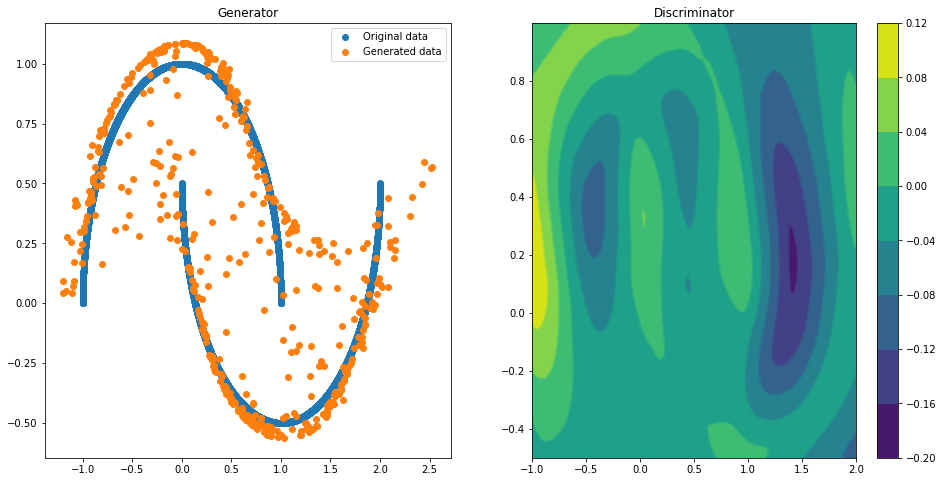

Epoch 020 | ET 6.07 min | Avg Losses >> G/D 0.7005/1.3799


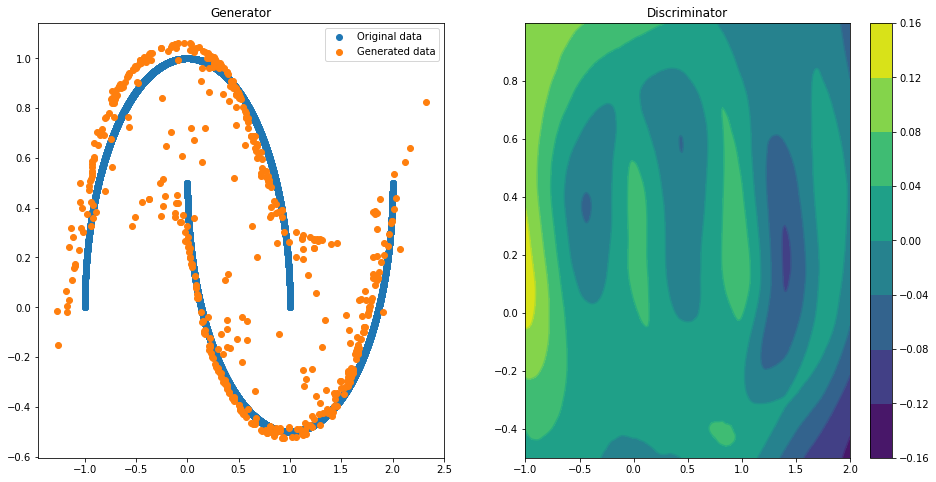

Epoch 025 | ET 7.74 min | Avg Losses >> G/D 0.7008/1.3812
Epoch 030 | ET 8.60 min | Avg Losses >> G/D 0.6981/1.3813
Epoch 035 | ET 9.96 min | Avg Losses >> G/D 0.6991/1.3820


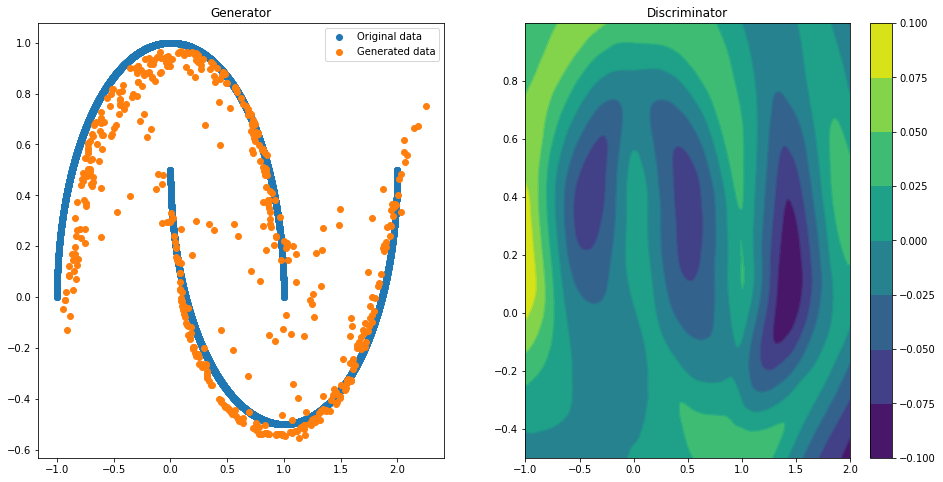

Epoch 040 | ET 11.81 min | Avg Losses >> G/D 0.6999/1.3816
Epoch 045 | ET 12.83 min | Avg Losses >> G/D 0.7004/1.3815


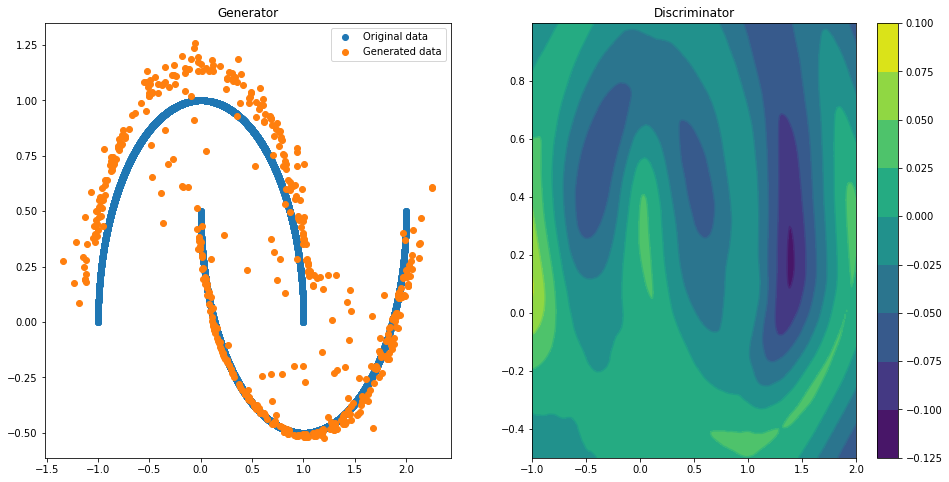

Epoch 050 | ET 14.50 min | Avg Losses >> G/D 0.6992/1.3815
Epoch 055 | ET 15.69 min | Avg Losses >> G/D 0.6973/1.3821


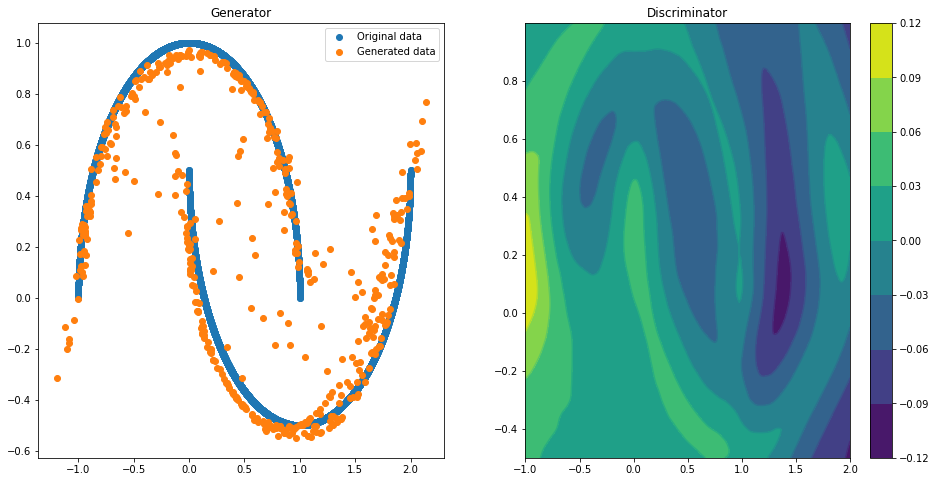

Epoch 060 | ET 17.71 min | Avg Losses >> G/D 0.6974/1.3825
Epoch 065 | ET 18.73 min | Avg Losses >> G/D 0.6980/1.3828
Epoch 070 | ET 19.58 min | Avg Losses >> G/D 0.6967/1.3837


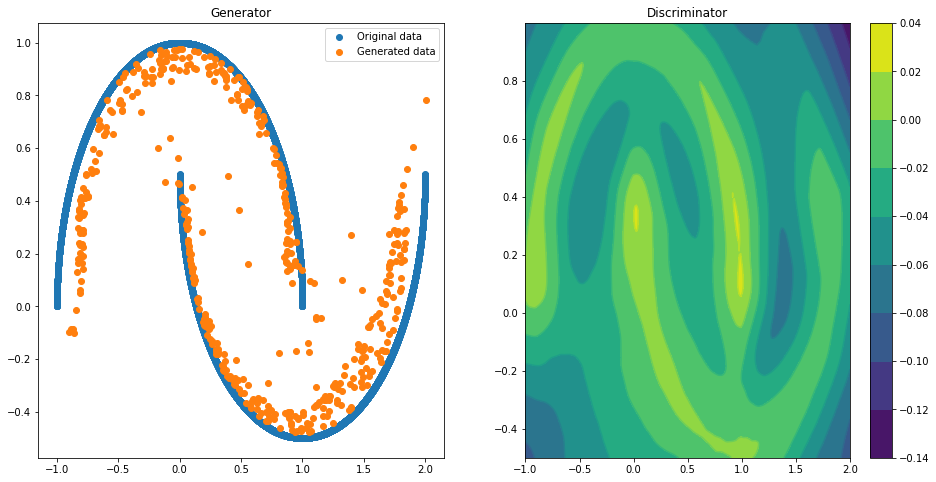

Epoch 075 | ET 21.60 min | Avg Losses >> G/D 0.6986/1.3819


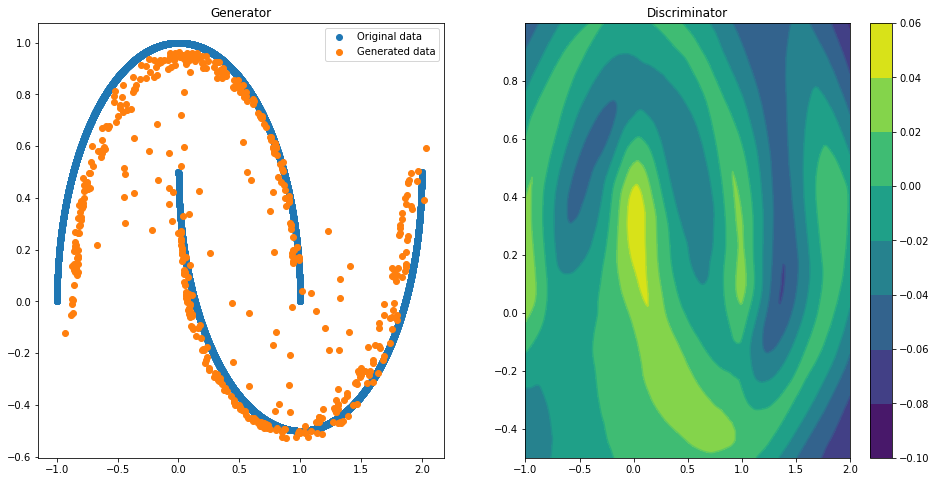

Epoch 080 | ET 23.44 min | Avg Losses >> G/D 0.6986/1.3822
Epoch 085 | ET 24.46 min | Avg Losses >> G/D 0.6965/1.3832
Epoch 090 | ET 25.32 min | Avg Losses >> G/D 0.6974/1.3834
Epoch 095 | ET 26.17 min | Avg Losses >> G/D 0.6979/1.3834


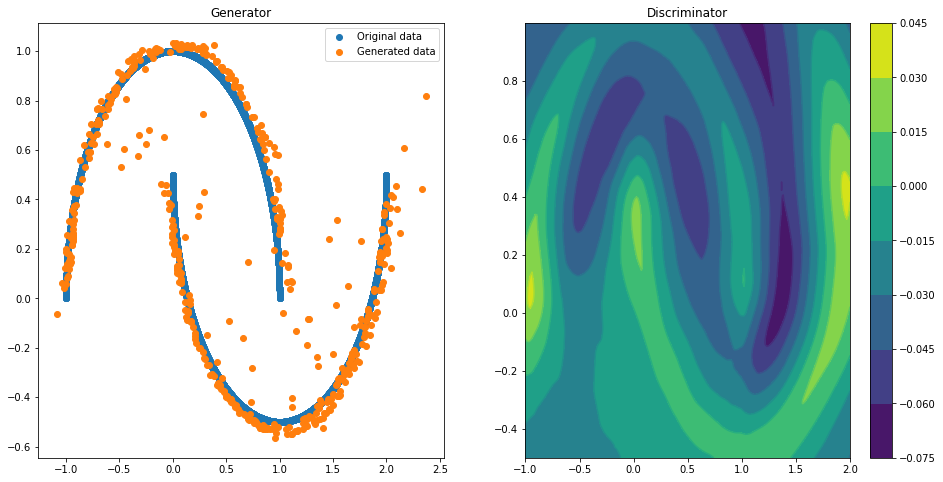

Epoch 100 | ET 28.18 min | Avg Losses >> G/D 0.6976/1.3829


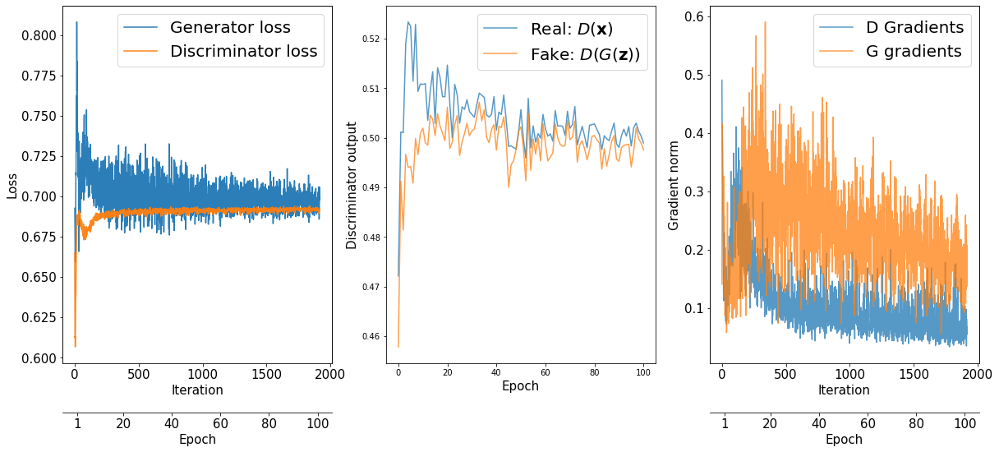

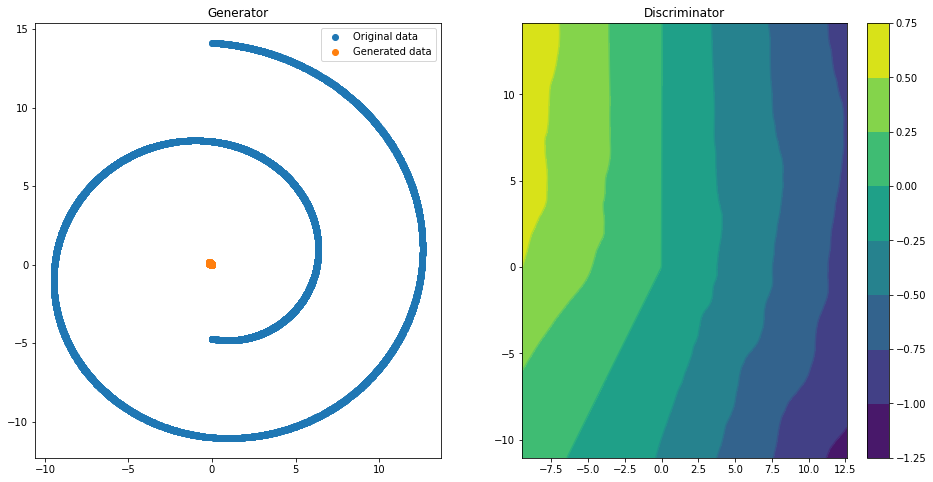

Epoch 000 | ET 0.98 min | Avg Losses >> G/D 0.8994/0.6663
Epoch 005 | ET 2.00 min | Avg Losses >> G/D 0.6887/1.3988
Epoch 010 | ET 3.02 min | Avg Losses >> G/D 0.7068/1.3887
Epoch 015 | ET 3.88 min | Avg Losses >> G/D 0.7640/1.3354


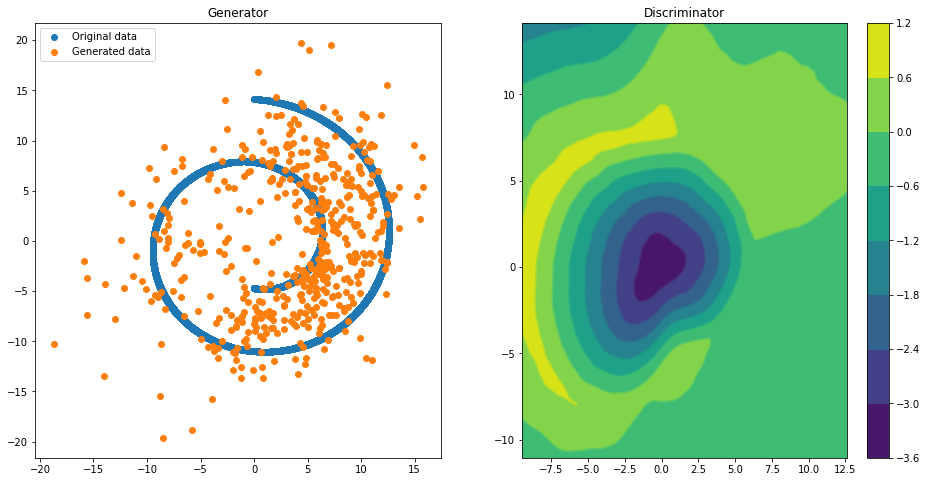

Epoch 020 | ET 5.54 min | Avg Losses >> G/D 0.8608/1.2613


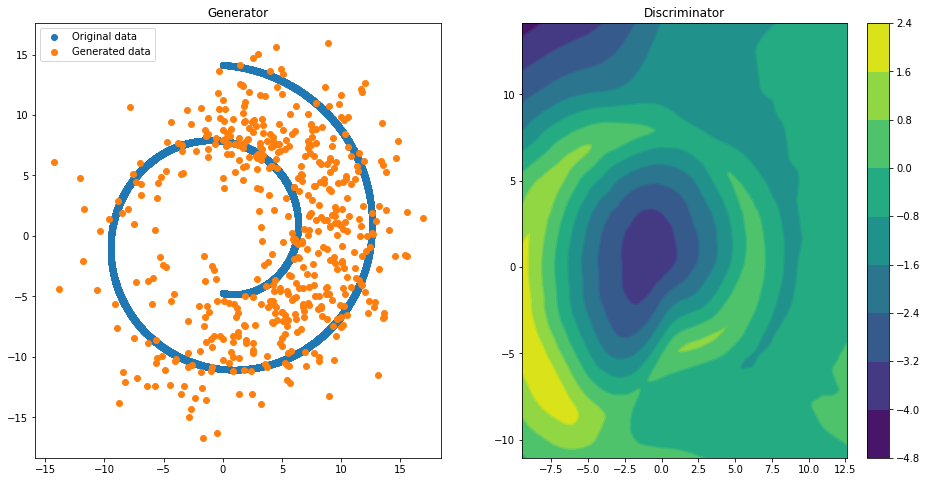

Epoch 025 | ET 7.21 min | Avg Losses >> G/D 0.9816/1.1051
Epoch 030 | ET 8.05 min | Avg Losses >> G/D 1.2014/1.0329
Epoch 035 | ET 8.90 min | Avg Losses >> G/D 1.3197/1.0288


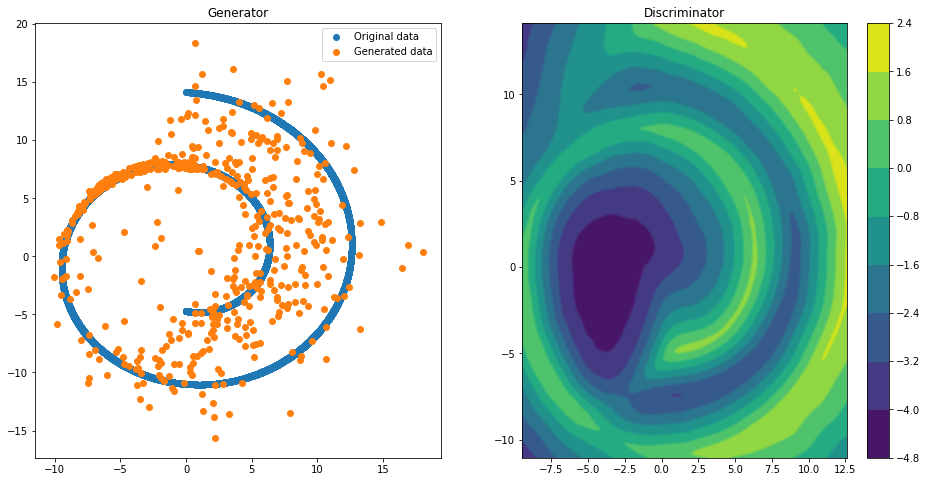

Epoch 040 | ET 10.57 min | Avg Losses >> G/D 1.2760/1.0486
Epoch 045 | ET 11.41 min | Avg Losses >> G/D 1.3067/1.0588


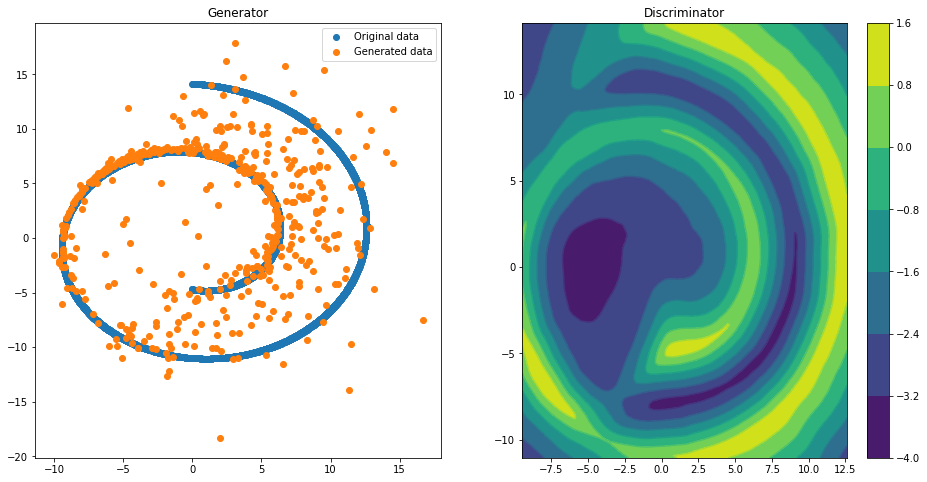

Epoch 050 | ET 13.08 min | Avg Losses >> G/D 1.2203/1.0810
Epoch 055 | ET 14.10 min | Avg Losses >> G/D 1.1899/1.1084


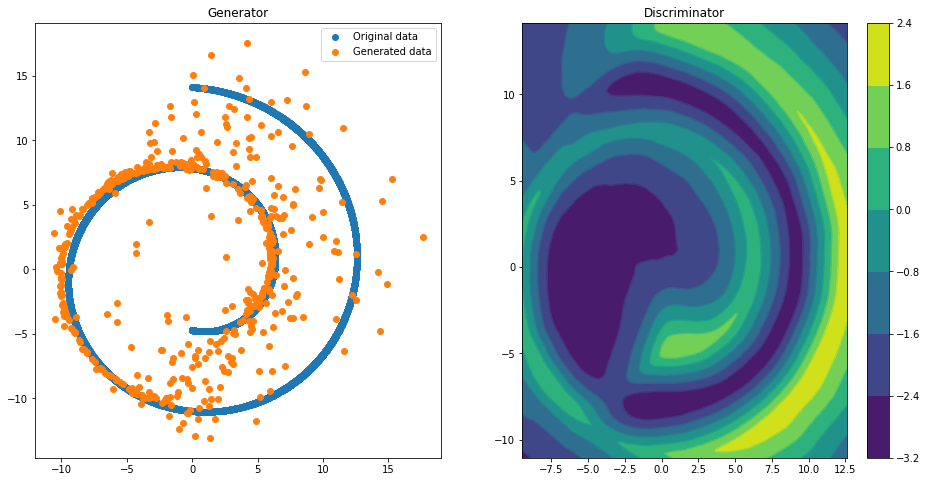

Epoch 060 | ET 15.77 min | Avg Losses >> G/D 1.1514/1.1106
Epoch 065 | ET 16.62 min | Avg Losses >> G/D 1.1249/1.1186
Epoch 070 | ET 17.47 min | Avg Losses >> G/D 1.1234/1.1259


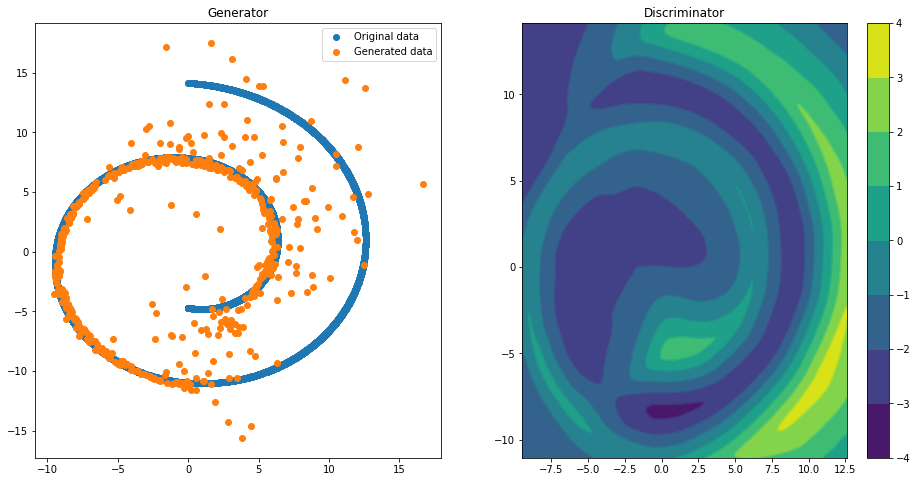

Epoch 075 | ET 19.14 min | Avg Losses >> G/D 1.1138/1.1221


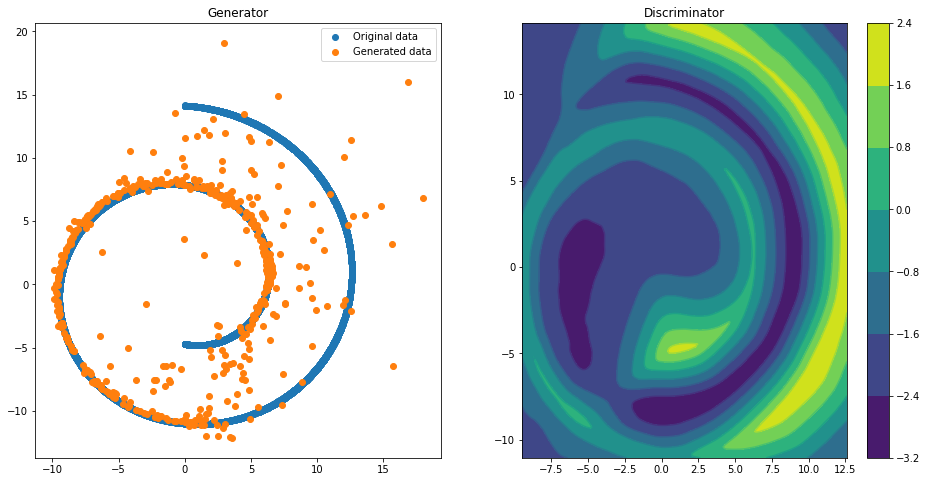

Epoch 080 | ET 20.80 min | Avg Losses >> G/D 1.0415/1.1331
Epoch 085 | ET 21.64 min | Avg Losses >> G/D 1.0509/1.1177
Epoch 090 | ET 22.49 min | Avg Losses >> G/D 1.0626/1.1173
Epoch 095 | ET 23.34 min | Avg Losses >> G/D 1.0573/1.1344


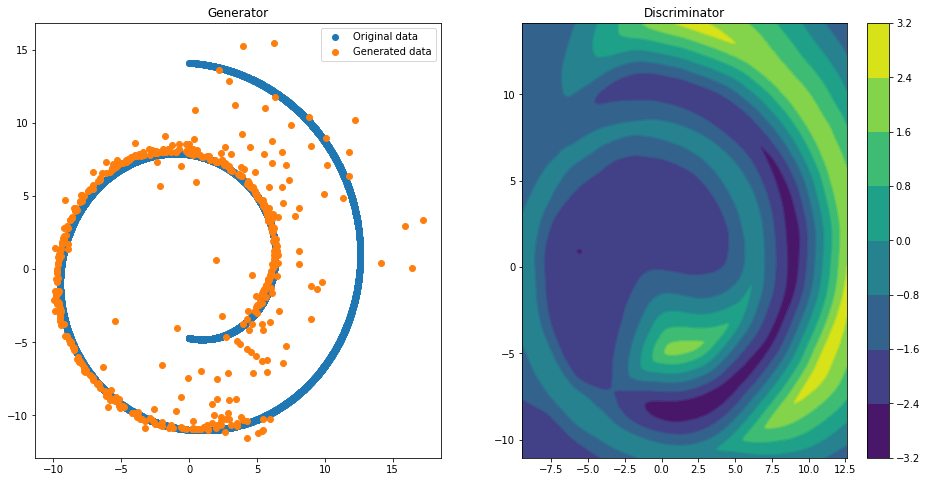

Epoch 100 | ET 25.00 min | Avg Losses >> G/D 1.0362/1.1296


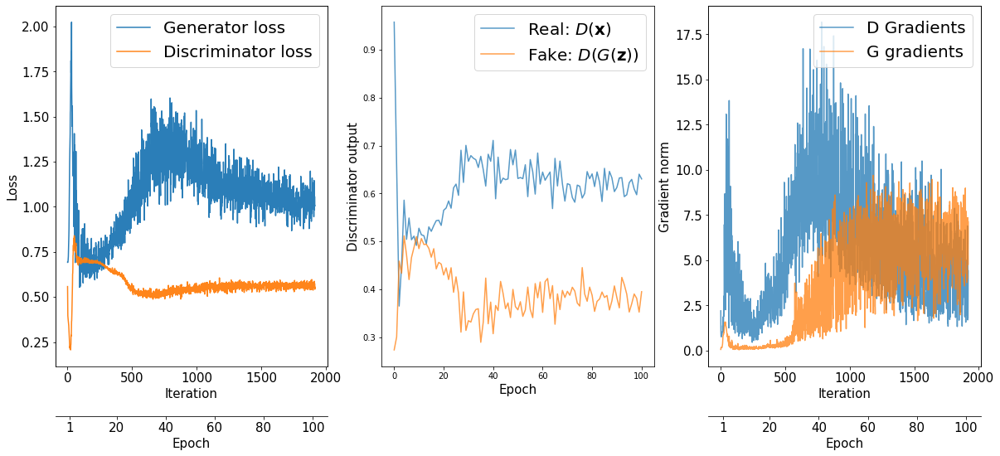

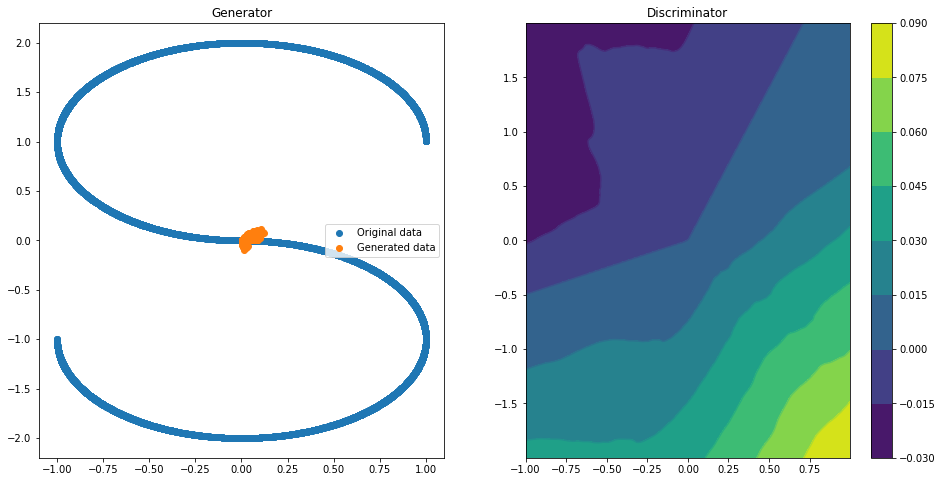

Epoch 000 | ET 1.17 min | Avg Losses >> G/D 0.7030/1.2590
Epoch 005 | ET 2.19 min | Avg Losses >> G/D 0.7728/1.3040
Epoch 010 | ET 3.21 min | Avg Losses >> G/D 0.7521/1.3362
Epoch 015 | ET 4.07 min | Avg Losses >> G/D 0.7274/1.3569


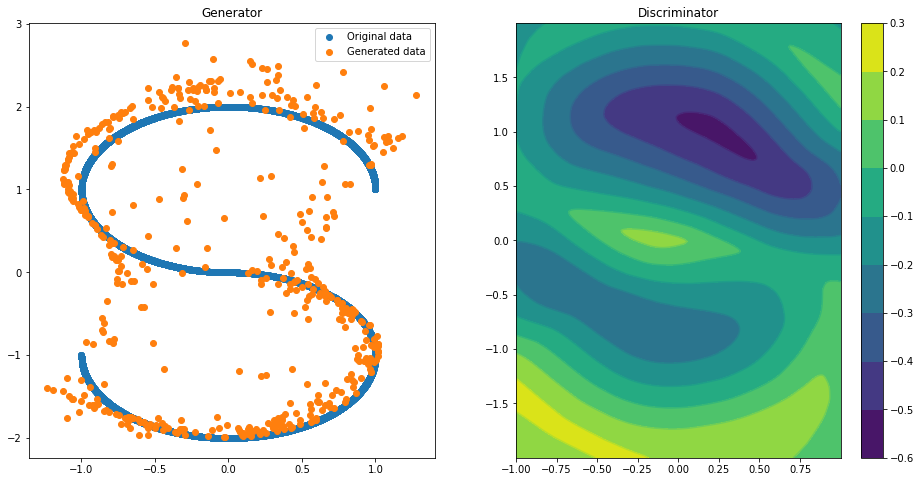

Epoch 020 | ET 6.09 min | Avg Losses >> G/D 0.7169/1.3675


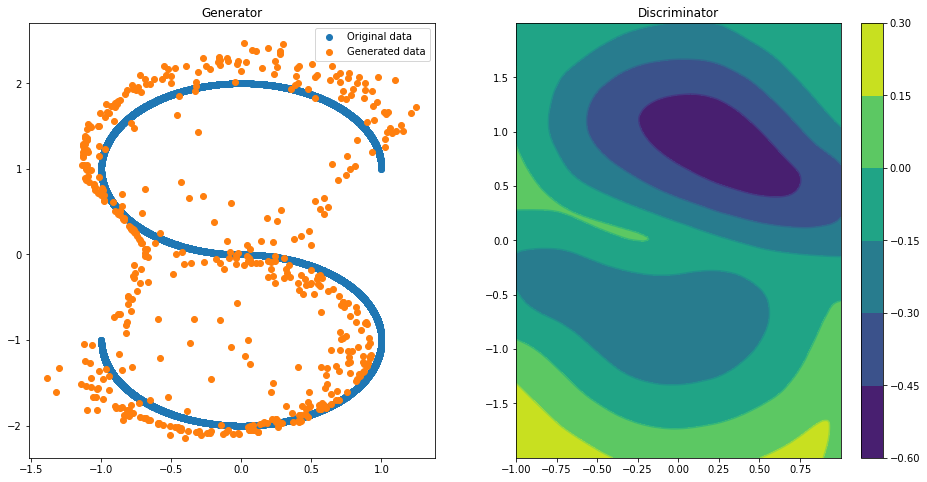

Epoch 025 | ET 8.29 min | Avg Losses >> G/D 0.7107/1.3729
Epoch 030 | ET 9.15 min | Avg Losses >> G/D 0.7094/1.3751
Epoch 035 | ET 10.17 min | Avg Losses >> G/D 0.7122/1.3737


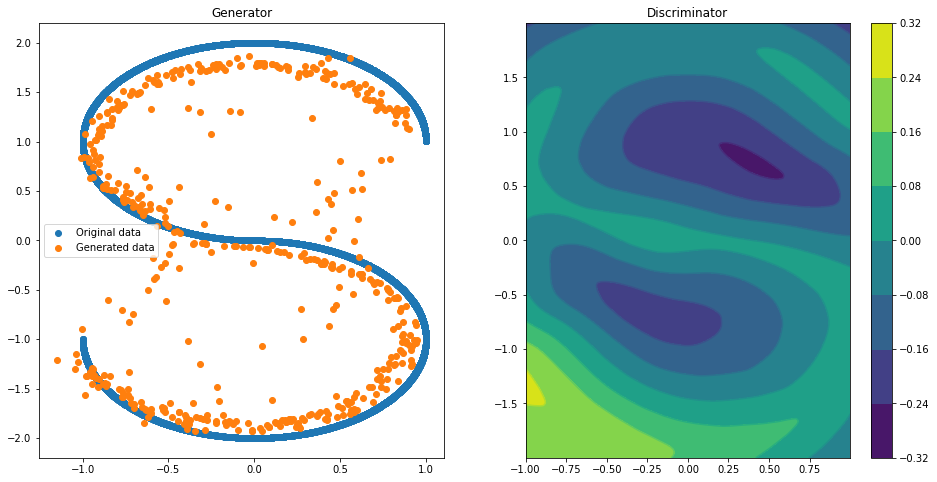

Epoch 040 | ET 12.02 min | Avg Losses >> G/D 0.7088/1.3742
Epoch 045 | ET 12.88 min | Avg Losses >> G/D 0.7052/1.3768


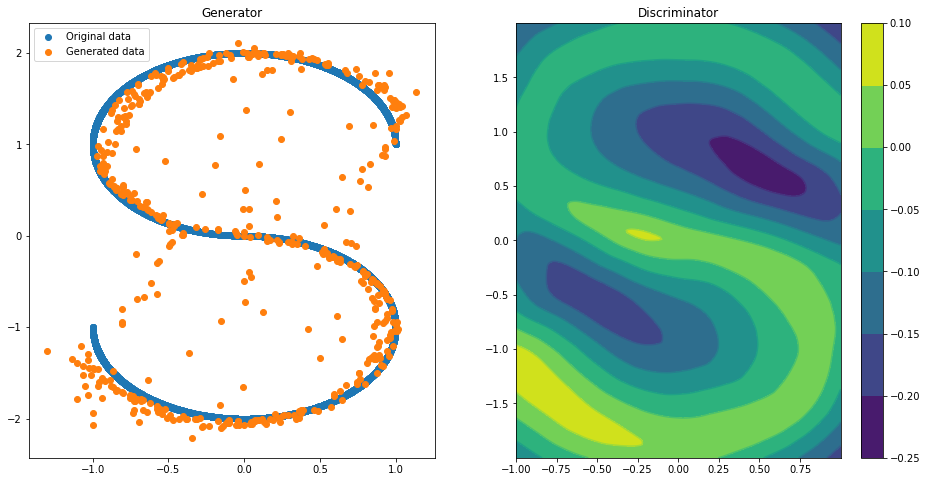

Epoch 050 | ET 14.56 min | Avg Losses >> G/D 0.7045/1.3750
Epoch 055 | ET 15.41 min | Avg Losses >> G/D 0.7057/1.3772


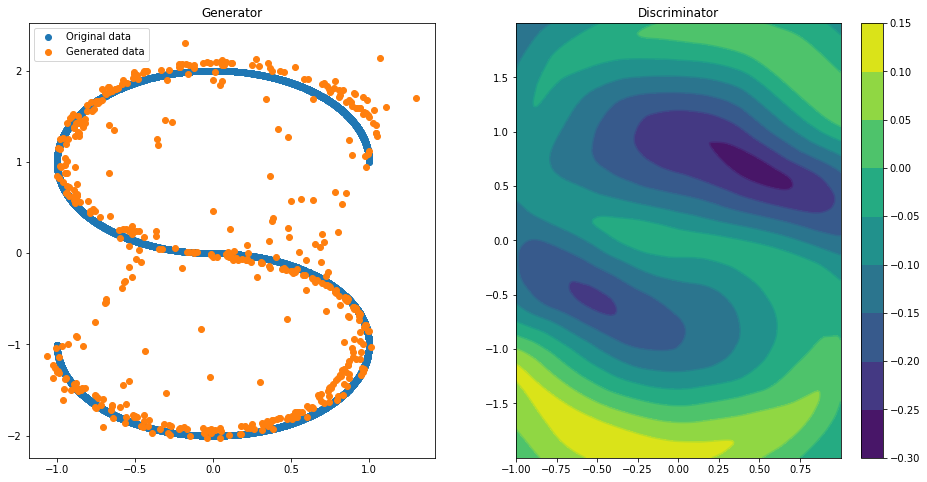

Epoch 060 | ET 17.60 min | Avg Losses >> G/D 0.7026/1.3785
Epoch 065 | ET 18.62 min | Avg Losses >> G/D 0.7035/1.3788
Epoch 070 | ET 19.64 min | Avg Losses >> G/D 0.7036/1.3779


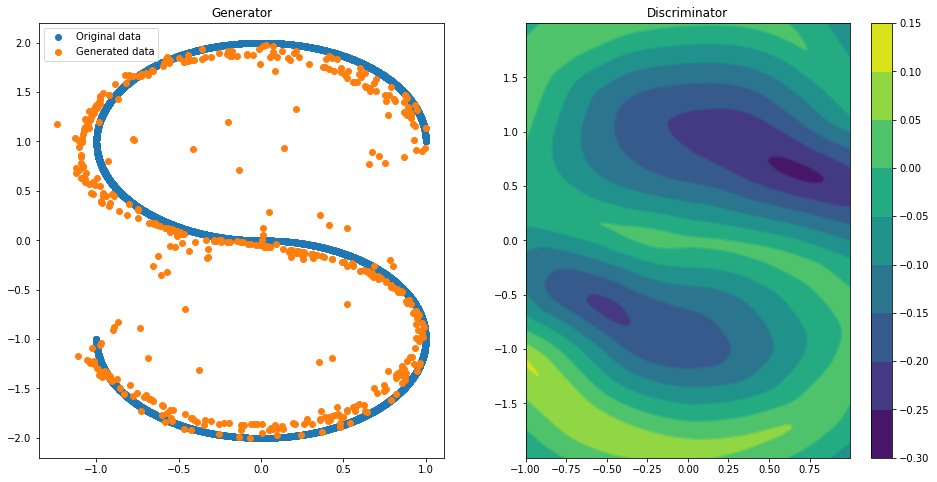

Epoch 075 | ET 21.66 min | Avg Losses >> G/D 0.7021/1.3800


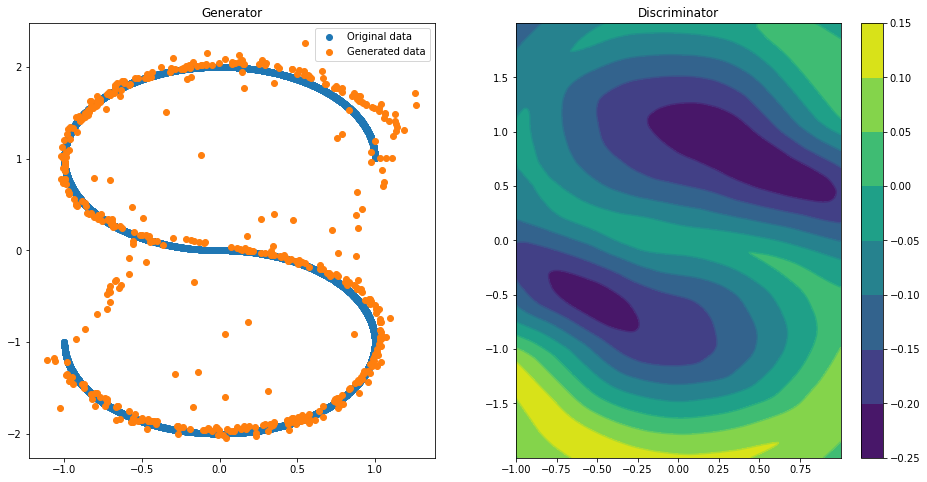

Epoch 080 | ET 23.50 min | Avg Losses >> G/D 0.7018/1.3800
Epoch 085 | ET 24.52 min | Avg Losses >> G/D 0.7020/1.3797
Epoch 090 | ET 25.37 min | Avg Losses >> G/D 0.7010/1.3802
Epoch 095 | ET 26.23 min | Avg Losses >> G/D 0.6996/1.3810


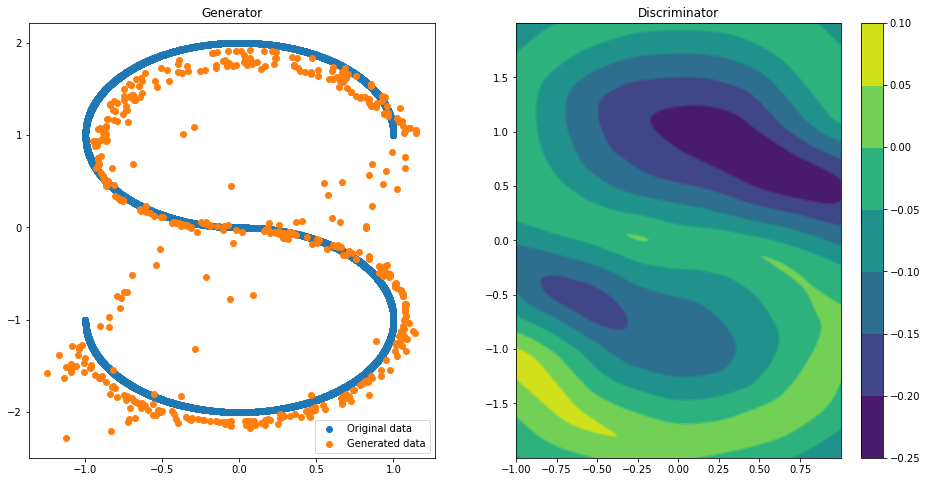

Epoch 100 | ET 27.90 min | Avg Losses >> G/D 0.6991/1.3811


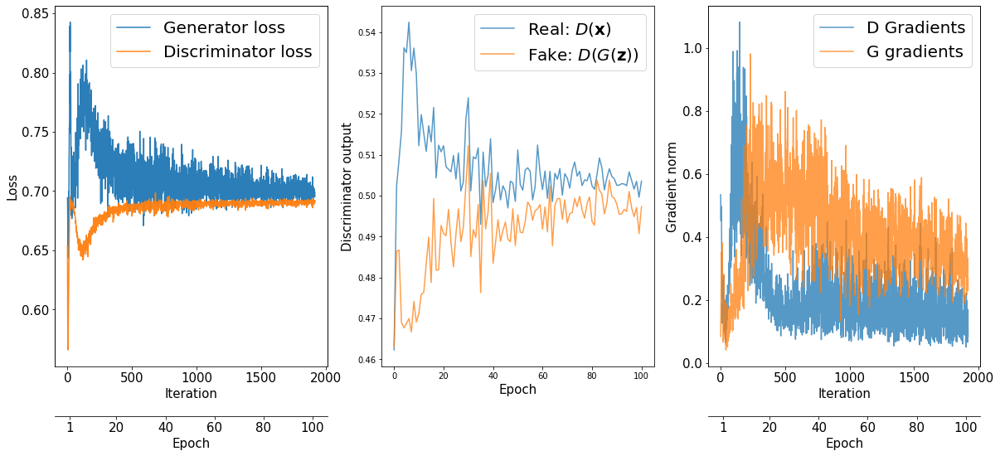

In [ ]:
z_size = 2
num_epochs = 100
batch_size = 512
gp_weight = .10
device_name = tf.test.gpu_device_name()
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
for current_data in [quadratic, circle, mixture, blobs, circles, moons, swiss_roll, s_curve]:
  numpy_data = current_data
  data = tf.data.Dataset.from_tensor_slices(numpy_data).batch(batch_size, drop_remainder=True)
  fixed_z = tf.random.normal(shape=[500, z_size])

  generator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  discriminator_optimizer = tf.keras.optimizers.Adam(
      learning_rate=0.0002, beta_1=0.5, beta_2=0.9
  )
  with tf.device(device_name):
    gen_model = make_generator_network()
    gen_model.build(input_shape=(None,z_size))
    disc_model = make_discriminator_network()
    disc_model.build(input_shape=(None,2))
    
  all_losses = []
  all_d_vals = []
  d_gradients = []
  g_gradients = []
  epoch_samples = []
  start_time = time.time()
  for epoch in range(0, num_epochs+1):
    epoch_losses, epoch_d_vals = [], []
    #Plotting every 50
    if (epoch%20 == 0) or (epoch%25==0):
        input_z = tf.random.normal(shape = (500,z_size))
        epoch_samples.append(gen_model(input_z, training=False).numpy())
        X_data, Y_data = numpy_data[:,0], numpy_data[:,1]
        x = np.linspace(np.min(X_data), np.max(X_data), 200)
        y = np.linspace(np.min(Y_data), np.max(Y_data), 200)
        X, Y = np.meshgrid(x, y)
        Z = np.zeros((len(x), len(y)))
        for i in range(len(x)):
          for j in range(len(y)):
            q = tf.convert_to_tensor(np.array([[x[j],y[i]]]).astype("float32"))
            Z[i][j] = disc_model(q).numpy()[0][0]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,8))
        ax1.scatter(X_data,Y_data, label = "Original data")
        ax1.scatter(epoch_samples[-1][:,0],epoch_samples[-1][:,1], label="Generated data")
        ax1.set_title("Generator")
        ax1.legend()
        ax2.contour(X,Y,Z)
        ax2.set_title("Discriminator")
        cp = ax2.contourf(X , Y , Z)
        plt.colorbar(cp, ax=ax2)
        plt.show()
    for batch in data:
      for i in range(3):
        random_latent_vectors = tf.random.normal(shape=[batch_size,z_size])
        with tf.GradientTape() as tape:
          g_output = gen_model(random_latent_vectors)
          d_logits_real = disc_model(batch,
                                 training=True)
          d_labels_real = tf.ones_like(d_logits_real)
          d_loss_real = loss_fn(y_true=d_labels_real,
                            y_pred=d_logits_real)
          d_logits_fake = disc_model(g_output,
                                training=True)
          d_labels_fake = tf.zeros_like(d_logits_fake)
          d_loss_fake = loss_fn(y_true=d_labels_fake,
                            y_pred=d_logits_fake)
          gp = gradient_penalty(batch_size, batch, g_output, disc_model)
          d_loss = d_loss_real + d_loss_fake + gp_weight * gp
        
        d_grads = tape.gradient(d_loss,
                              disc_model.trainable_variables)
        discriminator_optimizer.apply_gradients(grads_and_vars=zip(d_grads,
                                                  disc_model.trainable_variables))

      random_latent_vectors = tf.random.normal(shape=(batch_size, z_size))
      
      with tf.GradientTape() as tape:
        g_output = gen_model(random_latent_vectors)
        d_logits_fake = disc_model(g_output,
                                 training=True)
        labels_real = tf.ones_like(d_logits_fake)
        g_loss = loss_fn(y_true=labels_real,
                       y_pred=d_logits_fake)
        #Compute the gradients of g_loss
      g_grads = tape.gradient(g_loss,
                              gen_model.trainable_variables)
      #Apply the gradients
      generator_optimizer.apply_gradients(
          grads_and_vars=zip(g_grads,
                             gen_model.trainable_variables)
      )

      epoch_losses.append(
                            (g_loss.numpy(), d_loss.numpy())
                            )
      d_probs_real = tf.reduce_mean(
                            tf.sigmoid(d_logits_real))
      d_probs_fake = tf.reduce_mean(
                            tf.sigmoid(d_logits_fake))
      g_gradients.append(tf.linalg.global_norm(g_grads).numpy())
      d_gradients.append(tf.linalg.global_norm(d_grads).numpy())
    epoch_d_vals.append((d_probs_real.numpy(),
                            d_probs_fake.numpy()))
    
    all_losses.append(epoch_losses)
    all_d_vals.append(epoch_d_vals)
      
    if epoch%5 == 0:
        print(
              'Epoch {:03d} | ET {:.2f} min | Avg Losses >>'
              ' G/D {:.4f}/{:.4f}'
              .format(
              epoch, (time.time() - start_time)/60,
              *list(np.mean(all_losses[-1], axis=0))))
  fig = plt.figure(figsize=(20, 8))

  ## Plotting the losses
  import itertools
  ax = fig.add_subplot(1, 3, 1)
  g_losses = [item[0] for item in itertools.chain(*all_losses)]
  d_losses = [item[1]/2.0 for item in itertools.chain(*all_losses)]
  plt.plot(g_losses, label='Generator loss', alpha=0.95)
  plt.plot(d_losses, label='Discriminator loss', alpha=0.95)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Loss', size=15)

  epochs = np.arange(1, 101)
  epoch2iter = lambda e: e*len(all_losses[-1])
  epoch_ticks = [1, 20, 40, 60, 80, 100, 120, 140, 160, 180, 200]
  newpos = [epoch2iter(e) for e in epoch_ticks]
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  ## Plotting the outputs of the discriminator
  ax = fig.add_subplot(1, 3, 2)
  d_vals_real = [item[0] for item in itertools.chain(*all_d_vals)]
  d_vals_fake = [item[1] for item in itertools.chain(*all_d_vals)]
  plt.plot(d_vals_real, alpha=0.75, label=r'Real: $D(\mathbf{x})$')
  plt.plot(d_vals_fake, alpha=0.75, label=r'Fake: $D(G(\mathbf{z}))$')
  plt.legend(fontsize=20)
  ax.set_xlabel('Epoch', size=15)
  ax.set_ylabel('Discriminator output', size=15)


  ax = fig.add_subplot(1, 3, 3)
  plt.plot(d_gradients, label = "D Gradients", alpha=.75)
  plt.plot(g_gradients, label = "G gradients", alpha = .75)
  plt.legend(fontsize=20)
  ax.set_xlabel('Iteration', size=15)
  ax.set_ylabel('Gradient norm', size=15)
  ax2 = ax.twiny()
  ax2.set_xticks(newpos)
  ax2.set_xticklabels(epoch_ticks)
  ax2.xaxis.set_ticks_position('bottom')
  ax2.xaxis.set_label_position('bottom')
  ax2.spines['bottom'].set_position(('outward', 60))
  ax2.set_xlabel('Epoch', size=15)
  ax2.set_xlim(ax.get_xlim())
  ax.tick_params(axis='both', which='major', labelsize=15)
  ax2.tick_params(axis='both', which='major', labelsize=15)

  #plt.savefig('images/ch17-gan-learning-curve.pdf')
  plt.show()